# Projet n°7 : Implémenter_un_modele_de_scoring

## Preparation des données / Feature engineering

- Dans ce notebook, on s'occupe de nettoyer les différents dataframes (suppression des valeurs aberrantes ou erronées, doublons etc...) puis on s'occupera des valeurs manquantes lorsque cela est possible en utilisant la méthode d'imputation adéquate.
- Dans un deuxième temps, on s'occupera du feature engineering (encodage des variables catégorielles, normalisation / standardisation, création/modification de nouvelles features (ratios, interactions) etc...) et de la séléction de variables (supression des variables redondantes, feature importance ...).

In [1]:
%load_ext autoreload 
%autoreload 2

In [11]:
# Import des librairies nécessaires au projet. 

import sys
sys.path.append("../src")

from pathlib import Path

PROJECT_ROOT = Path.cwd().parents[0]
DATA_DIR = PROJECT_ROOT / "data" / "Donnee_kaggle"
OUTPUT_DIR = PROJECT_ROOT / "data" / "Dataframes_modelisation"

import numpy as np
import pandas as pd 
import missingno as msno
import pprint
import re
import os
import pickle
import kaleido
import plotly

from mltools import *

import math

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = 'png' #plotly_mimetype vscode

In [9]:
# Importation des différents fichiers du projet.

df_appli_train = pd.read_csv(DATA_DIR / "application_train.csv")
df_appli_test = pd.read_csv(DATA_DIR / "application_test.csv")
df_bureau = pd.read_csv(DATA_DIR / "bureau.csv")
df_bureau_balance = pd.read_csv(DATA_DIR / "bureau_balance.csv")
df_credit_card = pd.read_csv(DATA_DIR / "credit_card_balance.csv")
df_previous_app = pd.read_csv(DATA_DIR / "previous_application.csv")
df_pos_cash_balance = pd.read_csv(DATA_DIR / "POS_CASH_balance.csv")
df_install_payments = pd.read_csv(DATA_DIR / "installments_payments.csv")

### Préparation des données - application_train.csv

In [4]:
# Sauvegarde du dataframe d'origine.

df_init_train = df_appli_train.copy()

In [5]:
# Forme du dataframe.

print_dataframe_shape(df_appli_train)

Le DataFrame contient 307,511 lignes et 122 colonnes.


In [6]:
# Echantillon du dataframe.

df_appli_train.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


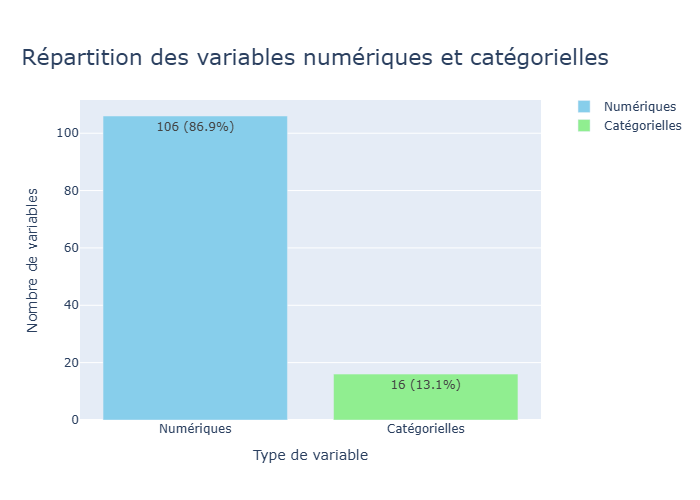

In [7]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_appli_train,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

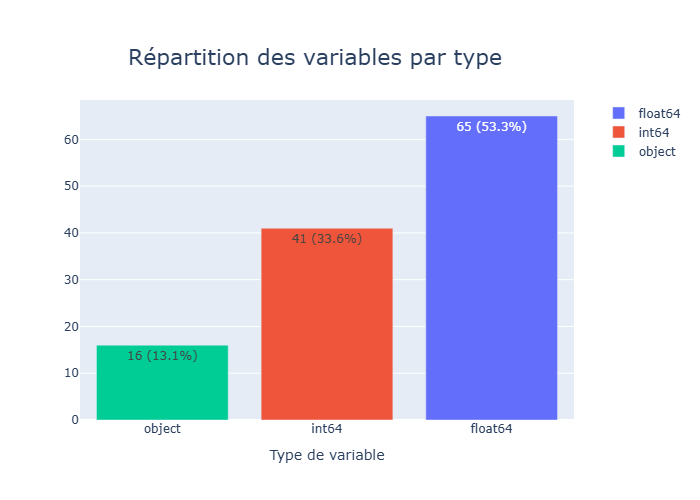

In [8]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_appli_train,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

In [9]:
n, cols = missing_columns_summary(df_appli_train, threshold=0)
print(f"{n} colonnes avec des valeurs manquantes : {cols}")

67 colonnes avec des valeurs manquantes : ['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE', 'OWN_CAR_AGE', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIV

In [10]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_appli_train)

'Le DataFrame contient 9152465 valeurs manquantes sur 37516342 observations, soit 24.40%.'

- Comme on peut le voir, il y a un nombre important de valeurs manquantes puisque ces valeurs représentent plus de **24 %** du dataframe.
- On retrouve plus de la **moitié** des variables avec au moins une valeur manquante et **41** colonnes avec plus de **50 %** de valeurs manquantes (le maximum atteignant près de **70%**)
- Il faut donc essayer d'imputer les valeurs manquantes de ces variables lorsque cela est possible et de la meilleure façon possible toutefois, il faut d'abord s'occuper des valeurs aberrantes que l'on a pu observer lors de l'EDA afin de ne pas nuire à l'imputation des valeurs manquantes.

##### - Valeurs aberrantes de application_train

In [11]:
# Liste des variables catégorielles du dataframe.

df_appli_train.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

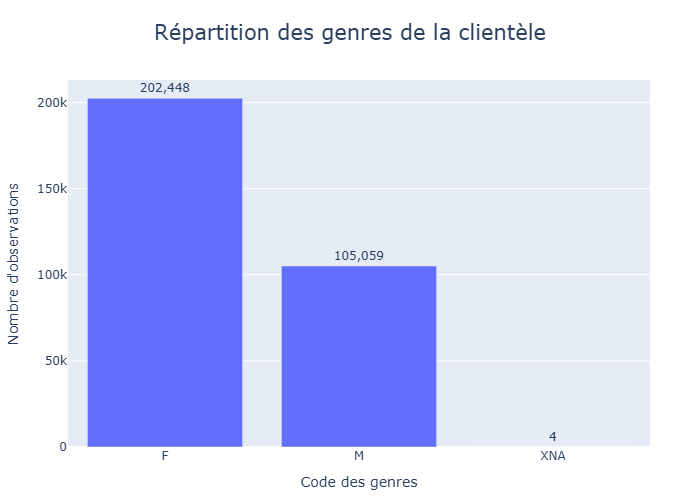

In [12]:
# Visualisation de la variable "CODE_GENDER" qui présente des anomalies.

plot_histogram_categorical(df=df_appli_train,
                           x="CODE_GENDER",
                           title="Répartition des genres de la clientèle",
                           title_font_size=21,
                           title_layout={'y': 0.95},
                           xaxis_title= 'Code des genres',
                           height=800,
                           width=900
)

- Comme on l'a vu lors de l'EDA il y a ici 4 clients dont le genre n'est pas renseigné, de plus il est difficile d'imputer cette variable à l'aide des autres variables sans potentiellement introduire un biais.
- La solution la plus simple et la plus sure est donc la supression de ces 4 lignes, puisque cela n'impactera pas la modélisation par la suite du fait de la taille de l'échantillon.

In [13]:
# Suppression des lignes correspondantes à CODE_GENDER = 'XNA'.

df_appli_train = df_appli_train.loc[df_appli_train['CODE_GENDER'] != 'XNA']
df_appli_train.loc[df_appli_train['CODE_GENDER'] == 'XNA']

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR


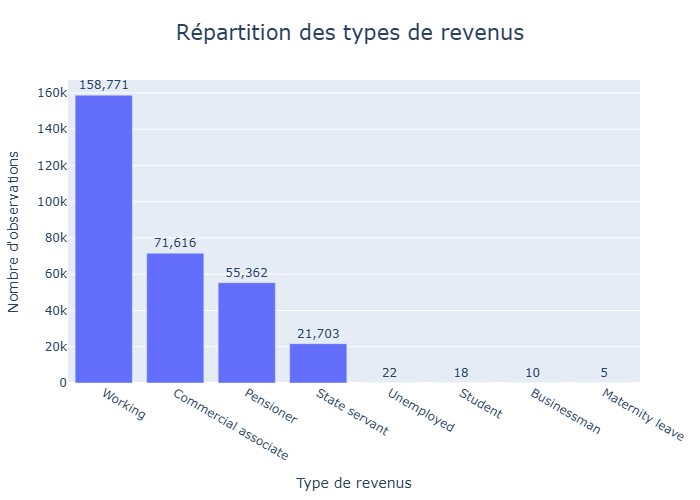

In [14]:
# Visualisation de la variable "NAME_INCOME_TYPE" qui présente des anomalies.

plot_histogram_categorical(df=df_appli_train,
                           x="NAME_INCOME_TYPE",
                           title="Répartition des types de revenus",
                           title_font_size=21,
                           title_layout={'y': 0.95},
                           xaxis_title= 'Type de revenus',
                           tickangle=30,
                           height=800,
                           width=900
)

In [15]:
# Suppression des lignes correspondantes à NAME_INCOME_TYPE = 'Maternity leave'.

df_appli_train = df_appli_train.loc[df_appli_train['NAME_INCOME_TYPE'] != 'Maternity leave']
df_appli_train.loc[df_appli_train['NAME_INCOME_TYPE'] == 'Maternity leave']

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR


- On supprime ici les lignes de NAME_INCOME_TYPE qui prennent la valeur 'Maternity leave' car elle ne sont pas présente dans le fichier application test puisque ces valeurs ne seront jamais vu lors de l'entrainement.

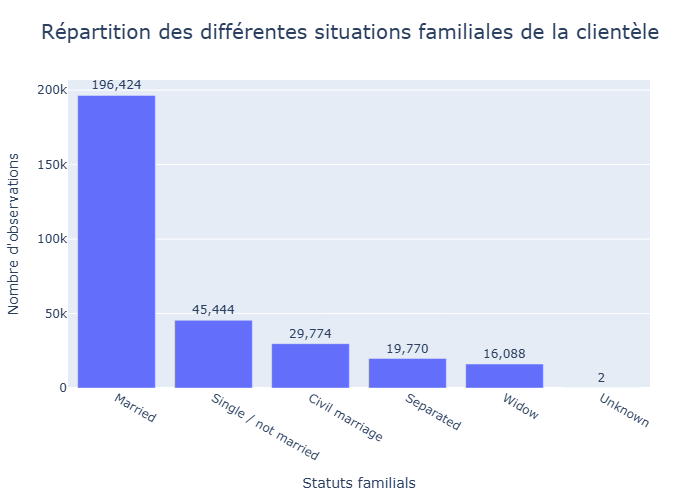

In [16]:
# Visualisation de la variable "NAME_FAMILY_STATUS" qui présente des anomalies.

plot_histogram_categorical(df=df_appli_train,
                           x="NAME_FAMILY_STATUS",
                           title="Répartition des différentes situations familiales de la clientèle",
                           title_font_size=20,
                           title_layout={'y': 0.95},
                           xaxis_title= 'Statuts familials',
                           tickangle=30,
                           height=800,
                           width=900
)

- On a ici deux valeurs inconnues pour cette variable que l'on peut se permettre de supprimer pour les même raisons que précédemment.

In [17]:
# Suppression des lignes correspondantes à NAME_FAMILY_STATUS = 'Unknown'.

df_appli_train = df_appli_train.loc[df_appli_train['NAME_FAMILY_STATUS'] != 'Unknown']
df_appli_train.loc[df_appli_train['NAME_FAMILY_STATUS'] == 'Unknown']

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR


- Après vérification des différentes modalités des variables catégorielles restantes, il n'y a pas d'autres anomalies à corriger.
- On peut donc passer aux variables quantitatives:

In [18]:
# Liste des variables quantitatives du dataframe.

num_cols = df_appli_train.select_dtypes(exclude=['object']).columns.tolist()
n = 10

for i in range(0, len(num_cols), n):
    print(", ".join(num_cols[i:i+n]))

SK_ID_CURR, TARGET, CNT_CHILDREN, AMT_INCOME_TOTAL, AMT_CREDIT, AMT_ANNUITY, AMT_GOODS_PRICE, REGION_POPULATION_RELATIVE, DAYS_BIRTH, DAYS_EMPLOYED
DAYS_REGISTRATION, DAYS_ID_PUBLISH, OWN_CAR_AGE, FLAG_MOBIL, FLAG_EMP_PHONE, FLAG_WORK_PHONE, FLAG_CONT_MOBILE, FLAG_PHONE, FLAG_EMAIL, CNT_FAM_MEMBERS
REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY, HOUR_APPR_PROCESS_START, REG_REGION_NOT_LIVE_REGION, REG_REGION_NOT_WORK_REGION, LIVE_REGION_NOT_WORK_REGION, REG_CITY_NOT_LIVE_CITY, REG_CITY_NOT_WORK_CITY, LIVE_CITY_NOT_WORK_CITY, EXT_SOURCE_1
EXT_SOURCE_2, EXT_SOURCE_3, APARTMENTS_AVG, BASEMENTAREA_AVG, YEARS_BEGINEXPLUATATION_AVG, YEARS_BUILD_AVG, COMMONAREA_AVG, ELEVATORS_AVG, ENTRANCES_AVG, FLOORSMAX_AVG
FLOORSMIN_AVG, LANDAREA_AVG, LIVINGAPARTMENTS_AVG, LIVINGAREA_AVG, NONLIVINGAPARTMENTS_AVG, NONLIVINGAREA_AVG, APARTMENTS_MODE, BASEMENTAREA_MODE, YEARS_BEGINEXPLUATATION_MODE, YEARS_BUILD_MODE
COMMONAREA_MODE, ELEVATORS_MODE, ENTRANCES_MODE, FLOORSMAX_MODE, FLOORSMIN_MODE, LANDAREA_M

In [19]:
# Visualisation des variables présentant des valeurs anormales.

detect_aberrant_values(df_appli_train)['Variable'].unique()

array(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'OWN_CAR_AGE', 'FLAG_CONT_MOBILE', 'CNT_FAM_MEMBERS',
       'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG',
       'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG',
       'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG',
       'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG',
       'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE',
       'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE',
       'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE',
       'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE',
       

In [20]:
report_aberrante_val = detect_aberrant_values(df_appli_train, min_occurrences=2)
report_aberrante_val

,Variable,Valeur_aberrante,Occurrences
0,CNT_CHILDREN,4.0,429
1,CNT_CHILDREN,5.0,84
2,CNT_CHILDREN,6.0,21
3,CNT_CHILDREN,7.0,7
4,CNT_CHILDREN,14.0,3
...,...,...,...
12525,AMT_REQ_CREDIT_BUREAU_YEAR,17.0,7
12526,AMT_REQ_CREDIT_BUREAU_YEAR,15.0,6
12527,AMT_REQ_CREDIT_BUREAU_YEAR,19.0,4
12528,AMT_REQ_CREDIT_BUREAU_YEAR,18.0,4


In [21]:
#  Visualisation des valeurs aberrantes négatives potentielles.

report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] < 0]

,Variable,Valeur_aberrante,Occurrences
1258,DAYS_BIRTH,-8179.0,18
1259,DAYS_BIRTH,-8157.0,17
1260,DAYS_BIRTH,-8223.0,15
1261,DAYS_BIRTH,-8256.0,15
1262,DAYS_BIRTH,-8153.0,14
...,...,...,...
12460,DAYS_LAST_PHONE_CHANGE,-3497.0,2
12461,DAYS_LAST_PHONE_CHANGE,-3667.0,2
12462,DAYS_LAST_PHONE_CHANGE,-3568.0,2
12463,DAYS_LAST_PHONE_CHANGE,-3531.0,2


In [22]:
report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] < 0]["Variable"].unique()

array(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
       'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE'], dtype=object)

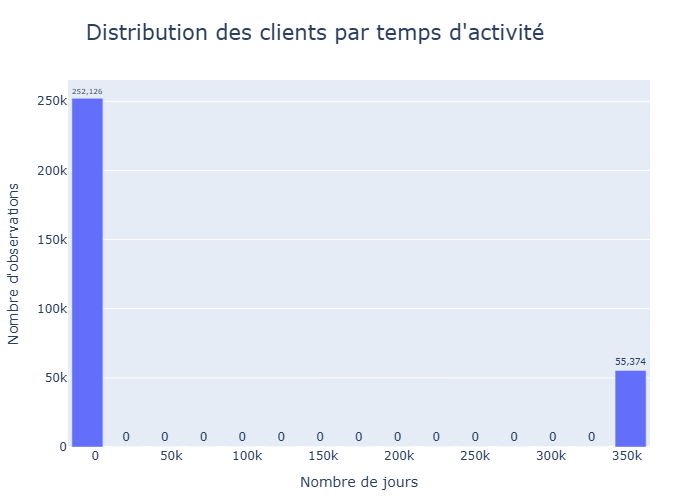

In [23]:
# Visualisation de la répartition pour la variable "DAYS_EMPLOYED".

plot_histogram_quantitative(
    df_appli_train,
    x='DAYS_EMPLOYED',
    title="Distribution des clients par temps d'activité",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

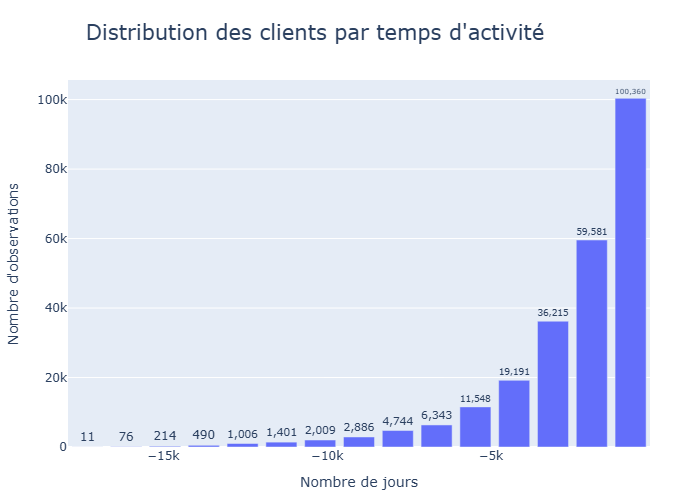

In [24]:
# Visualisation de la répartition pour la variable "DAYS_EMPLOYED" sans les valeurs potentiellement aberrantes.

plot_histogram_quantitative(
    df_appli_train,
    x='DAYS_EMPLOYED',
    title="Distribution des clients par temps d'activité",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.80,
    width=1000,
    height=600
)

- Pour cette variable, on constate qu'il y un nombre important de valeurs aberrante puisque celle-ci ne suivent pas la même régle (on regarde dans le passé donc valeurs négative et même sans cela ces valeurs dépasse les 350 000 jours donc plus de 1000 ans d'ancienneté dans leur activités respectives ce qui n'est pas possible).
- On remplacera donc ces valeurs aberrantes par des Nan car après recherche, ces valeurs suivent un code pour les valeurs valeur manquante / inconnue qui est utilisé pour certaines variables des datasets de Home Credit Default Risk.

In [25]:
# Correction des valeurs aberrantes pour la variable 'DAYS_EMPLOYED'.

df_appli_train['DAYS_EMPLOYED'].replace(365243, np.nan, inplace=True)

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_18248/1741192910.py:3: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [26]:
# Vérification des changements apportés.

df_appli_train['DAYS_EMPLOYED'].value_counts(dropna=False).head()

DAYS_EMPLOYED
 NaN      55374
-200.0      156
-224.0      152
-199.0      151
-230.0      151
Name: count, dtype: int64

- Pour ce qui est des  autres variables avec des valeurs négatives, on est sur des variables temporelles pour lesquelles on regarde dans le passé par rapport à la date de la demande donc il est normal de voir ces valeurs négatives (même si il serait possible de changer le format utiliser pour faciliter leur compréhension par la suite).
- Ensuite on retrouve toutes les variables qui présentent des outliers positifs et dont le nombre d'occurences est très important :

In [27]:
report_aberrante_val.loc[report_aberrante_val['Occurrences'] > 100]["Variable"].unique()

array(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE',
       'DAYS_REGISTRATION', 'OWN_CAR_AGE', 'FLAG_CONT_MOBILE',
       'CNT_FAM_MEMBERS', 'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_3',
       'APARTMENTS_AVG', 'BASEMENTAREA_AVG',
       'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'ELEVATORS_AVG',
       'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG',
       'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAREA_AVG',
       'APARTMENTS_MODE', 'BASEMENTAREA_MODE',
       'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE',
       'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE',
       'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE',
       'LIVINGAREA_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI',
       'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI',
       'YEARS_BUILD_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI',
       'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_

In [28]:
report_aberrante_val.loc[report_aberrante_val['Occurrences'] > 1000]["Variable"].unique()

array(['AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE',
       'HOUR_APPR_PROCESS_START', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_13',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_18',
       'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype=object)

In [29]:
report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] > 10]["Variable"].unique()

array(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'OWN_CAR_AGE', 'CNT_FAM_MEMBERS',
       'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_YEAR'], dtype=object)

In [30]:
# Vérification pour les variables de type "FLAG_DOCUMENT".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('FLAG_DOCUMENT')]

,Variable,Valeur_aberrante,Occurrences
12465,FLAG_DOCUMENT_2,1.0,13
12466,FLAG_DOCUMENT_4,1.0,25
12467,FLAG_DOCUMENT_7,1.0,57
12468,FLAG_DOCUMENT_9,1.0,1198
12469,FLAG_DOCUMENT_10,1.0,7
12470,FLAG_DOCUMENT_11,1.0,1203
12471,FLAG_DOCUMENT_12,1.0,2
12472,FLAG_DOCUMENT_13,1.0,1084
12473,FLAG_DOCUMENT_14,1.0,903
12474,FLAG_DOCUMENT_15,1.0,372


In [31]:
# Vérification pour les variables de type "AMT_REQ_CREDIT_BUREAU".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('AMT_REQ_CREDIT_BUREAU')]

,Variable,Valeur_aberrante,Occurrences
12481,AMT_REQ_CREDIT_BUREAU_HOUR,1.0,1560
12482,AMT_REQ_CREDIT_BUREAU_HOUR,2.0,56
12483,AMT_REQ_CREDIT_BUREAU_HOUR,3.0,9
12484,AMT_REQ_CREDIT_BUREAU_DAY,1.0,1292
12485,AMT_REQ_CREDIT_BUREAU_DAY,2.0,106
12486,AMT_REQ_CREDIT_BUREAU_DAY,3.0,45
12487,AMT_REQ_CREDIT_BUREAU_DAY,4.0,26
12488,AMT_REQ_CREDIT_BUREAU_DAY,5.0,9
12489,AMT_REQ_CREDIT_BUREAU_DAY,6.0,8
12490,AMT_REQ_CREDIT_BUREAU_DAY,9.0,2


In [32]:
# Vérification pour les variables de type "SOCIAL_CIRCLE".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('SOCIAL_CIRCLE')]

,Variable,Valeur_aberrante,Occurrences
11976,OBS_30_CNT_SOCIAL_CIRCLE,11.0,852
11977,OBS_30_CNT_SOCIAL_CIRCLE,12.0,652
11978,OBS_30_CNT_SOCIAL_CIRCLE,13.0,411
11979,OBS_30_CNT_SOCIAL_CIRCLE,14.0,258
11980,OBS_30_CNT_SOCIAL_CIRCLE,15.0,166
11981,OBS_30_CNT_SOCIAL_CIRCLE,16.0,133
11982,OBS_30_CNT_SOCIAL_CIRCLE,17.0,88
11983,OBS_30_CNT_SOCIAL_CIRCLE,18.0,46
11984,OBS_30_CNT_SOCIAL_CIRCLE,19.0,44
11985,OBS_30_CNT_SOCIAL_CIRCLE,20.0,30


In [33]:
# Vérification pour les variables de type "_AVG".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_AVG')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
6317,FLOORSMIN_AVG,1.0,141
5986,YEARS_BUILD_AVG,1.0,173
7246,NONLIVINGAREA_AVG,1.0,136
5870,YEARS_BEGINEXPLUATATION_AVG,1.0,186
6344,LANDAREA_AVG,1.0,135
...,...,...,...
6263,ENTRANCES_AVG,0.0,323
6602,LIVINGAPARTMENTS_AVG,0.0,418
6768,LIVINGAREA_AVG,0.0,284
5869,YEARS_BEGINEXPLUATATION_AVG,0.0,514


In [34]:
# Vérification pour les variables de type "_MEDI".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_MEDI')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
9776,BASEMENTAREA_MEDI,1.0,130
11330,NONLIVINGAREA_MEDI,1.0,134
10860,LIVINGAREA_MEDI,1.0,149
10128,YEARS_BUILD_MEDI,1.0,182
10029,YEARS_BEGINEXPLUATATION_MEDI,1.0,206
...,...,...,...
10130,YEARS_BUILD_MEDI,0.0,101
10859,LIVINGAREA_MEDI,0.0,299
10698,LIVINGAPARTMENTS_MEDI,0.0,433
10028,YEARS_BEGINEXPLUATATION_MEDI,0.0,548


In [35]:
# Vérification pour les variables de type "_MODE".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_MODE')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
8380,FLOORSMIN_MODE,1.0,141
11637,TOTALAREA_MODE,1.0,155
8137,COMMONAREA_MODE,1.0,89
8804,LIVINGAREA_MODE,1.0,150
8361,ENTRANCES_MODE,1.0,152
...,...,...,...
11636,TOTALAREA_MODE,0.0,582
8357,ENTRANCES_MODE,0.0,387
8651,LIVINGAPARTMENTS_MODE,0.0,519
8803,LIVINGAREA_MODE,0.0,444


- Comme on a pu le voir avec l'EDA et quelques vérification des variables les plus représentées, la grande majorité du temps ces valeurs sont valables et représentent seulement des clients atypiques. Néanmoins, il faut faire attention aux variables comme 'DAYS_EMPLOYED' qui utilisent des codes spécifiques pour exprimer par exemple une valeur nulle ou inconnue.
- Ensuite on peut s'occuper des valeurs manquantes :

In [36]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_appli_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
COMMONAREA_MEDI,214856,69.871870
COMMONAREA_AVG,214856,69.871870
COMMONAREA_MODE,214856,69.871870
NONLIVINGAPARTMENTS_MEDI,213506,69.432846
NONLIVINGAPARTMENTS_MODE,213506,69.432846
NONLIVINGAPARTMENTS_AVG,213506,69.432846
FONDKAPREMONT_MODE,210289,68.386667
LIVINGAPARTMENTS_MODE,210191,68.354797
LIVINGAPARTMENTS_MEDI,210191,68.354797
LIVINGAPARTMENTS_AVG,210191,68.354797


<Figure size 720x432 with 0 Axes>

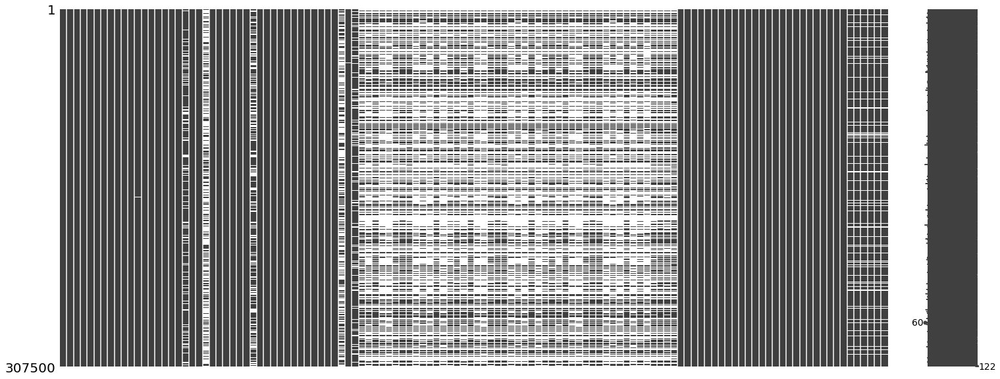

In [37]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_appli_train.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [38]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_appli_train)

'Le DataFrame contient 9207492 valeurs manquantes sur 37515000 observations, soit 24.54%.'

- Pour s'occuper des valeurs manquantes on a plusieurs solutions, comme supprimer les variables ou lignes présentant un nombre trop important de valeurs manquantes, l'imputation de ces valeurs en utilisant la méthode adaptée au type de variable (quantitative/qualitative) et en séléctionnant les techniques qui permettent de palier à ce problème le plus efficacement possible en prenant en compte les contraintes associées (large dataset avec beaucoup d'individus et de variable).
- Il pourrait d'ailleurs être intéressant de créer différents jeux de données en utilisant différentes méthodes d'imputation afin d'optimiser les résultats lors de la modélisation que l'on fera par la suite. Pour cela on va créer 4 datasets différents comme suit :

    - Setup 1 — Baseline Médiane et Mode :

        - Numériques → Médiane
        - Catégorielles → Mode
        + Indicateurs binaires qui crée une variable binaire pour chaque feature imputée (colonne_is_missing renvoie 0 ou 1) car après quelques recherche cela est bénéfique pour la modélisation puisque l'absence d'information constitue elle-même un facteur de risque de défaillance

    - Setup 2 — Baseline Médiane et Missing :

        - Numériques → Médiane
        - Catégorielles → Ajout explicite d’une modalité "MISSING" (au lieu du mode)
        + Indicateurs binaires

    - Setup 3 — Baseline IterativeImputer et Mode :

        - Numériques → IterativeImputer
        - Catégorielles → Mode 
        + Indicateurs binaires
    
    - Setup 4 — Baseline Pas d’imputation et Missing :

        - Numériques → Pas d’imputation (garder les NaN car des modèles comme LightGBM/CatBoost gèrent ça nativement ce qui peut être intéressant)
        - Catégorielles → "MISSING"
        + Indicateurs binaires

In [39]:
# Mise en place d'une fonction permettant de créer les datasets suivant les différentes configurations.

def create_datasets(
    df, 
    cat_cols, 
    num_cols, 
    setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"),  
    random_state=42
):
    """
    Crée des variantes du dataset selon différentes stratégies d’imputation.
    Pour chaque stratégie : 
      - version "tree" (avec flags, adaptée aux modèles non-linéaires/arbres)
      - version "linear" (sans flags, adaptée aux modèles linéaires)
    
    Paramètres:
        df : DataFrame initial
        cat_cols : liste des colonnes catégorielles
        num_cols : liste des colonnes numériques
        setups : tuple/list des setups à créer
        random_state : pour reproductibilité de l'IterativeImputer
    
    Retourne:
        dict : dictionnaire avec les DataFrames demandés
    """
    datasets = {}
    df = df.copy()

    for setup in setups:
        if setup == "median_mode":
            df1 = df.copy()
            # --- flags
            flags_num = {col + "_was_missing": df1[col].isna().astype(int) for col in num_cols if col in df1}
            flags_cat = {col + "_was_missing": df1[col].isna().astype(int) for col in cat_cols if col in df1}
            for col in num_cols:
                if col in df1:
                    df1[col] = df1[col].fillna(df1[col].median())
            for col in cat_cols:
                if col in df1:
                    df1[col] = df1[col].fillna(df1[col].mode()[0])

            # version tree
            df_tree = pd.concat([df1, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["median_mode_tree"] = df_tree
            # version linear (sans flags)
            datasets["median_mode_linear"] = df1.copy()

        elif setup == "median_missing":
            df2 = df.copy()
            flags_num = {col + "_was_missing": df2[col].isna().astype(int) for col in num_cols if col in df2}
            flags_cat = {col + "_was_missing": df2[col].isna().astype(int) for col in cat_cols if col in df2}
            for col in num_cols:
                if col in df2:
                    df2[col] = df2[col].fillna(df2[col].median())
            for col in cat_cols:
                if col in df2:
                    df2[col] = df2[col].fillna("MISSING")

            df_tree = pd.concat([df2, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["median_missing_tree"] = df_tree
            datasets["median_missing_linear"] = df2.copy()

        elif setup == "iterative_mode":
            df3 = df.copy()
            flags_num = {col + "_was_missing": df3[col].isna().astype(int) for col in num_cols if col in df3}
            flags_cat = {col + "_was_missing": df3[col].isna().astype(int) for col in cat_cols if col in df3}
            iterative_imputer = IterativeImputer(random_state=random_state)
            df3[num_cols] = iterative_imputer.fit_transform(df3[num_cols])
            for col in cat_cols:
                if col in df3:
                    df3[col] = df3[col].fillna(df3[col].mode()[0])

            df_tree = pd.concat([df3, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["iterative_mode_tree"] = df_tree
            datasets["iterative_mode_linear"] = df3.copy()

        elif setup == "nan_missing":
            df4 = df.copy()
            flags_num = {col + "_was_missing": df4[col].isna().astype(int) for col in num_cols if col in df4}
            flags_cat = {col + "_was_missing": df4[col].isna().astype(int) for col in cat_cols if col in df4}
            for col in cat_cols:
                if col in df4:
                    df4[col] = df4[col].fillna("MISSING")

            df_tree = pd.concat([df4, pd.DataFrame({**flags_num, **flags_cat})], axis=1).copy()
            datasets["nan_missing_tree"] = df_tree
            datasets["nan_missing_linear"] = df4.copy()

    return datasets

In [40]:
# Suppression des variables avec trop de valeurs manquantes et peu corrélées à la TARGET.

cols_to_del = [
    "COMMONAREA_MEDI", "COMMONAREA_AVG", "COMMONAREA_MODE",
    "NONLIVINGAPARTMENTS_MEDI", "NONLIVINGAPARTMENTS_MODE", "NONLIVINGAPARTMENTS_AVG",
    "FONDKAPREMONT_MODE", "LIVINGAPARTMENTS_MODE", "LIVINGAPARTMENTS_MEDI",
    "LIVINGAPARTMENTS_AVG", "FLOORSMIN_MODE", "FLOORSMIN_MEDI",
    "FLOORSMIN_AVG", "YEARS_BUILD_MODE", "YEARS_BUILD_MEDI",
    "YEARS_BUILD_AVG"
]

df_appli_train.drop(columns=cols_to_del, inplace=True)
print(f"Colonnes encore présentes : {[col for col in cols_to_del if col in df_appli_train.columns]}")

Colonnes encore présentes : []


- Ici on a supprimé les variables supérieurs à 60 % de valeurs manquantes sauf la variable "OWN_CAR_AGE" qui est intéressante par rapport à la Target.

In [41]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_appli_train.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_appli_train.select_dtypes(exclude=["object"]).columns.tolist()

datasets = create_datasets(df_appli_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

In [42]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_train_median_mode_linear = datasets["median_mode_linear"]
df_train_median_missing_linear = datasets["median_missing_linear"]
df_train_iterative_mode_linear = datasets["iterative_mode_linear"]
df_train_nan_missing_linear = datasets["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_train_median_mode = datasets["median_mode_tree"]
df_train_median_missing = datasets["median_missing_tree"]
df_train_iterative_mode = datasets["iterative_mode_tree"]
df_train_nan_missing = datasets["nan_missing_tree"]

print(df_train_median_mode_linear.head())
print(df_train_median_missing_linear.head())
print(df_train_iterative_mode_linear.head())
print(df_train_nan_missing_linear.head())

   SK_ID_CURR  TARGET NAME_CONTRACT_TYPE CODE_GENDER FLAG_OWN_CAR  \
0      100002       1         Cash loans           M            N   
1      100003       0         Cash loans           F            N   
2      100004       0    Revolving loans           M            Y   
3      100006       0         Cash loans           F            N   
4      100007       0         Cash loans           M            N   

  FLAG_OWN_REALTY  CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  AMT_ANNUITY  \
0               Y             0          202500.0    406597.5      24700.5   
1               N             0          270000.0   1293502.5      35698.5   
2               Y             0           67500.0    135000.0       6750.0   
3               Y             0          135000.0    312682.5      29686.5   
4               Y             0          121500.0    513000.0      21865.5   

   ...  FLAG_DOCUMENT_18 FLAG_DOCUMENT_19 FLAG_DOCUMENT_20 FLAG_DOCUMENT_21  \
0  ...                 0             

- On a donc maintenant 4 dataframes distincts avec les différentes techniques d'imputation utilisées afin d'avoir une base de comparaison.

In [43]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_train_median_mode_linear))
print(summarize_missing_values(df_train_median_missing_linear))
print(summarize_missing_values(df_train_iterative_mode_linear))
print(summarize_missing_values(df_train_nan_missing_linear))


Le DataFrame contient 0 valeurs manquantes sur 32595000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 32595000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 32595000 observations, soit 0.00%.
Le DataFrame contient 5288143 valeurs manquantes sur 32595000 observations, soit 16.22%.


In [44]:
print(summarize_missing_values(df_train_median_mode))
print(summarize_missing_values(df_train_median_missing))
print(summarize_missing_values(df_train_iterative_mode))
print(summarize_missing_values(df_train_nan_missing))

Le DataFrame contient 0 valeurs manquantes sur 65190000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 65190000 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 65190000 observations, soit 0.00%.
Le DataFrame contient 5288143 valeurs manquantes sur 65190000 observations, soit 8.11%.


In [45]:
# Information relatives aux dataframes pour visualiser les changements apportés.

print(df_train_median_mode_linear.info(show_counts=True))
print(df_train_median_missing_linear.info(show_counts=True))
print(df_train_iterative_mode_linear.info(show_counts=True))
print(df_train_nan_missing_linear.info(show_counts=True))

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 106 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(40), object(15)
memory usage: 251.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 106 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(40), object(15)
memory usage: 251.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 106 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(91), object(15)
memory usage: 251.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 106 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(40), object(15)
memory usage: 251.0+ MB
None


In [46]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_train_median_mode_linear)
optimize_types(df_train_median_missing_linear)
optimize_types(df_train_iterative_mode_linear)
optimize_types(df_train_nan_missing_linear)
optimize_types(df_train_median_mode)
optimize_types(df_train_median_missing)
optimize_types(df_train_iterative_mode)
optimize_types(df_train_nan_missing)

 Mémoire avant : 507.65 MB
 Mémoire après : 400.90 MB
 Gain : 21.0%
 Mémoire avant : 507.51 MB
 Mémoire après : 400.76 MB
 Gain : 21.0%
 Mémoire avant : 507.65 MB
 Mémoire après : 400.90 MB
 Gain : 21.0%
 Mémoire avant : 507.51 MB
 Mémoire après : 404.58 MB
 Gain : 20.3%
 Mémoire avant : 631.99 MB
 Mémoire après : 525.24 MB
 Gain : 16.9%
 Mémoire avant : 631.85 MB
 Mémoire après : 525.10 MB
 Gain : 16.9%
 Mémoire avant : 631.99 MB
 Mémoire après : 525.24 MB
 Gain : 16.9%
 Mémoire avant : 631.85 MB
 Mémoire après : 528.92 MB
 Gain : 16.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,NAME_INCOME_TYPE_was_missing,NAME_EDUCATION_TYPE_was_missing,NAME_FAMILY_STATUS_was_missing,NAME_HOUSING_TYPE_was_missing,OCCUPATION_TYPE_was_missing,WEEKDAY_APPR_PROCESS_START_was_missing,ORGANIZATION_TYPE_was_missing,HOUSETYPE_MODE_was_missing,WALLSMATERIAL_MODE_was_missing,EMERGENCYSTATE_MODE_was_missing
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0,0,0,0,0,0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,1,1,1
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,1,1,1
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,0,0,0,0,0,0
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,1,0,0,0,0,0
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,0,0,0,0,0,0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0,0,0,0,0,0


In [47]:
print(df_train_median_mode.info(show_counts=True))
print(df_train_median_missing.info(show_counts=True))
print(df_train_iterative_mode.info(show_counts=True))
print(df_train_nan_missing.info(show_counts=True))

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 212 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(37), int32(160), object(15)
memory usage: 268.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 212 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(37), int32(160), object(15)
memory usage: 268.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 212 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(50), int32(147), object(15)
memory usage: 268.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 212 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: Int32(13), float32(37), int32(147), object(15)
memory usage: 272.4+ MB
None


- On a bien les résultats attendus, on peut maintenant passer à l'encodage des variable catégorielle puisque les modèles travaillent avec des valeurs numériques en commençant pas les variables catégorielle binaire en utilisant LabelEncoder puisque ces variables prendront la valeur 0 ou 1 cela ne posera pas de problème d'ordinalité.

In [48]:
# Visualisation des variables à encoder pour les dataframes utilisant le mode (2 dataframes).

binary_categorical = [col for col in df_train_median_mode.columns 
                      if df_train_median_mode[col].dtype == 'object' and df_train_median_mode[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical)

Variables catégorielles binaires : ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'EMERGENCYSTATE_MODE']


In [49]:
# Visualisation des variables à encoder pour les dataframes utilisant missing ou des nan.

binary_categorical_miss = [col for col in df_train_median_missing_linear.columns 
                      if df_train_median_missing_linear[col].dtype == 'object' and df_train_median_missing_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical_miss)

Variables catégorielles binaires : ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']


- Ici on constate une différence entre les datasets utilisant ou n'utilisant pas l'imputation missing puisque ces derniers ont une modalité en moins ce qui engendre le fait que 'EMERGENCYSTATE_MODE' à 2 ou 3 modalités donc pour ne pas avoir de problèmes avec l'encoding one hot encoder, on l'encodera avec OHE par la suite.

In [50]:
# Encodage des variables catégorielles binaires avec LabelEncoder.

encoders = {}

# Liste des datasets concernés
datasets = [
    df_appli_train,
    df_train_median_mode_linear,
    df_train_median_missing_linear,
    df_train_iterative_mode_linear,
    df_train_nan_missing_linear,
    df_train_median_mode,
    df_train_median_missing,
    df_train_iterative_mode,
    df_train_nan_missing
]

for col in binary_categorical_miss:
    # Encodage avec la fonction générique
    dfs_encoded, le = label_encode(datasets, col)
    
    # Mise à jour des DataFrames originaux
    df_appli_train = dfs_encoded[0]
    df_train_median_mode_linear = dfs_encoded[1]
    df_train_median_missing_linear = dfs_encoded[2]
    df_train_iterative_mode_linear = dfs_encoded[3]
    df_train_nan_missing_linear = dfs_encoded[4]
    df_train_median_mode = dfs_encoded[5]
    df_train_median_missing = dfs_encoded[6]
    df_train_iterative_mode = dfs_encoded[7]
    df_train_nan_missing = dfs_encoded[8]
    
    # Stocker l’encodeur pour usage futur
    encoders[col] = le


In [51]:
# Vérification des changements pour ces variables catégorielles binaires.

df_train_median_mode_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']]

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY
0,0,1,0,1
1,0,0,0,0
2,1,1,1,1
3,0,0,0,1
4,0,1,0,1
...,...,...,...,...
307506,0,1,0,0
307507,0,0,0,1
307508,0,0,0,1
307509,0,0,0,1


In [52]:
# Vérification des changements pour ces variables catégorielles binaires.

df_train_median_missing_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']]

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY
0,0,1,0,1
1,0,0,0,0
2,1,1,1,1
3,0,0,0,1
4,0,1,0,1
...,...,...,...,...
307506,0,1,0,0
307507,0,0,0,1
307508,0,0,0,1
307509,0,0,0,1


In [53]:
# Vérification des changements pour ces variables catégorielles binaires.

df_train_median_mode_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'EMERGENCYSTATE_MODE']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Data columns (total 5 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   NAME_CONTRACT_TYPE   307500 non-null  object
 1   CODE_GENDER          307500 non-null  object
 2   FLAG_OWN_CAR         307500 non-null  object
 3   FLAG_OWN_REALTY      307500 non-null  object
 4   EMERGENCYSTATE_MODE  307500 non-null  object
dtypes: object(5)
memory usage: 14.1+ MB


- Les changements sont bien effectifs masi le type des variables doit être changer pour garder des variables numériques comme attendu par un modéle de classification.

In [54]:
# Changement des types des variables concernées.

df_appli_train[binary_categorical_miss] = df_appli_train[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_median_mode_linear[binary_categorical_miss] = df_train_median_mode_linear[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_iterative_mode_linear[binary_categorical_miss] = df_train_iterative_mode_linear[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_median_missing_linear[binary_categorical_miss] = df_train_median_missing_linear[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_nan_missing_linear[binary_categorical_miss] = df_train_nan_missing_linear[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_median_mode[binary_categorical_miss] = df_train_median_mode[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_iterative_mode[binary_categorical_miss] = df_train_iterative_mode[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_median_missing[binary_categorical_miss] = df_train_median_missing[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))
df_train_nan_missing[binary_categorical_miss] = df_train_nan_missing[binary_categorical_miss].apply(lambda x: pd.to_numeric(x, errors="coerce").astype("Int64"))

In [55]:
# Vérification des changements pour ces variables catégorielles binaires.

df_appli_train[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Data columns (total 4 columns):
 #   Column              Non-Null Count   Dtype
---  ------              --------------   -----
 0   NAME_CONTRACT_TYPE  307500 non-null  Int64
 1   CODE_GENDER         307500 non-null  Int64
 2   FLAG_OWN_CAR        307500 non-null  Int64
 3   FLAG_OWN_REALTY     307500 non-null  Int64
dtypes: Int64(4)
memory usage: 12.9 MB


In [56]:
# Vérification des changements pour ces variables catégorielles binaires.

df_train_median_missing[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Data columns (total 4 columns):
 #   Column              Non-Null Count   Dtype
---  ------              --------------   -----
 0   NAME_CONTRACT_TYPE  307500 non-null  Int64
 1   CODE_GENDER         307500 non-null  Int64
 2   FLAG_OWN_CAR        307500 non-null  Int64
 3   FLAG_OWN_REALTY     307500 non-null  Int64
dtypes: Int64(4)
memory usage: 12.9 MB


- Ensuite pour les variables catégorielles avec un nombre de modalités modéré, on peut utiliser **One hot encoder** qui est simple, robuste et sans ordre implicité ajouté (puisque chaque variable catégorielle est maintenant représentée par ses modalités donc il y a autant de nouvelles variables que de modalités uniques et chacune de ces variables prennent la valeur 0 sauf pour la variable (modalité) représentant le client qui prend alors la valeur 1).
- De plus cet encodage est compatible avec la majorité des modèles de machine learning classiques.

In [57]:
# Visualisation du nombre de valeurs uniques pour les dataframes utilisant le mode.

df_train_median_mode_linear.select_dtypes("object").nunique()

NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

In [58]:
# Visualisation du nombre de valeurs uniques pour les dataframes utilisant la modalité "MISSING".

df_train_median_missing_linear.select_dtypes("object").nunique()

NAME_TYPE_SUITE                8
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               19
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
HOUSETYPE_MODE                 4
WALLSMATERIAL_MODE             8
EMERGENCYSTATE_MODE            3
dtype: int64

- On observe des différences entre les deux type de dataframe car ceux utilisant la modalité "MISSING" ajoute une modalité supplémentaire mais cela ne pose pas de problèmes pour la suite.
- Donc pour les variables restantes, on peut l'appliquer à l'ensemble de ces variables sauf **"OCCUPATION_TYPE"** et **"ORGANIZATION_TYPE"** qui sont plus conséquente en terme de modalités uniques ce qui aurait pour effet d'ajouter **76** variables supplémentaires à eux deux. Pour palier à cela, on utilisera ***Target Encoder*** puisque l'on remplace chaque modalité par une valeur calculée à partir de la *target (y)* donc cela permet de réduire la dimension (**2** colonnes au lieu de **76**) et capture de l'information liée à la Target. Toutefois, on effectuera cet encodage avant la séparation des données pour éviter la fuite donnée donc seulement sur le jeu d'entrainement pour éviter ce data leakage. 

In [59]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_train_median_mode_linear.columns 
                      if df_train_median_mode_linear[col].dtype == 'object' and df_train_median_mode_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var)

Variables catégorielles avec One Hot Encoder : ['NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']


In [60]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var_miss = [col for col in df_train_median_missing_linear.columns 
                      if df_train_median_missing_linear[col].dtype == 'object' and df_train_median_missing_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var_miss)

Variables catégorielles avec One Hot Encoder : ['NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']


In [61]:
# Encodage des variables catégorielles avec One Hot Encoder.


# Liste des datasets à encoder
datasets_linear = [
    df_train_median_missing_linear,
    df_train_median_mode_linear,
    df_train_iterative_mode_linear,
    df_train_nan_missing_linear
]

# Application du One-Hot Encoding sur tous les datasets linear
encoded_dfs = one_hot_encode(datasets_linear, columns=ohe_var_miss, drop_first=True)

# Récupération dans les bonnes variables

df_train_median_missing_linear = encoded_dfs[0]
df_train_median_mode_linear = encoded_dfs[1]
df_train_iterative_mode_linear = encoded_dfs[2]
df_train_nan_missing_linear = encoded_dfs[3]

# Liste des datasets à encoder
datasets = [
    df_train_median_missing,
    df_train_median_mode,
    df_train_iterative_mode,
    df_train_nan_missing
]

# Application du One-Hot Encoding sur tous les datasets restants
encoded_dfs_miss = one_hot_encode(datasets, columns=ohe_var_miss, drop_first=False)

# Récupération dans les bonnes variables
df_train_median_missing = encoded_dfs_miss[0]
df_train_median_mode = encoded_dfs_miss[1]
df_train_iterative_mode = encoded_dfs_miss[2]
df_train_nan_missing = encoded_dfs_miss[3]

In [62]:
df_train_median_missing_linear.loc[:, df_train_median_missing_linear.columns.str.contains('EMERGENCYSTATE_MODE')]

,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,1.0,0.0
1,1.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
307506,1.0,0.0
307507,1.0,0.0
307508,1.0,0.0
307509,1.0,0.0


In [63]:
df_train_median_missing.loc[:, df_train_median_missing.columns.str.contains('EMERGENCYSTATE_MODE')]

,EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_MISSING,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,0,0.0,1.0,0.0
1,0,0.0,1.0,0.0
2,1,1.0,0.0,0.0
3,1,1.0,0.0,0.0
4,1,1.0,0.0,0.0
...,...,...,...,...
307506,0,0.0,1.0,0.0
307507,0,0.0,1.0,0.0
307508,0,0.0,1.0,0.0
307509,0,0.0,1.0,0.0


In [64]:
# Vérification des changements pour ces variables catégorielles binaires.

df_train_median_mode_linear.select_dtypes("object").nunique()

OCCUPATION_TYPE      18
ORGANIZATION_TYPE    58
dtype: int64

In [65]:
df_train_median_missing_linear.select_dtypes("object").nunique()

OCCUPATION_TYPE      19
ORGANIZATION_TYPE    58
dtype: int64

- Ensuite pour la prochaine étape, on va s'occuper d'analyser les corrélations entre les variables car certaines variables peuvent poser un problème de multicolinéarité lorsque celles-ci sont fortement corrélées entre elles, ce qui peut fausser certains modèles (surtout les modèles linéaires). En effet, cela peut occasionner des coefficients instables, des p-values trompeuses ou du surapprentissage.
- Pour palier à cela, on pourra supprimer certaines de ces variables, les combiner ou créer de nouvelles features à l'aide des ces variables trop corrélées entre elles (dans l'ensemble cela va aussi simplifier le modèle et accélèrer l’apprentissage).

#### Feature engineering - df_train_median_mode_linear

In [66]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
2,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998491
3,FLOORSMAX_AVG / FLOORSMAX_MEDI,FLOORSMAX_AVG,FLOORSMAX_MEDI,0.997260
4,ENTRANCES_AVG / ENTRANCES_MEDI,ENTRANCES_AVG,ENTRANCES_MEDI,0.996900
5,ELEVATORS_AVG / ELEVATORS_MEDI,ELEVATORS_AVG,ELEVATORS_MEDI,0.996692
6,LIVINGAREA_AVG / LIVINGAREA_MEDI,LIVINGAREA_AVG,LIVINGAREA_MEDI,0.995783
7,APARTMENTS_AVG / APARTMENTS_MEDI,APARTMENTS_AVG,APARTMENTS_MEDI,0.995234
8,BASEMENTAREA_AVG / BASEMENTAREA_MEDI,BASEMENTAREA_AVG,BASEMENTAREA_MEDI,0.994389
9,YEARS_BEGINEXPLUATATION_AVG / YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,0.993838


- Comme on peut le voir, il y a beaucoup de corrélations supérieur à **0.80** qui pourraient poser problème donc il faut s'en occuper (surtout pour les dataframes conçus pour les modèles non linéaires).
- Pour cela, on peut commencer par les dataframes destinés aux modèles linéaires avec les variables qui apparaissent le plus souvent et qui contiennent le suffixe **"_AVG"**; **"_MODE"** et **"_MEDI"**. Puisque ce sont des variables qui donnent des informations trés similaires mais sous des angles un peu différent, on peut se permettre d'en garder qu'une seule des trois à chaque fois (de préférence *_MEDI* qui est plus robuste aux valeurs extrêmes).
- On les supprimera dans les dataframes pour les modèles linéaires car cela peut poser de gros problèmes de coefficients mais pas pour les modèles non linéaires qui sont très robustes à la colinéarité.

In [67]:
df_train_median_mode_linear.loc[:, df_train_median_mode_linear.columns.str.contains("_AVG")]

,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,LANDAREA_AVG,LIVINGAREA_AVG,NONLIVINGAREA_AVG
0,0.0247,0.0369,0.9722,0.00,0.0690,0.0833,0.0369,0.0190,0.0000
1,0.0959,0.0529,0.9851,0.08,0.0345,0.2917,0.0130,0.0549,0.0098
2,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036
3,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036
4,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036
...,...,...,...,...,...,...,...,...,...
307506,0.2021,0.0887,0.9876,0.22,0.1034,0.6042,0.0594,0.1965,0.1095
307507,0.0247,0.0435,0.9727,0.00,0.1034,0.0833,0.0579,0.0257,0.0000
307508,0.1031,0.0862,0.9816,0.00,0.2069,0.1667,0.0481,0.9279,0.0000
307509,0.0124,0.0763,0.9771,0.00,0.0690,0.0417,0.0481,0.0061,0.0036


In [68]:
df_train_median_mode_linear.loc[:, df_train_median_mode_linear.columns.str.contains("_MEDI")]

,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,LANDAREA_MEDI,LIVINGAREA_MEDI,NONLIVINGAREA_MEDI
0,0.0250,0.0369,0.9722,0.00,0.0690,0.0833,0.0375,0.0193,0.0000
1,0.0968,0.0529,0.9851,0.08,0.0345,0.2917,0.0132,0.0558,0.0100
2,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031
3,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031
4,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031
...,...,...,...,...,...,...,...,...,...
307506,0.2040,0.0887,0.9876,0.22,0.1034,0.6042,0.0605,0.2001,0.1118
307507,0.0250,0.0435,0.9727,0.00,0.1034,0.0833,0.0589,0.0261,0.0000
307508,0.1041,0.0862,0.9816,0.00,0.2069,0.1667,0.0487,0.9445,0.0000
307509,0.0125,0.0758,0.9771,0.00,0.0690,0.0417,0.0487,0.0062,0.0031


In [69]:
df_train_median_mode_linear.loc[:, df_train_median_mode_linear.columns.str.contains("_MODE")].columns

Index(['APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'LANDAREA_MODE',
       'LIVINGAREA_MODE', 'NONLIVINGAREA_MODE', 'TOTALAREA_MODE',
       'HOUSETYPE_MODE_block of flats', 'HOUSETYPE_MODE_specific housing',
       'HOUSETYPE_MODE_terraced house', 'WALLSMATERIAL_MODE_MISSING',
       'WALLSMATERIAL_MODE_Mixed', 'WALLSMATERIAL_MODE_Monolithic',
       'WALLSMATERIAL_MODE_Others', 'WALLSMATERIAL_MODE_Panel',
       'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Wooden',
       'EMERGENCYSTATE_MODE_No', 'EMERGENCYSTATE_MODE_Yes'],
      dtype='object')

- On retrouve bien 9 variables avec les 3 suffixes évoqués plus haut, seules les variables avec **"_MODE"** sont plus nombreuses à cause principalement de l'encodage One Hot Encoder que l'on ne supprime pas pour le moment.
- On va donc supprimer les variables communes et garder celles avec le suffixe _MEDI puisque la médiane est plus robuste.

In [70]:
# Suppression des variables trop corrélées ("_MODE" et "_AVG")

cols_to_drop = df_appli_train.loc[:, df_appli_train.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_appli_train.columns.str.contains("_AVG|_MODE")].columns.tolist()

df_appli_train.drop(columns=cols_to_drop, inplace=True)
df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True)
df_train_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True)
df_train_median_missing_linear.drop(columns=cols_to_drop, inplace=True)
df_train_nan_missing_linear.drop(columns=cols_to_drop, inplace=True)

In [71]:
# Vérification des changements apportés.

df_train_median_mode_linear.loc[:, df_train_median_mode_linear.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_train_median_mode_linear.columns.str.contains("_AVG|_MODE")].columns

Index([], dtype='object')

In [72]:
# Visualisation des fortes corrélations restantes entre les variables.

get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=True, threshold=0.8)


,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
2,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998491
3,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.986737
4,REGION_RATING_CLIENT / REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.950840
5,LIVINGAREA_MEDI / TOTALAREA_MODE,LIVINGAREA_MEDI,TOTALAREA_MODE,0.911369
6,APARTMENTS_MEDI / LIVINGAREA_MEDI,APARTMENTS_MEDI,LIVINGAREA_MEDI,0.898035
7,NAME_EDUCATION_TYPE_Higher education / NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,-0.888010
8,CNT_CHILDREN / CNT_FAM_MEMBERS,CNT_CHILDREN,CNT_FAM_MEMBERS,0.879154
9,APARTMENTS_MEDI / TOTALAREA_MODE,APARTMENTS_MEDI,TOTALAREA_MODE,0.876696


- Donc pour continuer sur ces dataframes (linear), on peut voir qu'il reste une vingtaine de variables très corrélées dont il faut s'occuper.
- Pour cela on choisira entre une des deux variables a supprimer en se basant sur leur fréquence et leur corrélation dans leur dataframe d'origine.
- Pour les variables restantes que l'on a pas encore supprimer, elles seront utilisées pour réaliser du feature engineering avant de faire un choix.

In [73]:
df_corr = get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=False, threshold=0.8)

In [74]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()

In [75]:
# Fréquence d'apparition des variables restantes.

(df_train_median_mode_linear[var_corr].sum() / len(df_train_median_mode_linear)).sort_values(ascending=False)

AMT_CREDIT                                           599025.893776
AMT_GOODS_PRICE                                      538315.048377
CNT_FAM_MEMBERS                                           2.152637
REGION_RATING_CLIENT                                      2.052462
REGION_RATING_CLIENT_W_CITY                               2.031519
OBS_30_CNT_SOCIAL_CIRCLE                                  1.417480
OBS_60_CNT_SOCIAL_CIRCLE                                  1.400582
EMERGENCYSTATE_MODE_No                                    0.992429
FLAG_EMP_PHONE                                            0.819883
NAME_TYPE_SUITE_Unaccompanied                             0.812390
WALLSMATERIAL_MODE_Panel                                  0.723164
NAME_EDUCATION_TYPE_Secondary / secondary special         0.710202
CNT_CHILDREN                                              0.417034
NAME_EDUCATION_TYPE_Higher education                      0.243441
REG_CITY_NOT_WORK_CITY                                    0.23

In [76]:
# Corrélation avec la target pour les variables restantes.

df_train_median_mode_linear[var_corr + ['TARGET']].corr()['TARGET'].abs().sort_values(ascending=False)

TARGET                                               1.000000
REGION_RATING_CLIENT_W_CITY                          0.060875
REGION_RATING_CLIENT                                 0.058882
NAME_EDUCATION_TYPE_Higher education                 0.056578
REG_CITY_NOT_WORK_CITY                               0.050981
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049804
NAME_INCOME_TYPE_Pensioner                           0.046205
FLAG_EMP_PHONE                                       0.045978
AMT_GOODS_PRICE                                      0.039650
ELEVATORS_MEDI                                       0.035545
ELEVATORS_MEDI                                       0.035545
LIVE_CITY_NOT_WORK_CITY                              0.032500
DEF_30_CNT_SOCIAL_CIRCLE                             0.032390
DEF_60_CNT_SOCIAL_CIRCLE                             0.031395
AMT_CREDIT                                           0.030390
TOTALAREA_MODE                                       0.030213
LIVINGAR

In [77]:
# Suppression d'une des deux variables pour celles sélectionnées.

cols_to_drop = ['NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'TOTALAREA_MODE', 'NAME_EDUCATION_TYPE_Secondary / secondary special','LIVINGAREA_MEDI', 
                'APARTMENTS_MEDI', 'REG_REGION_NOT_WORK_REGION', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_EMP_PHONE']

df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True)

- On peut d'ailleurs continuer avec le feature engineering puis supprimer les fortes corrélations restantes pour ces dataframes destinés aux modèles linéaire.
- Pour cela on utilisera notre EDA et certains kernels de la compétiton Kaggle pour pouvoir réaliser cette dernière étape.
- Globalement pour créer ces features, on pourrait regarder les différents groupes de variables ainsi que les variables les mieux corrélées à la Target pour pouvoir avancer plus rapidement sans faire du cas par cas.

In [78]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_mode_linear, 'TARGET', mode='linear', plot=False)
target_corr.head(50)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
EXT_SOURCE_2,-0.160274,-0.147112,0.160274,0.147112,0.153693
EXT_SOURCE_3,-0.155906,-0.141506,0.155906,0.141506,0.148706
EXT_SOURCE_1,-0.098896,-0.085410,0.098896,0.085410,0.092153
DAYS_BIRTH,0.078236,0.078325,0.078236,0.078325,0.078281
DAYS_EMPLOYED,0.063381,0.075065,0.063381,0.075065,0.069223
REGION_RATING_CLIENT_W_CITY,0.060875,0.060918,0.060875,0.060918,0.060897
REGION_RATING_CLIENT,0.058882,0.058892,0.058882,0.058892,0.058887
NAME_INCOME_TYPE_Working,0.057504,0.057504,0.057504,0.057504,0.057504
NAME_EDUCATION_TYPE_Higher education,-0.056578,-0.056578,0.056578,0.056578,0.056578
CODE_GENDER,0.054729,0.054729,0.054729,0.054729,0.054729


In [ ]:
# Mise en place d'une fonction permettant de réaliser de créer des variables dérivées

def add_feature_engineering(df):

    """
    Ajoute des features dérivées au dataset application train/test Home Credit.
    df : DataFrame pandas
    """
    # Moyenne du nombre de contacts/défauts sociaux sur 30 et 60 jours

    df['OBS_SOCIAL_MEAN'] = df[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']].mean(axis=1)
    df['DEF_SOCIAL_MEAN'] = df[['DEF_30_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE']].mean(axis=1)

    # Quelques nouvelles variables sur la situation familiale

    df['ADULTS_COUNT'] = df['CNT_FAM_MEMBERS'] - df['CNT_CHILDREN']
    df['CHILDREN_RATIO'] = df['CNT_CHILDREN'] / (df['CNT_FAM_MEMBERS'] + 1e-5)
    df['FAMILY_STABILITY_SCORE'] = df['ADULTS_COUNT'] / (1 + df['CNT_CHILDREN'])

    ########## Création de nouvelles variables avec les "EXT_SOURCE_" qui présentent les meilleures corrélations avec la Target.

    # Quelques combinaisons statistiques pour résumer la solvabilité globale

    df['EXT_SOURCE_MEAN'] = df[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].mean(axis=1)
    df['EXT_SOURCE_MEDIAN'] = df[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].median(axis=1)
    df['EXT_SOURCE_STD'] = df[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].std(axis=1)

    # Quelques produits croisés pour capturer des intéractions

    df['EXT_SOURCE_1_2'] = df['EXT_SOURCE_1'] * df['EXT_SOURCE_2']
    df['EXT_SOURCE_1_3'] = df['EXT_SOURCE_1'] * df['EXT_SOURCE_3']
    df['EXT_SOURCE_2_3'] = df['EXT_SOURCE_2'] * df['EXT_SOURCE_3']

    # Quelques transformations non linéaires qui peuvent améliorer les relations entre les variables

    for col in ['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']:
        df[f'{col}_SQ'] = df[col] ** 2
        df[f'{col}_SQRT'] = np.sqrt(df[col].clip(lower=0))

    ########## Création de nouvelles variables avec les variables temporelles qui suivent en terme de corrélation avec la Target (ex "DAYS_BIRTH, DAYS EMPLOYED").

    # Conversion de certaines variables pour faciliter leur lisibilité et réduire leur échelle.

    df['AGE_YEARS'] = (-df['DAYS_BIRTH']) / 365.25
    df['EMPLOYED_YEARS'] = (-df['DAYS_EMPLOYED']) / 365.25

    # Création d'une variable sur la stabilité professionnelle relative à l’âge.

    df['EMPLOYED_RATIO'] = df['EMPLOYED_YEARS'] / df['AGE_YEARS']

    # Interaction avec EXT_SOURCE_MEAN (Permet de favoriser les clients avec un bon score externe en pénalisant moins leur âge ou ancienneté)

    df['EXT_AGE_INTER'] = df['EXT_SOURCE_MEAN'] * df['AGE_YEARS']
    df['EXT_EMPLOYED_INTER'] = df['EXT_SOURCE_MEAN'] * df['EMPLOYED_YEARS']

    # Quelques transformations non linéaires qui peuvent améliorer les relations entre les variables

    df['AGE_SQ'] = df['AGE_YEARS'] ** 2
    df['AGE_LOG'] = np.log1p(df['AGE_YEARS'])
    df['AGE_LOG_STD'] = (df['AGE_LOG'] - df['AGE_LOG'].mean()) / df['AGE_LOG'].std()
    df['EMPLOYED_SQ'] = df['EMPLOYED_YEARS'] ** 2
    df['EMPLOYED_LOG'] = np.log1p(df['EMPLOYED_YEARS'])
    df['EMPLOYED_LOG_STD'] = (df['EMPLOYED_LOG'] - df['EMPLOYED_LOG'].mean()) / df['EMPLOYED_LOG'].std()

    # Indicateurs binaires pouvant faciliter l'interprétation pour les modèles linéaires

    df['IS_YOUNG'] = (df['AGE_YEARS'] < 25).astype(int)
    df['IS_SENIOR'] = (df['AGE_YEARS'] > 65).astype(int)
    df['IS_JUNIOR_EMPLOYED'] = (df['EMPLOYED_YEARS'] < 1).astype('Int64')

    # Diverses autres conversions d'échelles liées à des variables temporelles.

    df['REGISTRATION_YEARS'] = (-df['DAYS_REGISTRATION']) / 365.25
    df['ID_PUBLISH_YEARS'] = (-df['DAYS_ID_PUBLISH']) / 365.25
    df['LAST_PHONE_CHANGE_YEARS'] = (-df['DAYS_LAST_PHONE_CHANGE']) / 365.25

    # Quelques autres transformations non linéaires qui peuvent améliorer les relations entre les variables

    for col in ['REGISTRATION_YEARS', 'ID_PUBLISH_YEARS', 'LAST_PHONE_CHANGE_YEARS']:
        df[f'{col}_SQ'] = df[col] ** 2
        df[f'{col}_LOG'] = np.log1p(df[col])

    # Quelques indices binaires supplémentaire pour faciliter l'interprétation de certains événements (récence des changements de situation)

    df['RECENT_REGISTRATION'] = (df['REGISTRATION_YEARS'] < 1).astype('Int64')
    df['RECENT_ID_PUBLISH'] = (df['ID_PUBLISH_YEARS'] < 1).astype('Int64')
    df['RECENT_PHONE_CHANGE'] = (df['LAST_PHONE_CHANGE_YEARS'] < 0.5).astype('Int64')

    # Ratios et interactions temporelles (normalisation par l'âge, plus robuste)

    df['REGISTRATION_AGE_RATIO'] = df['REGISTRATION_YEARS'] / df['AGE_YEARS']
    df['IDPUBLISH_AGE_RATIO'] = df['ID_PUBLISH_YEARS'] / df['AGE_YEARS']
    df['PHONECHANGE_AGE_RATIO'] = df['LAST_PHONE_CHANGE_YEARS'] / df['AGE_YEARS']

    # Autres interactions avec EXT_SOURCE_MEAN (score de solvabilité externe + stabilité temporelle)

    df['EXT_REG_INTER'] = df['EXT_SOURCE_MEAN'] * df['REGISTRATION_YEARS']
    df['EXT_ID_INTER'] = df['EXT_SOURCE_MEAN'] * df['ID_PUBLISH_YEARS']
    df['EXT_PHONE_INTER'] = df['EXT_SOURCE_MEAN'] * df['LAST_PHONE_CHANGE_YEARS']

    ########## Création de nouvelles variables monétaires supplémentaire qui sont initialement très corrélées à la Target.

    # Ratio entre le montant du crédit et le prix du bien financé
    df['CREDIT_GOODS_RATIO'] = df['AMT_CREDIT'] / (df['AMT_GOODS_PRICE'] + 1e-5)

    # Différence entre le montant du crédit et le prix du bien financé (apport personel)
    df['CREDIT_MINUS_GOODS'] = df['AMT_CREDIT'] - df['AMT_GOODS_PRICE']

    # Ratio centré sur la différence entre le crédit et le prix du bien (proportion du du bien financé par un apport personel/surfinanacement permettant de comparer aux autres clients peu importe les montants)
    df['CREDIT_GOODS_DIFF_RATIO'] = df['CREDIT_MINUS_GOODS'] / (df['AMT_GOODS_PRICE'] + 1e-5)

    # Ratio mettant en avant le poids d'un crédit par rapport au revenu d'un client
    df['CREDIT_INCOME_RATIO'] = df['AMT_CREDIT'] / (df['AMT_INCOME_TOTAL'] + 1e-5)

    # Ratio mettant en avant la capacité de remboursement d'un client (poids des mensualités par rapport aux revenus)
    df['ANNUITY_INCOME_RATIO'] = df['AMT_ANNUITY'] / (df['AMT_INCOME_TOTAL'] + 1e-5)

    # Ratio mettant en avant le taux implicite de remboursement d'un prêt (délai de remboursement d'un crédit)
    df['ANNUITY_CREDIT_RATIO'] = df['AMT_ANNUITY'] / (df['AMT_CREDIT'] + 1e-5)

    # Ratio mettant en avant la capacité à financer le bien en fonction des revenus
    df['GOODS_INCOME_RATIO'] = df['AMT_GOODS_PRICE'] / (df['AMT_INCOME_TOTAL'] + 1e-5)

    # Quelques transformations non linéaires qui peuvent améliorer les relations entre les variables

    df['AMT_INCOME_TOTAL_LOG'] = np.log1p(df['AMT_INCOME_TOTAL'])
    df['CREDIT_INCOME_RATIO_LOG'] = np.log1p(df['CREDIT_INCOME_RATIO'])
    df['ANNUITY_INCOME_RATIO_LOG'] = np.log1p(df['ANNUITY_INCOME_RATIO'])
    df['GOODS_INCOME_RATIO_LOG'] = np.log1p(df['GOODS_INCOME_RATIO'])
    df['AMT_CREDIT_LOG'] = np.log1p(df['AMT_CREDIT'])
    df['AMT_CREDIT_SQRT'] = np.sqrt(df['AMT_CREDIT'])
    df['AMT_CREDIT_CLIPPED'] = df['AMT_CREDIT'].clip(upper=df['AMT_CREDIT'].quantile(0.99))
    df['AMT_INCOME_TOTAL_STD'] = (df['AMT_INCOME_TOTAL'] - df['AMT_INCOME_TOTAL'].mean()) / df['AMT_INCOME_TOTAL'].std()

    # Quelques intéractions pouvant améliorer les performances des modèles

    df['CREDIT_INCOME_EXT_MEAN'] = df['CREDIT_INCOME_RATIO'] * df['EXT_SOURCE_MEAN']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / (df['CNT_FAM_MEMBERS'] + 1e-5)
    df['INCOME_PER_ADULT'] = df['AMT_INCOME_TOTAL'] / (df['ADULTS_COUNT'] + 1e-5)
    df['INCOME_PER_AGE'] = df['AMT_INCOME_TOTAL'] / df['AGE_YEARS']
    df['INCOME_AGE_INTER'] = df['AGE_YEARS'] * df['AMT_INCOME_TOTAL']
    df['INCOME_EMPLOYED_INTER'] = df['EMPLOYED_YEARS'] * df['AMT_INCOME_TOTAL']
    df['ANNUITY_EMPLOYED_INTER'] = df['ANNUITY_INCOME_RATIO'] * df['EMPLOYED_YEARS']

    ########## Création de nouvelles variables géographiques supplémentaire qui sont initialement intéressante par rapport à la Target.

    # Quelques transformations pouvant améliorer la compréhension des modéles (moyenne des notations, situation géographique résidence/travail, degré de mobilité géographique)

    df['REGION_RATING_RATING_DIFF'] = df['REGION_RATING_CLIENT_W_CITY'] - df['REGION_RATING_CLIENT']
    df['REGION_RATING_MEAN'] = df[['REGION_RATING_CLIENT_W_CITY','REGION_RATING_CLIENT']].mean(axis=1)
    df['CITY_NOT_WORK_OR_LIVE'] = (((df['REG_CITY_NOT_WORK_CITY'] == 1) | (df['REG_CITY_NOT_LIVE_CITY'] == 1))).astype('Int64')
    df['CITY_MOBILITY_SCORE'] = df['REG_CITY_NOT_WORK_CITY'] + df['REG_CITY_NOT_LIVE_CITY']

    # Quelques transformation mathématiques pouvant améliorer la compréhension des modéles (Centrage de la note autour de 0, standardisation pour les modèles linéaires et catégorisation binaire à l'aide d'un seuil)

    df['INCOME_PER_PERSON_LOG'] = np.log1p(df['INCOME_PER_PERSON'])
    df['INCOME_PER_ADULT_LOG'] = np.log1p(df['INCOME_PER_ADULT'])
    df['REGION_RATING_CLIENT_CENTERED'] = df['REGION_RATING_CLIENT'] - df['REGION_RATING_CLIENT'].mean()
    df['REGION_RATING_CLIENT_STD'] = (df['REGION_RATING_CLIENT'] - df['REGION_RATING_CLIENT'].mean()) / df['REGION_RATING_CLIENT'].std()
    df['REGION_RATING_CLIENT_HIGH'] = (df['REGION_RATING_CLIENT'] >= df['REGION_RATING_CLIENT'].median()).astype('Int64')

    # Quelques intéractions avec d'autres variables pouvant améliorer les performances des modèles (stabilité géographique/Revenus par rapport à la qualité régionale, ratio notation avec l'âge)

    df['MOBILITY_RATING_INTER'] = df['CITY_MOBILITY_SCORE'] * df['REGION_RATING_CLIENT']
    df['RATING_INCOME_INTER'] = df['REGION_RATING_CLIENT'] * df['AMT_INCOME_TOTAL']
    df['RATING_PER_AGE'] = df['REGION_RATING_CLIENT'] / df['AGE_YEARS']

    ########## Création de nouvelles variables à partir des indicateurs binaires qui sont initialement très corrélées à la Target.

    # Agrégations classiques de certaines variables sur les données personnelles des clients

    df['NB_FLAG_CONTACT'] = df[['FLAG_MOBIL','FLAG_WORK_PHONE','FLAG_PHONE','FLAG_EMAIL']].sum(axis=1)
    df['HAS_ANY_PHONE'] = ((df['FLAG_WORK_PHONE'] + df['FLAG_PHONE']) > 0).astype('Int64')
    df['HAS_EMAIL_AND_PHONE'] = (df['FLAG_EMAIL'] & (df['FLAG_PHONE'] | df['FLAG_WORK_PHONE'])).astype('Int64')
    df['HAS_CAR_OR_REALTY'] = ((df['FLAG_OWN_CAR'] | df['FLAG_OWN_REALTY'])).astype('Int64')

    # Agrégations classiques de certains des variables de type FLAG_DOCUMENTS

    df['NB_DOCUMENTS_PROVIDED'] = df[[col for col in df.columns if 'FLAG_DOCUMENT_' in col]].sum(axis=1)
    df['HAS_MULTIPLE_DOCS'] = (df['NB_DOCUMENTS_PROVIDED'] > 1).astype('Int64')
    df['HAS_NO_DOC'] = (df['NB_DOCUMENTS_PROVIDED'] == 0).astype('Int64')

    # Interactions et ratios intéressant pour compléter ce type de variable (visibilité administrative, recensement de la propriété et de documents)

    df['DOCS_RATIO'] = (df['NB_DOCUMENTS_PROVIDED'] / len([col for col in df.columns if col.startswith('FLAG_DOCUMENT_')]))
    df['FLAG_CONTACT_DOC_INTER'] = df['NB_FLAG_CONTACT'] * df['NB_DOCUMENTS_PROVIDED']
    df['FLAG_CAR_REALTY_DOC_INTER'] = (df['HAS_CAR_OR_REALTY']) * df['NB_DOCUMENTS_PROVIDED']
    df['HAS_CONTACT_AND_REALTY'] = ((df['NB_FLAG_CONTACT'] > 1) & (df['FLAG_OWN_REALTY'] == 1)).astype('Int64')

    # Quelques transformation mathématiques pouvant améliorer la compréhension des modéles

    df['CITY_MOBILITY_SCORE_STD'] = (df['CITY_MOBILITY_SCORE'] - df['CITY_MOBILITY_SCORE'].mean()) / df['CITY_MOBILITY_SCORE'].std()
    df['NB_FLAG_CONTACT_STD'] = (df['NB_FLAG_CONTACT'] - df['NB_FLAG_CONTACT'].mean()) / df['NB_FLAG_CONTACT'].std()
    df['NB_DOCUMENTS_PROVIDED_LOG'] = np.log1p(df['NB_DOCUMENTS_PROVIDED'])
    df['DOCS_RATIO_STD'] = (df['DOCS_RATIO'] - df['DOCS_RATIO'].mean()) / df['DOCS_RATIO'].std()
    df['DOCS_RATIO_LOG'] = np.log1p(df['DOCS_RATIO'])


In [80]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_median_mode_linear)

In [81]:
df_train_median_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 213 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(47), float64(87), int32(57), int64(3), object(2)
memory usage: 385.0+ MB


#### Corrélation des variables - df_train_median_mode_linear

In [82]:
get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,AMT_INCOME_TOTAL / AMT_INCOME_TOTAL_STD,AMT_INCOME_TOTAL,AMT_INCOME_TOTAL_STD,1.000000
1,NB_FLAG_CONTACT / NB_FLAG_CONTACT_STD,NB_FLAG_CONTACT,NB_FLAG_CONTACT_STD,1.000000
2,AGE_LOG / AGE_LOG_STD,AGE_LOG,AGE_LOG_STD,1.000000
3,EMPLOYED_LOG / EMPLOYED_LOG_STD,EMPLOYED_LOG,EMPLOYED_LOG_STD,1.000000
4,REGION_RATING_CLIENT / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT,REGION_RATING_CLIENT_STD,1.000000
5,REGION_RATING_CLIENT_CENTERED / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT_CENTERED,REGION_RATING_CLIENT_STD,1.000000
6,DOCS_RATIO / DOCS_RATIO_STD,DOCS_RATIO,DOCS_RATIO_STD,1.000000
7,AGE_YEARS / DAYS_BIRTH,DAYS_BIRTH,AGE_YEARS,-1.000000
8,DAYS_REGISTRATION / REGISTRATION_YEARS,DAYS_REGISTRATION,REGISTRATION_YEARS,-1.000000
9,REGION_RATING_CLIENT / REGION_RATING_CLIENT_CENTERED,REGION_RATING_CLIENT,REGION_RATING_CLIENT_CENTERED,1.000000


In [83]:
df_corr = get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=False, threshold=0.8)

In [84]:
sorted(df_corr['Variable 1'].unique().tolist())

['AGE_LOG',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_INCOME_TOTAL_LOG',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_INCOME_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DOCS_RATIO',
 'DOCS_RATIO_STD',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_LOG',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_1',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_2',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_3',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_MEAN',
 'FLAG_PHONE',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HAS_NO_DOC',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_PUBLISH_YEARS_SQ',
 'INCOME_AGE_IN

In [85]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_EMPLOYED_INTER',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DEF_SOCIAL_MEAN',
 'DOCS_RATIO',
 'DOCS_RATIO_LOG',
 'DOCS_RATIO_STD',
 'EMERGENCYSTATE_MODE_Yes',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'EXT_SOURCE_1_2',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_1_SQRT',
 'EXT_SOURCE_2_3',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_2_SQRT',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_3_SQRT',
 'EXT_SOURCE_MEDIAN',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HAS_NO_DOC

In [86]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode_linear, 'TARGET', mode='linear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
EXT_SOURCE_MEAN,-0.220839,-0.204810,0.220839,0.204810,0.212825
EXT_SOURCE_2_3,-0.193932,-0.192087,0.193932,0.192087,0.193009
EXT_SOURCE_MEDIAN,-0.192486,-0.174847,0.192486,0.174847,0.183666
EXT_AGE_INTER,-0.166721,-0.167164,0.166721,0.167164,0.166943
EXT_SOURCE_1_2,-0.166612,-0.164183,0.166612,0.164183,0.165398
EXT_SOURCE_1_3,-0.164080,-0.160658,0.164080,0.160658,0.162369
EXT_SOURCE_2_SQRT,-0.165424,-0.147112,0.165424,0.147112,0.156268
EXT_SOURCE_2,-0.160274,-0.147112,0.160274,0.147112,0.153693
EXT_SOURCE_3_SQRT,-0.160568,-0.141506,0.160568,0.141506,0.151037
EXT_SOURCE_3,-0.155906,-0.141506,0.155906,0.141506,0.148706


In [87]:
pd.reset_option('display.max_rows')

In [88]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, ANNUITY_EMPLOYED_INTER, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",8,0.094129,EXT_EMPLOYED_INTER
1,"[RATING_INCOME_INTER, INCOME_PER_AGE, INCOME_AGE_INTER, AMT_INCOME_TOTAL_STD, AMT_INCOME_TOTAL, INCOME_PER_ADULT, INCOME_PER_PERSON]",7,0.020419,INCOME_AGE_INTER
2,"[NB_DOCUMENTS_PROVIDED, DOCS_RATIO, NAME_CONTRACT_TYPE, HAS_NO_DOC, DOCS_RATIO_STD, NB_DOCUMENTS_PROVIDED_LOG, DOCS_RATIO_LOG]",7,0.030868,NAME_CONTRACT_TYPE
3,"[EXT_SOURCE_MEDIAN, EXT_SOURCE_2_SQRT, EXT_SOURCE_2, EXT_SOURCE_1_2, EXT_SOURCE_2_SQ, EXT_SOURCE_MEAN, EXT_SOURCE_2_3]",7,0.220839,EXT_SOURCE_MEAN
4,"[AGE_LOG_STD, EXT_AGE_INTER, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",6,0.166721,EXT_AGE_INTER
5,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.090981,EXT_REG_INTER
6,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.092372,EXT_PHONE_INTER
7,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS, IDPUBLISH_AGE_RATIO, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH]",6,0.119040,EXT_ID_INTER
8,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY
9,"[CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",5,0.064119,MOBILITY_RATING_INTER


In [89]:
pd.reset_option('display.max_colwidth')

- Avec cette fonction, on pourra facilement visualiser les différents groupes de variables qui sont toutes liées ensemble.
- Il suffira alors de choisir une variable qui représentera le type d'information que représente chaque groupe. Pour cela, on regardera aussi pour chaque variable de nos groupes, leur distribution afin de chercher le meilleur compromis entre corrélation avec la TARGET et la forme de leur distribution qui doit être le plus proche possible d'une distribution normale pour optimiser les résultats des modèles linéaires.

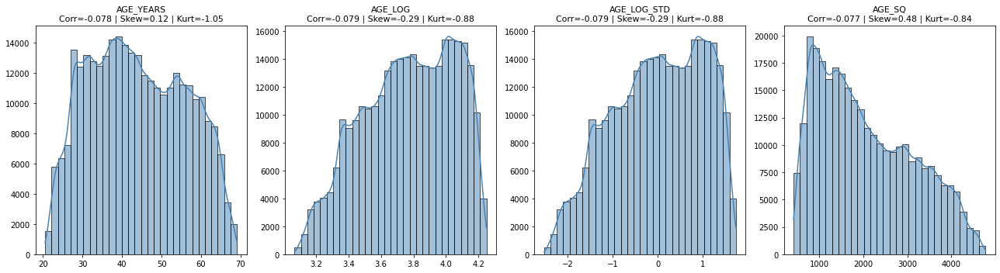

In [90]:
# Liste des transformations existantes pour AGE_YEARS

transfos = ['AGE_YEARS', 'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

- Ici on viusalise rapidement les distributions car il est plus optimal pour les modèles linéaires de travailler avec des distributions normales donc pour des corrélations avec la TARGET similaire on choisira la transformation (ou variable originale) qui a la distribution la mieux adaptée.
- Donc par exemple ici on gardera AGE_YEARS qui est la meilleure candidate.

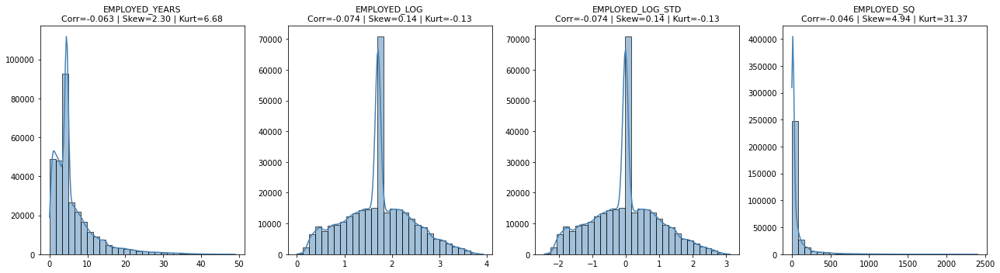

In [91]:
# Liste des transformations existantes pour EMPLOYED_YEARS

transfos = ['EMPLOYED_YEARS', 'EMPLOYED_LOG', 'EMPLOYED_LOG_STD', 'EMPLOYED_SQ']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

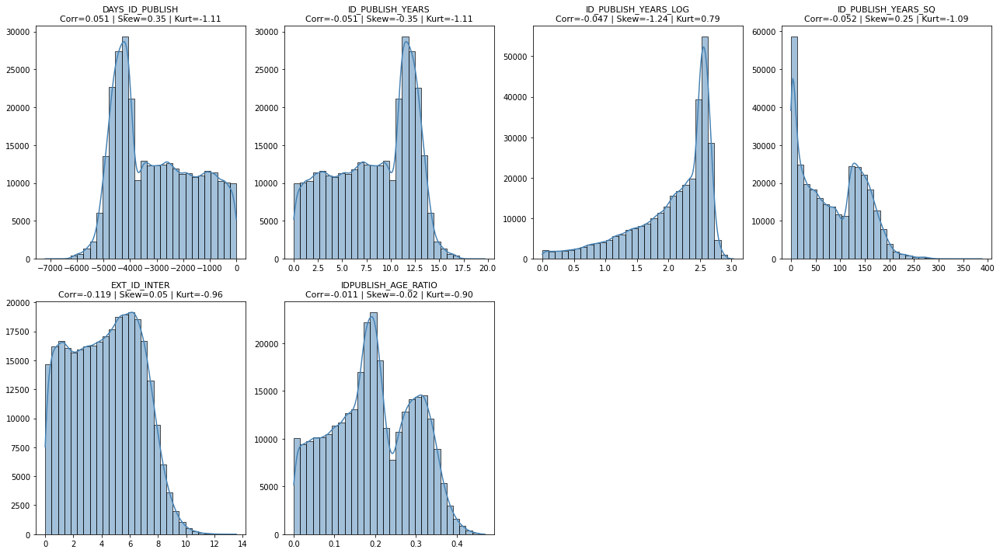

In [92]:
# Liste des transformations existantes pour DAYS_ID_PUBLISH

transfos = ['DAYS_ID_PUBLISH', 'ID_PUBLISH_YEARS', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS_SQ',
            'EXT_ID_INTER', 'IDPUBLISH_AGE_RATIO']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

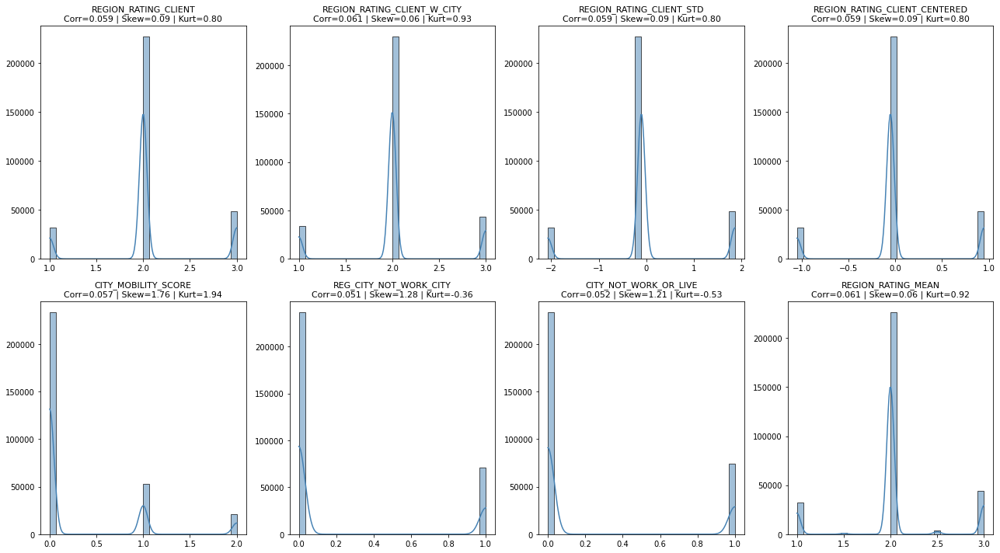

In [93]:
# Liste des transformations existantes pour REGION_RATING_CLIENT

transfos = ['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_STD', 'REGION_RATING_CLIENT_CENTERED', 'CITY_MOBILITY_SCORE',
            'REG_CITY_NOT_WORK_CITY', 'CITY_NOT_WORK_OR_LIVE', 'REGION_RATING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

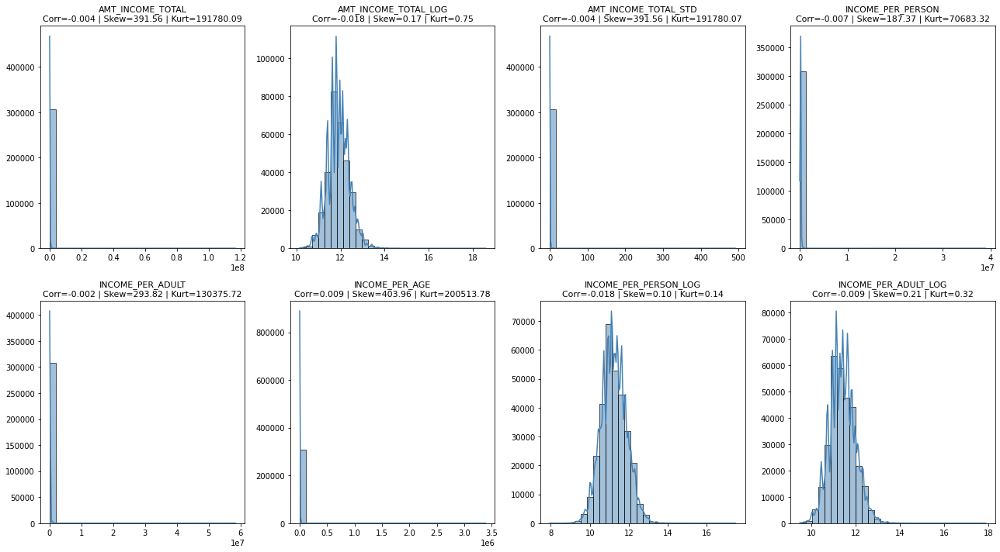

In [94]:
# Liste des transformations existantes pour AMT_INCOME_TOTAL

transfos = ['AMT_INCOME_TOTAL', 'AMT_INCOME_TOTAL_LOG', 'AMT_INCOME_TOTAL_STD', 'INCOME_PER_PERSON', 'INCOME_PER_ADULT', 
            'INCOME_PER_AGE', 'INCOME_PER_PERSON_LOG', 'INCOME_PER_ADULT_LOG']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

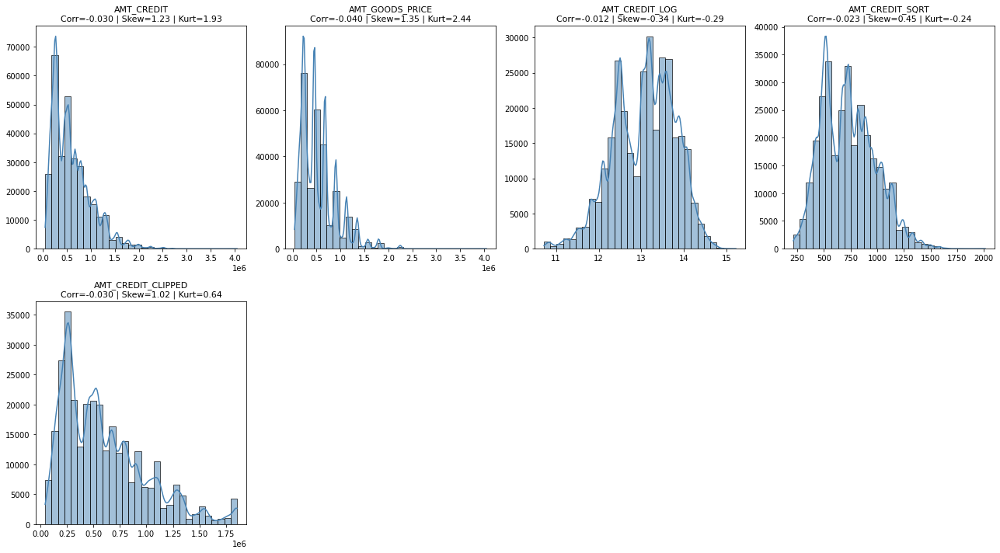

In [95]:
# Liste des transformations existantes pour AMT_CREDIT

transfos = ['AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_CREDIT_LOG', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

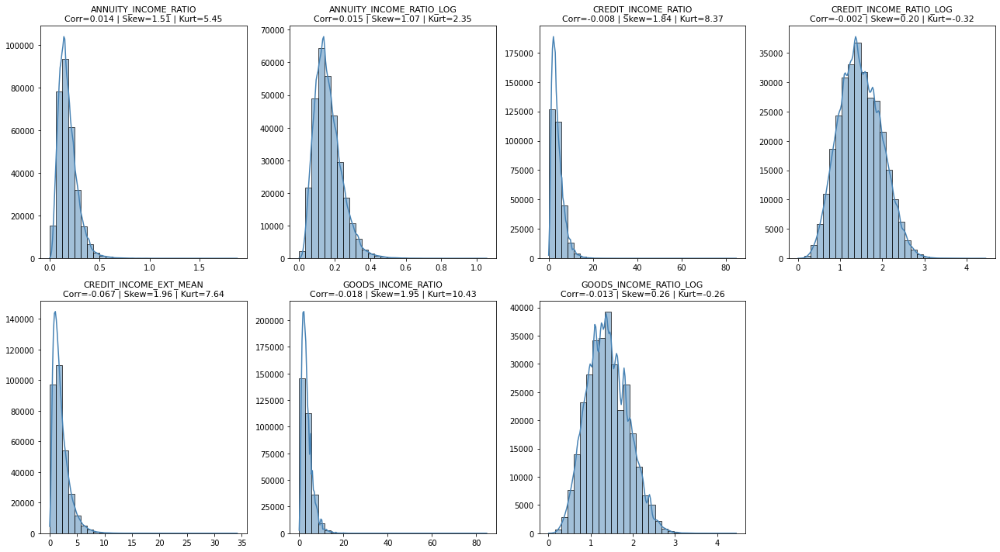

In [96]:
# Liste des transformations existantes pour ANNUITY_INCOME_RATIO

transfos = [ 'ANNUITY_INCOME_RATIO', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'CREDIT_INCOME_EXT_MEAN',
            'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

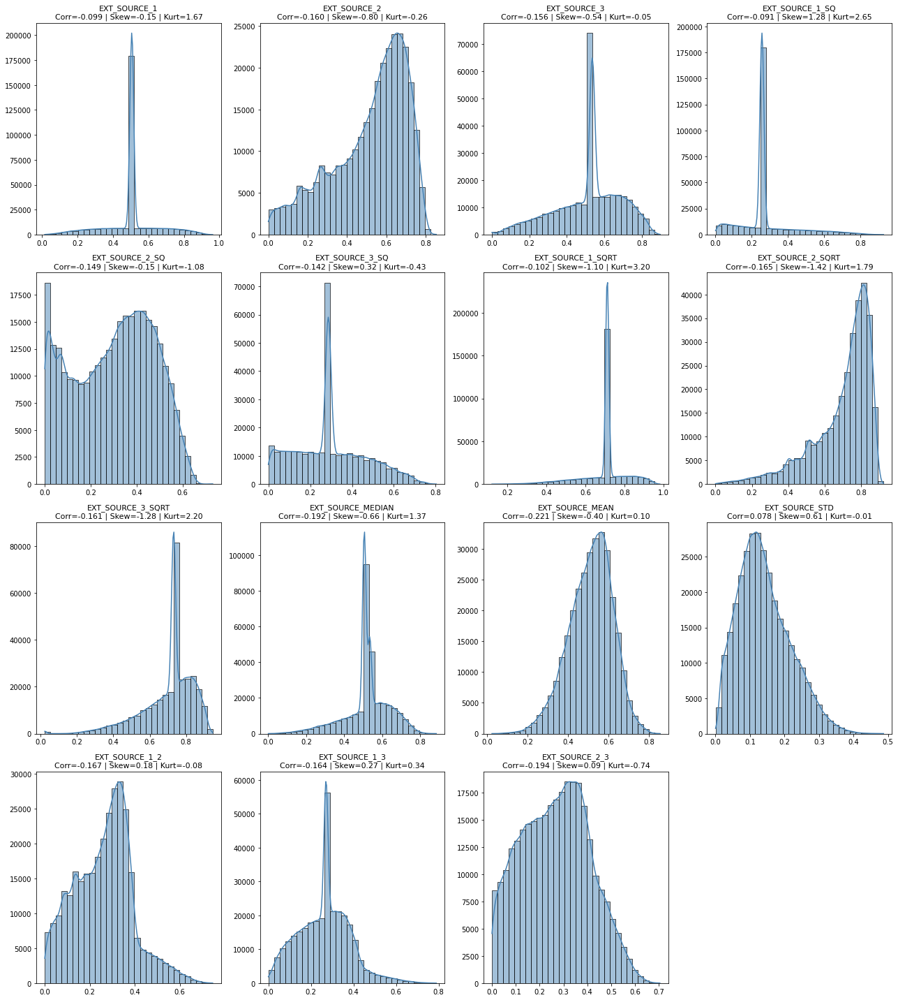

In [97]:
# Liste des transformations existantes pour EXT_SOURCE

transfos = ['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2_SQ', 'EXT_SOURCE_3_SQ',
            'EXT_SOURCE_1_SQRT', 'EXT_SOURCE_2_SQRT', 'EXT_SOURCE_3_SQRT', 'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_MEAN',
            'EXT_SOURCE_STD', 'EXT_SOURCE_1_2', 'EXT_SOURCE_1_3', 'EXT_SOURCE_2_3']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

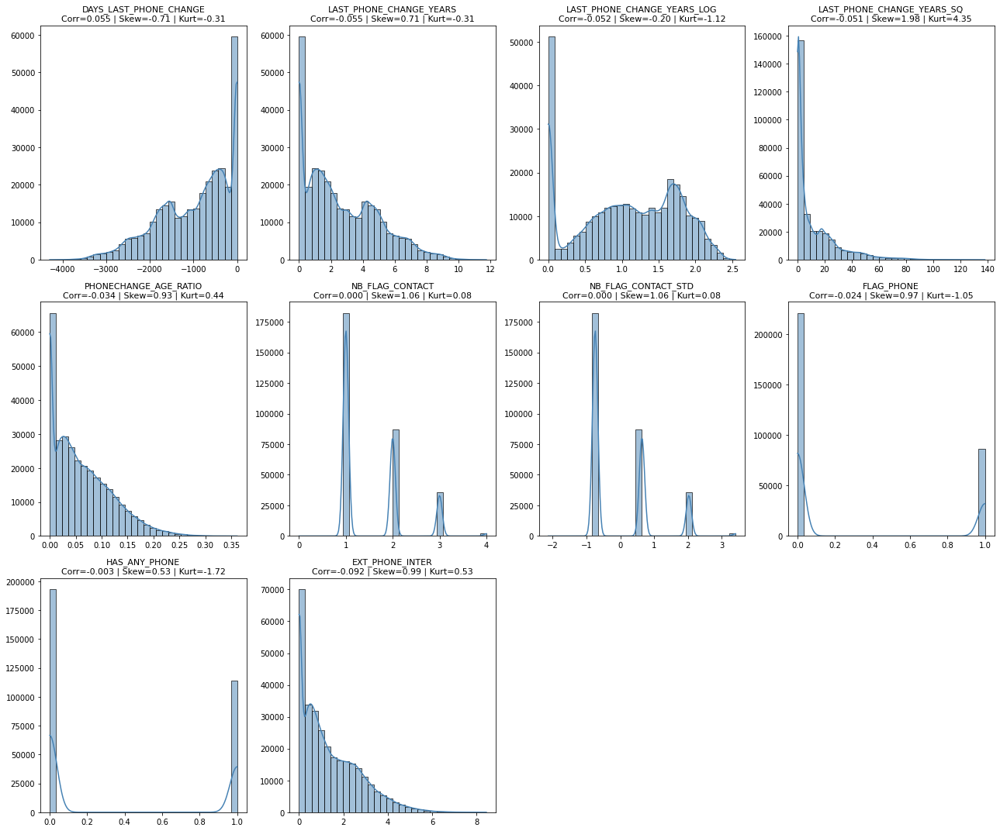

In [98]:
# Liste des transformations existantes pour LAST_PHONE_CHANGE_YEARS

transfos = ['DAYS_LAST_PHONE_CHANGE', 'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_LOG', 'LAST_PHONE_CHANGE_YEARS_SQ',
            'PHONECHANGE_AGE_RATIO', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD', 'FLAG_PHONE', 'HAS_ANY_PHONE', 'EXT_PHONE_INTER']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

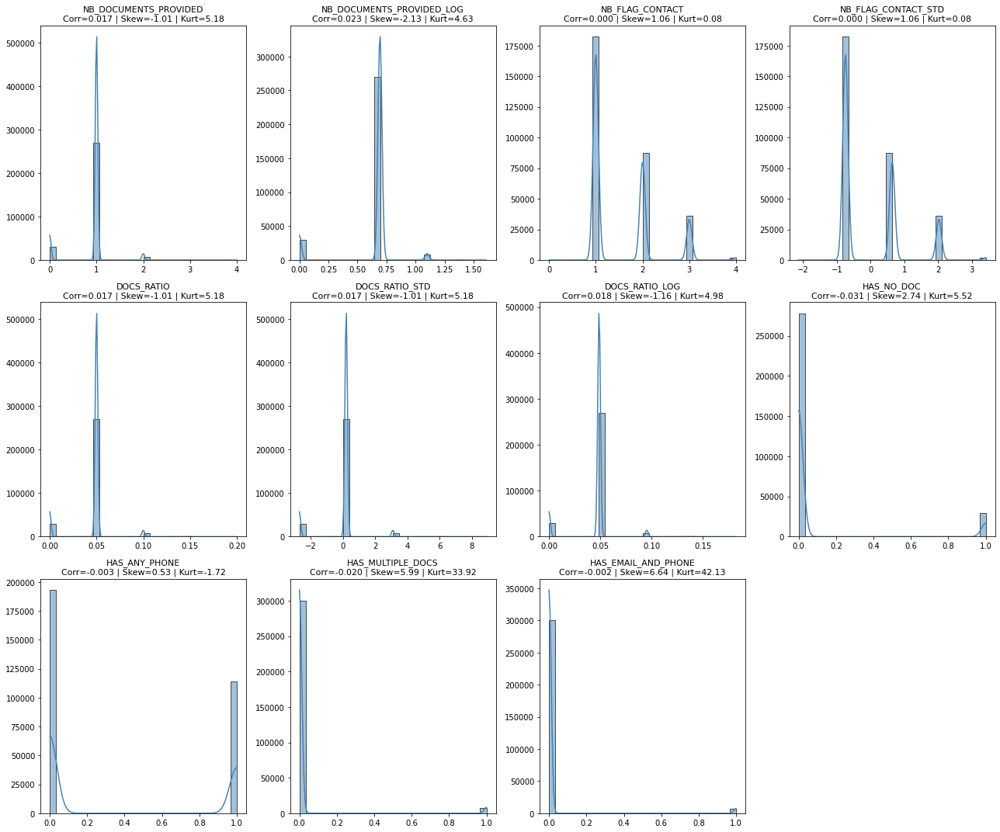

In [99]:
# Liste des transformations existantes pour NB_DOCUMENTS_PROVIDED

transfos = ['NB_DOCUMENTS_PROVIDED', 'NB_DOCUMENTS_PROVIDED_LOG', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD', 'DOCS_RATIO',
            'DOCS_RATIO_STD', 'DOCS_RATIO_LOG', 'HAS_NO_DOC', 'HAS_ANY_PHONE', 'HAS_MULTIPLE_DOCS', 'HAS_EMAIL_AND_PHONE']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [100]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN",

    "CITY_NOT_WORK_OR_LIVE", "CITY_MOBILITY_SCORE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE", "DEF_SOCIAL_MEAN",

    "ANNUITY_INCOME_RATIO", "ANNUITY_INCOME_RATIO_LOG", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "RATING_INCOME_INTER", "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "CHILDREN_RATIO", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EMERGENCYSTATE_MODE_Yes",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD",
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [101]:
# Vérification des fortes corrélations potentiellement restantes.
get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- Finalement après ce feature engineering, comme on peut le voir la plupart des variables créées sont supprimées au profit des variables initiales car il y a peu de différence entre l'information qu'elles apportent par rapport à la TARGET. Donc lorsque les corrélations des variables transformées à la Target sont quasiment identiques aux variables initiales, on préfera ces dernières qui sont plus facile à interpréter par la suite.
- On peut passer au dataframe suivant.

#### Feature engineering - df_train_iterative_mode_linear

In [102]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
2,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998489
3,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.986978
4,REGION_RATING_CLIENT / REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.950840
5,LIVINGAREA_MEDI / TOTALAREA_MODE,LIVINGAREA_MEDI,TOTALAREA_MODE,0.907733
6,APARTMENTS_MEDI / LIVINGAREA_MEDI,APARTMENTS_MEDI,LIVINGAREA_MEDI,0.894039
7,NAME_EDUCATION_TYPE_Higher education / NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,-0.888010
8,CNT_CHILDREN / CNT_FAM_MEMBERS,CNT_CHILDREN,CNT_FAM_MEMBERS,0.879154
9,APARTMENTS_MEDI / TOTALAREA_MODE,APARTMENTS_MEDI,TOTALAREA_MODE,0.871136


In [103]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_iterative_mode_linear)

In [104]:
optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 427.21 MB
 Mémoire après : 333.36 MB
 Gain : 22.0%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.05,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.04879
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.00,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.00000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.05,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.05,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.05,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.05,2,1,1,1.170319,0.641034,0.693147,0.202810,0.04879
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.05,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.04879


In [105]:
df_train_iterative_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 222 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(109), int32(94), object(2)
memory usage: 298.1+ MB


#### Corrélation des variables - df_train_iterative_mode_linear

In [106]:
get_correlation_pairs(df_train_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,AMT_INCOME_TOTAL / AMT_INCOME_TOTAL_STD,AMT_INCOME_TOTAL,AMT_INCOME_TOTAL_STD,1.000000
1,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS,-1.000000
2,EMPLOYED_LOG / EMPLOYED_LOG_STD,EMPLOYED_LOG,EMPLOYED_LOG_STD,1.000000
3,DAYS_REGISTRATION / REGISTRATION_YEARS,DAYS_REGISTRATION,REGISTRATION_YEARS,-1.000000
4,DAYS_EMPLOYED / EMPLOYED_YEARS,DAYS_EMPLOYED,EMPLOYED_YEARS,-1.000000
5,NB_FLAG_CONTACT / NB_FLAG_CONTACT_STD,NB_FLAG_CONTACT,NB_FLAG_CONTACT_STD,1.000000
6,CITY_MOBILITY_SCORE / CITY_MOBILITY_SCORE_STD,CITY_MOBILITY_SCORE,CITY_MOBILITY_SCORE_STD,1.000000
7,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
8,REGION_RATING_CLIENT / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT,REGION_RATING_CLIENT_STD,1.000000
9,REGION_RATING_CLIENT_CENTERED / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT_CENTERED,REGION_RATING_CLIENT_STD,1.000000


In [107]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear, method="pearson", style=False, threshold=0.8)

In [108]:
sorted(df_corr['Variable 1'].unique().tolist())

['AGE_LOG',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_INCOME_TOTAL_LOG',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_MEDI',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DOCS_RATIO',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_LOG',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_1',
 'EXT_SOURCE_1_3',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_1_SQRT',
 'EXT_SOURCE_2',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_3',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_MEAN',
 'EXT_SOURCE_MEDIAN',
 'FLAG_EMP_PHONE',
 'FLAG_PHONE',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG

In [109]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DEF_SOCIAL_MEAN',
 'DOCS_RATIO',
 'DOCS_RATIO_LOG',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMERGENCYSTATE_MODE_Yes',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'EXT_SOURCE_1_2',
 'EXT_SOURCE_1_3',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_1_SQRT',
 'EXT_SOURCE_2_3',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_2_SQRT',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_3_SQRT',
 'EXT_SOURCE_MEDIAN',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 

In [110]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode_linear, 'TARGET', mode='linear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
EXT_SOURCE_MEAN,-0.270353,-0.246455,0.270353,0.246455,0.258404
EXT_SOURCE_MEDIAN,-0.260258,-0.236830,0.260258,0.236830,0.248544
EXT_SOURCE_1_3,-0.224476,-0.229994,0.224476,0.229994,0.227235
EXT_SOURCE_2_3,-0.213311,-0.214230,0.213311,0.214230,0.213771
EXT_SOURCE_1_2,-0.204643,-0.205021,0.204643,0.205021,0.204832
EXT_SOURCE_1_SQRT,-0.204010,-0.195172,0.204010,0.195172,0.199591
EXT_SOURCE_3_SQRT,-0.203430,-0.194856,0.203430,0.194856,0.199143
EXT_SOURCE_1,-0.201204,-0.195172,0.201204,0.195172,0.198188
EXT_SOURCE_3,-0.200354,-0.194856,0.200354,0.194856,0.197605
EXT_SOURCE_1_SQ,-0.189925,-0.195172,0.189925,0.195172,0.192549


In [111]:
pd.reset_option('display.max_rows')

In [112]:
pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[AGE_LOG_STD, EXT_AGE_INTER, AGE_YEARS, EXT_SOURCE_1_SQ, EXT_SOURCE_MEDIAN, EXT_SOURCE_MEAN, AGE_LOG, EXT_SOURCE_1, AGE_SQ, EXT_SOURCE_1_2, EXT_SOURCE_1_SQRT, EXT_SOURCE_1_3, DAYS_BIRTH, EXT_SOURCE_2_3]",14,0.270353,EXT_SOURCE_MEAN
1,"[RATING_INCOME_INTER, INCOME_PER_AGE, INCOME_AGE_INTER, AMT_INCOME_TOTAL_STD, AMT_INCOME_TOTAL, INCOME_PER_ADULT, INCOME_PER_PERSON]",7,0.020419,INCOME_AGE_INTER
2,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",7,0.126959,EXT_EMPLOYED_INTER
3,"[NB_DOCUMENTS_PROVIDED, DOCS_RATIO, NAME_CONTRACT_TYPE, HAS_NO_DOC, DOCS_RATIO_STD, NB_DOCUMENTS_PROVIDED_LOG, DOCS_RATIO_LOG]",7,0.030868,NAME_CONTRACT_TYPE
4,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS, IDPUBLISH_AGE_RATIO, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH]",6,0.142316,EXT_ID_INTER
5,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.107417,EXT_REG_INTER
6,"[LIVE_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",6,0.064119,MOBILITY_RATING_INTER
7,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.104569,EXT_PHONE_INTER
8,"[GOODS_INCOME_RATIO_LOG, GOODS_INCOME_RATIO, CREDIT_INCOME_RATIO_LOG, CREDIT_INCOME_EXT_MEAN, CREDIT_INCOME_RATIO]",5,0.087855,CREDIT_INCOME_EXT_MEAN
9,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039651,AMT_GOODS_PRICE


In [113]:
pd.reset_option('display.max_colwidth')

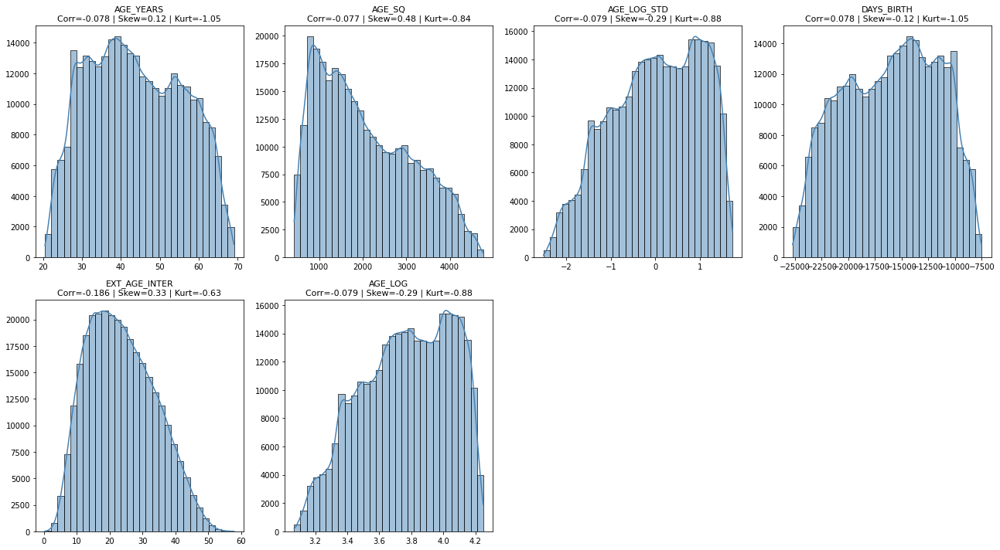

In [114]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_YEARS', 'AGE_SQ', 'AGE_LOG_STD', 'DAYS_BIRTH', 'EXT_AGE_INTER', 'AGE_LOG']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

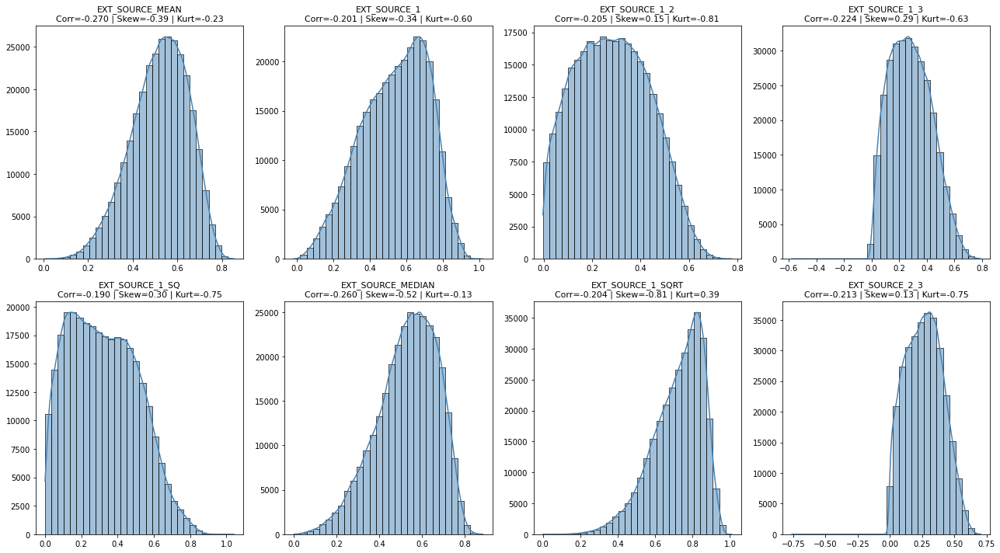

In [115]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_MEAN', 'EXT_SOURCE_1', 'EXT_SOURCE_1_2', 'EXT_SOURCE_1_3', 'EXT_SOURCE_1_SQ', 
            'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_1_SQRT', 'EXT_SOURCE_2_3']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

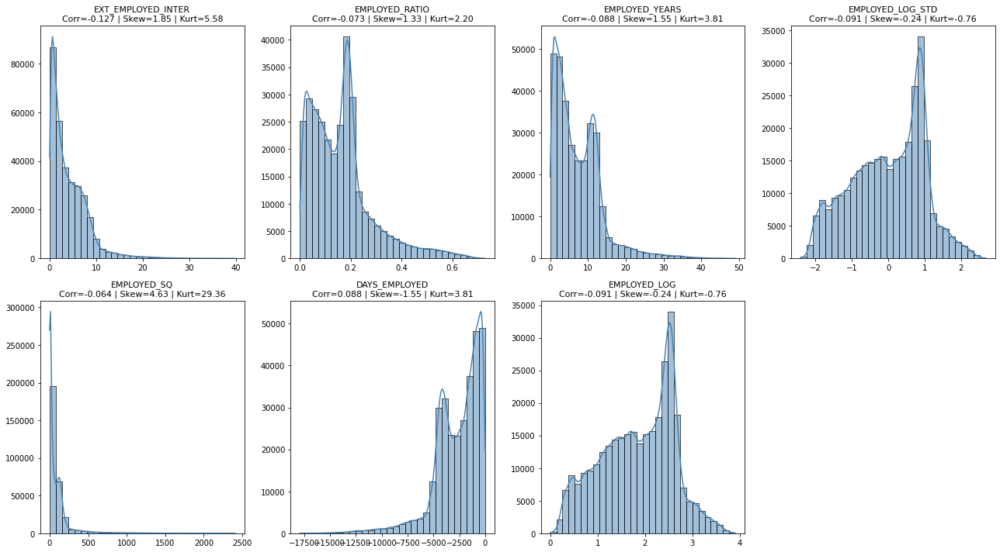

In [116]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_EMPLOYED_INTER', 'EMPLOYED_RATIO', 'EMPLOYED_YEARS', 'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 
            'DAYS_EMPLOYED', 'EMPLOYED_LOG']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

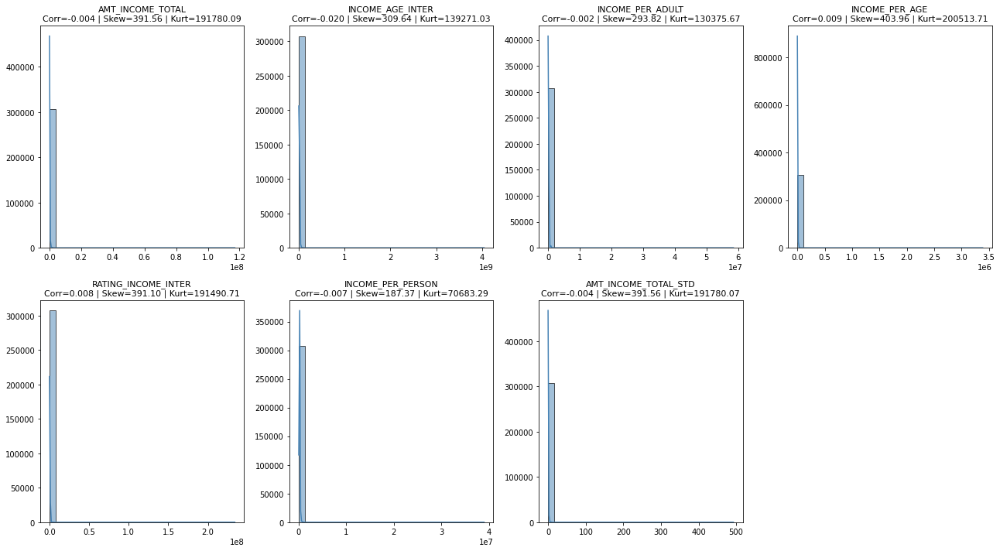

In [ ]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_INCOME_TOTAL', 'INCOME_AGE_INTER', 'INCOME_PER_ADULT', 'INCOME_PER_AGE', 'RATING_INCOME_INTER',
            'INCOME_PER_PERSON', 'AMT_INCOME_TOTAL_STD'] 

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,  
    var_list=transfos,
    target='TARGET'
)

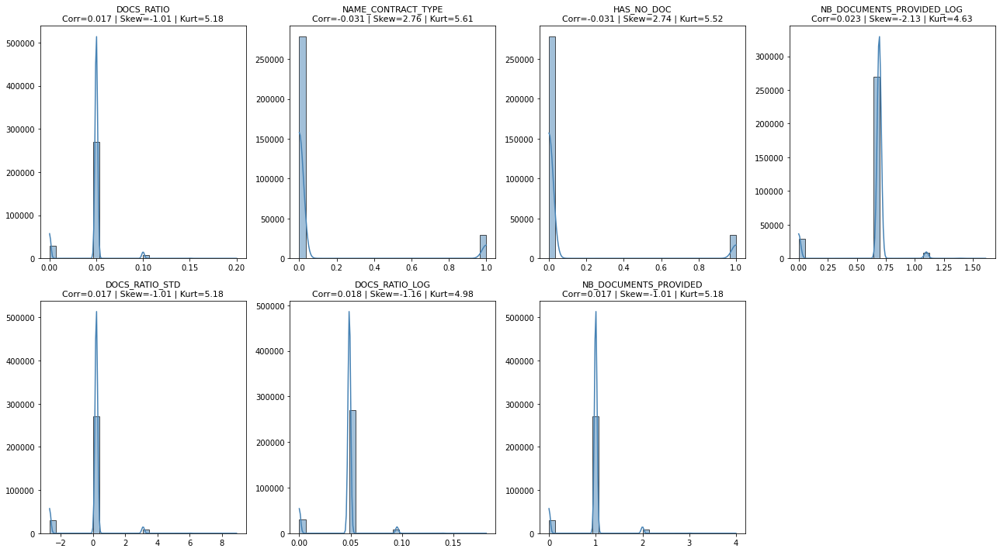

In [118]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DOCS_RATIO', 'NAME_CONTRACT_TYPE', 'HAS_NO_DOC', 'NB_DOCUMENTS_PROVIDED_LOG', 'DOCS_RATIO_STD',
            'DOCS_RATIO_LOG', 'NB_DOCUMENTS_PROVIDED']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,   #'NAME_CONTRACT_TYPE', 'NB_DOCUMENTS_PROVIDED'
    var_list=transfos,
    target='TARGET'
)

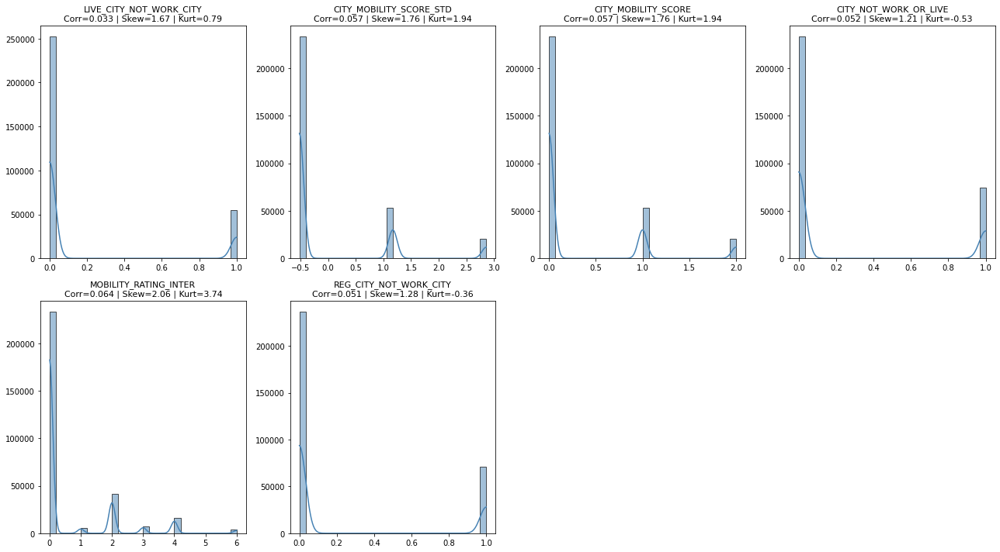

In [119]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LIVE_CITY_NOT_WORK_CITY', 'CITY_MOBILITY_SCORE_STD', 'CITY_MOBILITY_SCORE', 'CITY_NOT_WORK_OR_LIVE', 
            'MOBILITY_RATING_INTER', 'REG_CITY_NOT_WORK_CITY']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,    # 'CITY_MOBILITY_SCORE' 'LIVE_CITY_NOT_WORK_CITY'
    var_list=transfos,
    target='TARGET'
)

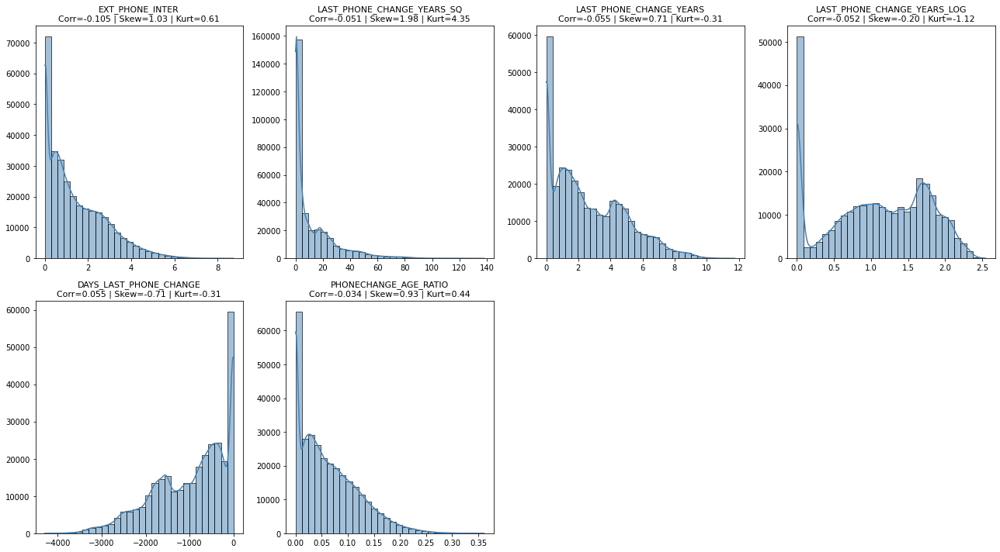

In [120]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_PHONE_INTER', 'LAST_PHONE_CHANGE_YEARS_SQ', 'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_LOG', 
            'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

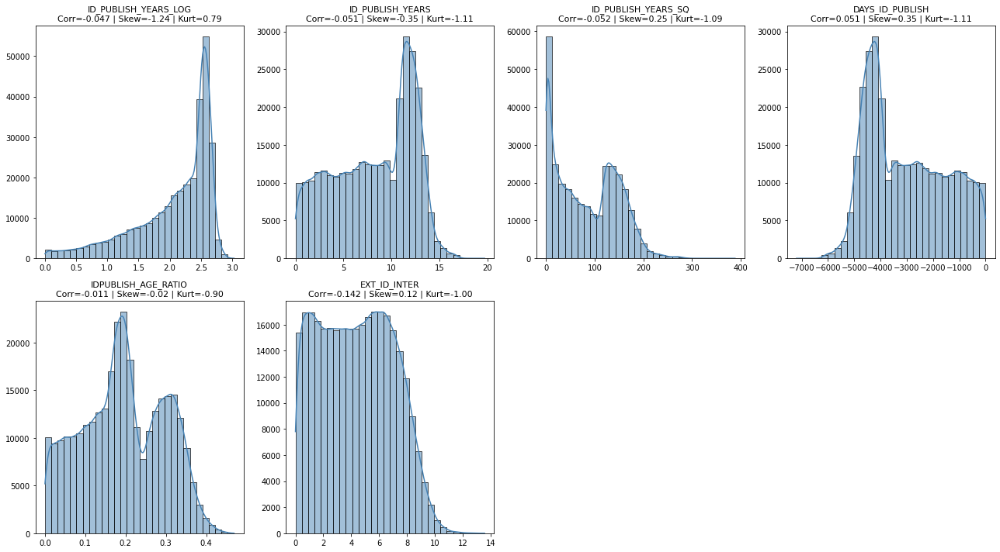

In [121]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS', 'ID_PUBLISH_YEARS_SQ', 'DAYS_ID_PUBLISH', 
            'IDPUBLISH_AGE_RATIO', 'EXT_ID_INTER']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

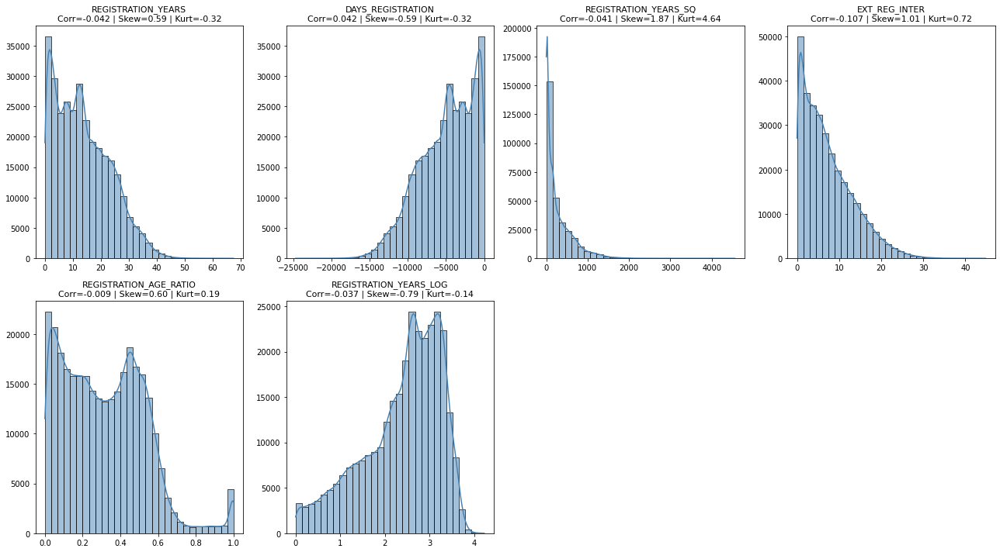

In [122]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS', 'DAYS_REGISTRATION', 'REGISTRATION_YEARS_SQ', 'EXT_REG_INTER', 
            'REGISTRATION_AGE_RATIO', 'REGISTRATION_YEARS_LOG']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

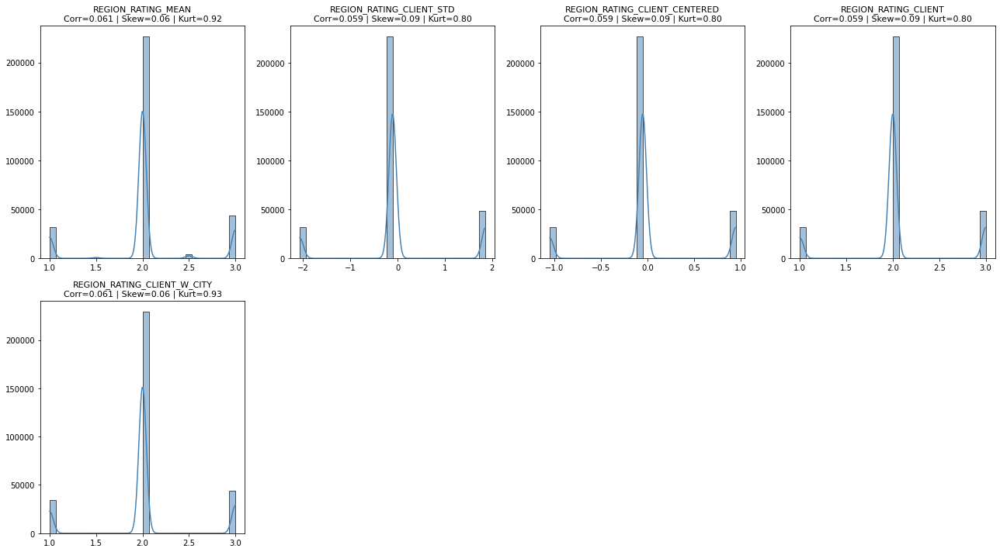

In [123]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_MEAN', 'REGION_RATING_CLIENT_STD', 'REGION_RATING_CLIENT_CENTERED', 
            'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

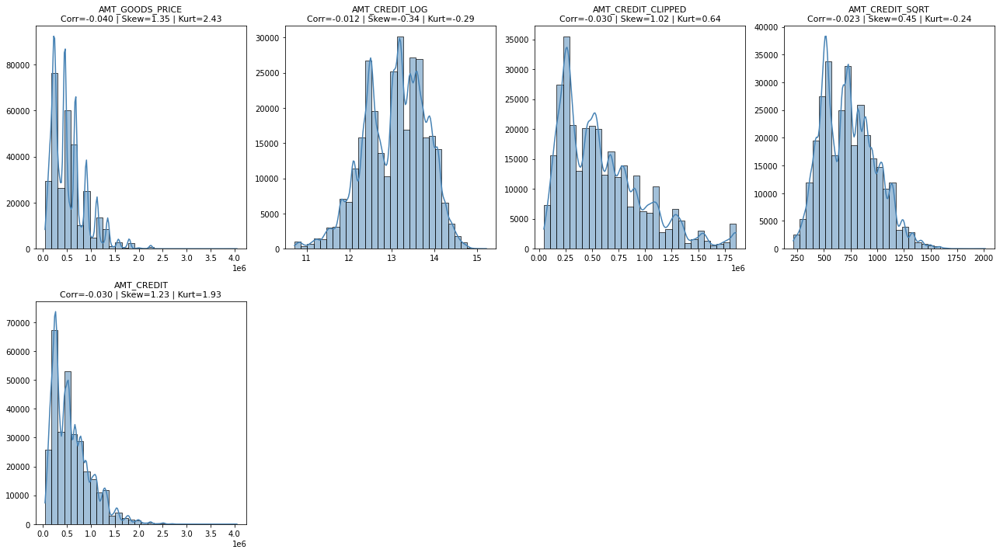

In [124]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_GOODS_PRICE', 'AMT_CREDIT_LOG', 'AMT_CREDIT_CLIPPED', 'AMT_CREDIT_SQRT', 'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

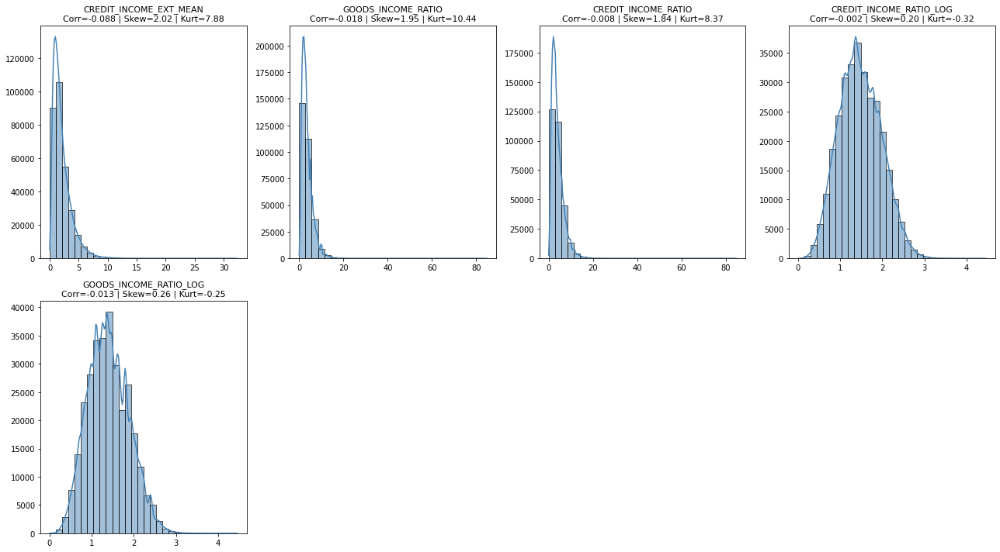

In [125]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_INCOME_EXT_MEAN', 'GOODS_INCOME_RATIO', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 
            'GOODS_INCOME_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

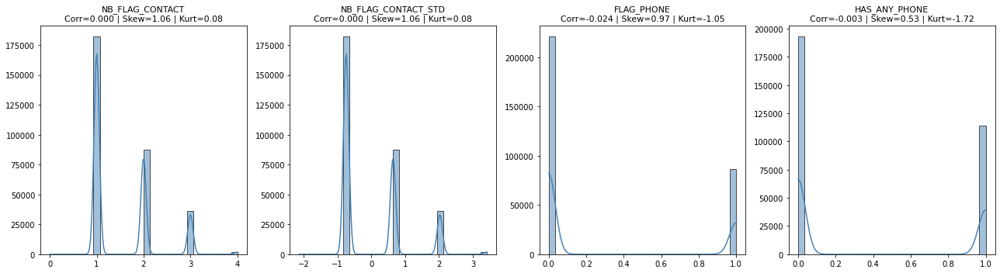

In [126]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD', 'FLAG_PHONE', 'HAS_ANY_PHONE']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

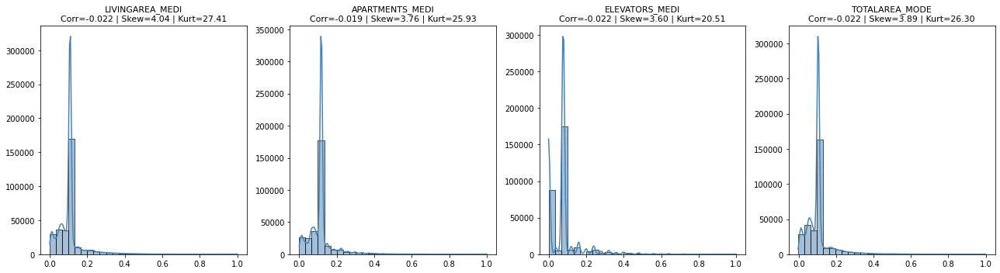

In [127]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LIVINGAREA_MEDI', 'APARTMENTS_MEDI', 'ELEVATORS_MEDI', 'TOTALAREA_MODE']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

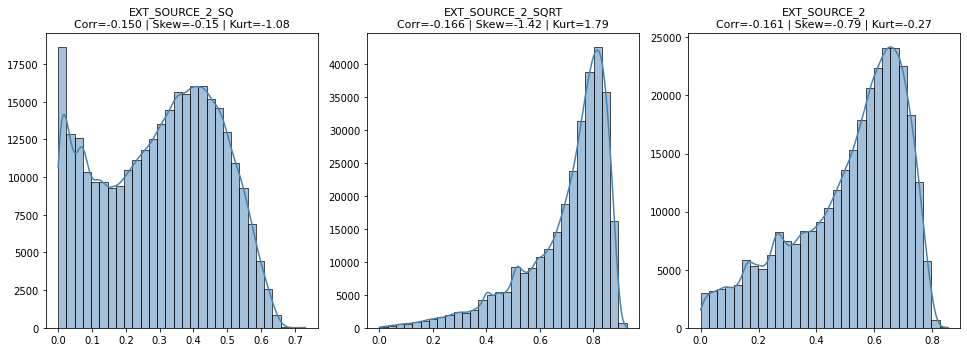

In [128]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_2_SQ', 'EXT_SOURCE_2_SQRT', 'EXT_SOURCE_2']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

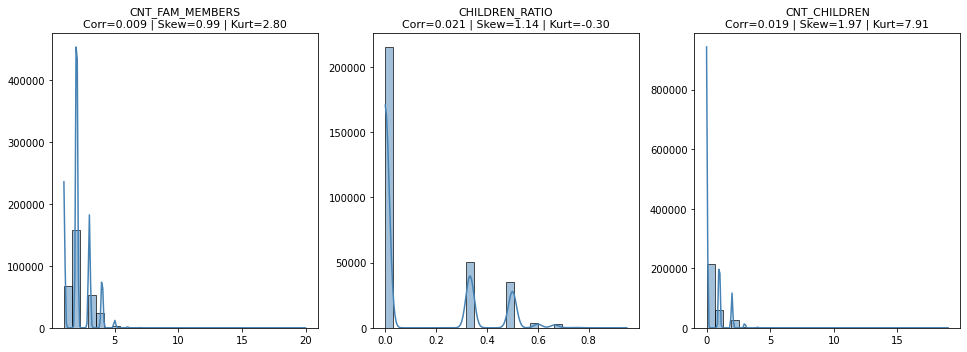

In [129]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CNT_FAM_MEMBERS', 'CHILDREN_RATIO', 'CNT_CHILDREN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

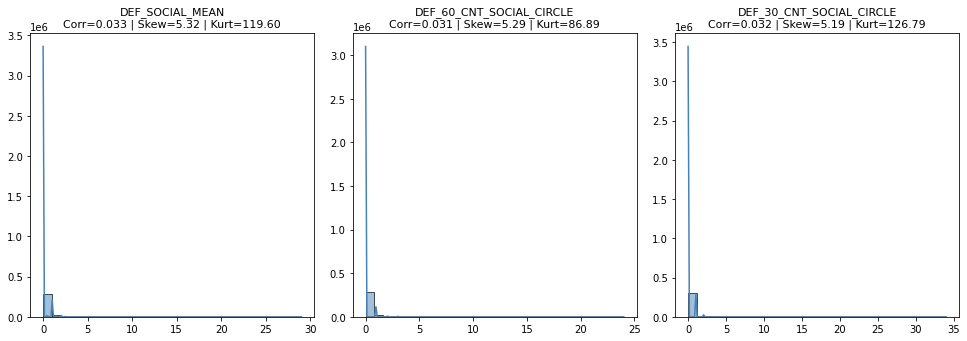

In [130]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DEF_SOCIAL_MEAN', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

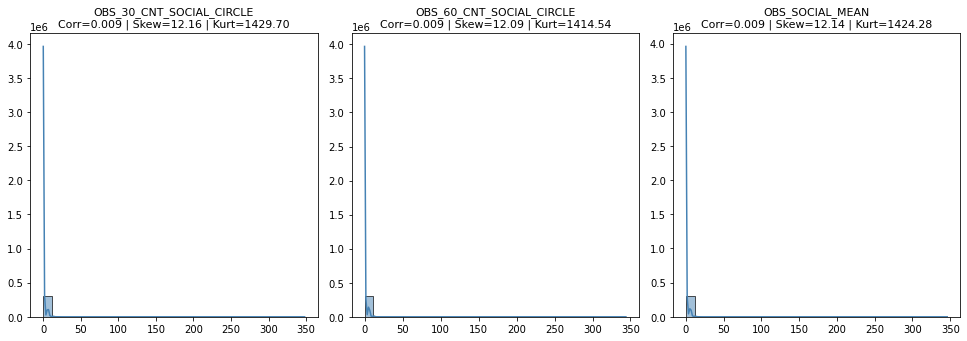

In [131]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_SOCIAL_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

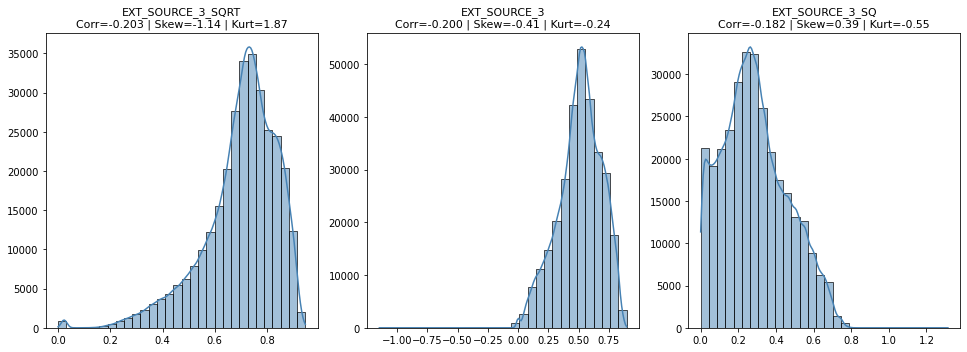

In [132]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_3_SQRT', 'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

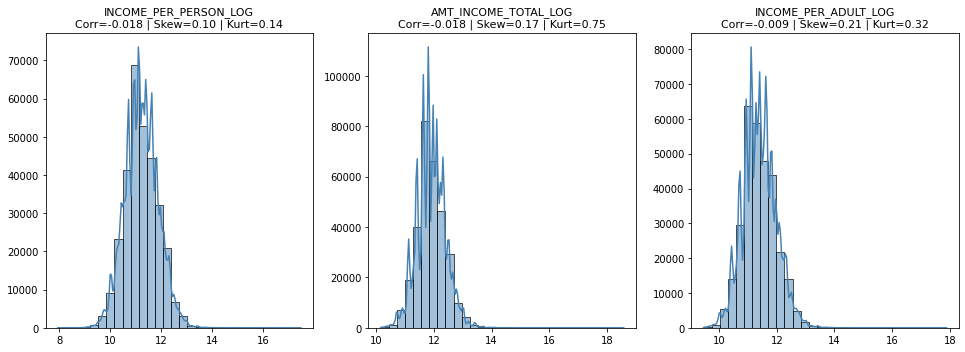

In [ ]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['INCOME_PER_PERSON_LOG', 'AMT_INCOME_TOTAL_LOG', 'INCOME_PER_ADULT_LOG']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,  
    var_list=transfos,
    target='TARGET'
)

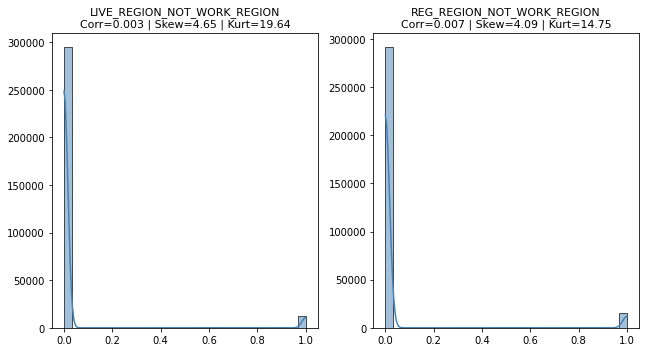

In [ ]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LIVE_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_WORK_REGION']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

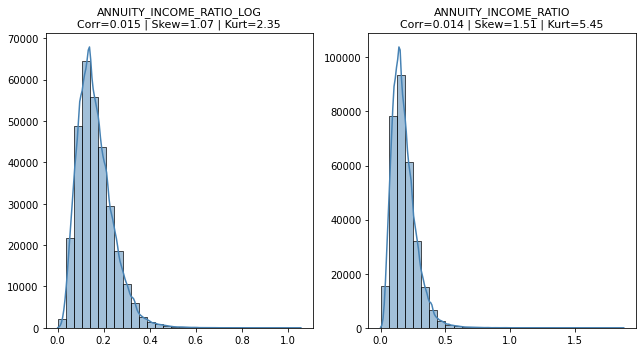

In [ ]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ANNUITY_INCOME_RATIO_LOG', 'ANNUITY_INCOME_RATIO']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

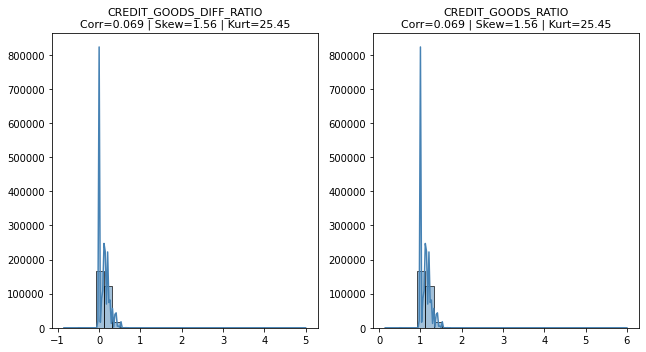

In [136]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_GOODS_DIFF_RATIO', 'CREDIT_GOODS_RATIO']	

plot_transformations_distributions(
    df=df_train_iterative_mode_linear, 
    var_list=transfos,
    target='TARGET'
)

In [137]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN",

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'LIVE_REGION_NOT_WORK_REGION',

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER", "EMERGENCYSTATE_MODE_Yes"
]

df_train_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [138]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- On peut passer au dataframe suivant

#### Feature engineering - df_train_median_missing_linear

In [139]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
1,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998491
2,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.986737
3,REGION_RATING_CLIENT / REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.950840
4,HOUSETYPE_MODE_block of flats / WALLSMATERIAL_MODE_MISSING,HOUSETYPE_MODE_block of flats,WALLSMATERIAL_MODE_MISSING,-0.941783
5,EMERGENCYSTATE_MODE_No / WALLSMATERIAL_MODE_MISSING,WALLSMATERIAL_MODE_MISSING,EMERGENCYSTATE_MODE_No,-0.924398
6,EMERGENCYSTATE_MODE_No / HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_block of flats,EMERGENCYSTATE_MODE_No,0.915006
7,LIVINGAREA_MEDI / TOTALAREA_MODE,LIVINGAREA_MEDI,TOTALAREA_MODE,0.911369
8,APARTMENTS_MEDI / LIVINGAREA_MEDI,APARTMENTS_MEDI,LIVINGAREA_MEDI,0.898035
9,NAME_EDUCATION_TYPE_Higher education / NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,-0.888010


In [140]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_median_missing_linear)

In [141]:
optimize_types(df_train_median_missing_linear)

 Mémoire avant : 442.36 MB
 Mémoire après : 333.27 MB
 Gain : 24.7%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.05,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.04879
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.00,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.00000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.05,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.05,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.05,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.05,2,1,1,1.170319,0.641034,0.693147,0.202810,0.04879
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.05,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.04879


In [142]:
df_train_median_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 222 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(96), int32(107), object(2)
memory usage: 298.1+ MB


#### Corrélation des variables - df_train_median_missing_linear

In [143]:
get_correlation_pairs(df_train_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,AMT_INCOME_TOTAL / AMT_INCOME_TOTAL_STD,AMT_INCOME_TOTAL,AMT_INCOME_TOTAL_STD,1.000000
1,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS,-1.000000
2,DAYS_REGISTRATION / REGISTRATION_YEARS,DAYS_REGISTRATION,REGISTRATION_YEARS,-1.000000
3,NB_FLAG_CONTACT / NB_FLAG_CONTACT_STD,NB_FLAG_CONTACT,NB_FLAG_CONTACT_STD,1.000000
4,CITY_MOBILITY_SCORE / CITY_MOBILITY_SCORE_STD,CITY_MOBILITY_SCORE,CITY_MOBILITY_SCORE_STD,1.000000
5,REGION_RATING_CLIENT / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT,REGION_RATING_CLIENT_STD,1.000000
6,REGION_RATING_CLIENT_CENTERED / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT_CENTERED,REGION_RATING_CLIENT_STD,1.000000
7,EMPLOYED_LOG / EMPLOYED_LOG_STD,EMPLOYED_LOG,EMPLOYED_LOG_STD,1.000000
8,AGE_YEARS / DAYS_BIRTH,DAYS_BIRTH,AGE_YEARS,-1.000000
9,DOCS_RATIO / NB_DOCUMENTS_PROVIDED,NB_DOCUMENTS_PROVIDED,DOCS_RATIO,1.000000


In [144]:
df_corr = get_correlation_pairs(df_train_median_missing_linear, method="pearson", style=False, threshold=0.8)

In [145]:
sorted(df_corr['Variable 1'].unique().tolist())

['AGE_LOG',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_INCOME_TOTAL_LOG',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_MEDI',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DOCS_RATIO',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMPLOYED_LOG',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_1',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_2',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_3',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_MEAN',
 'FLAG_EMP_PHONE',
 'FLAG_PHONE',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HAS_NO_DOC',
 'HOUSETYPE_MODE_block of flats',
 'ID_PUBLISH_YEARS',

In [146]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_EMPLOYED_INTER',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DEF_SOCIAL_MEAN',
 'DOCS_RATIO',
 'DOCS_RATIO_LOG',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'EXT_SOURCE_1_2',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_1_SQRT',
 'EXT_SOURCE_2_3',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_2_SQRT',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_3_SQRT',
 'EXT_SOURCE_MEDIAN',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PH

In [147]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()

In [148]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing_linear, 'TARGET', mode='linear', plot=False)
target_corr

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
EXT_SOURCE_MEAN,-0.220839,-0.204810,0.220839,0.204810,0.212825
EXT_SOURCE_2_3,-0.193932,-0.192087,0.193932,0.192087,0.193009
EXT_SOURCE_MEDIAN,-0.192486,-0.174847,0.192486,0.174847,0.183666
EXT_AGE_INTER,-0.166721,-0.167164,0.166721,0.167164,0.166943
EXT_SOURCE_1_2,-0.166612,-0.164183,0.166612,0.164183,0.165398
EXT_SOURCE_1_3,-0.164080,-0.160658,0.164080,0.160658,0.162369
EXT_SOURCE_2_SQRT,-0.165424,-0.147112,0.165424,0.147112,0.156268
EXT_SOURCE_2,-0.160274,-0.147112,0.160274,0.147112,0.153693
EXT_SOURCE_3_SQRT,-0.160568,-0.141506,0.160568,0.141506,0.151037
EXT_SOURCE_3,-0.155906,-0.141506,0.155906,0.141506,0.148706


In [149]:
pd.reset_option('display.max_rows')

In [150]:
pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, ANNUITY_EMPLOYED_INTER, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",8,0.094129,EXT_EMPLOYED_INTER
1,"[RATING_INCOME_INTER, INCOME_PER_AGE, INCOME_AGE_INTER, AMT_INCOME_TOTAL_STD, AMT_INCOME_TOTAL, INCOME_PER_ADULT, INCOME_PER_PERSON]",7,0.020419,INCOME_AGE_INTER
2,"[EXT_SOURCE_MEDIAN, EXT_SOURCE_2_SQRT, EXT_SOURCE_2, EXT_SOURCE_1_2, EXT_SOURCE_2_SQ, EXT_SOURCE_MEAN, EXT_SOURCE_2_3]",7,0.220839,EXT_SOURCE_MEAN
3,"[NB_DOCUMENTS_PROVIDED, DOCS_RATIO, NAME_CONTRACT_TYPE, HAS_NO_DOC, DOCS_RATIO_STD, NB_DOCUMENTS_PROVIDED_LOG, DOCS_RATIO_LOG]",7,0.030868,NAME_CONTRACT_TYPE
4,"[LIVE_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",6,0.064119,MOBILITY_RATING_INTER
5,"[AGE_LOG_STD, EXT_AGE_INTER, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",6,0.166721,EXT_AGE_INTER
6,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.092372,EXT_PHONE_INTER
7,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS, IDPUBLISH_AGE_RATIO, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH]",6,0.119040,EXT_ID_INTER
8,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.090981,EXT_REG_INTER
9,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY


In [151]:
pd.reset_option('display.max_colwidth')

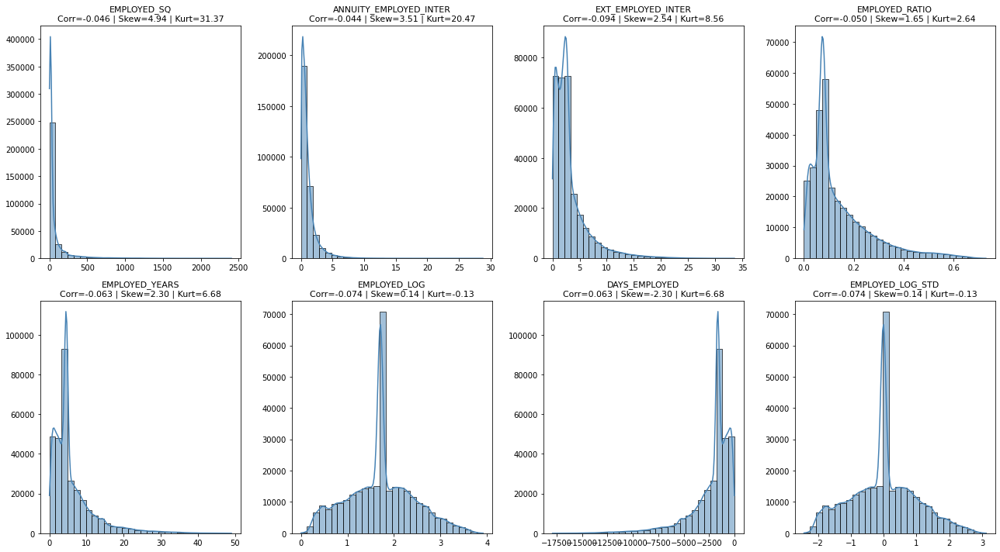

In [152]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_SQ', 'ANNUITY_EMPLOYED_INTER', 'EXT_EMPLOYED_INTER', 'EMPLOYED_RATIO', 'EMPLOYED_YEARS', 
            'EMPLOYED_LOG', 'DAYS_EMPLOYED', 'EMPLOYED_LOG_STD']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

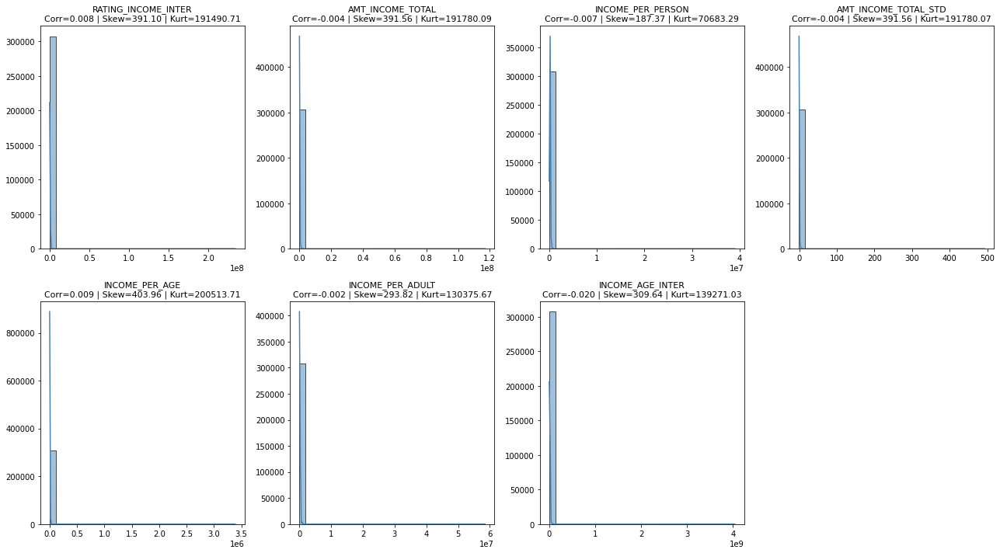

In [153]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['RATING_INCOME_INTER', 'AMT_INCOME_TOTAL', 'INCOME_PER_PERSON', 'AMT_INCOME_TOTAL_STD', 'INCOME_PER_AGE', 
            'INCOME_PER_ADULT', 'INCOME_AGE_INTER']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

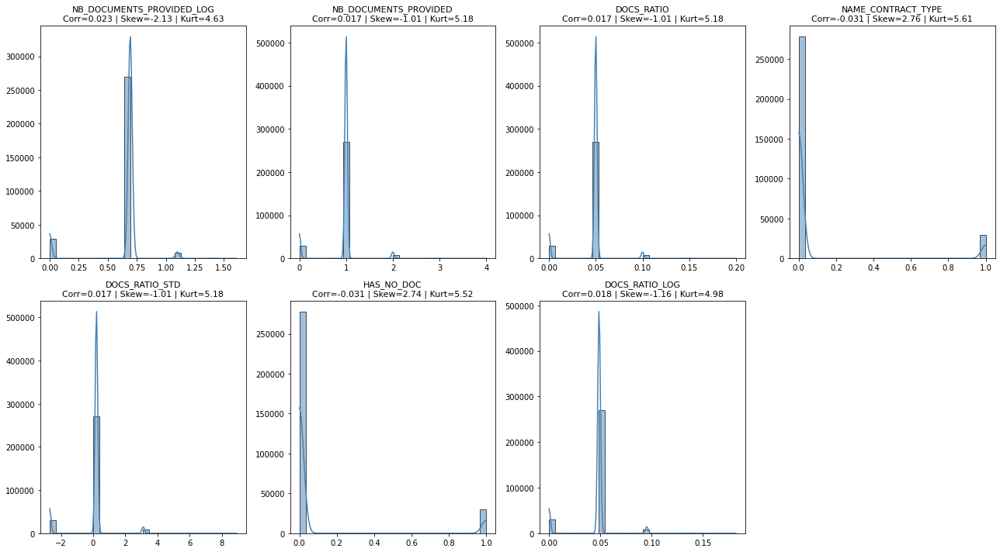

In [154]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_DOCUMENTS_PROVIDED_LOG', 'NB_DOCUMENTS_PROVIDED', 'DOCS_RATIO', 'NAME_CONTRACT_TYPE', 'DOCS_RATIO_STD', 
            'HAS_NO_DOC', 'DOCS_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

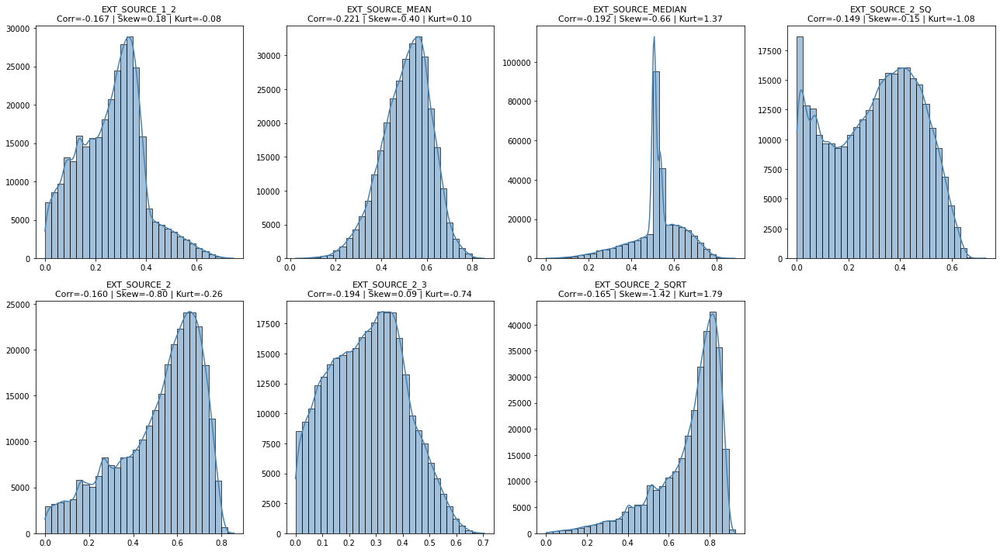

In [155]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_1_2', 'EXT_SOURCE_MEAN', 'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_2_SQ', 'EXT_SOURCE_2', 
            'EXT_SOURCE_2_3', 'EXT_SOURCE_2_SQRT']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

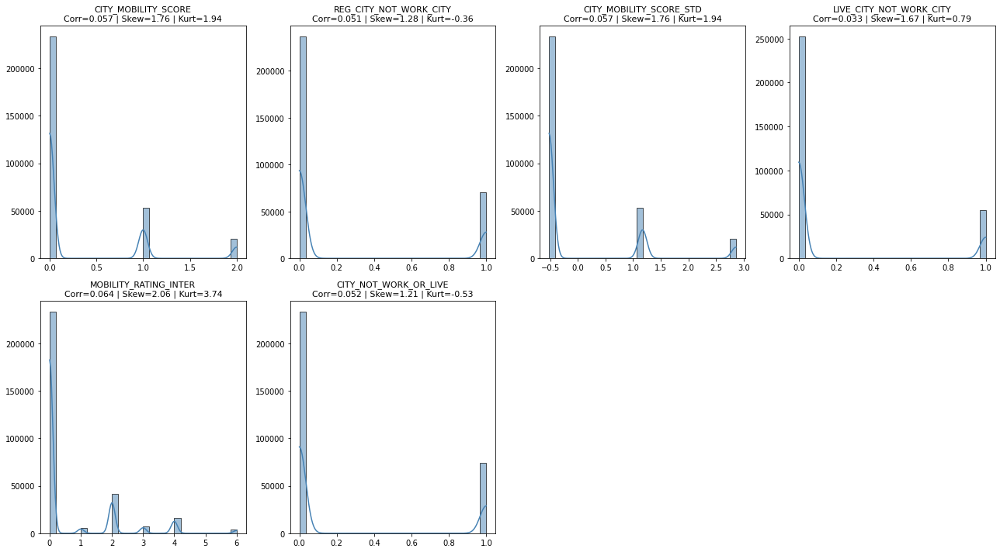

In [156]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'CITY_MOBILITY_SCORE_STD', 'LIVE_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER', 
            'CITY_NOT_WORK_OR_LIVE']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

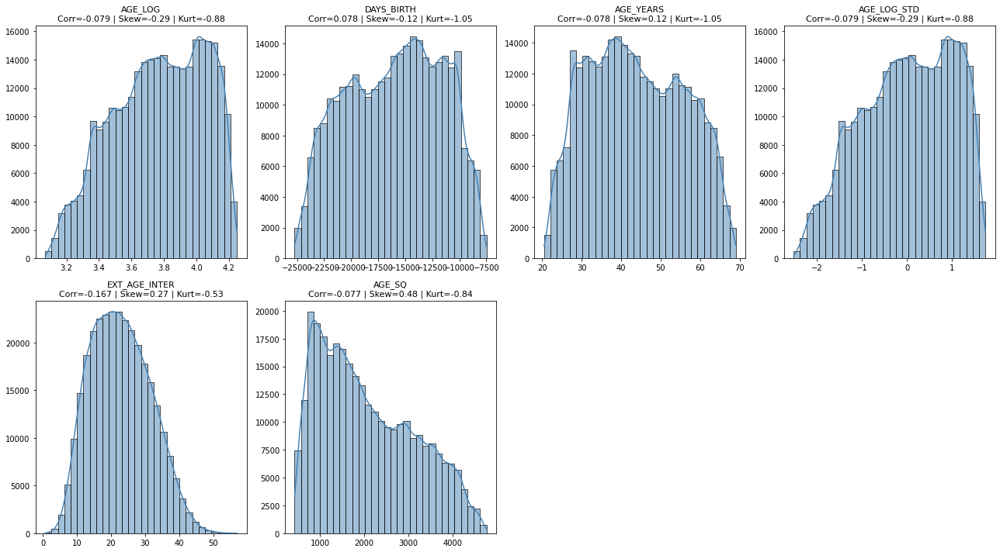

In [157]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG', 'DAYS_BIRTH', 'AGE_YEARS', 'AGE_LOG_STD', 'EXT_AGE_INTER', 
            'AGE_SQ']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

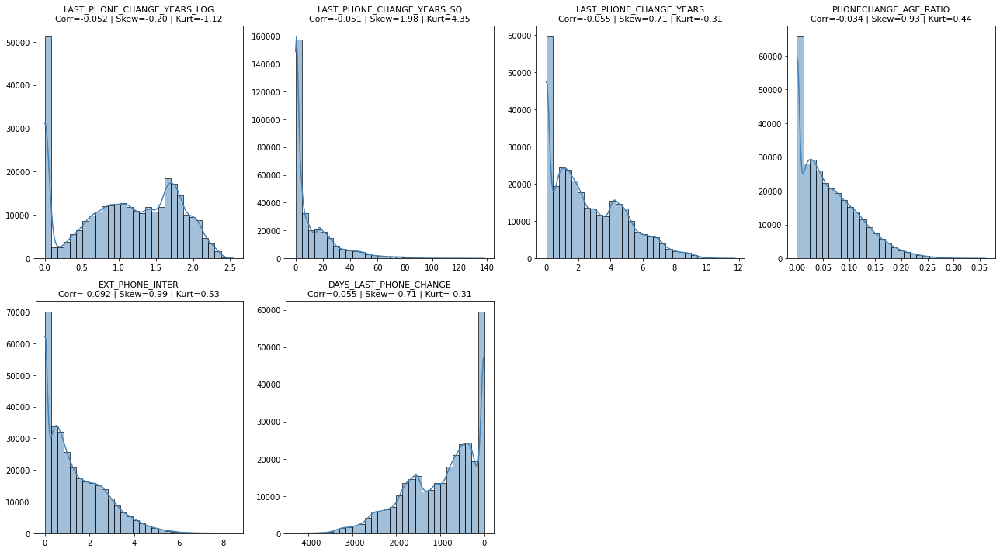

In [158]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LAST_PHONE_CHANGE_YEARS_LOG', 'LAST_PHONE_CHANGE_YEARS_SQ', 'LAST_PHONE_CHANGE_YEARS', 'PHONECHANGE_AGE_RATIO', 'EXT_PHONE_INTER', 
            'DAYS_LAST_PHONE_CHANGE']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

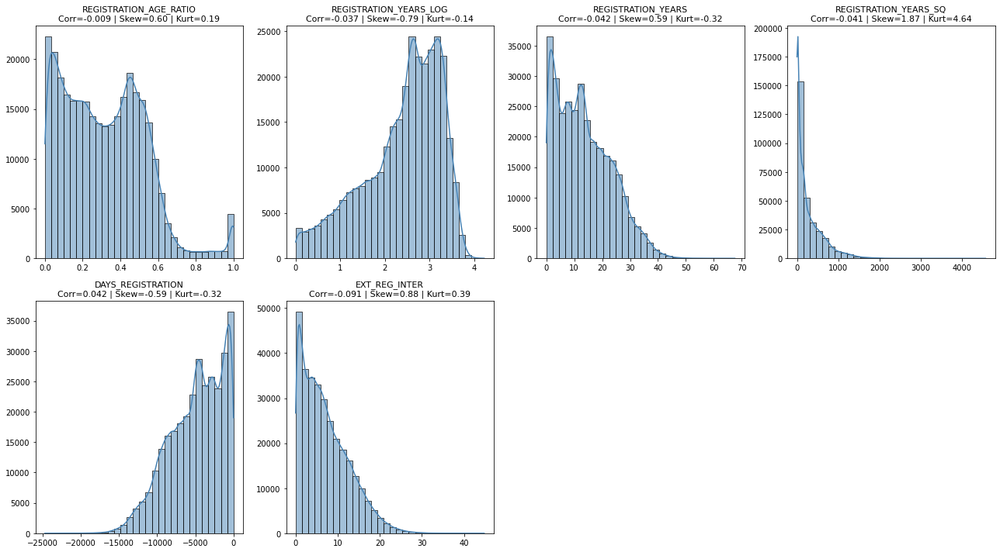

In [159]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_AGE_RATIO', 'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'REGISTRATION_YEARS_SQ', 'DAYS_REGISTRATION', 
            'EXT_REG_INTER']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

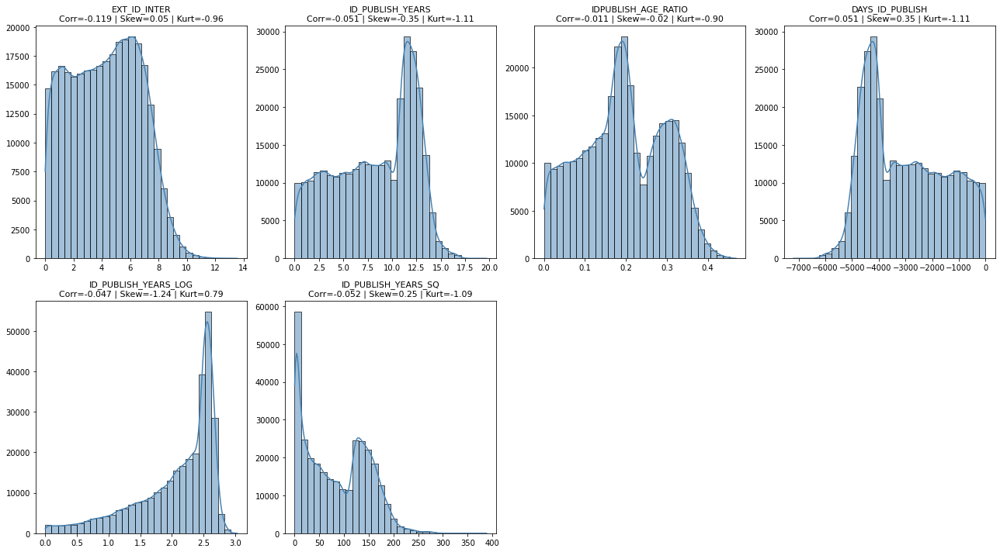

In [160]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_ID_INTER', 'ID_PUBLISH_YEARS', 'IDPUBLISH_AGE_RATIO', 'DAYS_ID_PUBLISH', 'ID_PUBLISH_YEARS_LOG', 
            'ID_PUBLISH_YEARS_SQ']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

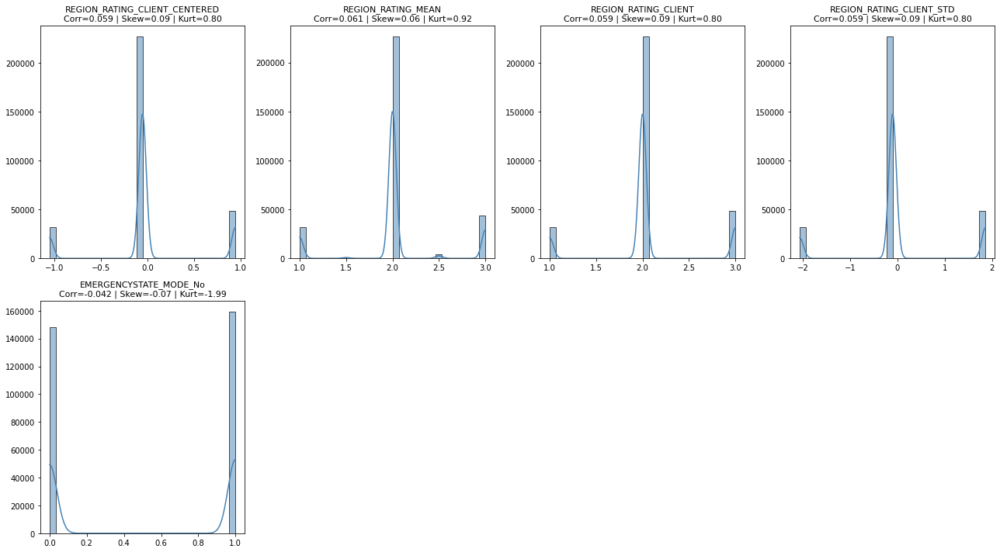

In [162]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_CLIENT_CENTERED', 'REGION_RATING_MEAN', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_STD',
            'EMERGENCYSTATE_MODE_No']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

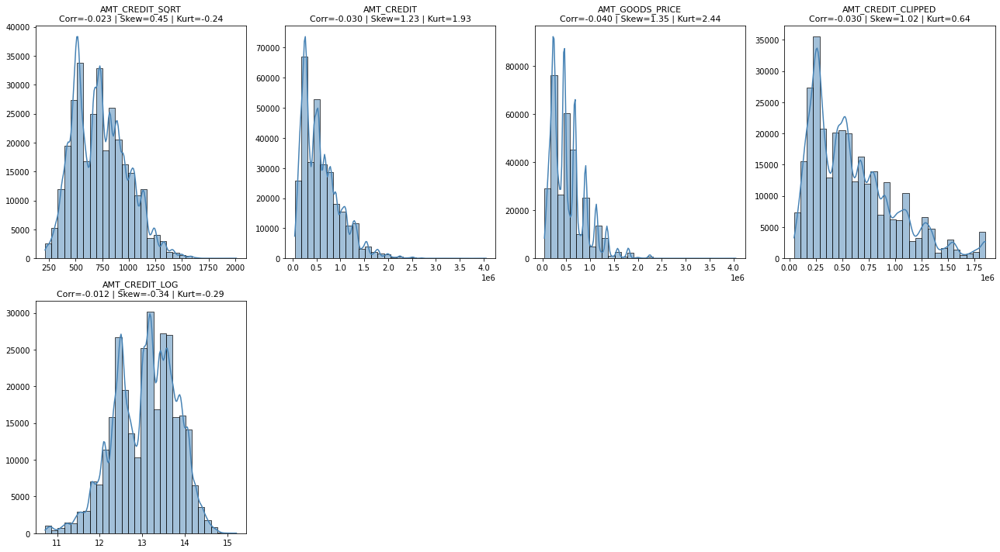

In [163]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT_SQRT', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_CREDIT_CLIPPED',
            'AMT_CREDIT_LOG']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

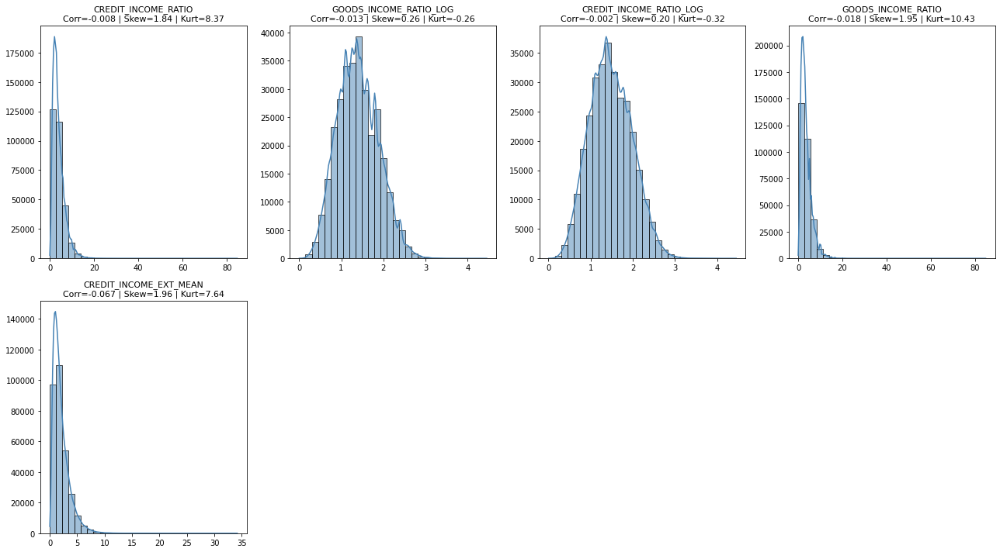

In [164]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO',
            'CREDIT_INCOME_EXT_MEAN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

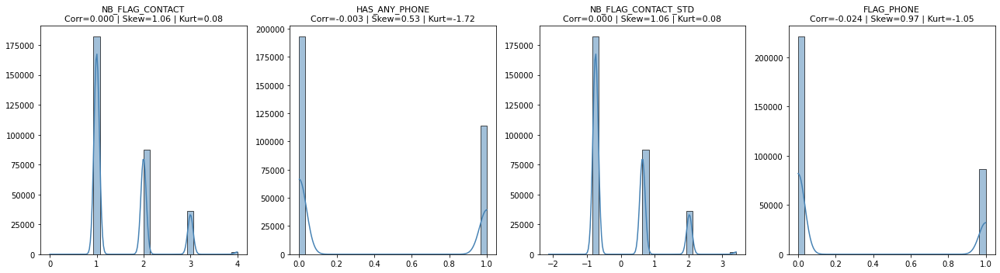

In [165]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_FLAG_CONTACT', 'HAS_ANY_PHONE', 'NB_FLAG_CONTACT_STD', 'FLAG_PHONE']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

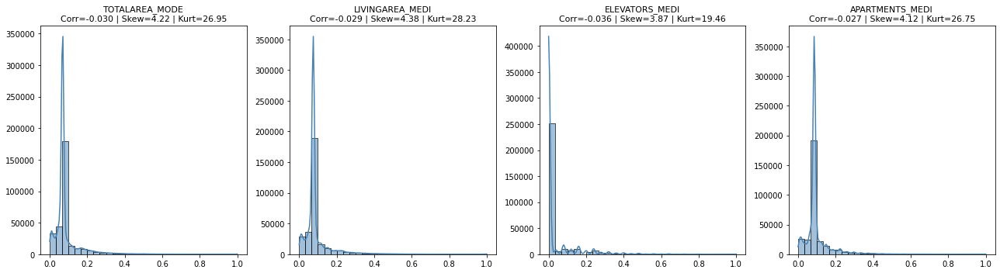

In [166]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['TOTALAREA_MODE', 'LIVINGAREA_MEDI', 'ELEVATORS_MEDI', 'APARTMENTS_MEDI']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

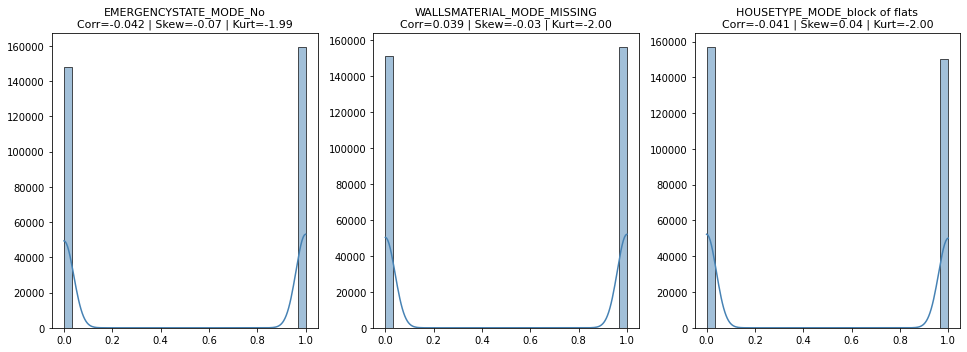

In [167]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMERGENCYSTATE_MODE_No', 'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_block of flats']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

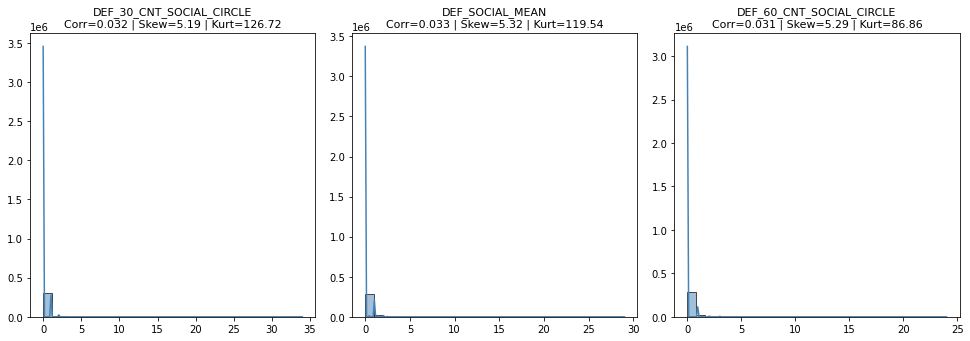

In [168]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DEF_30_CNT_SOCIAL_CIRCLE', 'DEF_SOCIAL_MEAN', 'DEF_60_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

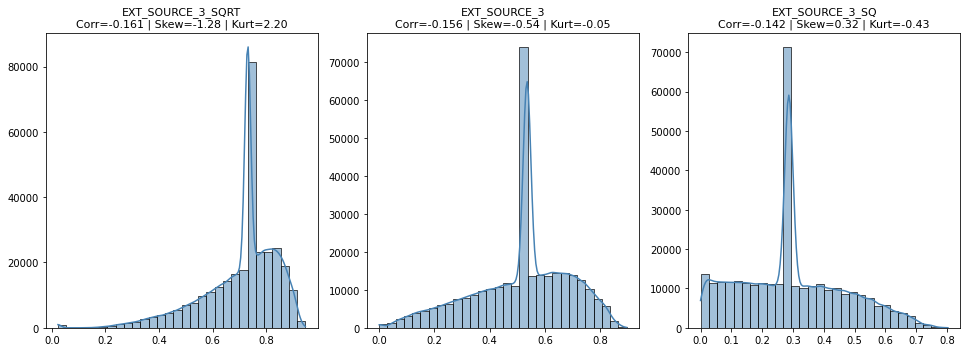

In [169]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_3_SQRT', 'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

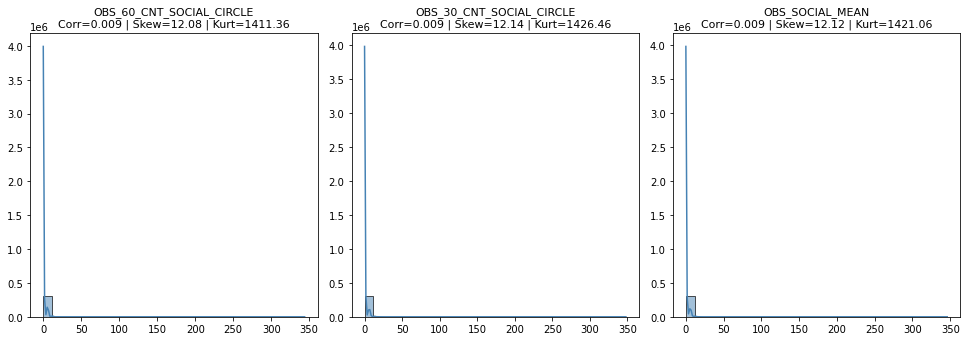

In [170]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_SOCIAL_MEAN']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

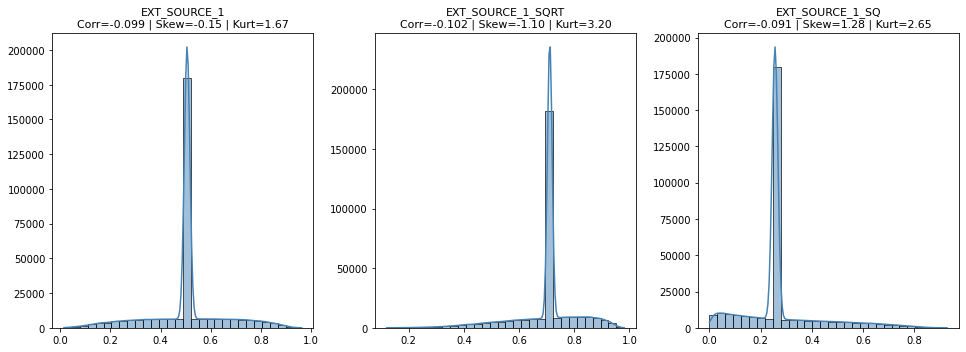

In [171]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_1', 'EXT_SOURCE_1_SQRT', 'EXT_SOURCE_1_SQ']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

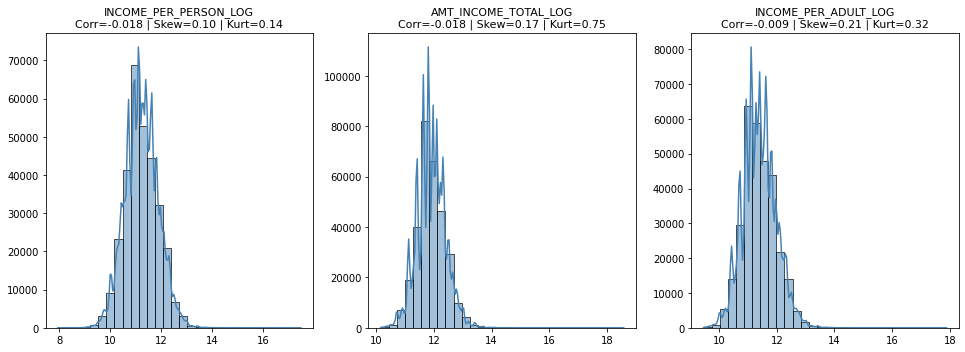

In [172]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['INCOME_PER_PERSON_LOG', 'AMT_INCOME_TOTAL_LOG', 'INCOME_PER_ADULT_LOG']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

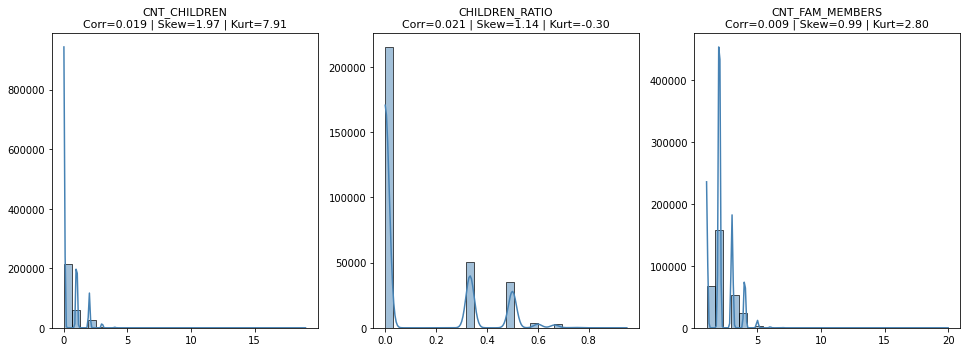

In [173]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CNT_CHILDREN', 'CHILDREN_RATIO', 'CNT_FAM_MEMBERS']

plot_transformations_distributions(
    df=df_train_median_missing_linear,
    var_list=transfos,
    target='TARGET'
)

In [174]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN", 'LIVE_REGION_NOT_WORK_REGION',

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',
    'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_MISSING', 'HOUSETYPE_MODE_block of flats',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_train_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [175]:
df_train_median_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 136 entries, SK_ID_CURR to HAS_CONTACT_AND_REALTY
dtypes: Int64(14), float32(34), int32(86), object(2)
memory usage: 192.8+ MB


In [176]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- On peut passer au dernier dataframe pour les modèles linéaire

#### Feature engineering - df_train_nan_missing_linear

In [177]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
1,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998489
2,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.986971
3,REGION_RATING_CLIENT / REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.950840
4,HOUSETYPE_MODE_block of flats / WALLSMATERIAL_MODE_MISSING,HOUSETYPE_MODE_block of flats,WALLSMATERIAL_MODE_MISSING,-0.941783
5,EMERGENCYSTATE_MODE_No / WALLSMATERIAL_MODE_MISSING,WALLSMATERIAL_MODE_MISSING,EMERGENCYSTATE_MODE_No,-0.924398
6,LIVINGAREA_MEDI / TOTALAREA_MODE,LIVINGAREA_MEDI,TOTALAREA_MODE,0.919362
7,APARTMENTS_MEDI / LIVINGAREA_MEDI,APARTMENTS_MEDI,LIVINGAREA_MEDI,0.915946
8,EMERGENCYSTATE_MODE_No / HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_block of flats,EMERGENCYSTATE_MODE_No,0.915006
9,NAME_EDUCATION_TYPE_Higher education / NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,-0.888010


In [179]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_nan_missing_linear)

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_18248/2818828571.py:151: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_18248/2818828571.py:152: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_18248/2818828571.py:153: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

In [180]:
optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 398.96 MB
 Mémoire après : 359.08 MB
 Gain : 10.0%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.05,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.04879
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.00,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.00000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.05,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.05,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.05,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.04879
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.05,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.04879
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.05,2,1,1,1.170319,0.641034,0.693147,0.202810,0.04879
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.05,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.04879


In [181]:
df_train_nan_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 222 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Float64(15), Int32(13), Int64(17), float32(81), int32(94), object(2)
memory usage: 323.9+ MB


#### Corrélation des variables - df_train_nan_missing_linear

In [182]:
get_correlation_pairs(df_train_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,AMT_INCOME_TOTAL / AMT_INCOME_TOTAL_STD,AMT_INCOME_TOTAL,AMT_INCOME_TOTAL_STD,1.000000
1,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS,-1.000000
2,DAYS_LAST_PHONE_CHANGE / LAST_PHONE_CHANGE_YEARS,DAYS_LAST_PHONE_CHANGE,LAST_PHONE_CHANGE_YEARS,-1.000000
3,DAYS_REGISTRATION / REGISTRATION_YEARS,DAYS_REGISTRATION,REGISTRATION_YEARS,-1.000000
4,NB_FLAG_CONTACT / NB_FLAG_CONTACT_STD,NB_FLAG_CONTACT,NB_FLAG_CONTACT_STD,1.000000
5,CITY_MOBILITY_SCORE / CITY_MOBILITY_SCORE_STD,CITY_MOBILITY_SCORE,CITY_MOBILITY_SCORE_STD,1.000000
6,REGION_RATING_CLIENT / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT,REGION_RATING_CLIENT_STD,1.000000
7,EMPLOYED_LOG / EMPLOYED_LOG_STD,EMPLOYED_LOG,EMPLOYED_LOG_STD,1.000000
8,REGION_RATING_CLIENT_CENTERED / REGION_RATING_CLIENT_STD,REGION_RATING_CLIENT_CENTERED,REGION_RATING_CLIENT_STD,1.000000
9,AGE_YEARS / DAYS_BIRTH,DAYS_BIRTH,AGE_YEARS,-1.000000


In [183]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear, method="pearson", style=False, threshold=0.8)

In [184]:
sorted(df_corr['Variable 1'].unique().tolist())

['AGE_LOG',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_INCOME_TOTAL_LOG',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_MEDI',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DOCS_RATIO',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMPLOYED_LOG',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_1',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_2',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_3',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_MEAN',
 'EXT_SOURCE_MEDIAN',
 'FLAG_EMP_PHONE',
 'FLAG_PHONE',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HAS_NO_DOC',
 'HOUSETYPE_MODE_block of flats',
 'ID_PUBLISH_YEA

In [185]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL_STD',
 'ANNUITY_EMPLOYED_INTER',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_FAM_MEMBERS',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DEF_SOCIAL_MEAN',
 'DOCS_RATIO',
 'DOCS_RATIO_LOG',
 'DOCS_RATIO_STD',
 'ELEVATORS_MEDI',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'EXT_AGE_INTER',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'EXT_SOURCE_1_2',
 'EXT_SOURCE_1_3',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_1_SQRT',
 'EXT_SOURCE_2_3',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_2_SQRT',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_3_SQRT',
 'EXT_SOURCE_MEDIAN',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO

In [186]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing_linear, 'TARGET', mode='linear', plot=False)
target_corr

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
EXT_SOURCE_MEAN,-0.222045,-0.204328,0.222045,0.204328,0.213187
EXT_SOURCE_MEDIAN,-0.218111,-0.199617,0.218111,0.199617,0.208864
EXT_SOURCE_2_3,-0.199491,-0.200850,0.199491,0.200850,0.200170
EXT_SOURCE_1_3,-0.187838,-0.200989,0.187838,0.200989,0.194413
EXT_AGE_INTER,-0.181534,-0.183020,0.181534,0.183020,0.182277
EXT_SOURCE_1_2,-0.175554,-0.180726,0.175554,0.180726,0.178140
EXT_SOURCE_3_SQRT,-0.185879,-0.166336,0.185879,0.166336,0.176107
EXT_SOURCE_3,-0.178926,-0.166336,0.178926,0.166336,0.172631
EXT_SOURCE_3_SQ,-0.160352,-0.166336,0.160352,0.166336,0.163344
EXT_SOURCE_1_SQRT,-0.163207,-0.151146,0.163207,0.151146,0.157176


In [187]:
pd.reset_option('display.max_rows')

In [188]:
pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[EXT_AGE_INTER, EXT_SOURCE_MEDIAN, EXT_SOURCE_1_SQ, EXT_SOURCE_1, EXT_SOURCE_1_2, EXT_SOURCE_1_3, EXT_SOURCE_1_SQRT, EXT_SOURCE_MEAN, EXT_SOURCE_2_3]",9,0.222045,EXT_SOURCE_MEAN
1,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, ANNUITY_EMPLOYED_INTER, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",8,0.111575,EXT_EMPLOYED_INTER
2,"[RATING_INCOME_INTER, INCOME_PER_AGE, INCOME_AGE_INTER, AMT_INCOME_TOTAL_STD, AMT_INCOME_TOTAL, INCOME_PER_ADULT, INCOME_PER_PERSON]",7,0.020419,INCOME_AGE_INTER
3,"[NB_DOCUMENTS_PROVIDED, DOCS_RATIO, NAME_CONTRACT_TYPE, HAS_NO_DOC, DOCS_RATIO_STD, NB_DOCUMENTS_PROVIDED_LOG, DOCS_RATIO_LOG]",7,0.030868,NAME_CONTRACT_TYPE
4,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.101550,EXT_PHONE_INTER
5,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.105603,EXT_REG_INTER
6,"[LIVE_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",6,0.064119,MOBILITY_RATING_INTER
7,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS, IDPUBLISH_AGE_RATIO, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH]",6,0.136633,EXT_ID_INTER
8,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039671,AMT_GOODS_PRICE
9,"[AGE_LOG_STD, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",5,0.078517,AGE_LOG_STD


In [189]:
pd.reset_option('display.max_colwidth')

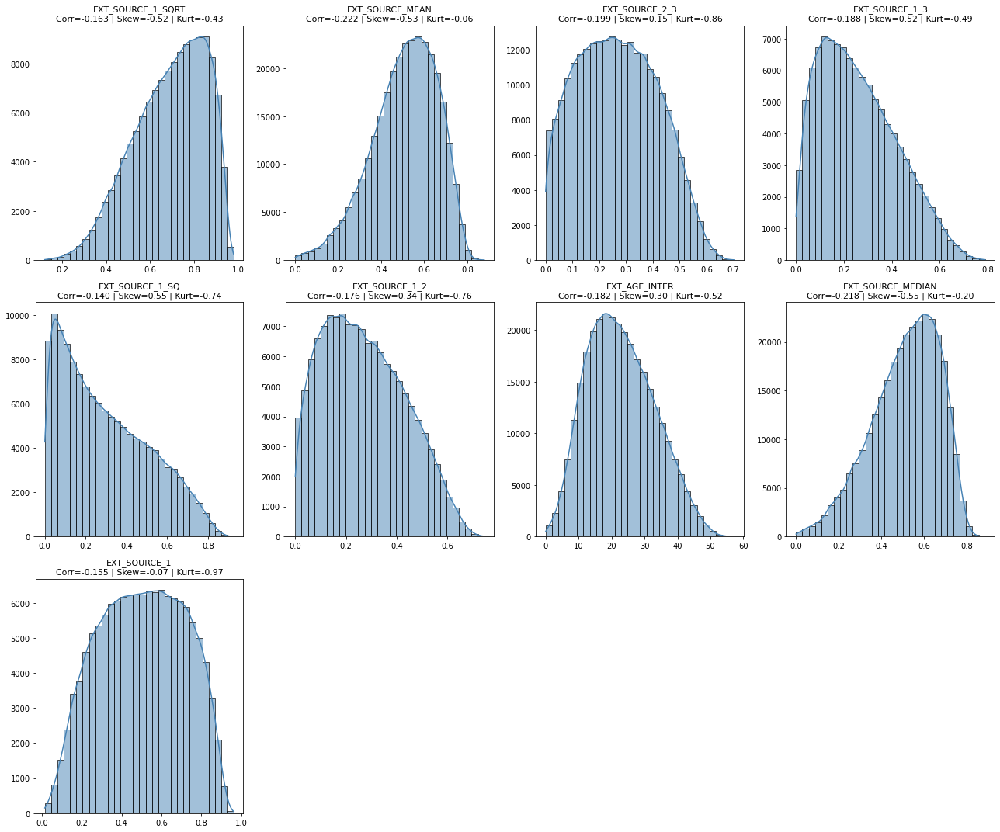

In [190]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_1_SQRT', 'EXT_SOURCE_MEAN', 'EXT_SOURCE_2_3', 'EXT_SOURCE_1_3', 'EXT_SOURCE_1_SQ', 
            'EXT_SOURCE_1_2', 'EXT_AGE_INTER', 'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_1']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

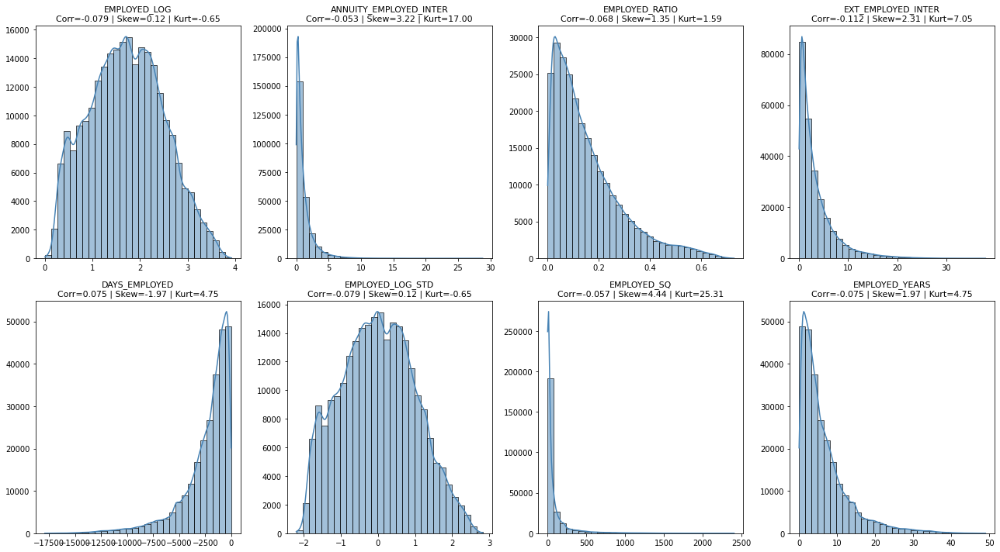

In [191]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_LOG', 'ANNUITY_EMPLOYED_INTER', 'EMPLOYED_RATIO', 'EXT_EMPLOYED_INTER', 'DAYS_EMPLOYED', 
            'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'EMPLOYED_YEARS']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

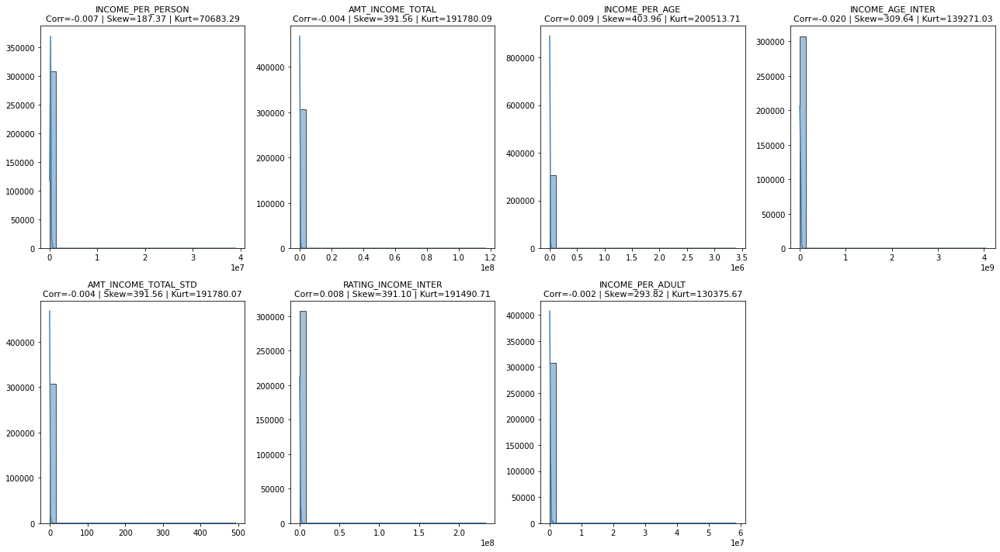

In [192]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['INCOME_PER_PERSON', 'AMT_INCOME_TOTAL', 'INCOME_PER_AGE', 'INCOME_AGE_INTER', 'AMT_INCOME_TOTAL_STD', 
            'RATING_INCOME_INTER', 'INCOME_PER_ADULT']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

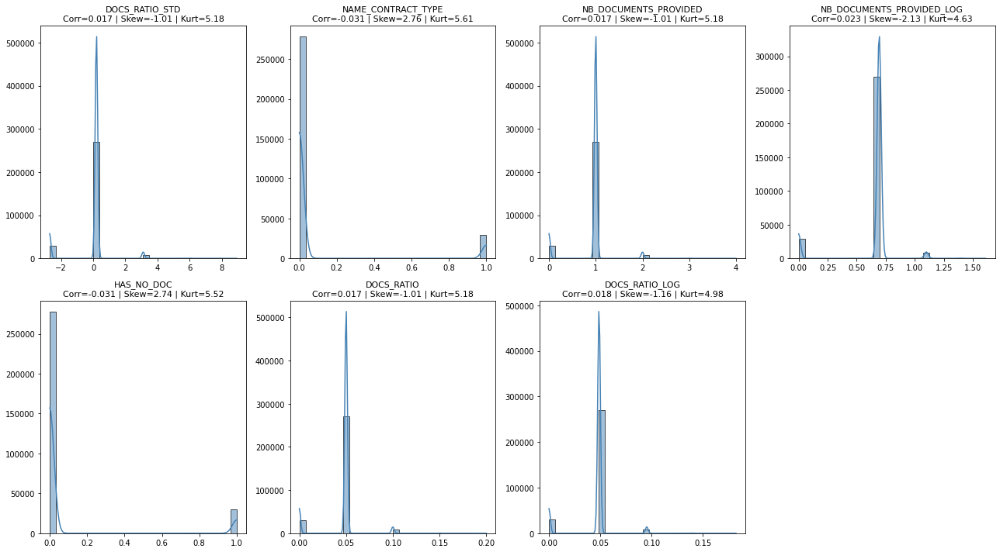

In [193]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DOCS_RATIO_STD', 'NAME_CONTRACT_TYPE', 'NB_DOCUMENTS_PROVIDED', 'NB_DOCUMENTS_PROVIDED_LOG', 'HAS_NO_DOC', 
            'DOCS_RATIO', 'DOCS_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

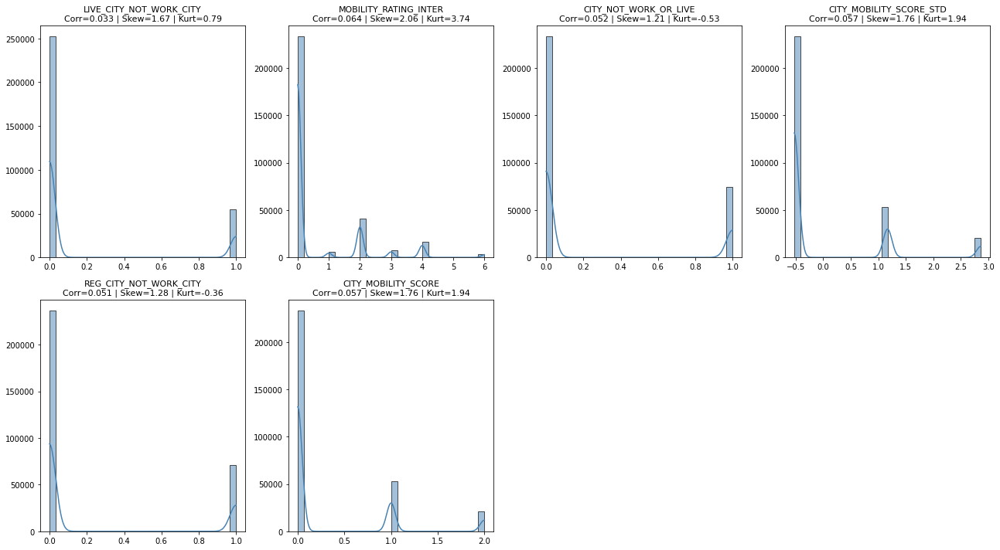

In [194]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LIVE_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER', 'CITY_NOT_WORK_OR_LIVE', 'CITY_MOBILITY_SCORE_STD', 'REG_CITY_NOT_WORK_CITY', 
            'CITY_MOBILITY_SCORE']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

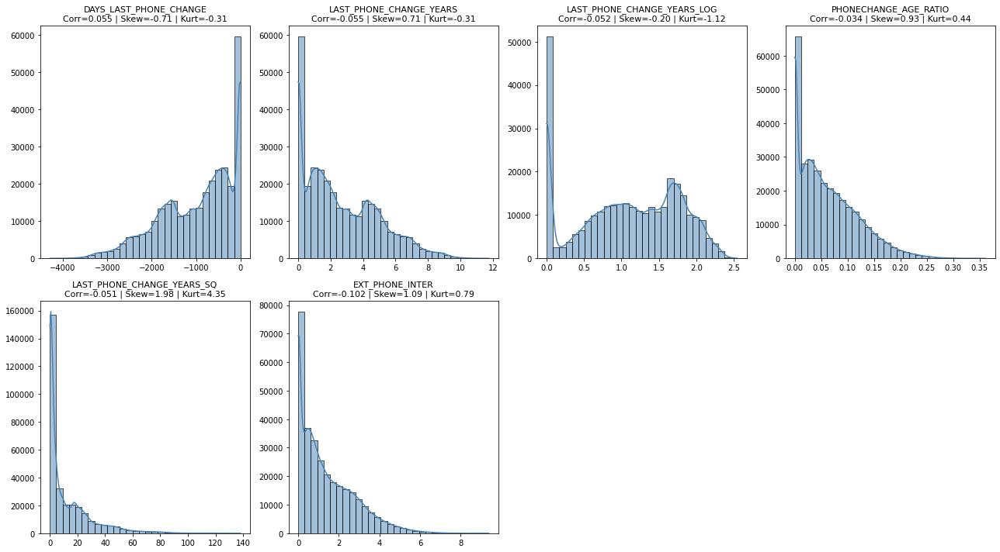

In [195]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DAYS_LAST_PHONE_CHANGE', 'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_LOG', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_SQ', 
            'EXT_PHONE_INTER']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

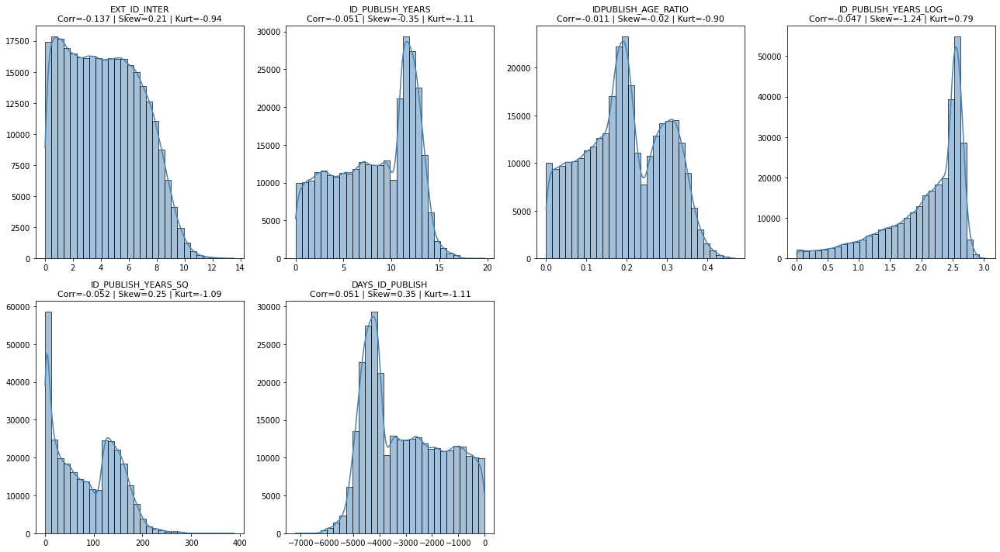

In [196]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_ID_INTER', 'ID_PUBLISH_YEARS', 'IDPUBLISH_AGE_RATIO', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS_SQ', 
            'DAYS_ID_PUBLISH']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

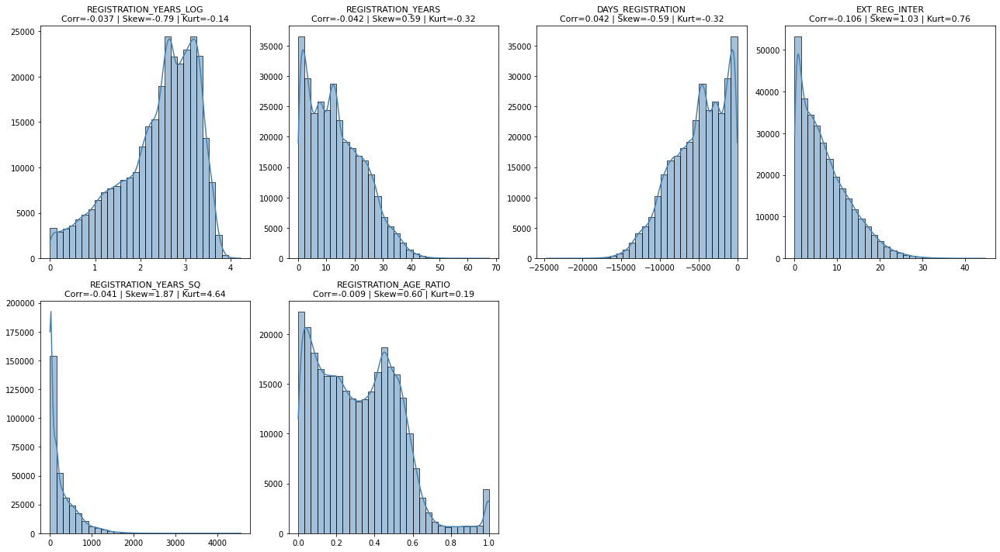

In [197]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION', 'EXT_REG_INTER', 'REGISTRATION_YEARS_SQ', 
            'REGISTRATION_AGE_RATIO']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

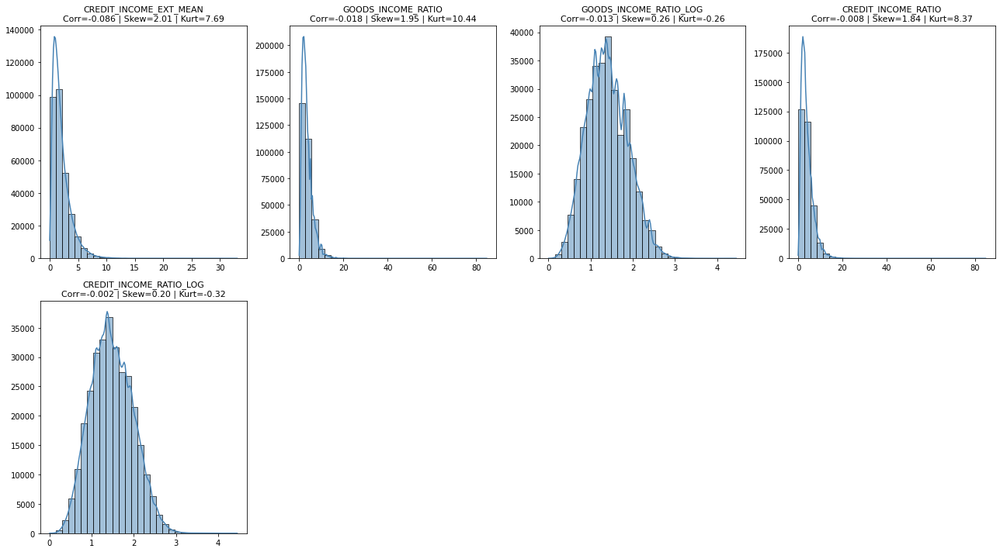

In [198]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_INCOME_EXT_MEAN', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

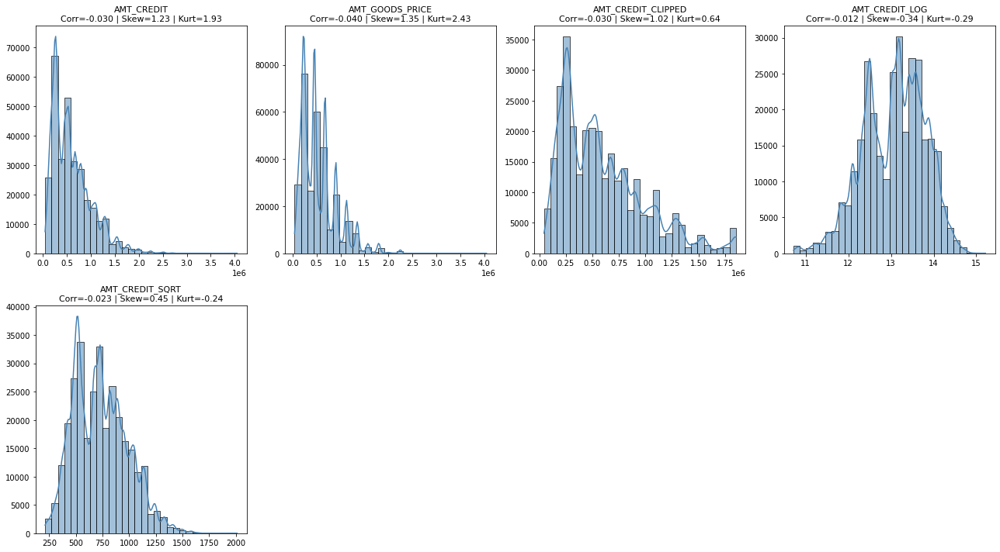

In [199]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_CREDIT_CLIPPED', 'AMT_CREDIT_LOG', 'AMT_CREDIT_SQRT']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

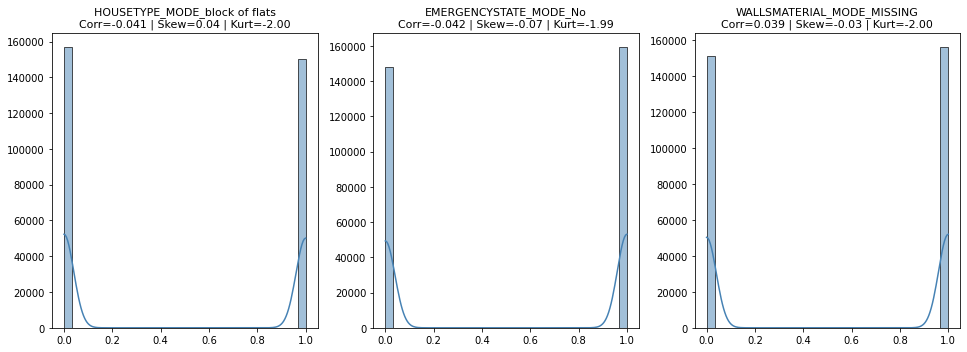

In [201]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['HOUSETYPE_MODE_block of flats', 'EMERGENCYSTATE_MODE_No', 'WALLSMATERIAL_MODE_MISSING']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

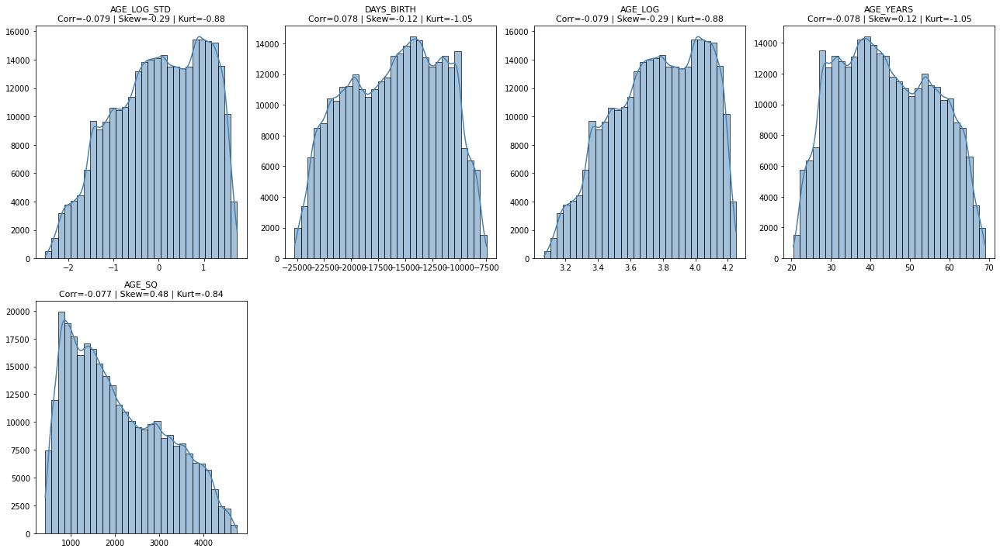

In [202]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG_STD', 'DAYS_BIRTH', 'AGE_LOG', 'AGE_YEARS', 'AGE_SQ']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

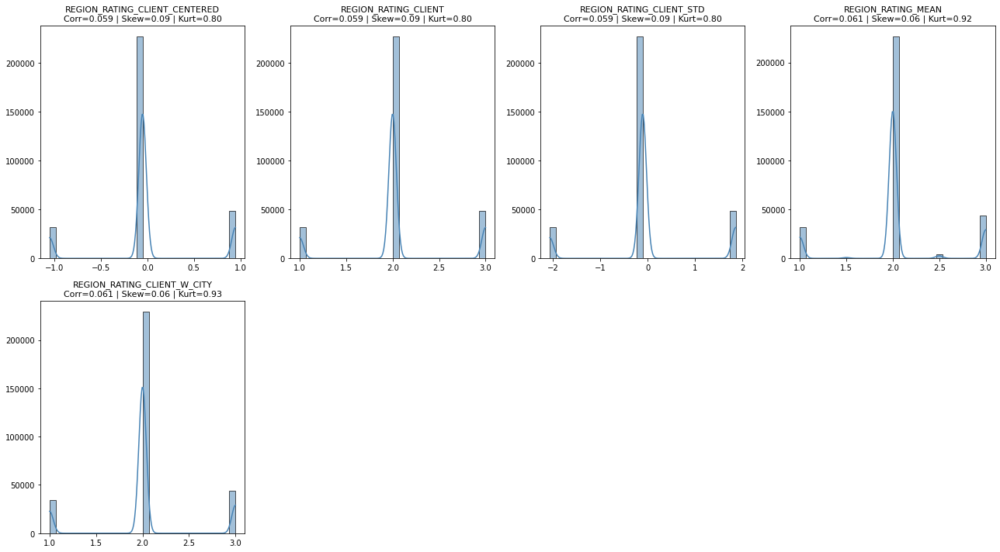

In [203]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_CLIENT_CENTERED', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_STD', 'REGION_RATING_MEAN', 'REGION_RATING_CLIENT_W_CITY']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

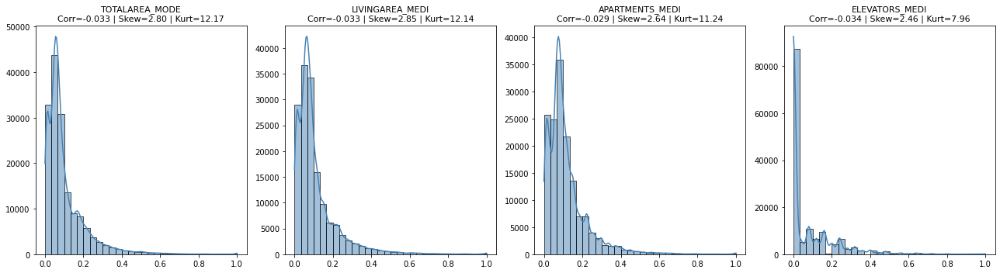

In [204]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['TOTALAREA_MODE', 'LIVINGAREA_MEDI', 'APARTMENTS_MEDI', 'ELEVATORS_MEDI']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

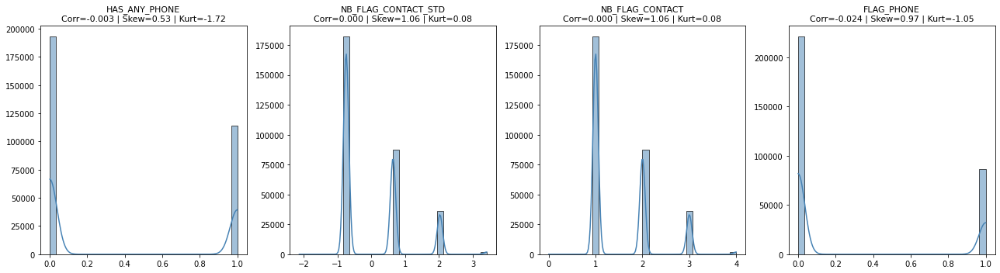

In [205]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['HAS_ANY_PHONE', 'NB_FLAG_CONTACT_STD', 'NB_FLAG_CONTACT', 'FLAG_PHONE']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

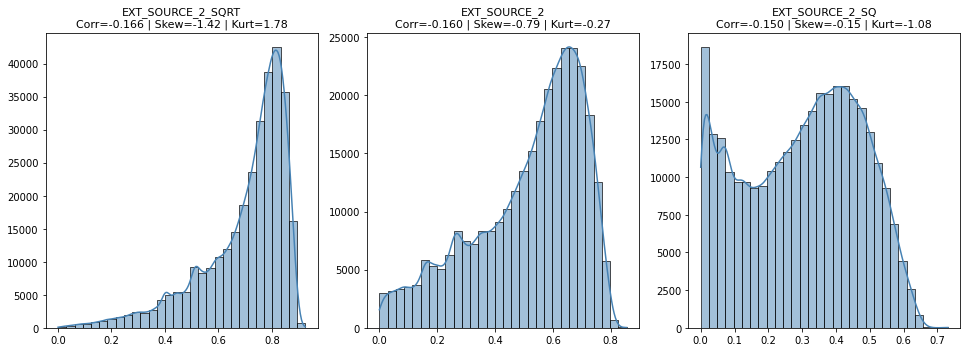

In [206]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_2_SQRT', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

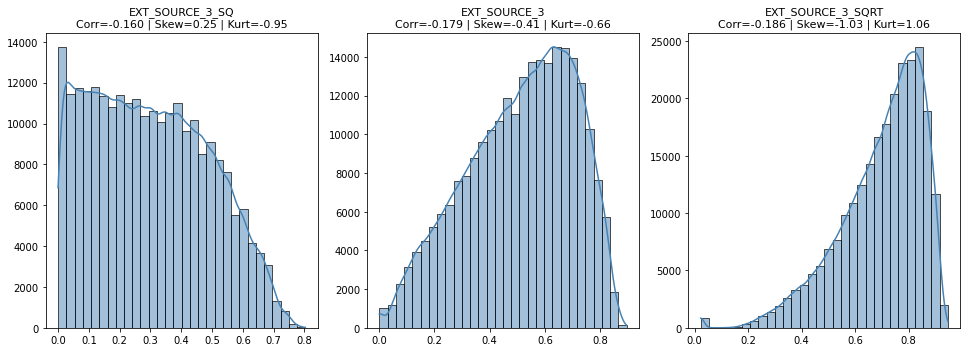

In [207]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_3_SQ', 'EXT_SOURCE_3', 'EXT_SOURCE_3_SQRT']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

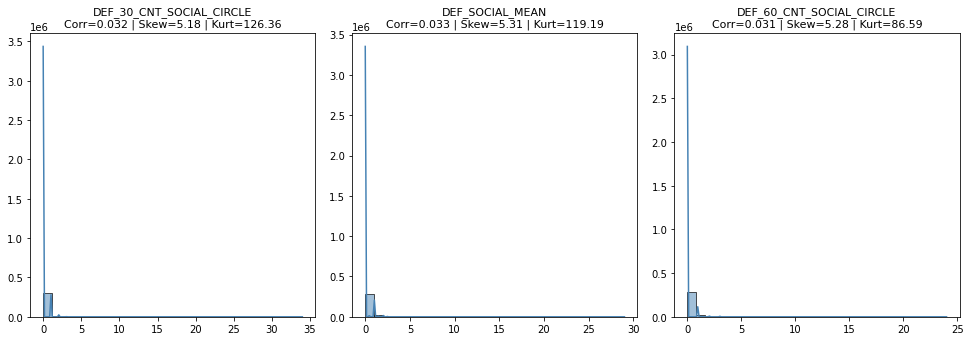

In [208]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DEF_30_CNT_SOCIAL_CIRCLE', 'DEF_SOCIAL_MEAN', 'DEF_60_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

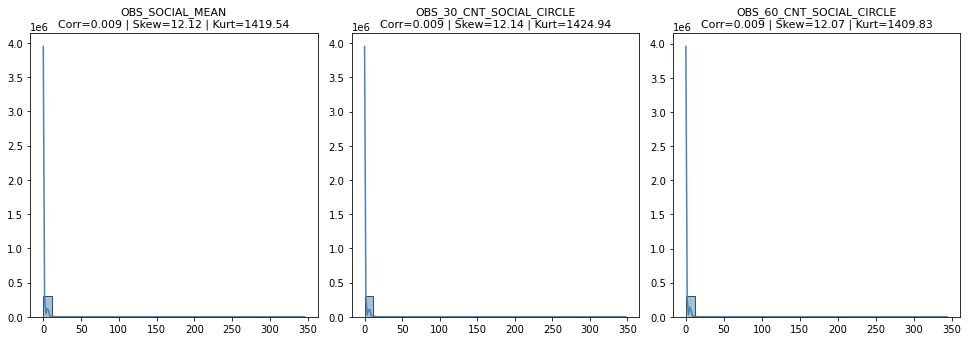

In [209]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_SOCIAL_MEAN', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

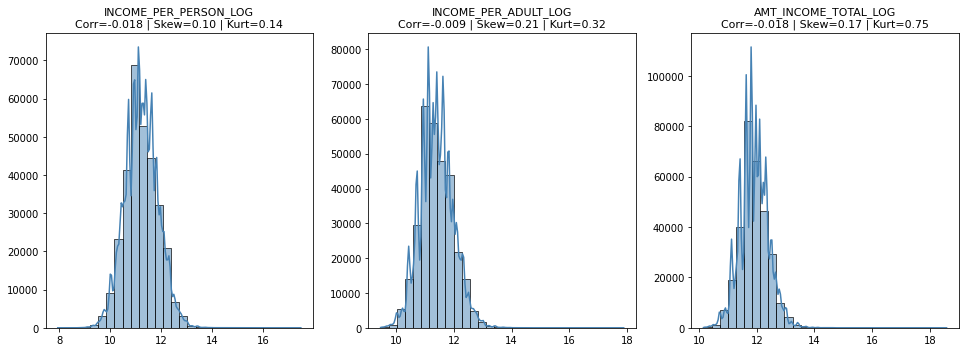

In [210]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['INCOME_PER_PERSON_LOG', 'INCOME_PER_ADULT_LOG', 'AMT_INCOME_TOTAL_LOG']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

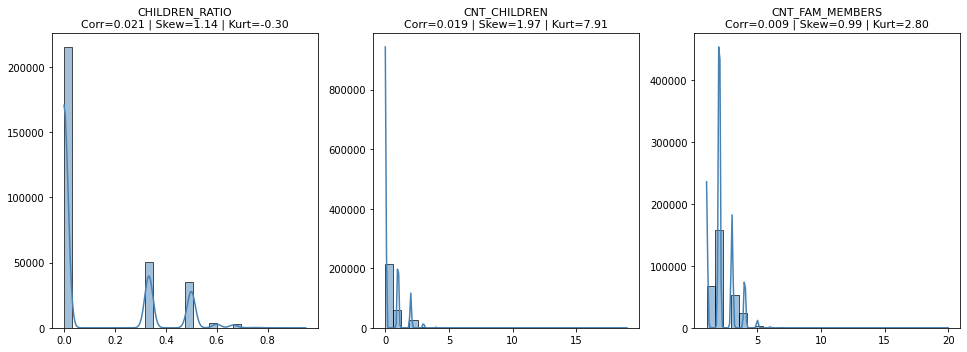

In [211]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CHILDREN_RATIO', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

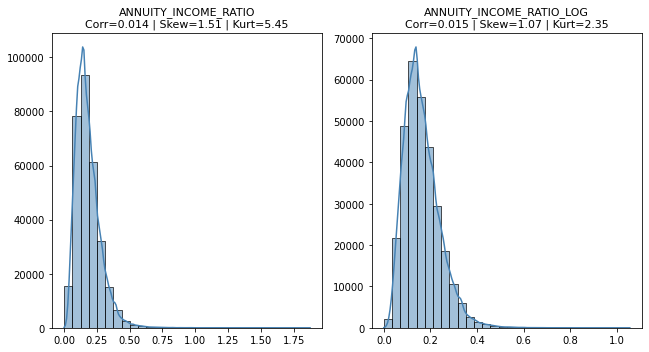

In [212]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ANNUITY_INCOME_RATIO', 'ANNUITY_INCOME_RATIO_LOG']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

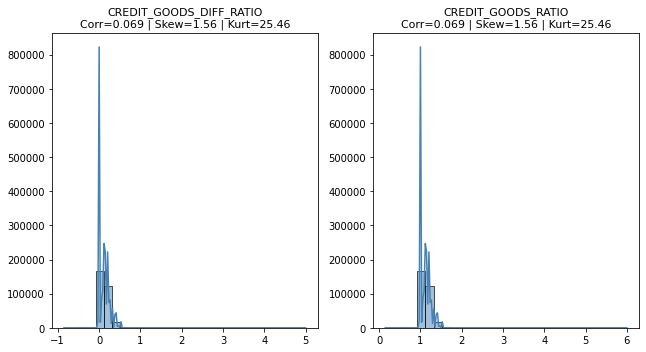

In [213]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_GOODS_DIFF_RATIO', 'CREDIT_GOODS_RATIO']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

In [214]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN", 'LIVE_REGION_NOT_WORK_REGION',

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO_LOG", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',
    'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_MISSING', 'HOUSETYPE_MODE_block of flats',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_train_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [215]:
df_train_nan_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 136 entries, SK_ID_CURR to HAS_CONTACT_AND_REALTY
dtypes: Float64(5), Int32(7), Int64(14), float32(29), int32(79), object(2)
memory usage: 202.2+ MB


In [216]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- On peut passer ensuite aux 4 autres derniers dataframes prévus pour les modèles non linéaires.

#### Feature engineering - df_train_median_mode

In [217]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
2,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999964
3,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999868
4,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999648
5,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
6,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997338
7,YEARS_BEGINEXPLUATATION_AVG / YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,0.996001
8,FLOORSMAX_AVG / FLOORSMAX_MEDI,FLOORSMAX_AVG,FLOORSMAX_MEDI,0.992589
9,LANDAREA_AVG / LANDAREA_MEDI,LANDAREA_AVG,LANDAREA_MEDI,0.991729


- De la même façon que pour les 4 premiers dataframes, on retrouve suivant les variables avec les suffixes **"_AVG"**; **"_MODE"** et **"_MEDI"** qui représente une grande partie des variables très corrélées.
- Comme précédemment on peut ne garder qu'un seul type de ces variables même si cela pose moins problème pour des modèles non linéaire, cela permettra de diminuer les temps d'entrainement, le risque de surapprentissage ou ternir l'importance de certaines features.

In [218]:
df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("_AVG")]

,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,LANDAREA_AVG,LIVINGAREA_AVG,NONLIVINGAREA_AVG,APARTMENTS_AVG_was_missing,BASEMENTAREA_AVG_was_missing,YEARS_BEGINEXPLUATATION_AVG_was_missing,ELEVATORS_AVG_was_missing,ENTRANCES_AVG_was_missing,FLOORSMAX_AVG_was_missing,LANDAREA_AVG_was_missing,LIVINGAREA_AVG_was_missing,NONLIVINGAREA_AVG_was_missing
0,0.0247,0.0369,0.9722,0.00,0.0690,0.0833,0.0369,0.0190,0.0000,0,0,0,0,0,0,0,0,0
1,0.0959,0.0529,0.9851,0.08,0.0345,0.2917,0.0130,0.0549,0.0098,0,0,0,0,0,0,0,0,0
2,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036,1,1,1,1,1,1,1,1,1
3,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036,1,1,1,1,1,1,1,1,1
4,0.0876,0.0763,0.9816,0.00,0.1379,0.1667,0.0481,0.0745,0.0036,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.2021,0.0887,0.9876,0.22,0.1034,0.6042,0.0594,0.1965,0.1095,0,0,0,0,0,0,0,0,0
307507,0.0247,0.0435,0.9727,0.00,0.1034,0.0833,0.0579,0.0257,0.0000,0,0,0,0,0,0,0,0,0
307508,0.1031,0.0862,0.9816,0.00,0.2069,0.1667,0.0481,0.9279,0.0000,0,0,0,0,0,0,1,0,0
307509,0.0124,0.0763,0.9771,0.00,0.0690,0.0417,0.0481,0.0061,0.0036,0,1,0,1,0,0,1,0,1


In [219]:
df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("_MODE")]

,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,LANDAREA_MODE,LIVINGAREA_MODE,NONLIVINGAREA_MODE,TOTALAREA_MODE,...,WALLSMATERIAL_MODE_MISSING,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_MISSING,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,0.0252,0.0383,0.9722,0.0000,0.0690,0.0833,0.0377,0.0198,0.0000,0.0149,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.0924,0.0538,0.9851,0.0806,0.0345,0.2917,0.0128,0.0554,0.0000,0.0714,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0840,0.0746,0.9816,0.0000,0.1379,0.1667,0.0458,0.0731,0.0011,0.0688,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
3,0.0840,0.0746,0.9816,0.0000,0.1379,0.1667,0.0458,0.0731,0.0011,0.0688,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4,0.0840,0.0746,0.9816,0.0000,0.1379,0.1667,0.0458,0.0731,0.0011,0.0688,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.1008,0.0172,0.9782,0.0806,0.0345,0.4583,0.0094,0.0853,0.0125,0.2898,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
307507,0.0252,0.0451,0.9727,0.0000,0.1034,0.0833,0.0592,0.0267,0.0000,0.0214,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
307508,0.1050,0.0894,0.9816,0.0000,0.2069,0.1667,0.0458,0.9667,0.0000,0.7970,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
307509,0.0126,0.0746,0.9772,0.0000,0.0690,0.0417,0.0458,0.0063,0.0011,0.0086,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [220]:
df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("_MEDI")]

,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,LANDAREA_MEDI,LIVINGAREA_MEDI,NONLIVINGAREA_MEDI,APARTMENTS_MEDI_was_missing,BASEMENTAREA_MEDI_was_missing,YEARS_BEGINEXPLUATATION_MEDI_was_missing,ELEVATORS_MEDI_was_missing,ENTRANCES_MEDI_was_missing,FLOORSMAX_MEDI_was_missing,LANDAREA_MEDI_was_missing,LIVINGAREA_MEDI_was_missing,NONLIVINGAREA_MEDI_was_missing
0,0.0250,0.0369,0.9722,0.00,0.0690,0.0833,0.0375,0.0193,0.0000,0,0,0,0,0,0,0,0,0
1,0.0968,0.0529,0.9851,0.08,0.0345,0.2917,0.0132,0.0558,0.0100,0,0,0,0,0,0,0,0,0
2,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031,1,1,1,1,1,1,1,1,1
3,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031,1,1,1,1,1,1,1,1,1
4,0.0864,0.0758,0.9816,0.00,0.1379,0.1667,0.0487,0.0749,0.0031,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.2040,0.0887,0.9876,0.22,0.1034,0.6042,0.0605,0.2001,0.1118,0,0,0,0,0,0,0,0,0
307507,0.0250,0.0435,0.9727,0.00,0.1034,0.0833,0.0589,0.0261,0.0000,0,0,0,0,0,0,0,0,0
307508,0.1041,0.0862,0.9816,0.00,0.2069,0.1667,0.0487,0.9445,0.0000,0,0,0,0,0,0,1,0,0
307509,0.0125,0.0758,0.9771,0.00,0.0690,0.0417,0.0487,0.0062,0.0031,0,1,0,1,0,0,1,0,1


In [221]:
df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_train_median_mode.columns.str.contains("_MEDI|_MODE")].columns.tolist()

['APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'LANDAREA_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'ELEVATORS_MEDI',
 'ENTRANCES_MEDI',
 'FLOORSMAX_MEDI',
 'LANDAREA_MEDI',
 'LIVINGAREA_MEDI',
 'NONLIVINGAREA_MEDI',
 'APARTMENTS_MODE_was_missing',
 'BASEMENTAREA_MODE_was_missing',
 'YEARS_BEGINEXPLUATATION_MODE_was_missing',
 'ELEVATORS_MODE_was_missing',
 'ENTRANCES_MODE_was_missing',
 'FLOORSMAX_MODE_was_missing',
 'LANDAREA_MODE_was_missing',
 'LIVINGAREA_MODE_was_missing',
 'NONLIVINGAREA_MODE_was_missing',
 'APARTMENTS_MEDI_was_missing',
 'BASEMENTAREA_MEDI_was_missing',
 'YEARS_BEGINEXPLUATATION_MEDI_was_missing',
 'ELEVATORS_MEDI_was_missing',
 'ENTRANCES_MEDI_was_missing',
 'FLOORSMAX_MEDI_was_missing',
 'LANDAREA_MEDI_was_missing',
 'LIVINGAREA_MEDI_was_missing',
 'NONLIVINGAREA_MEDI_was_missing']

In [222]:
# Suppression des variables trop corrélées ("_MODE" et "_MEDI")

cols_to_drop = df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_train_median_mode.columns.str.contains("_MEDI|_MODE")].columns.tolist()

df_train_median_mode.drop(columns=cols_to_drop, inplace=True)
df_train_iterative_mode.drop(columns=cols_to_drop, inplace=True)
df_train_median_missing.drop(columns=cols_to_drop, inplace=True)
df_train_nan_missing.drop(columns=cols_to_drop, inplace=True)

In [223]:
# Vérification des changements apportés.

df_train_median_mode.loc[:, df_train_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_train_median_mode.columns.str.contains("_MEDI|_MODE")].columns

Index([], dtype='object')

In [224]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
2,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999964
3,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999868
4,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999648
5,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
6,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997338
7,TOTALAREA_MODE_was_missing / YEARS_BEGINEXPLUATATION_AVG_was_missing,YEARS_BEGINEXPLUATATION_AVG_was_missing,TOTALAREA_MODE_was_missing,0.987384
8,ENTRANCES_AVG_was_missing / FLOORSMAX_AVG_was_missing,ENTRANCES_AVG_was_missing,FLOORSMAX_AVG_was_missing,0.984628
9,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.984366


In [225]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_median_mode)

In [226]:
optimize_types(df_train_median_mode)

 Mémoire avant : 566.79 MB
 Mémoire après : 447.15 MB
 Gain : 21.1%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.025,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.024693
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.000,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.000000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.025,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.025,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.025,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.025,2,1,1,1.170319,0.641034,0.693147,0.202810,0.024693
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.025,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.024693


In [227]:
df_train_median_mode.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 319 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(96), int32(204), object(2)
memory usage: 411.9+ MB


#### Corrélation des variables - df_train_median_mode

In [228]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,DAYS_EMPLOYED / EMPLOYED_SQ,DAYS_EMPLOYED,EMPLOYED_SQ,-1.000000
1,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
2,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS_LOG,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS_LOG,-1.000000
3,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS_SQ,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS_SQ,-1.000000
4,DAYS_ID_PUBLISH / ID_PUBLISH_YEARS,DAYS_ID_PUBLISH,ID_PUBLISH_YEARS,-1.000000
5,DAYS_LAST_PHONE_CHANGE / LAST_PHONE_CHANGE_YEARS_SQ,DAYS_LAST_PHONE_CHANGE,LAST_PHONE_CHANGE_YEARS_SQ,-1.000000
6,DAYS_REGISTRATION / REGISTRATION_YEARS_LOG,DAYS_REGISTRATION,REGISTRATION_YEARS_LOG,-1.000000
7,DAYS_REGISTRATION / REGISTRATION_YEARS_SQ,DAYS_REGISTRATION,REGISTRATION_YEARS_SQ,-1.000000
8,DAYS_REGISTRATION / REGISTRATION_YEARS,DAYS_REGISTRATION,REGISTRATION_YEARS,-1.000000
9,DAYS_EMPLOYED / EMPLOYED_LOG_STD,DAYS_EMPLOYED,EMPLOYED_LOG_STD,-1.000000


In [229]:
df_corr = get_correlation_pairs(df_train_median_mode, method="spearman", style=False, threshold=0.9)

In [230]:
sorted(df_corr['Variable 1'].unique().tolist())

['AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_AVG_was_missing',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'FLAG_EMP_PHONE',
 'FLAG_MOBIL',
 'FLAG_OWN_CAR',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_PUBLISH_YEARS_SQ',
 'INCOME_PER_PERSON',
 'LAST_PHONE_CHANGE_YEARS',
 'LAST_PHONE_CHANGE_YEARS_LOG',
 'LAST_PHONE_CHANGE_YEARS_SQ',
 'LIVINGAREA_AVG_was_missing',
 'MOBILITY_RATING_INTER',

In [231]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_LAST_PHONE_CHANGE_was_missing',
 'DEF_SOCIAL_MEAN',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_Yes',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_PUBLISH_YEARS_SQ',
 'INCOME_PER_PERSON_LOG',
 'LAST_PHONE_CHANGE_YEARS',
 'LAST_PHONE_CHANGE_

In [232]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode, 'TARGET', mode='nonlinear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
EXT_SOURCE_MEAN,-0.220839,-0.204810,0.220839,0.204810,0.023485,0.228529
EXT_SOURCE_MEDIAN,-0.192486,-0.174847,0.192486,0.174847,0.023865,0.206144
EXT_SOURCE_2_3,-0.193932,-0.192087,0.193932,0.192087,0.020514,0.205304
FLAG_MOBIL,0.000534,0.000534,0.000534,0.000534,0.080609,0.200428
NAME_EDUCATION_TYPE_Secondary / secondary special,0.049804,0.049804,0.049804,0.049804,0.056837,0.180861
FLAG_DOCUMENT_3,0.044371,0.044371,0.044371,0.044371,0.056788,0.176393
EXT_SOURCE_1_3,-0.164080,-0.160658,0.164080,0.160658,0.018334,0.175383
FLAG_EMP_PHONE,0.045978,0.045978,0.045978,0.045978,0.055488,0.174455
REGION_RATING_MEAN,0.060622,0.060321,0.060622,0.060321,0.050749,0.174291
EXT_AGE_INTER,-0.166721,-0.167164,0.166721,0.167164,0.015574,0.172195


In [233]:
pd.reset_option('display.max_rows')

In [234]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[TOTALAREA_MODE_was_missing, YEARS_BEGINEXPLUATATION_AVG_was_missing, WALLSMATERIAL_MODE_was_missing, EMERGENCYSTATE_MODE_was_missing, NONLIVINGAREA_AVG_was_missing, HOUSETYPE_MODE_was_missing, FLOORSMAX_AVG_was_missing, ELEVATORS_AVG_was_missing, LIVINGAREA_AVG_was_missing, APARTMENTS_AVG_was_missing, ENTRANCES_AVG_was_missing]",11,0.041368,EMERGENCYSTATE_MODE_was_missing
1,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",7,0.094129,EXT_EMPLOYED_INTER
2,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_SQ, LAST_PHONE_CHANGE_YEARS_LOG, EXT_PHONE_INTER]",6,0.092372,EXT_PHONE_INTER
3,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.090981,EXT_REG_INTER
4,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH, ID_PUBLISH_YEARS]",5,0.119040,EXT_ID_INTER
5,"[AGE_LOG_STD, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",5,0.078517,AGE_LOG_STD
6,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY
7,"[GOODS_INCOME_RATIO_LOG, GOODS_INCOME_RATIO, CREDIT_INCOME_RATIO_LOG, CREDIT_INCOME_EXT_MEAN, CREDIT_INCOME_RATIO]",5,0.066642,CREDIT_INCOME_EXT_MEAN
8,"[CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",5,0.064119,MOBILITY_RATING_INTER
9,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039650,AMT_GOODS_PRICE


In [235]:
pd.reset_option('display.max_colwidth')

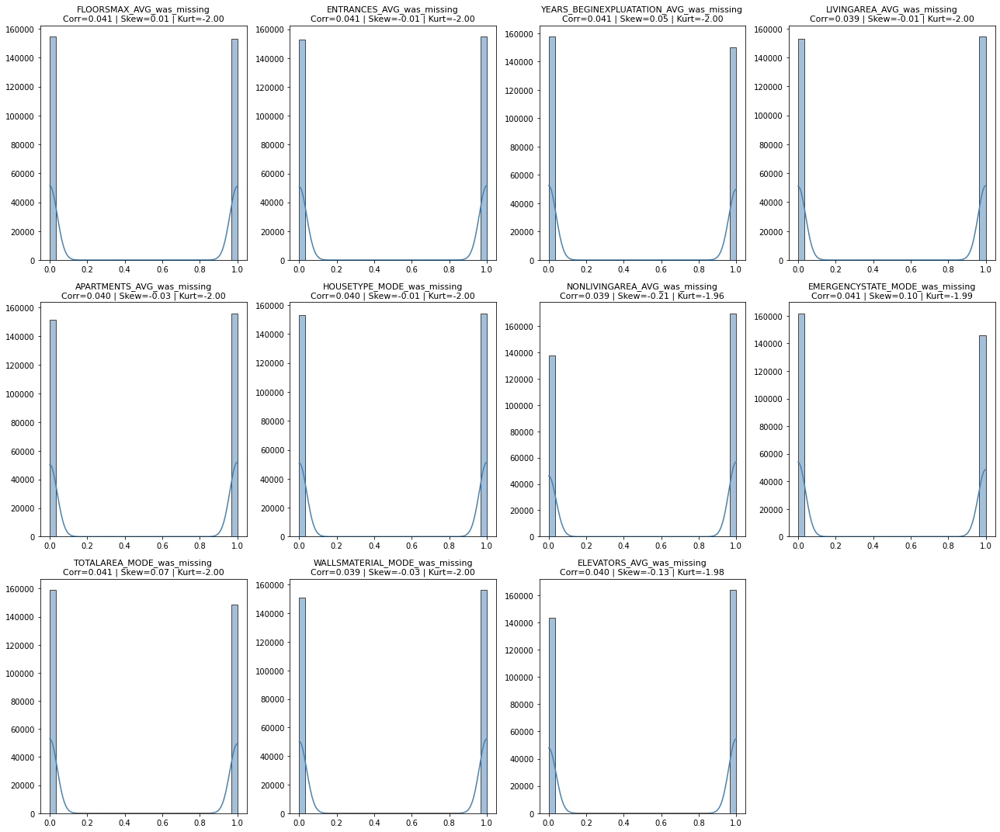

In [236]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 'APARTMENTS_AVG_was_missing', 
            'HOUSETYPE_MODE_was_missing', 'NONLIVINGAREA_AVG_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 'WALLSMATERIAL_MODE_was_missing', 'ELEVATORS_AVG_was_missing']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

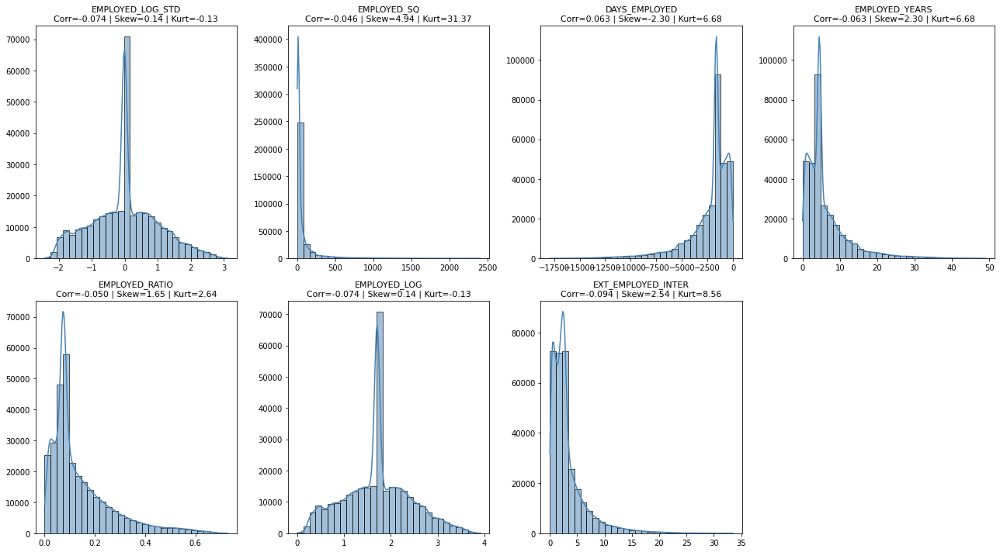

In [237]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_RATIO', 
            'EMPLOYED_LOG', 'EXT_EMPLOYED_INTER']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

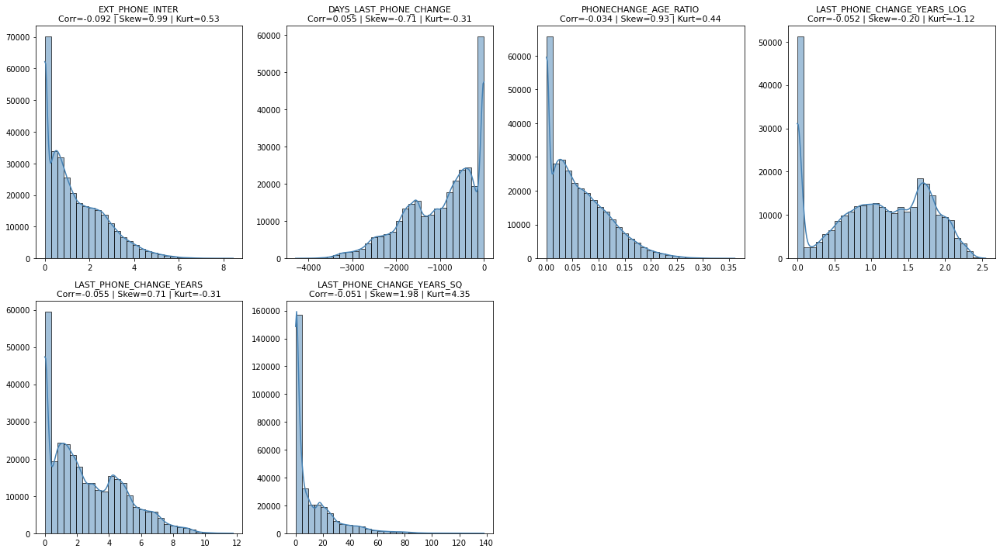

In [238]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_PHONE_INTER', 'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
            'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

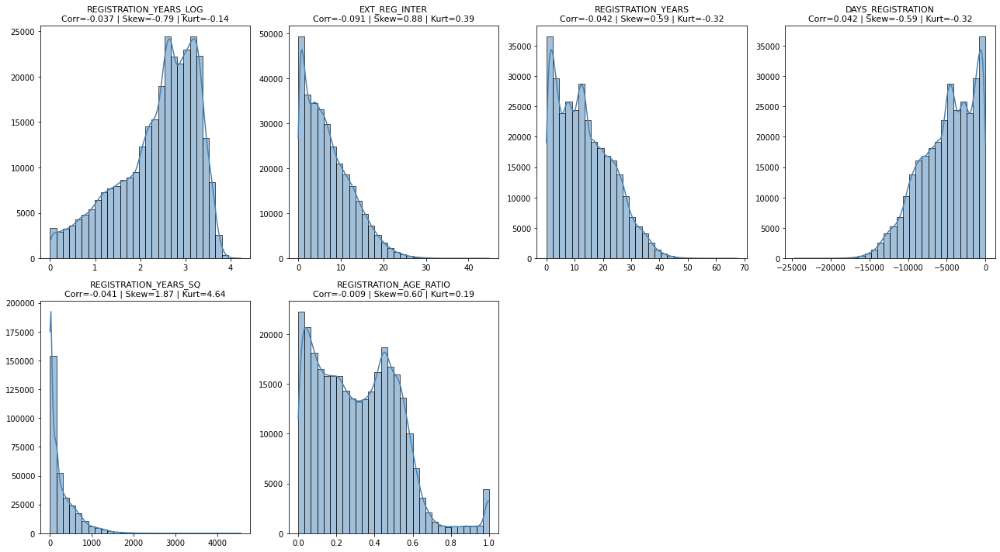

In [239]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS_LOG', 'EXT_REG_INTER', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
            'REGISTRATION_YEARS_SQ', 'REGISTRATION_AGE_RATIO']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

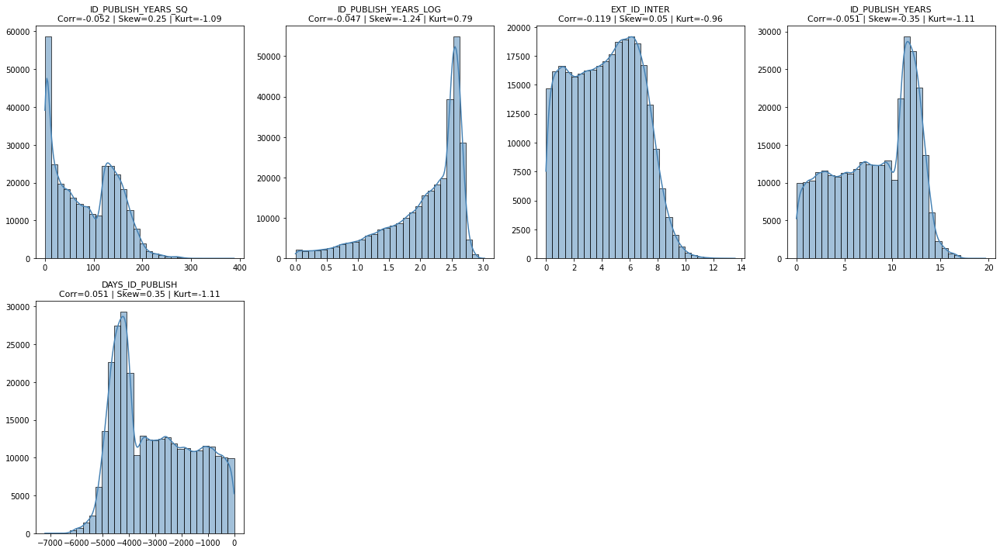

In [240]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'EXT_ID_INTER', 'ID_PUBLISH_YEARS',
            'DAYS_ID_PUBLISH']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

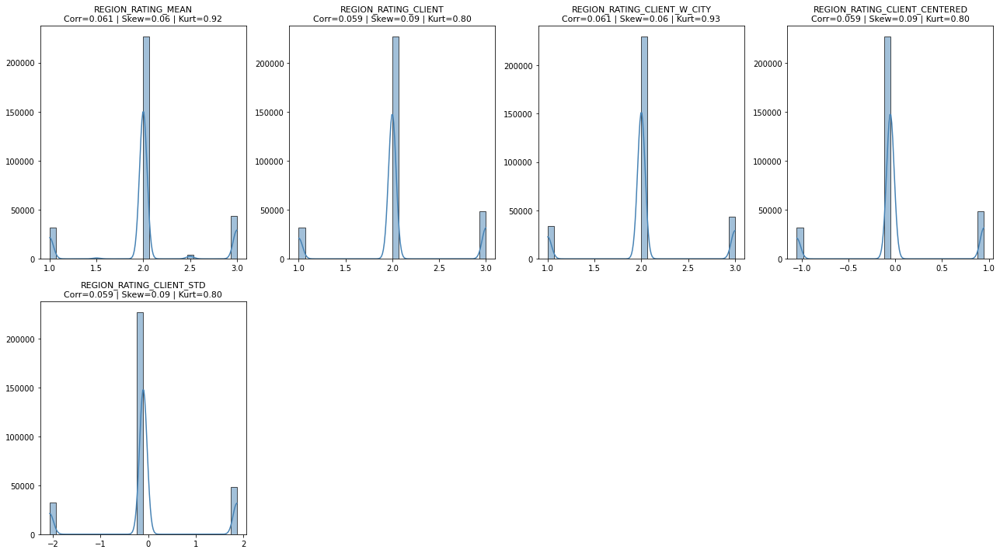

In [241]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_MEAN', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
            'REGION_RATING_CLIENT_STD']

plot_transformations_distributions(
    df=df_train_median_mode,           
    var_list=transfos,              
    target='TARGET'
)

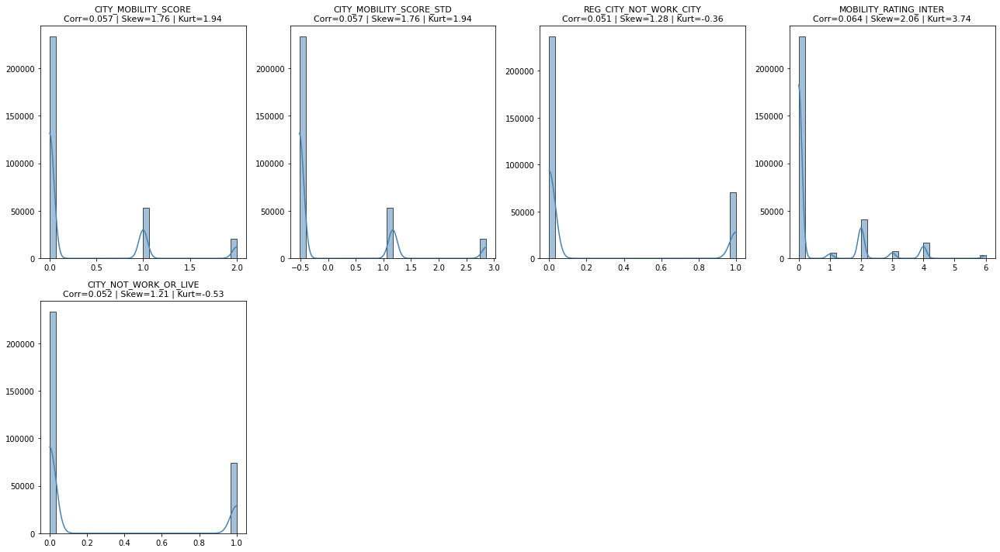

In [242]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CITY_MOBILITY_SCORE', 'CITY_MOBILITY_SCORE_STD', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
            'CITY_NOT_WORK_OR_LIVE']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

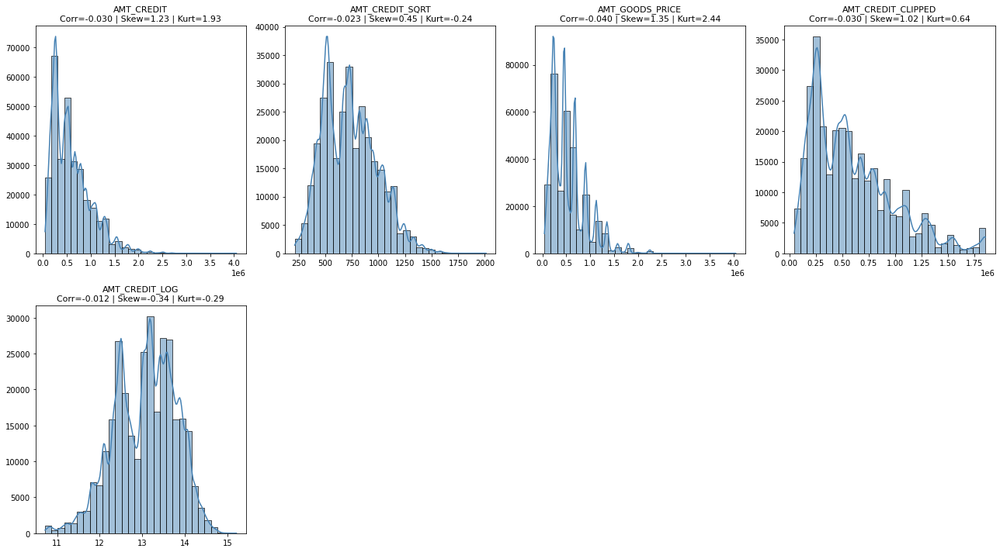

In [243]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_GOODS_PRICE', 'AMT_CREDIT_CLIPPED',
            'AMT_CREDIT_LOG']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

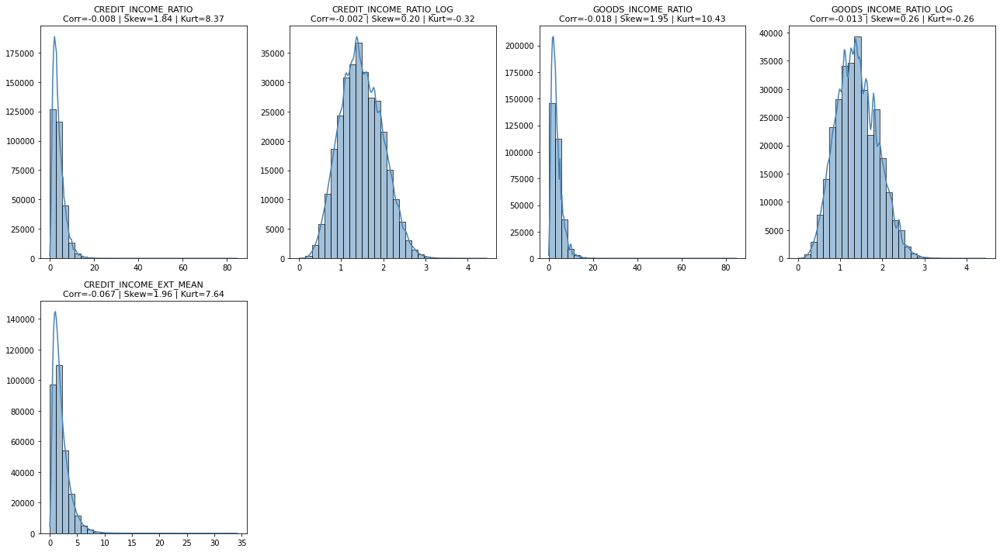

In [244]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
            'CREDIT_INCOME_EXT_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

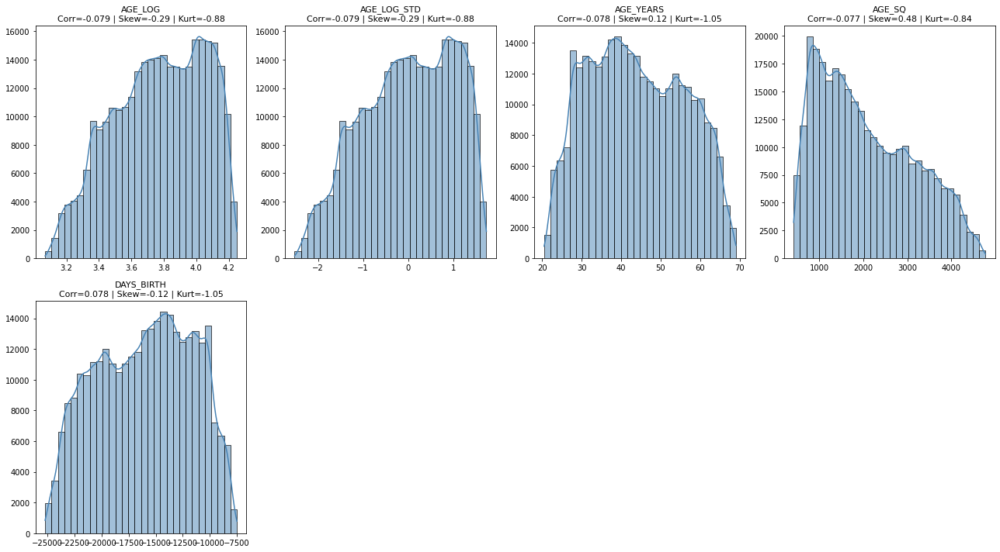

In [245]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG', 'AGE_LOG_STD', 'AGE_YEARS', 'AGE_SQ',
            'DAYS_BIRTH']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

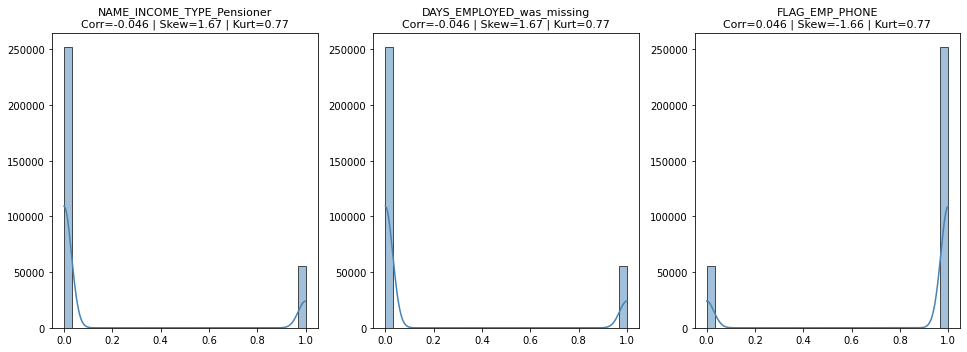

In [246]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 'FLAG_EMP_PHONE']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

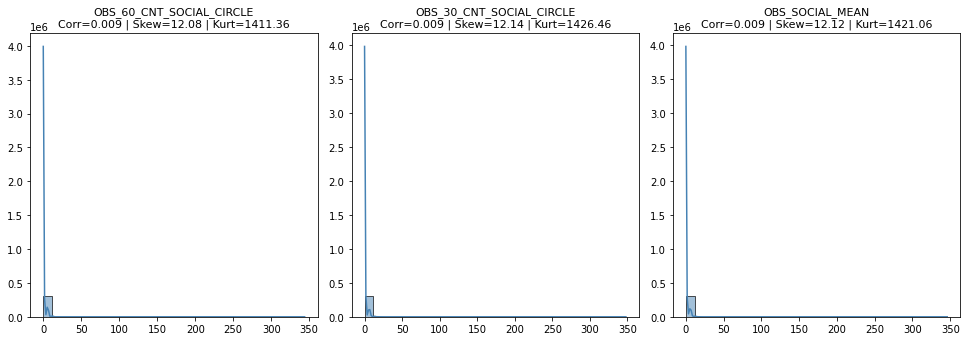

In [247]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_SOCIAL_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

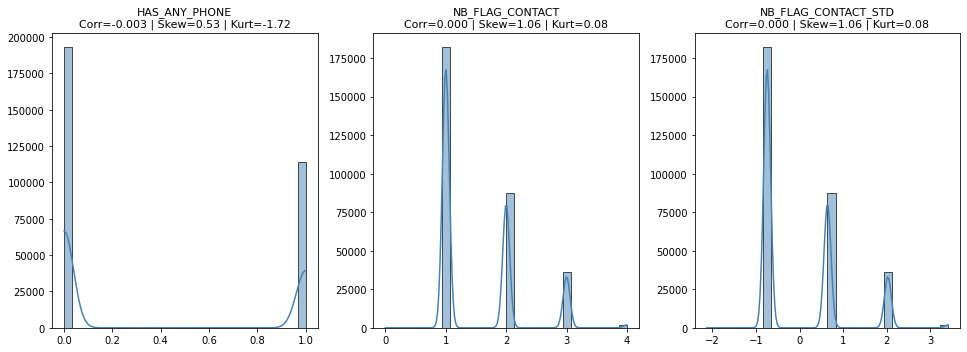

In [248]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['HAS_ANY_PHONE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET'
)

In [252]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'EMERGENCYSTATE_MODE_Yes', 'INCOME_PER_PERSON'
]

df_train_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [250]:
df_train_median_mode.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 259 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(16), float32(64), int32(177), object(2)
memory usage: 340.0+ MB


In [253]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- Pour ce premier dataframe et les suivants, on utilise spearman pour calculer les corrélations et on prend un seuil de corrélation plus important pour éviter la redondance et garder les variables extrêmement corrélées entre elles.
- On peut donc appliquer la même méthode aux dataframes restants.

#### Feature engineering - df_train_iterative_mode

In [254]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
2,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999964
3,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999868
4,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999648
5,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
6,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997350
7,TOTALAREA_MODE_was_missing / YEARS_BEGINEXPLUATATION_AVG_was_missing,YEARS_BEGINEXPLUATATION_AVG_was_missing,TOTALAREA_MODE_was_missing,0.987384
8,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.984914
9,ENTRANCES_AVG_was_missing / FLOORSMAX_AVG_was_missing,ENTRANCES_AVG_was_missing,FLOORSMAX_AVG_was_missing,0.984628


In [255]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_iterative_mode)

In [256]:
optimize_types(df_train_iterative_mode)

 Mémoire avant : 551.55 MB
 Mémoire après : 447.15 MB
 Gain : 18.9%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.025,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.024693
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.000,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.000000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.025,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.025,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.025,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.025,2,1,1,1.170319,0.641034,0.693147,0.202810,0.024693
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.025,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.024693


In [257]:
df_train_iterative_mode.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 319 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(109), int32(191), object(2)
memory usage: 411.9+ MB


#### Corrélation des variables - df_train_iterative_mode

In [258]:
df_corr = get_correlation_pairs(df_train_iterative_mode, method="spearman", style=False, threshold=0.9)

In [259]:
sorted(df_corr['Variable 1'].unique().tolist())

['AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_AVG_was_missing',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_No',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_1',
 'EXT_SOURCE_1_SQ',
 'EXT_SOURCE_2',
 'EXT_SOURCE_2_SQ',
 'EXT_SOURCE_3',
 'EXT_SOURCE_3_SQ',
 'EXT_SOURCE_MEAN',
 'FLAG_EMP_PHONE',
 'FLAG_MOBIL',
 'FLAG_OWN_CAR',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLI

In [260]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_DAY_was_missing',
 'AMT_REQ_CREDIT_BUREAU_HOUR_was_missing',
 'AMT_REQ_CREDIT_BUREAU_MON_was_missing',
 'AMT_REQ_CREDIT_BUREAU_QRT_was_missing',
 'AMT_REQ_CREDIT_BUREAU_WEEK_was_missing',
 'AMT_REQ_CREDIT_BUREAU_YEAR_was_missing',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_LAST_PHONE_CHANGE_was_missing',
 'DEF_SOCIAL_MEAN',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_Yes',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_

In [261]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode, 'TARGET', mode='nonlinear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
EXT_SOURCE_MEAN,-0.270353,-0.246455,0.270353,0.246455,0.035425,0.294617
EXT_SOURCE_MEDIAN,-0.260258,-0.236830,0.260258,0.236830,0.032290,0.278951
EXT_SOURCE_3_SQRT,-0.203430,-0.194856,0.203430,0.194856,0.044774,0.270403
EXT_SOURCE_3,-0.200354,-0.194856,0.200354,0.194856,0.044750,0.269114
EXT_SOURCE_3_SQ,-0.181858,-0.194859,0.181858,0.194859,0.044642,0.261447
EXT_SOURCE_1_3,-0.224476,-0.229994,0.224476,0.229994,0.029476,0.254921
EXT_SOURCE_2_3,-0.213311,-0.214230,0.213311,0.214230,0.025632,0.234612
EXT_SOURCE_1_2,-0.204643,-0.205021,0.204643,0.205021,0.023253,0.221558
EXT_SOURCE_1_SQRT,-0.204010,-0.195172,0.204010,0.195172,0.020373,0.210220
EXT_SOURCE_1,-0.201204,-0.195172,0.201204,0.195172,0.020435,0.209252


In [262]:
pd.reset_option('display.max_rows')

In [263]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[TOTALAREA_MODE_was_missing, YEARS_BEGINEXPLUATATION_AVG_was_missing, WALLSMATERIAL_MODE_was_missing, EMERGENCYSTATE_MODE_was_missing, NONLIVINGAREA_AVG_was_missing, HOUSETYPE_MODE_was_missing, FLOORSMAX_AVG_was_missing, ELEVATORS_AVG_was_missing, LIVINGAREA_AVG_was_missing, APARTMENTS_AVG_was_missing, ENTRANCES_AVG_was_missing]",11,0.041368,EMERGENCYSTATE_MODE_was_missing
1,"[AMT_REQ_CREDIT_BUREAU_HOUR, AMT_REQ_CREDIT_BUREAU_MON_was_missing, AMT_REQ_CREDIT_BUREAU_DAY_was_missing, AMT_REQ_CREDIT_BUREAU_DAY, AMT_REQ_CREDIT_BUREAU_QRT_was_missing, AMT_REQ_CREDIT_BUREAU_HOUR_was_missing, AMT_REQ_CREDIT_BUREAU_YEAR_was_missing, AMT_REQ_CREDIT_BUREAU_WEEK_was_missing]",8,0.032795,AMT_REQ_CREDIT_BUREAU_MON_was_missing
2,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",7,0.126959,EXT_EMPLOYED_INTER
3,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.104569,EXT_PHONE_INTER
4,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.107417,EXT_REG_INTER
5,"[CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",5,0.064119,MOBILITY_RATING_INTER
6,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039651,AMT_GOODS_PRICE
7,"[AGE_LOG_STD, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",5,0.078517,AGE_LOG_STD
8,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY
9,"[GOODS_INCOME_RATIO_LOG, GOODS_INCOME_RATIO, CREDIT_INCOME_RATIO_LOG, CREDIT_INCOME_EXT_MEAN, CREDIT_INCOME_RATIO]",5,0.087855,CREDIT_INCOME_EXT_MEAN


In [264]:
pd.reset_option('display.max_colwidth')

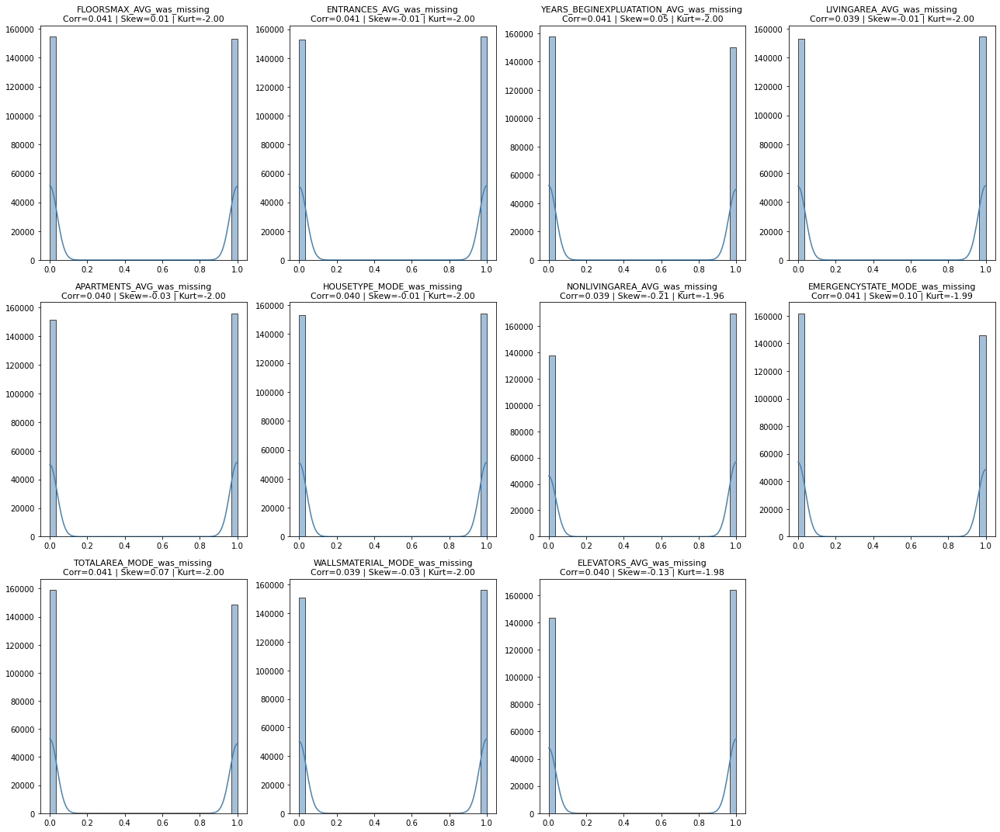

In [265]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 'APARTMENTS_AVG_was_missing', 
            'HOUSETYPE_MODE_was_missing', 'NONLIVINGAREA_AVG_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 'WALLSMATERIAL_MODE_was_missing', 'ELEVATORS_AVG_was_missing']

plot_transformations_distributions(
    df=df_train_iterative_mode,                  #'NONLIVINGAREA_AVG_was_missing' 'WALLSMATERIAL_MODE_was_missing'            
    var_list=transfos,
    target='TARGET'
)

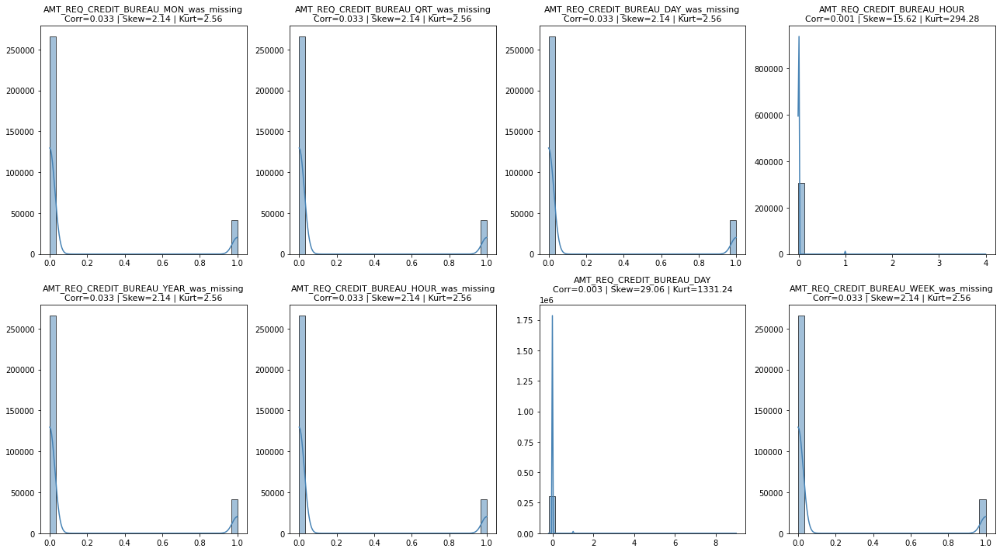

In [266]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_REQ_CREDIT_BUREAU_MON_was_missing', 'AMT_REQ_CREDIT_BUREAU_QRT_was_missing', 'AMT_REQ_CREDIT_BUREAU_DAY_was_missing', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_YEAR_was_missing', 
            'AMT_REQ_CREDIT_BUREAU_HOUR_was_missing', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK_was_missing']

plot_transformations_distributions(          #suprr AMT_REQ_CREDIT_BUREAU_DAY AMT_REQ_CREDIT_BUREAU_HOUR
    df=df_train_iterative_mode,                                                               
    var_list=transfos,
    target='TARGET'
)

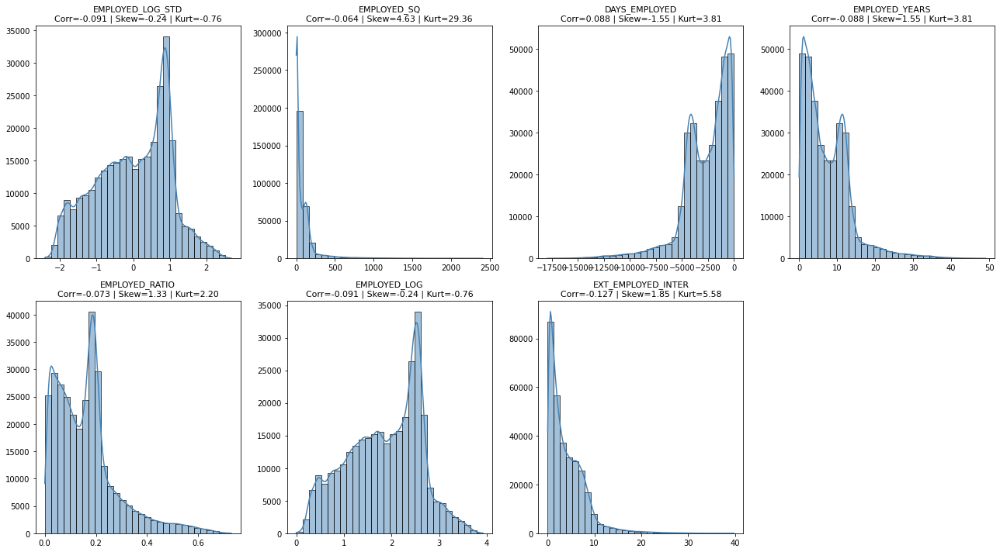

In [267]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_RATIO', 
            'EMPLOYED_LOG', 'EXT_EMPLOYED_INTER']

plot_transformations_distributions(
    df=df_train_iterative_mode,                       #'EXT_EMPLOYED_INTER' 'EMPLOYED_RATIO'
    var_list=transfos,
    target='TARGET'
)

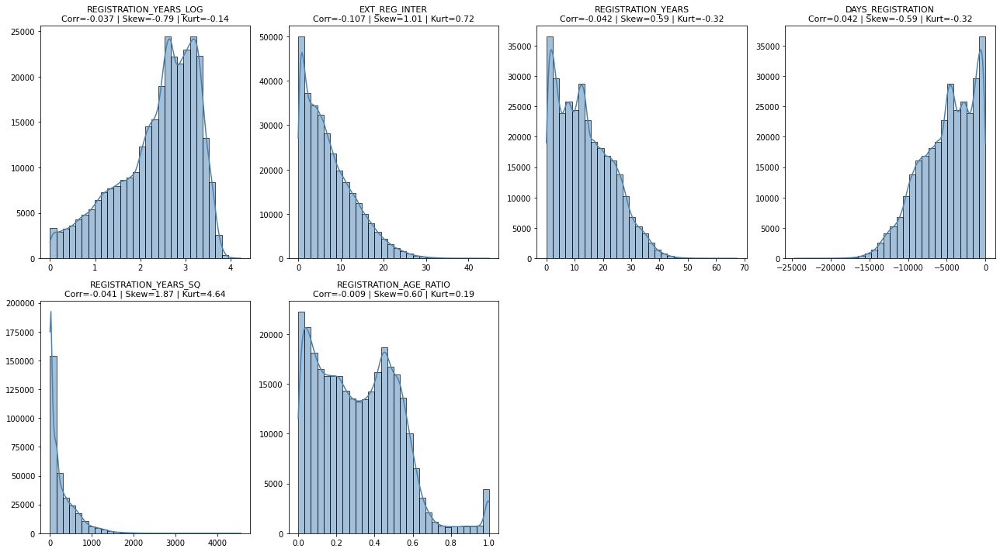

In [268]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS_LOG', 'EXT_REG_INTER', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
            'REGISTRATION_YEARS_SQ', 'REGISTRATION_AGE_RATIO']

plot_transformations_distributions(
    df=df_train_iterative_mode,                #'EXT_REG_INTER' 'REGISTRATION_AGE_RATIO'
    var_list=transfos,
    target='TARGET'
)

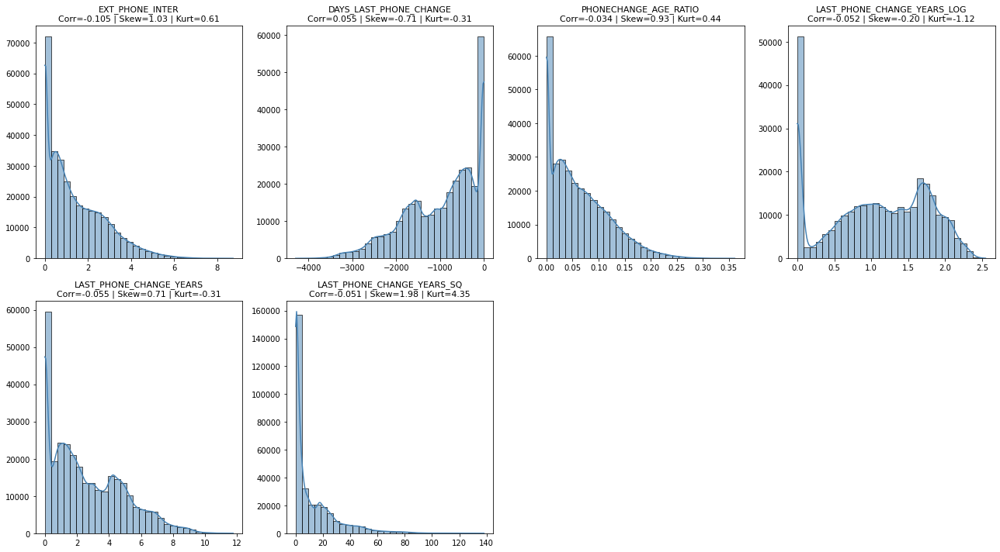

In [269]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_PHONE_INTER', 'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
            'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ']

plot_transformations_distributions(
    df=df_train_iterative_mode,                  #'EXT_PHONE_INTER'
    var_list=transfos,
    target='TARGET'
)

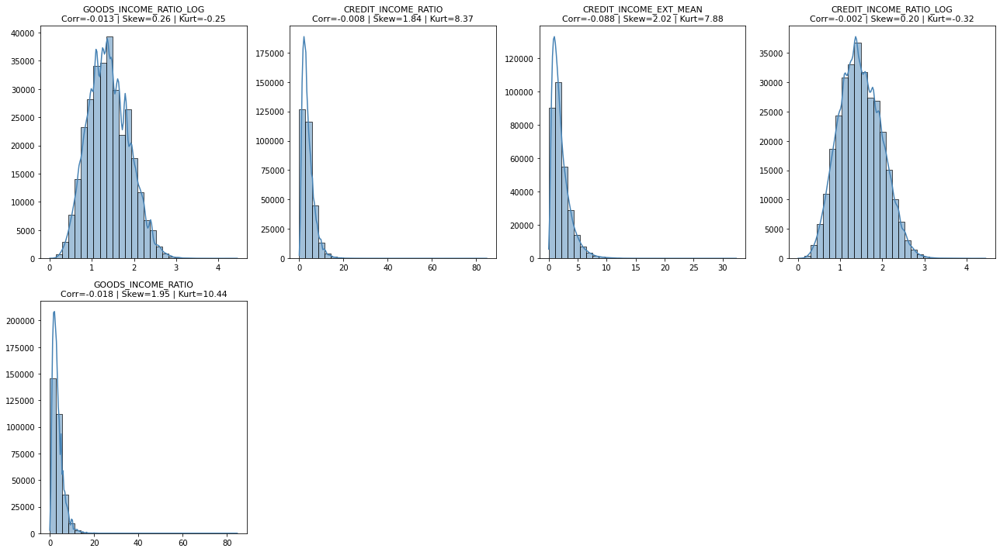

In [270]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['GOODS_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_EXT_MEAN', 'CREDIT_INCOME_RATIO_LOG',
            'GOODS_INCOME_RATIO']

plot_transformations_distributions(                #CREDIT_INCOME_EXT_MEAN
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

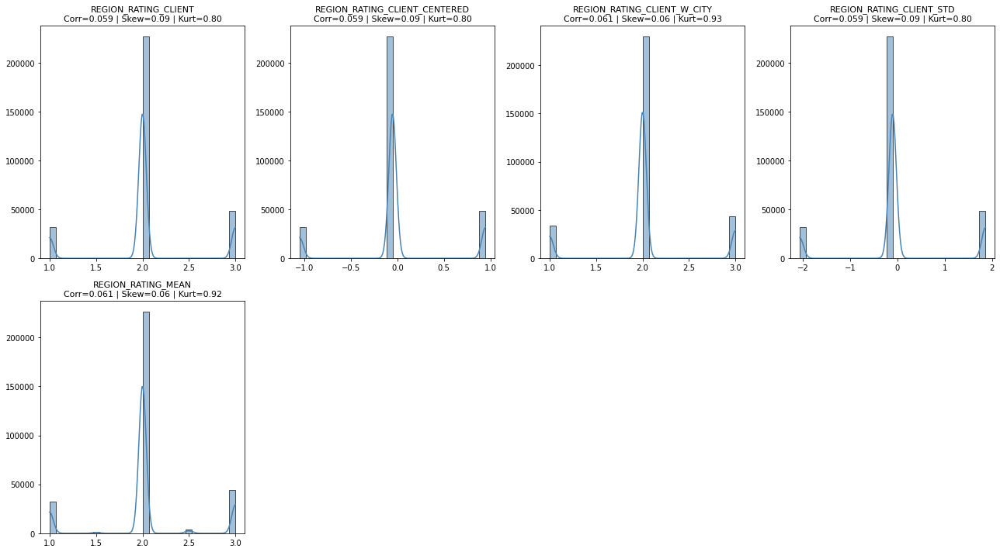

In [271]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_CENTERED', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_STD',
            'REGION_RATING_MEAN']

plot_transformations_distributions(             #REGION_RATING_MEAN
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

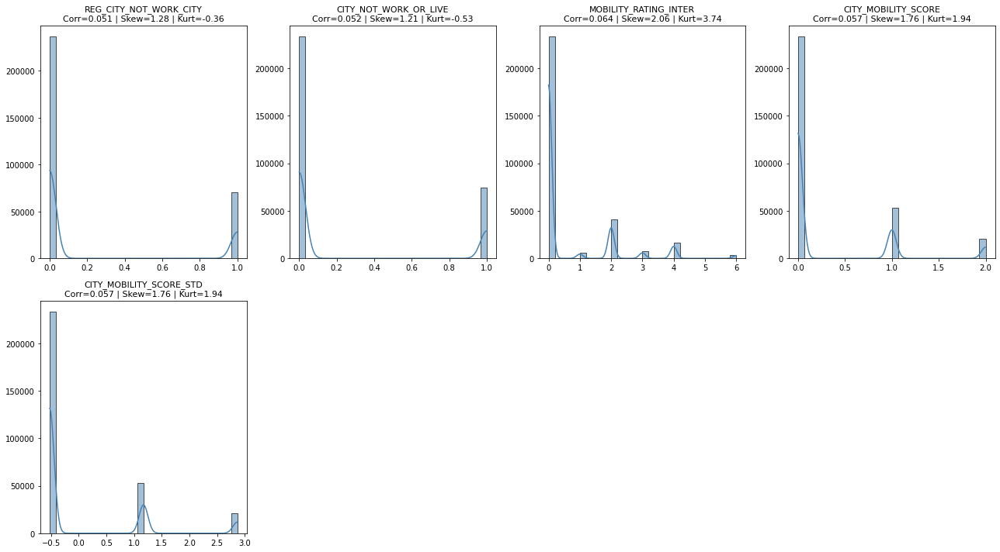

In [272]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REG_CITY_NOT_WORK_CITY', 'CITY_NOT_WORK_OR_LIVE', 'MOBILITY_RATING_INTER', 'CITY_MOBILITY_SCORE',
            'CITY_MOBILITY_SCORE_STD']

plot_transformations_distributions(           #CITY_MOBILITY_SCORE_STD
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

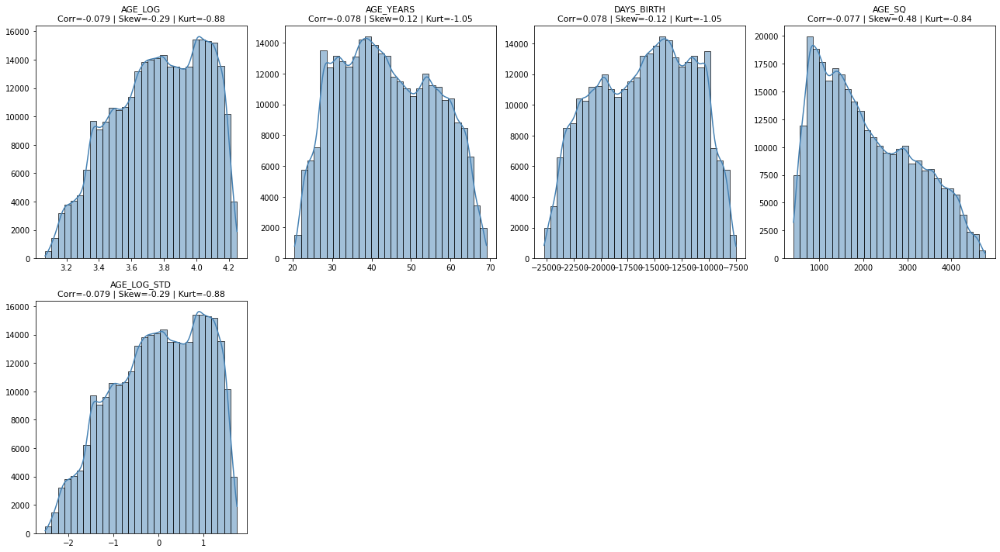

In [273]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG', 'AGE_YEARS', 'DAYS_BIRTH', 'AGE_SQ',
            'AGE_LOG_STD']

plot_transformations_distributions(             #AGE_YEARS
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

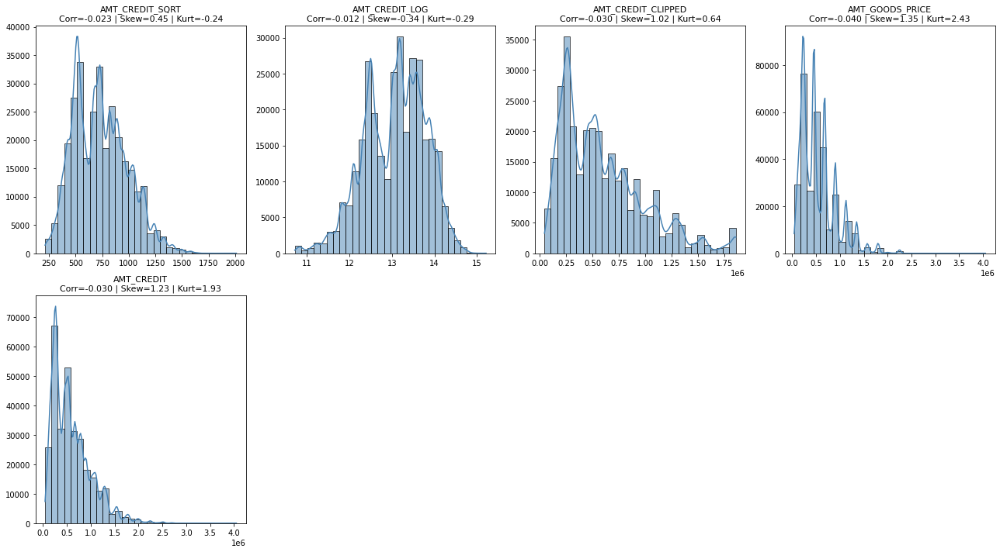

In [274]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT_SQRT', 'AMT_CREDIT_LOG', 'AMT_CREDIT_CLIPPED', 'AMT_GOODS_PRICE',
            'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

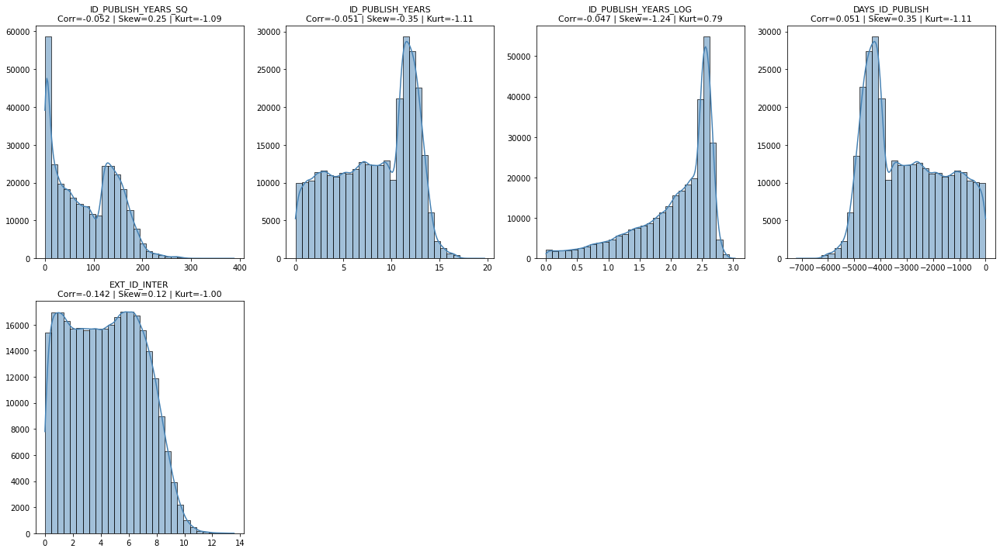

In [275]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS', 'ID_PUBLISH_YEARS_LOG', 'DAYS_ID_PUBLISH',
            'EXT_ID_INTER']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

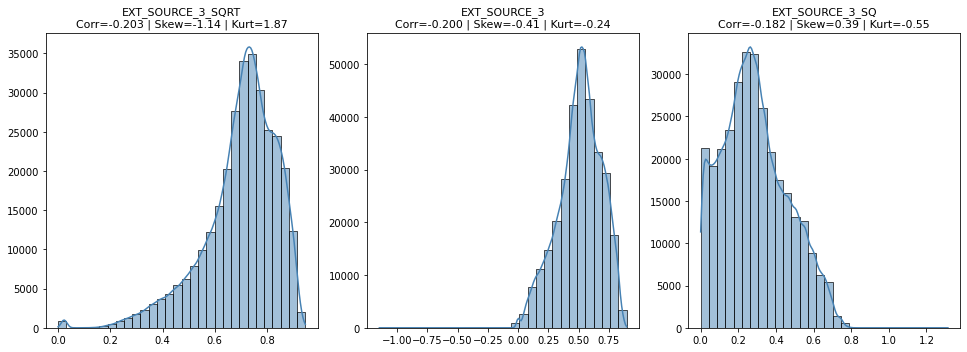

In [276]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_3_SQRT', 'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

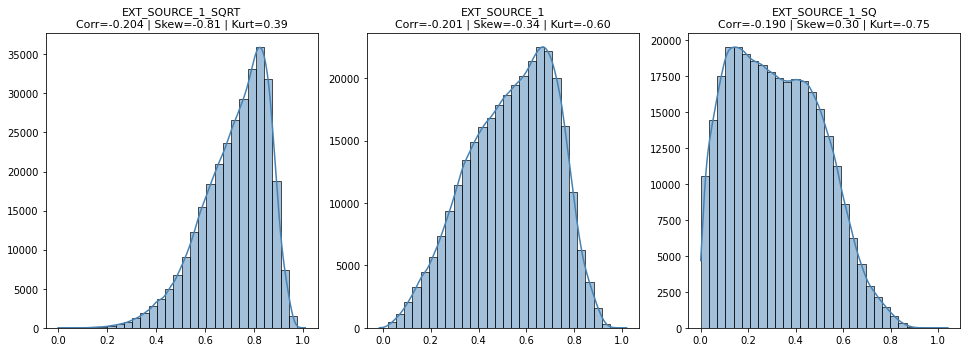

In [277]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_1_SQRT', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

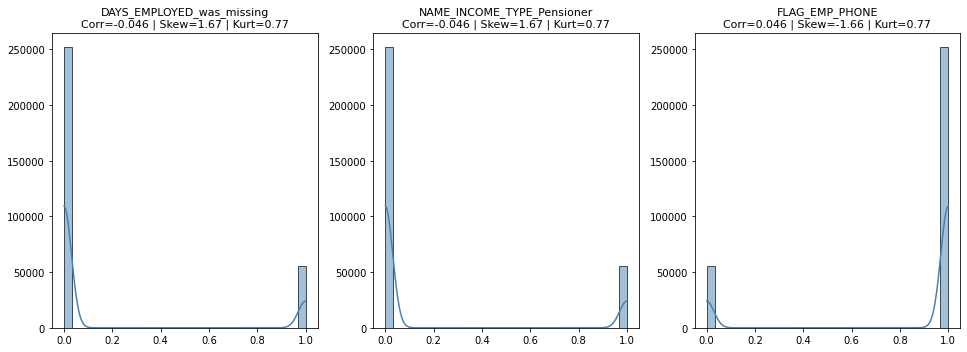

In [278]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DAYS_EMPLOYED_was_missing', 'NAME_INCOME_TYPE_Pensioner', 'FLAG_EMP_PHONE']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

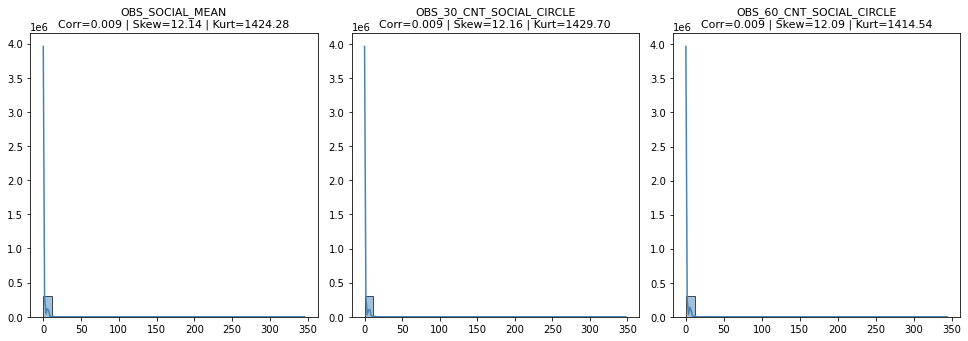

In [279]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_SOCIAL_MEAN', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

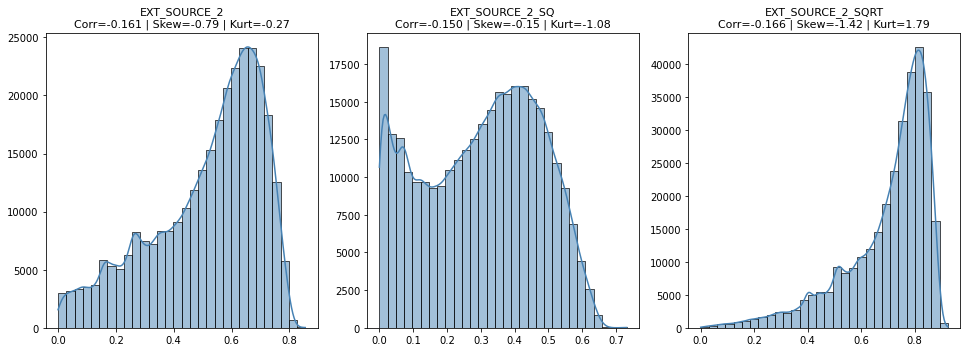

In [280]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_2', 'EXT_SOURCE_2_SQ', 'EXT_SOURCE_2_SQRT']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

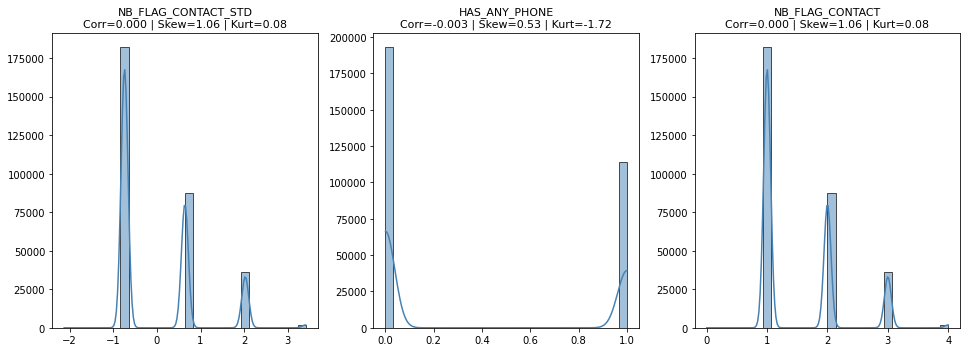

In [281]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_FLAG_CONTACT_STD', 'HAS_ANY_PHONE', 'NB_FLAG_CONTACT']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET'
)

In [284]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'EMERGENCYSTATE_MODE_Yes', 'INCOME_PER_PERSON'
]

df_train_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [285]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


#### Feature engineering - df_train_median_missing

In [286]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
1,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999964
2,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999868
3,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999648
4,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
5,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997338
6,TOTALAREA_MODE_was_missing / YEARS_BEGINEXPLUATATION_AVG_was_missing,YEARS_BEGINEXPLUATATION_AVG_was_missing,TOTALAREA_MODE_was_missing,0.987384
7,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_No,-0.984943
8,EMERGENCYSTATE_MODE_MISSING / EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_MISSING,EMERGENCYSTATE_MODE_No,-0.984943
9,ENTRANCES_AVG_was_missing / FLOORSMAX_AVG_was_missing,ENTRANCES_AVG_was_missing,FLOORSMAX_AVG_was_missing,0.984628


In [287]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_median_missing)

In [288]:
optimize_types(df_train_median_missing)

 Mémoire avant : 566.70 MB
 Mémoire après : 447.05 MB
 Gain : 21.1%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.025,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.024693
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.000,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.000000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.025,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.025,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.025,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.025,2,1,1,1.170319,0.641034,0.693147,0.202810,0.024693
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.025,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.024693


In [289]:
df_train_median_missing.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 319 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(17), float32(96), int32(204), object(2)
memory usage: 411.9+ MB


#### Corrélation des variables - df_train_median_missing

In [290]:
df_corr = get_correlation_pairs(df_train_median_missing, method="spearman", style=False, threshold=0.9)

In [291]:
sorted(df_corr['Variable 1'].unique().tolist())

['AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_AVG_was_missing',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_MISSING',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_RATIO',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'FLAG_EMP_PHONE',
 'FLAG_MOBIL',
 'FLAG_OWN_CAR',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_MISSING',
 'HOUSETYPE_MODE_block of flats',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_PUBLISH_YEARS_SQ',
 'INCOME_PER_PERSON',
 'LAST_PHONE_CHANGE_YEARS',
 'LAST_PHONE_CHAN

In [292]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_EXT_MEAN',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_LAST_PHONE_CHANGE_was_missing',
 'DEF_SOCIAL_MEAN',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_MISSING',
 'EMERGENCYSTATE_MODE_No',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_ID_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_MISSING',
 'HOUSETYPE_MODE_block of flats',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_P

In [293]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing, 'TARGET', mode='nonlinear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
EXT_SOURCE_MEAN,-0.220839,-0.204810,0.220839,0.204810,0.023485,0.228529
EXT_SOURCE_MEDIAN,-0.192486,-0.174847,0.192486,0.174847,0.023865,0.206144
EXT_SOURCE_2_3,-0.193932,-0.192087,0.193932,0.192087,0.020514,0.205304
FLAG_MOBIL,0.000534,0.000534,0.000534,0.000534,0.080609,0.200428
NAME_EDUCATION_TYPE_Secondary / secondary special,0.049804,0.049804,0.049804,0.049804,0.056837,0.180861
FLAG_DOCUMENT_3,0.044371,0.044371,0.044371,0.044371,0.056788,0.176393
EXT_SOURCE_1_3,-0.164080,-0.160658,0.164080,0.160658,0.018334,0.175383
FLAG_EMP_PHONE,0.045978,0.045978,0.045978,0.045978,0.055488,0.174455
REGION_RATING_MEAN,0.060622,0.060321,0.060622,0.060321,0.050749,0.174291
EXT_AGE_INTER,-0.166721,-0.167164,0.166721,0.167164,0.015574,0.172195


In [294]:
pd.reset_option('display.max_rows')

In [295]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[TOTALAREA_MODE_was_missing, HOUSETYPE_MODE_MISSING, EMERGENCYSTATE_MODE_No, YEARS_BEGINEXPLUATATION_AVG_was_missing, WALLSMATERIAL_MODE_was_missing, EMERGENCYSTATE_MODE_was_missing, WALLSMATERIAL_MODE_MISSING, NONLIVINGAREA_AVG_was_missing, EMERGENCYSTATE_MODE_MISSING, FLOORSMAX_AVG_was_missing, HOUSETYPE_MODE_was_missing, LIVINGAREA_AVG_was_missing, ELEVATORS_AVG_was_missing, HOUSETYPE_MODE_block of flats, APARTMENTS_AVG_was_missing, ENTRANCES_AVG_was_missing]",16,0.042178,EMERGENCYSTATE_MODE_No
1,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, EMPLOYED_YEARS, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",7,0.094129,EXT_EMPLOYED_INTER
2,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.090981,EXT_REG_INTER
3,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_LOG, LAST_PHONE_CHANGE_YEARS_SQ, EXT_PHONE_INTER]",6,0.092372,EXT_PHONE_INTER
4,"[GOODS_INCOME_RATIO_LOG, GOODS_INCOME_RATIO, CREDIT_INCOME_RATIO_LOG, CREDIT_INCOME_EXT_MEAN, CREDIT_INCOME_RATIO]",5,0.066642,CREDIT_INCOME_EXT_MEAN
5,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY
6,"[CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",5,0.064119,MOBILITY_RATING_INTER
7,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039650,AMT_GOODS_PRICE
8,"[AGE_LOG_STD, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",5,0.078517,AGE_LOG_STD
9,"[ID_PUBLISH_YEARS_SQ, ID_PUBLISH_YEARS_LOG, EXT_ID_INTER, DAYS_ID_PUBLISH, ID_PUBLISH_YEARS]",5,0.119040,EXT_ID_INTER


In [296]:
pd.reset_option('display.max_colwidth')

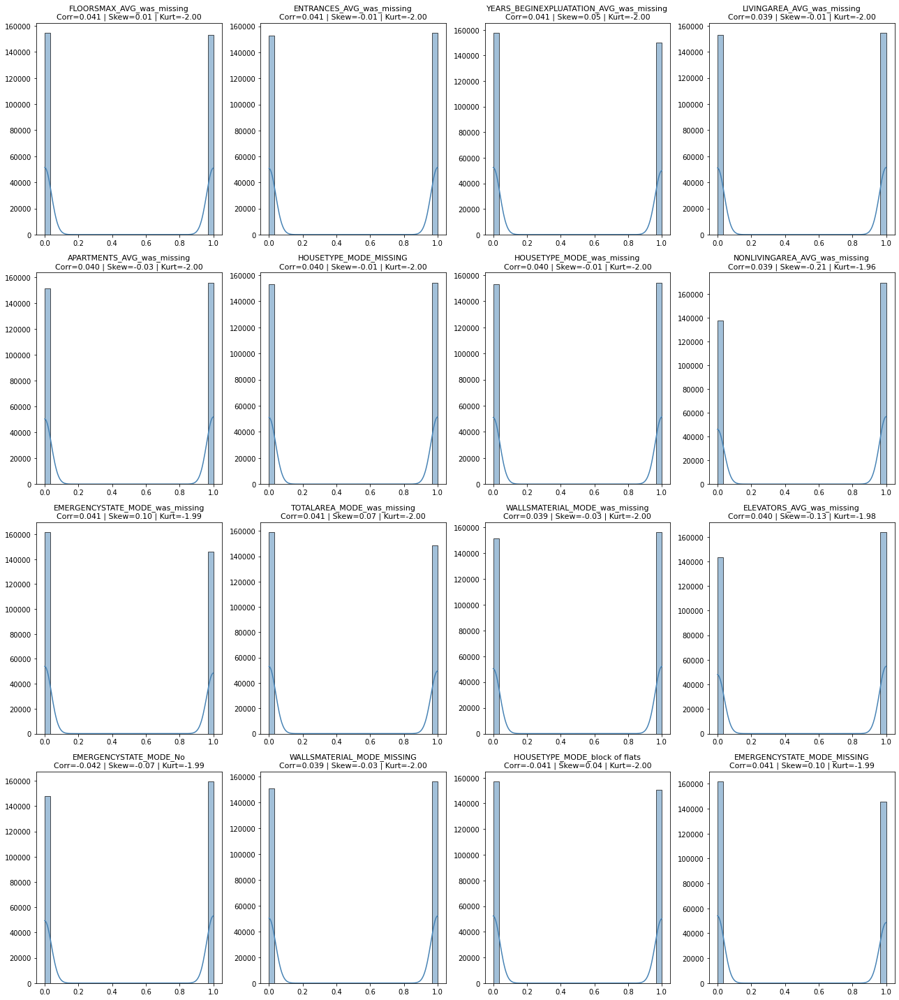

In [297]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING',
            'HOUSETYPE_MODE_was_missing', 'NONLIVINGAREA_AVG_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 'WALLSMATERIAL_MODE_was_missing', 'ELEVATORS_AVG_was_missing',
            'EMERGENCYSTATE_MODE_No', 'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_block of flats', 'EMERGENCYSTATE_MODE_MISSING']

plot_transformations_distributions(
    df=df_train_median_missing,                  # 'EMERGENCYSTATE_MODE_No' 'NONLIVINGAREA_AVG_was_missing' 'WALLSMATERIAL_MODE_was_missing'            
    var_list=transfos,
    target='TARGET'
)

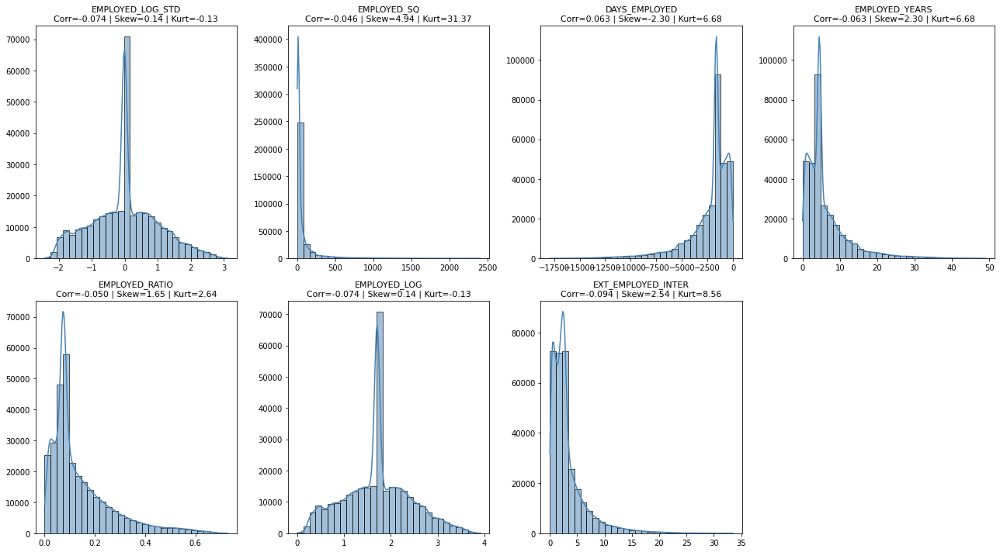

In [298]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_RATIO', 
            'EMPLOYED_LOG', 'EXT_EMPLOYED_INTER']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

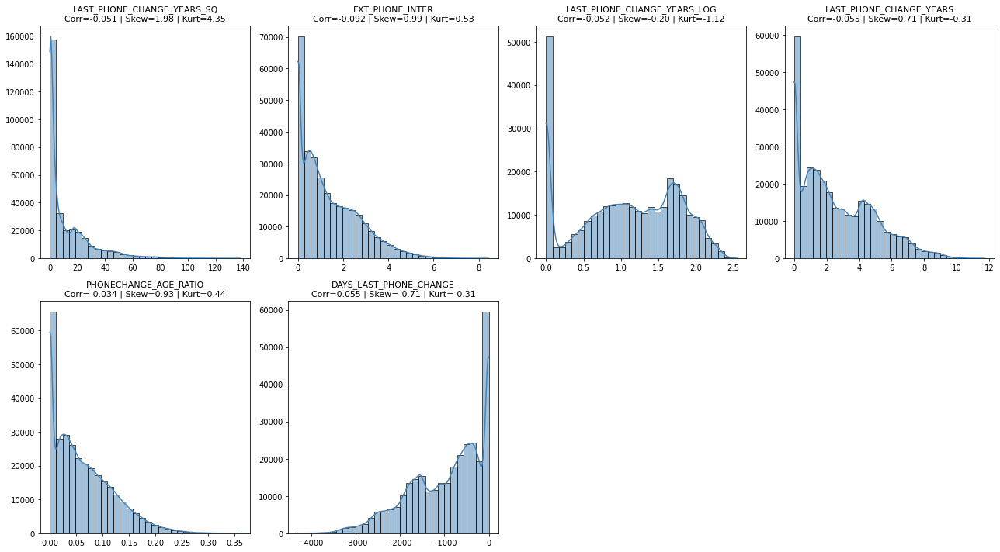

In [299]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LAST_PHONE_CHANGE_YEARS_SQ', 'EXT_PHONE_INTER', 'LAST_PHONE_CHANGE_YEARS_LOG', 'LAST_PHONE_CHANGE_YEARS', 'PHONECHANGE_AGE_RATIO', 
            'DAYS_LAST_PHONE_CHANGE']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

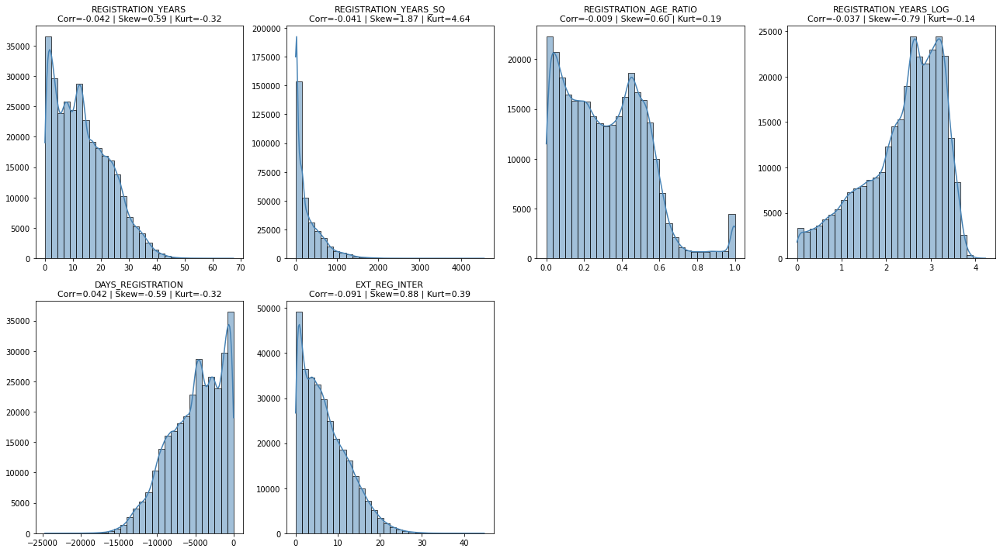

In [300]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS', 'REGISTRATION_YEARS_SQ', 'REGISTRATION_AGE_RATIO', 'REGISTRATION_YEARS_LOG', 'DAYS_REGISTRATION', 
            'EXT_REG_INTER']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

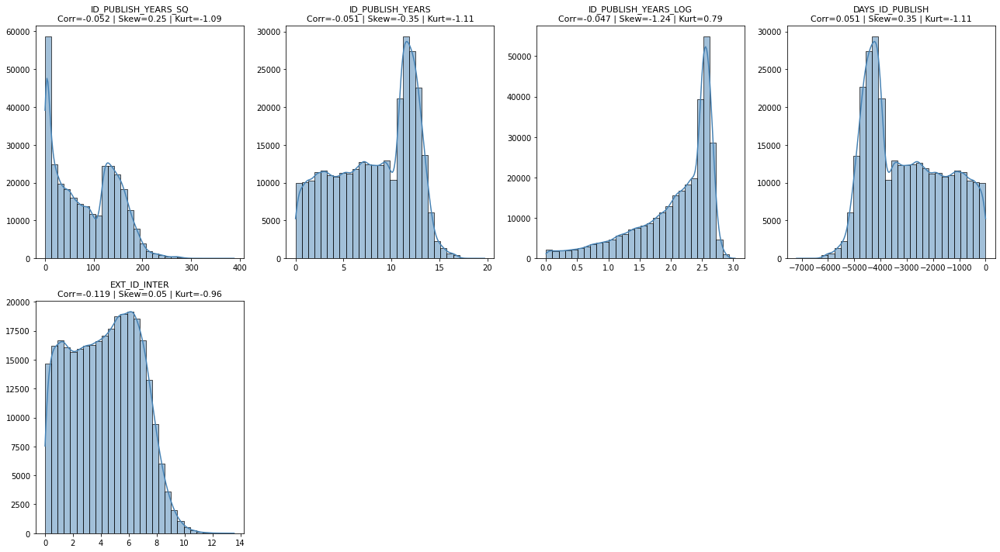

In [301]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS', 'ID_PUBLISH_YEARS_LOG', 'DAYS_ID_PUBLISH', 
            'EXT_ID_INTER']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

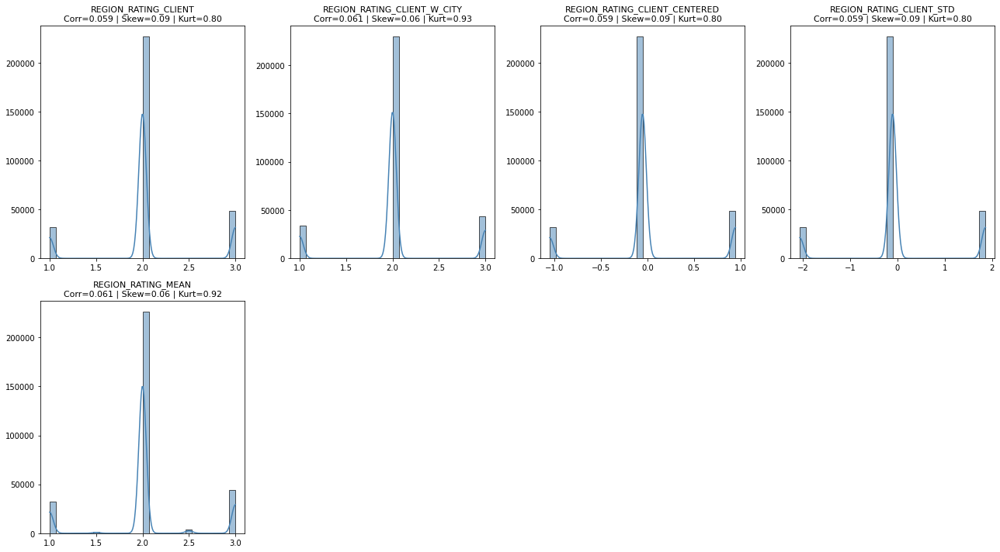

In [302]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED', 'REGION_RATING_CLIENT_STD', 
            'REGION_RATING_MEAN']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

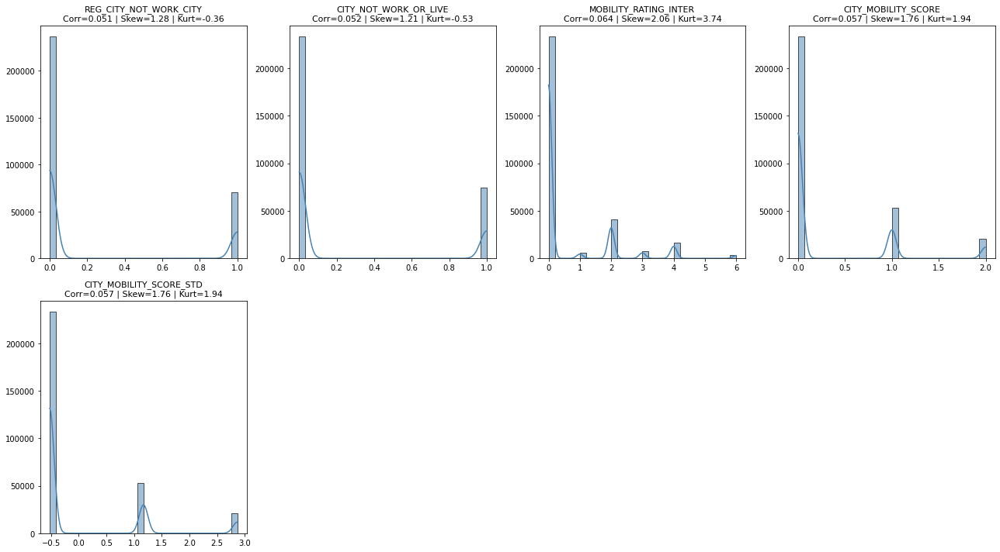

In [303]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REG_CITY_NOT_WORK_CITY', 'CITY_NOT_WORK_OR_LIVE', 'MOBILITY_RATING_INTER', 'CITY_MOBILITY_SCORE', 
            'CITY_MOBILITY_SCORE_STD']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

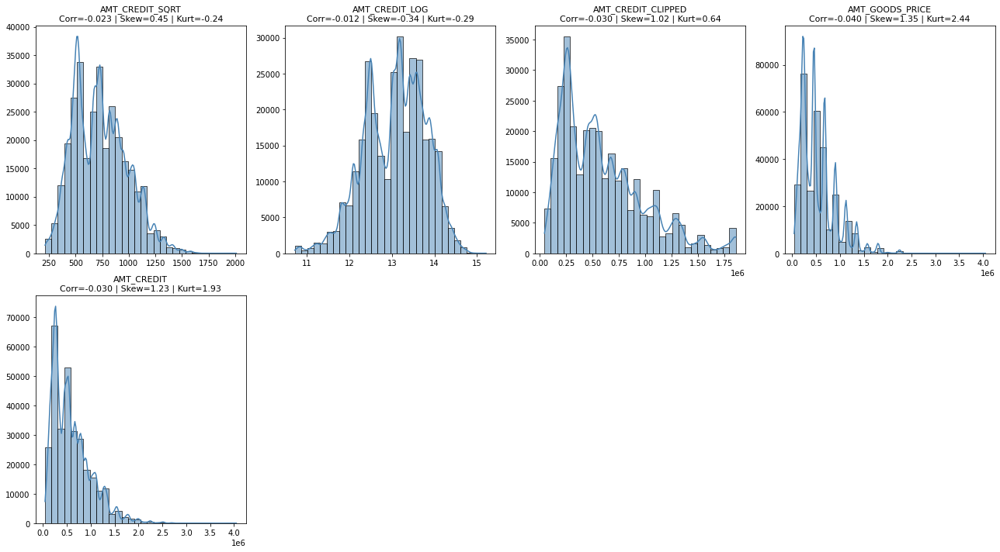

In [304]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT_SQRT', 'AMT_CREDIT_LOG', 'AMT_CREDIT_CLIPPED', 'AMT_GOODS_PRICE', 
            'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_median_missing,
    var_list=transfos,
    target='TARGET'
)

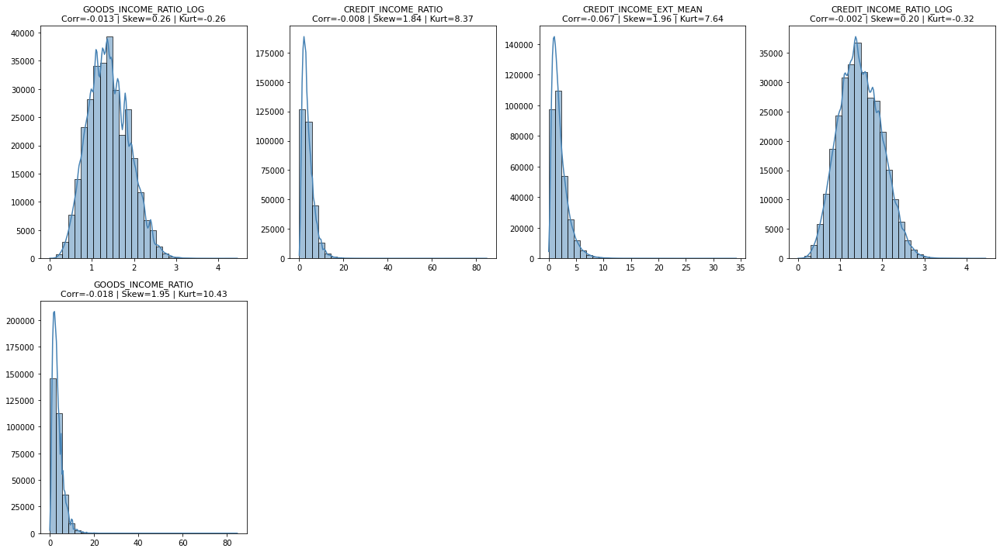

In [305]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['GOODS_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_EXT_MEAN', 'CREDIT_INCOME_RATIO_LOG', 
            'GOODS_INCOME_RATIO']

plot_transformations_distributions(
    df=df_train_median_missing,                       #
    var_list=transfos,
    target='TARGET'
)

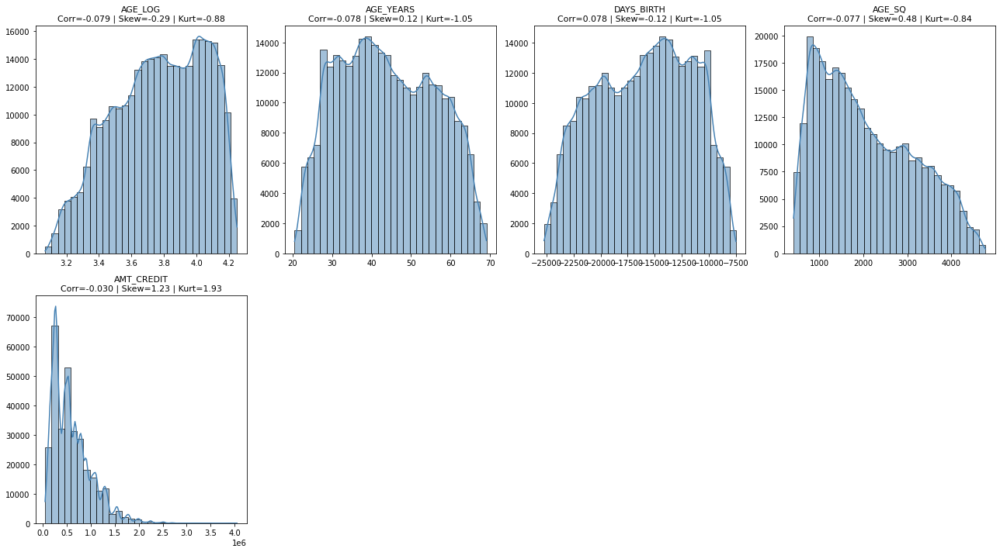

In [306]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG', 'AGE_YEARS', 'DAYS_BIRTH', 'AGE_SQ', 
            'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_median_missing, 
    var_list=transfos,
    target='TARGET'
)

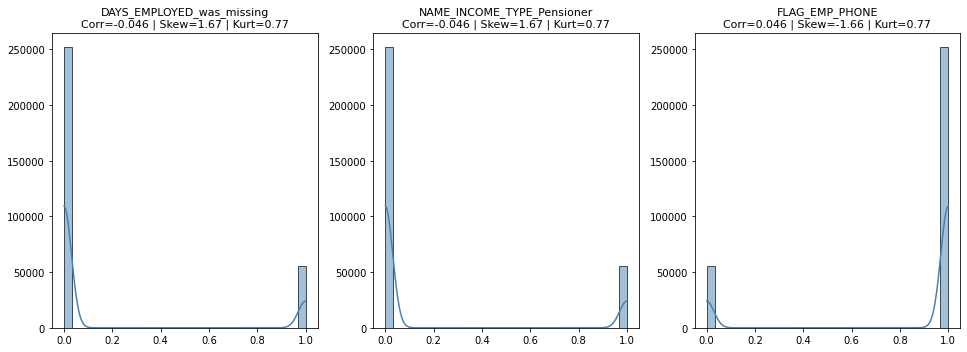

In [307]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['DAYS_EMPLOYED_was_missing', 'NAME_INCOME_TYPE_Pensioner', 'FLAG_EMP_PHONE']

plot_transformations_distributions(
    df=df_train_median_missing,                       #
    var_list=transfos,
    target='TARGET'
)

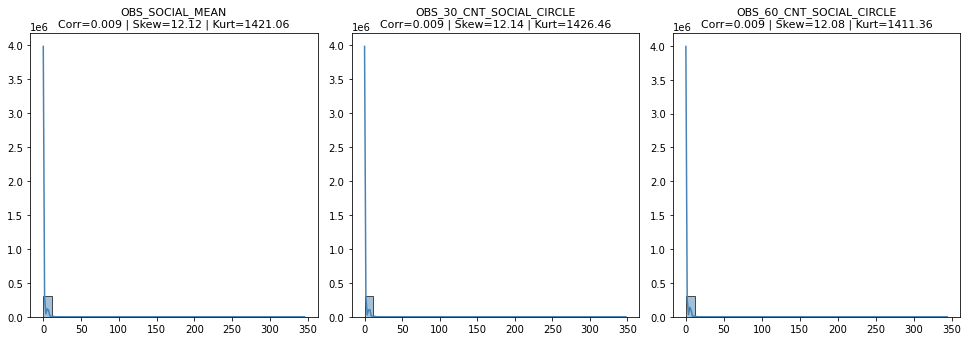

In [308]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_SOCIAL_MEAN', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']

plot_transformations_distributions(
    df=df_train_median_missing,                       #
    var_list=transfos,
    target='TARGET'
)

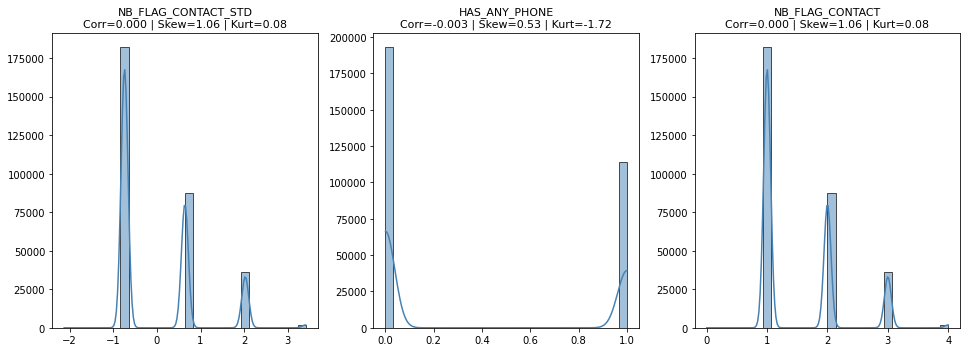

In [309]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_FLAG_CONTACT_STD', 'HAS_ANY_PHONE', 'NB_FLAG_CONTACT']

plot_transformations_distributions(
    df=df_train_median_missing,                       #
    var_list=transfos,
    target='TARGET'
)

In [312]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING', 'WALLSMATERIAL_MODE_MISSING', 'WALLSMATERIAL_MODE_was_missing', 'HOUSETYPE_MODE_block of flats', 
    'EMERGENCYSTATE_MODE_MISSING',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'INCOME_PER_PERSON'
]

df_train_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [313]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


#### Feature engineering - df_train_nan_missing

In [314]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,DAYS_LAST_PHONE_CHANGE_was_missing / FLAG_MOBIL,FLAG_MOBIL,DAYS_LAST_PHONE_CHANGE_was_missing,-1.000000
1,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999964
2,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999868
3,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999648
4,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999515
5,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997336
6,TOTALAREA_MODE_was_missing / YEARS_BEGINEXPLUATATION_AVG_was_missing,YEARS_BEGINEXPLUATATION_AVG_was_missing,TOTALAREA_MODE_was_missing,0.987384
7,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_No,-0.984943
8,EMERGENCYSTATE_MODE_MISSING / EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_MISSING,EMERGENCYSTATE_MODE_No,-0.984943
9,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.984900


In [315]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_train_nan_missing)

In [316]:
optimize_types(df_train_nan_missing)

 Mémoire avant : 574.91 MB
 Mémoire après : 472.86 MB
 Gain : 17.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100002,1,0,1,0,1,0,202500.0,406597.5,24700.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
1,100003,0,0,0,0,0,0,270000.0,1293502.5,35698.5,...,0,0.025,2,0,0,-0.522437,0.641034,0.693147,0.202810,0.024693
2,100004,0,1,1,1,1,0,67500.0,135000.0,6750.0,...,1,0.000,0,0,1,-0.522437,2.025952,0.000000,-2.701903,0.000000
3,100006,0,0,0,0,1,0,135000.0,312682.5,29686.5,...,0,0.025,1,1,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
4,100007,0,0,1,0,1,0,121500.0,513000.0,21865.5,...,0,0.025,1,1,0,1.170319,-0.743883,0.693147,0.202810,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,1,0,0,0,157500.0,254700.0,27558.0,...,0,0.025,1,0,0,-0.522437,-0.743883,0.693147,0.202810,0.024693
307507,456252,0,0,0,0,1,0,72000.0,269550.0,12001.5,...,0,0.025,2,1,1,-0.522437,0.641034,0.693147,0.202810,0.024693
307508,456253,0,0,0,0,1,0,153000.0,677664.0,29979.0,...,0,0.025,2,1,1,1.170319,0.641034,0.693147,0.202810,0.024693
307509,456254,1,0,0,0,1,0,171000.0,370107.0,20205.0,...,0,0.025,1,1,0,2.863075,-0.743883,0.693147,0.202810,0.024693


In [317]:
df_train_nan_missing.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307500 entries, 0 to 307510
Columns: 319 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Float64(15), Int32(13), Int64(17), float32(81), int32(191), object(2)
memory usage: 437.7+ MB


#### Corrélation des variables - df_train_nan_missing

In [318]:
df_corr = get_correlation_pairs(df_train_nan_missing, method="spearman", style=False, threshold=0.9)

In [319]:
sorted(df_corr['Variable 1'].unique().tolist())

['AMT_CREDIT',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO',
 'APARTMENTS_AVG',
 'APARTMENTS_AVG_was_missing',
 'CITY_MOBILITY_SCORE',
 'CITY_NOT_WORK_OR_LIVE',
 'CNT_CHILDREN',
 'CREDIT_GOODS_RATIO',
 'CREDIT_INCOME_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_MISSING',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_SOURCE_MEAN',
 'FLAG_EMP_PHONE',
 'FLAG_MOBIL',
 'FLAG_OWN_CAR',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_MISSING',
 'HOUSETYPE_MODE_block of flats',
 'HOUSETYPE_MODE_was_missing',
 'INCOME_PER_PERSON',
 'LAST_PHONE_CHANGE_YEARS',
 'LAST_PHONE_CHANGE_Y

In [320]:
sorted(df_corr['Variable 2'].unique().tolist())

['AGE_LOG',
 'AGE_LOG_STD',
 'AGE_SQ',
 'AGE_YEARS',
 'AMT_CREDIT_CLIPPED',
 'AMT_CREDIT_LOG',
 'AMT_CREDIT_SQRT',
 'AMT_GOODS_PRICE',
 'ANNUITY_INCOME_RATIO_LOG',
 'CHILDREN_RATIO',
 'CITY_MOBILITY_SCORE',
 'CITY_MOBILITY_SCORE_STD',
 'CITY_NOT_WORK_OR_LIVE',
 'CREDIT_GOODS_DIFF_RATIO',
 'CREDIT_INCOME_RATIO_LOG',
 'DAYS_EMPLOYED_was_missing',
 'DAYS_LAST_PHONE_CHANGE_was_missing',
 'DEF_SOCIAL_MEAN',
 'ELEVATORS_AVG_was_missing',
 'EMERGENCYSTATE_MODE_MISSING',
 'EMERGENCYSTATE_MODE_No',
 'EMERGENCYSTATE_MODE_was_missing',
 'EMPLOYED_LOG',
 'EMPLOYED_LOG_STD',
 'EMPLOYED_RATIO',
 'EMPLOYED_SQ',
 'EMPLOYED_YEARS',
 'ENTRANCES_AVG_was_missing',
 'EXT_EMPLOYED_INTER',
 'EXT_PHONE_INTER',
 'EXT_REG_INTER',
 'EXT_SOURCE_2_3',
 'EXT_SOURCE_MEDIAN',
 'FLOORSMAX_AVG_was_missing',
 'GOODS_INCOME_RATIO',
 'GOODS_INCOME_RATIO_LOG',
 'HAS_ANY_PHONE',
 'HOUSETYPE_MODE_MISSING',
 'HOUSETYPE_MODE_block of flats',
 'HOUSETYPE_MODE_was_missing',
 'ID_PUBLISH_YEARS',
 'ID_PUBLISH_YEARS_LOG',
 'ID_PUBL

In [321]:
# Visualisation des corrélations les plus importantes avec la Target.

pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing, 'TARGET', mode='nonlinear', plot=False)
target_corr

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
EXT_SOURCE_MEAN,-0.222045,-0.204328,0.222045,0.204328,0.023564,0.229015
EXT_SOURCE_MEDIAN,-0.218111,-0.199617,0.218111,0.199617,0.022277,0.222362
EXT_SOURCE_2_3,-0.199491,-0.200850,0.199491,0.200850,0.018329,0.205613
FLAG_MOBIL,0.000534,0.000534,0.000534,0.000534,0.080609,0.200428
EXT_AGE_INTER,-0.181534,-0.183020,0.181534,0.183020,0.019081,0.193164
NAME_EDUCATION_TYPE_Secondary / secondary special,0.049804,0.049804,0.049804,0.049804,0.056837,0.180861
EXT_SOURCE_1_3,-0.187838,-0.200989,0.187838,0.200989,0.008409,0.176394
FLAG_DOCUMENT_3,0.044371,0.044371,0.044371,0.044371,0.056788,0.176393
FLAG_EMP_PHONE,0.045978,0.045978,0.045978,0.045978,0.055488,0.174455
REGION_RATING_MEAN,0.060622,0.060321,0.060622,0.060321,0.050749,0.174291


In [322]:
pd.reset_option('display.max_rows')

In [323]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[TOTALAREA_MODE_was_missing, HOUSETYPE_MODE_MISSING, EMERGENCYSTATE_MODE_No, YEARS_BEGINEXPLUATATION_AVG_was_missing, WALLSMATERIAL_MODE_was_missing, EMERGENCYSTATE_MODE_was_missing, WALLSMATERIAL_MODE_MISSING, NONLIVINGAREA_AVG_was_missing, EMERGENCYSTATE_MODE_MISSING, FLOORSMAX_AVG_was_missing, HOUSETYPE_MODE_was_missing, LIVINGAREA_AVG_was_missing, ELEVATORS_AVG_was_missing, HOUSETYPE_MODE_block of flats, APARTMENTS_AVG_was_missing, ENTRANCES_AVG_was_missing]",16,0.042178,EMERGENCYSTATE_MODE_No
1,"[EXT_EMPLOYED_INTER, EMPLOYED_SQ, EMPLOYED_LOG, DAYS_EMPLOYED, INCOME_EMPLOYED_INTER, EMPLOYED_YEARS, EMPLOYED_RATIO, EMPLOYED_LOG_STD]",8,0.111575,EXT_EMPLOYED_INTER
2,"[REGISTRATION_YEARS_SQ, REGISTRATION_YEARS_LOG, REGISTRATION_AGE_RATIO, DAYS_REGISTRATION, REGISTRATION_YEARS, EXT_REG_INTER]",6,0.105603,EXT_REG_INTER
3,"[LAST_PHONE_CHANGE_YEARS, DAYS_LAST_PHONE_CHANGE, PHONECHANGE_AGE_RATIO, LAST_PHONE_CHANGE_YEARS_SQ, LAST_PHONE_CHANGE_YEARS_LOG, EXT_PHONE_INTER]",6,0.101550,EXT_PHONE_INTER
4,"[AGE_LOG_STD, AGE_YEARS, AGE_LOG, AGE_SQ, DAYS_BIRTH]",5,0.078517,AGE_LOG_STD
5,"[REGION_RATING_CLIENT_CENTERED, REGION_RATING_CLIENT_STD, REGION_RATING_MEAN, REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY]",5,0.060875,REGION_RATING_CLIENT_W_CITY
6,"[AMT_CREDIT_CLIPPED, AMT_CREDIT_LOG, AMT_CREDIT, AMT_CREDIT_SQRT, AMT_GOODS_PRICE]",5,0.039671,AMT_GOODS_PRICE
7,"[CITY_MOBILITY_SCORE_STD, MOBILITY_RATING_INTER, CITY_NOT_WORK_OR_LIVE, REG_CITY_NOT_WORK_CITY, CITY_MOBILITY_SCORE]",5,0.064119,MOBILITY_RATING_INTER
8,"[ID_PUBLISH_YEARS, ID_PUBLISH_YEARS_LOG, ID_PUBLISH_YEARS_SQ, DAYS_ID_PUBLISH]",4,0.051640,ID_PUBLISH_YEARS_SQ
9,"[GOODS_INCOME_RATIO_LOG, CREDIT_INCOME_RATIO_LOG, CREDIT_INCOME_RATIO, GOODS_INCOME_RATIO]",4,0.017686,GOODS_INCOME_RATIO


In [324]:
pd.reset_option('display.max_colwidth')

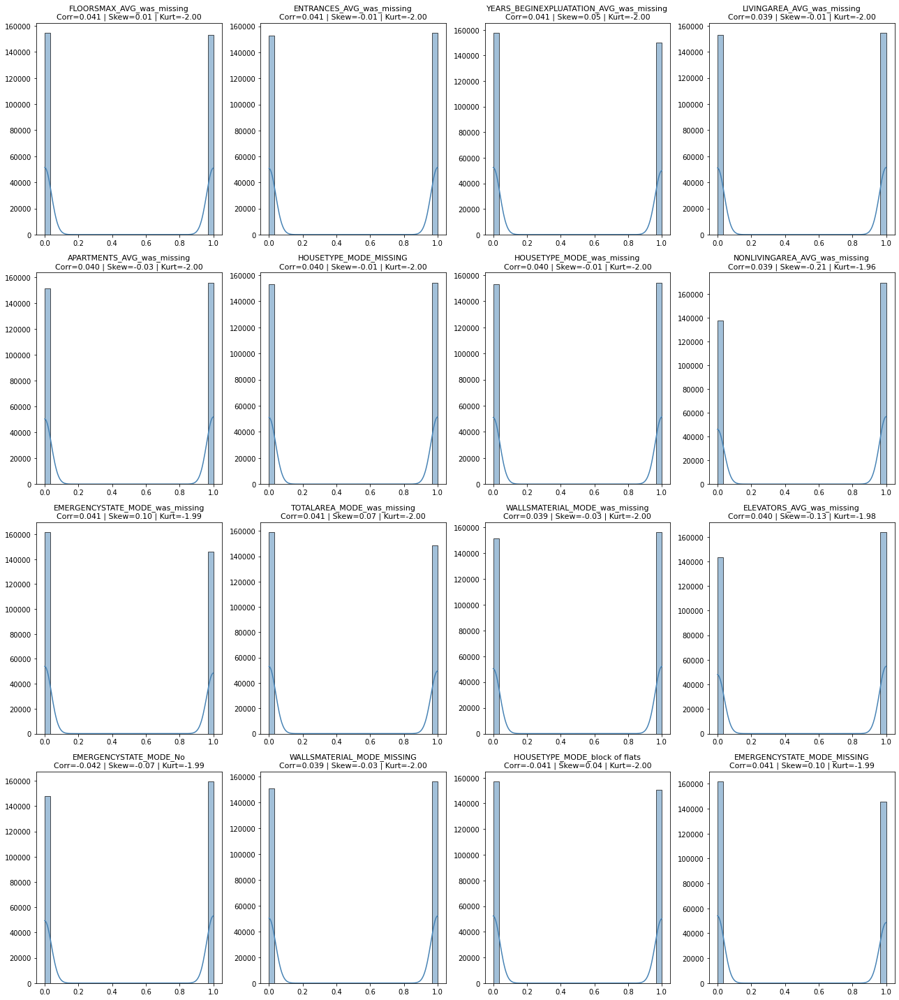

In [325]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING',
            'HOUSETYPE_MODE_was_missing', 'NONLIVINGAREA_AVG_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 'WALLSMATERIAL_MODE_was_missing', 'ELEVATORS_AVG_was_missing',
            'EMERGENCYSTATE_MODE_No', 'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_block of flats', 'EMERGENCYSTATE_MODE_MISSING']

plot_transformations_distributions(
    df=df_train_nan_missing,          
    var_list=transfos,
    target='TARGET'
)

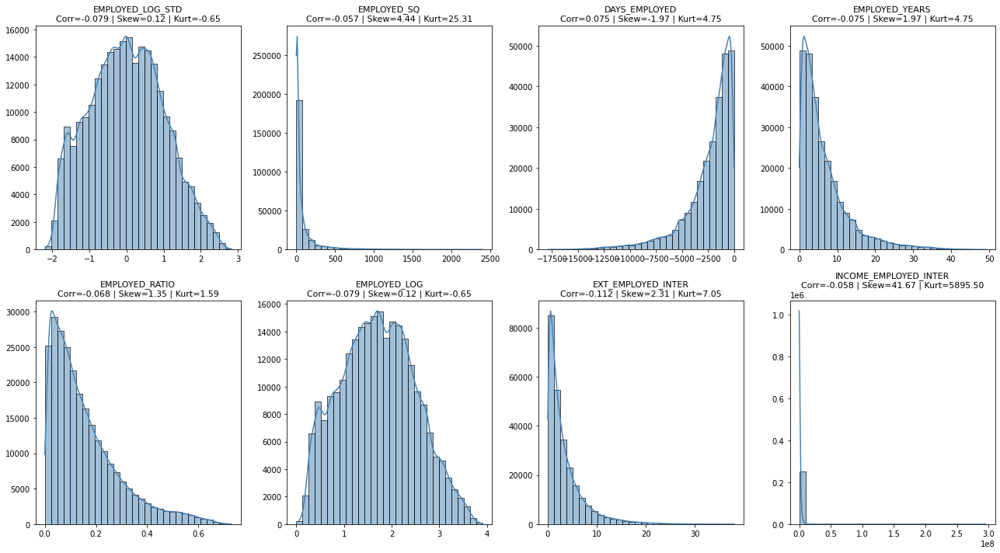

In [326]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_RATIO', 
            'EMPLOYED_LOG', 'EXT_EMPLOYED_INTER', 'INCOME_EMPLOYED_INTER']

plot_transformations_distributions(   #  EMPLOYED_RATIO EXT_EMPLOYED_INTER INCOME_EMPLOYED_INTER
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

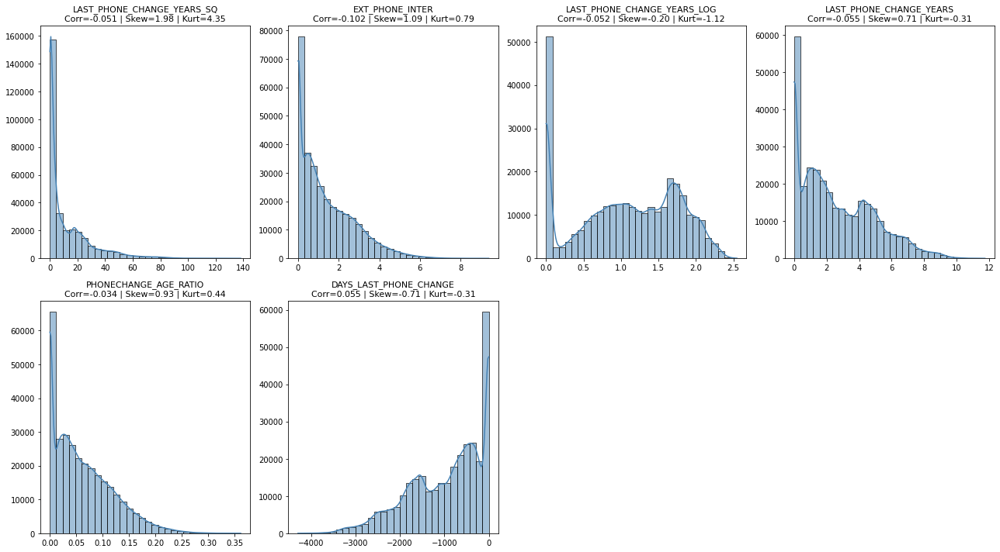

In [327]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LAST_PHONE_CHANGE_YEARS_SQ', 'EXT_PHONE_INTER', 'LAST_PHONE_CHANGE_YEARS_LOG', 'LAST_PHONE_CHANGE_YEARS', 'PHONECHANGE_AGE_RATIO', 
            'DAYS_LAST_PHONE_CHANGE']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

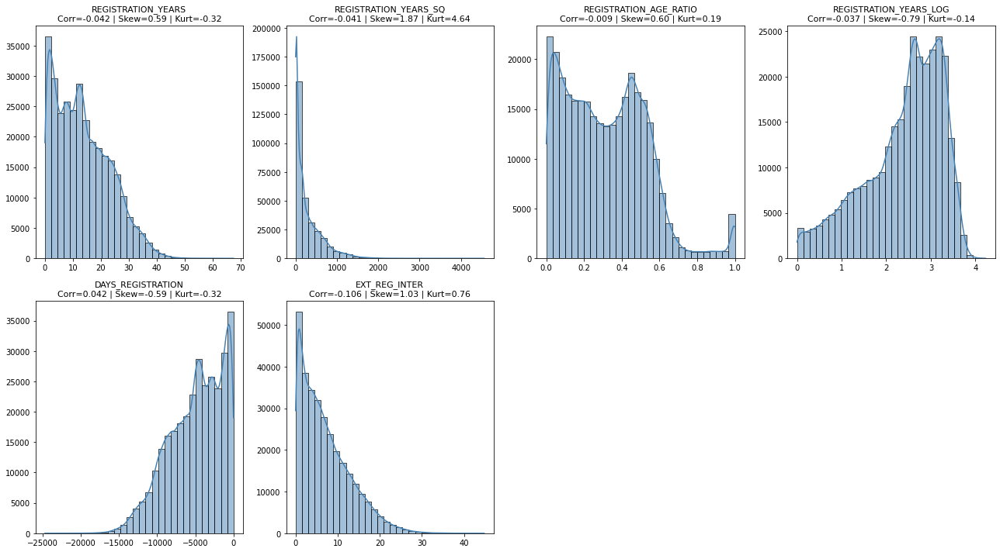

In [328]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGISTRATION_YEARS', 'REGISTRATION_YEARS_SQ', 'REGISTRATION_AGE_RATIO', 'REGISTRATION_YEARS_LOG', 'DAYS_REGISTRATION', 
            'EXT_REG_INTER']

plot_transformations_distributions(  # REGISTRATION_AGE_RATIO EXT_REG_INTER
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

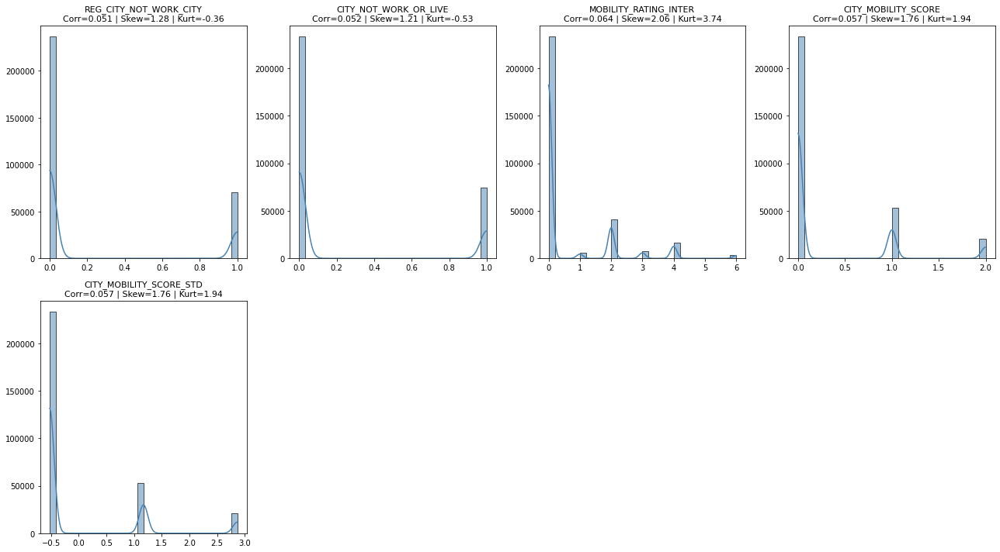

In [329]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REG_CITY_NOT_WORK_CITY', 'CITY_NOT_WORK_OR_LIVE', 'MOBILITY_RATING_INTER', 'CITY_MOBILITY_SCORE', 
            'CITY_MOBILITY_SCORE_STD']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

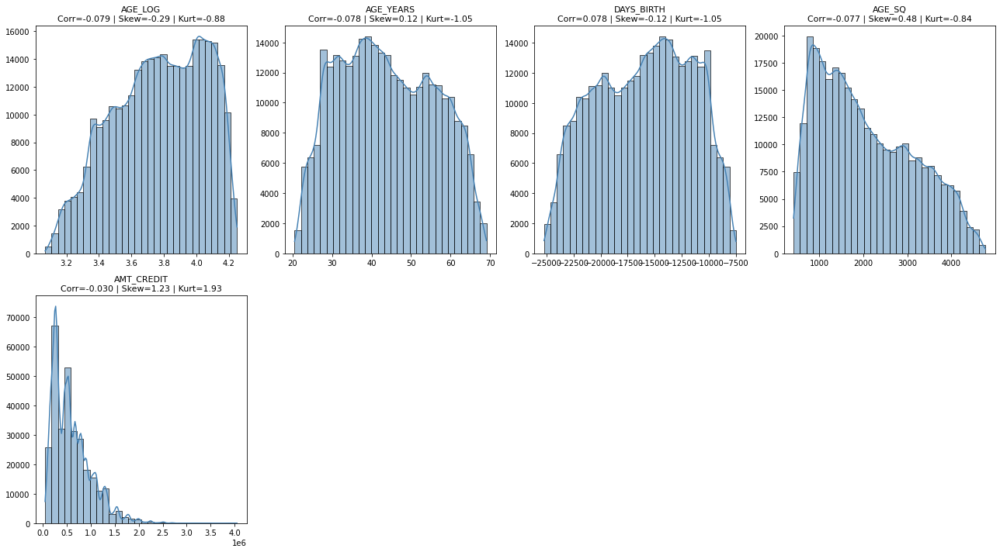

In [330]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AGE_LOG', 'AGE_YEARS', 'DAYS_BIRTH', 'AGE_SQ', 
            'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

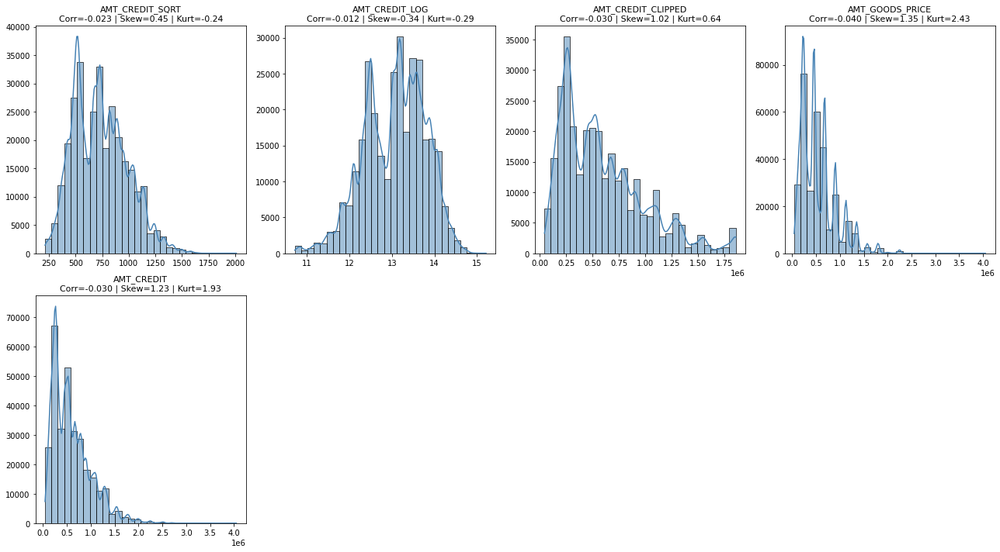

In [331]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['AMT_CREDIT_SQRT', 'AMT_CREDIT_LOG', 'AMT_CREDIT_CLIPPED', 'AMT_GOODS_PRICE', 
            'AMT_CREDIT']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

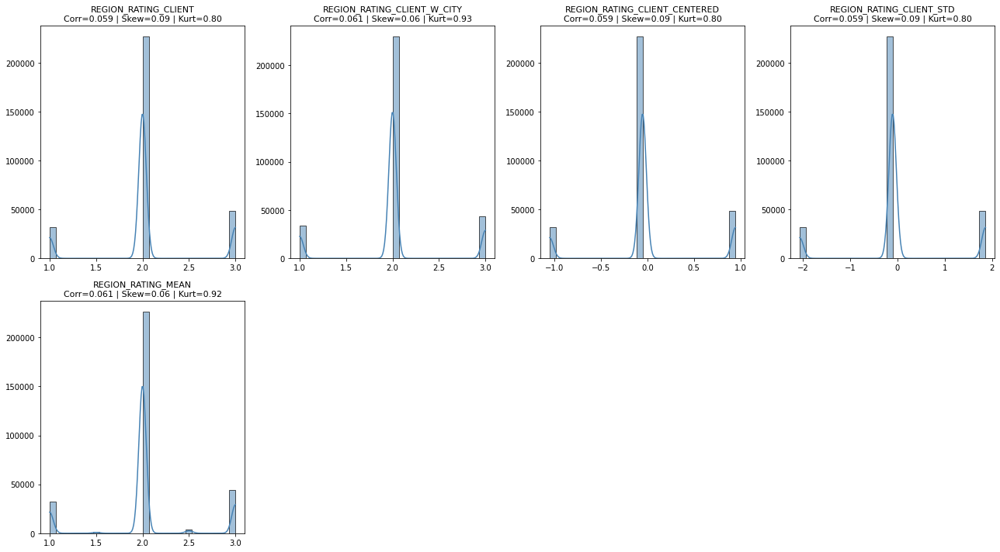

In [332]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED', 'REGION_RATING_CLIENT_STD', 
            'REGION_RATING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

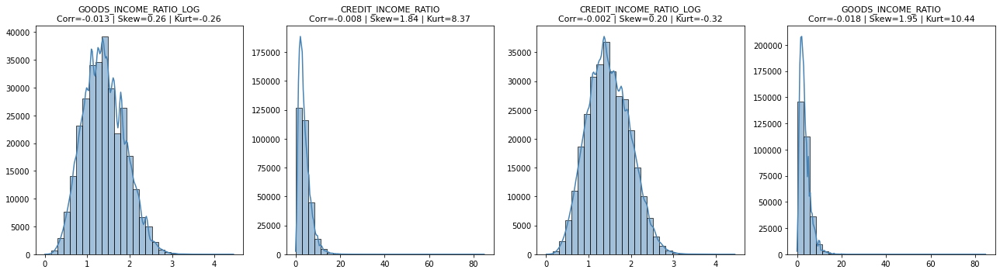

In [333]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['GOODS_INCOME_RATIO_LOG', 'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 
            'GOODS_INCOME_RATIO']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

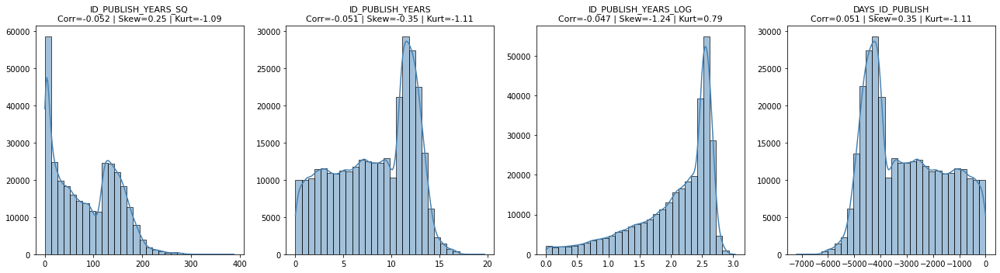

In [334]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS', 'ID_PUBLISH_YEARS_LOG', 'DAYS_ID_PUBLISH']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

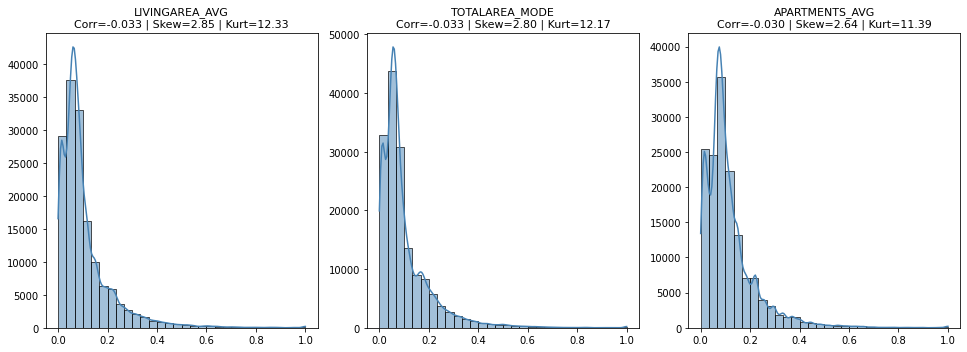

In [335]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['LIVINGAREA_AVG', 'TOTALAREA_MODE', 'APARTMENTS_AVG']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

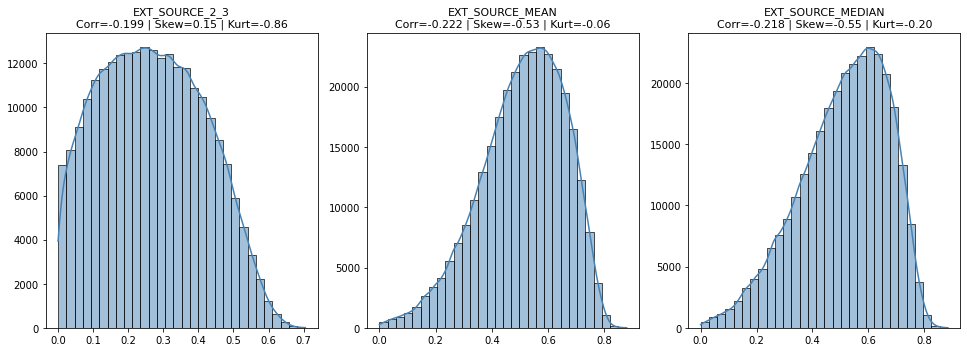

In [336]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['EXT_SOURCE_2_3', 'EXT_SOURCE_MEAN', 'EXT_SOURCE_MEDIAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

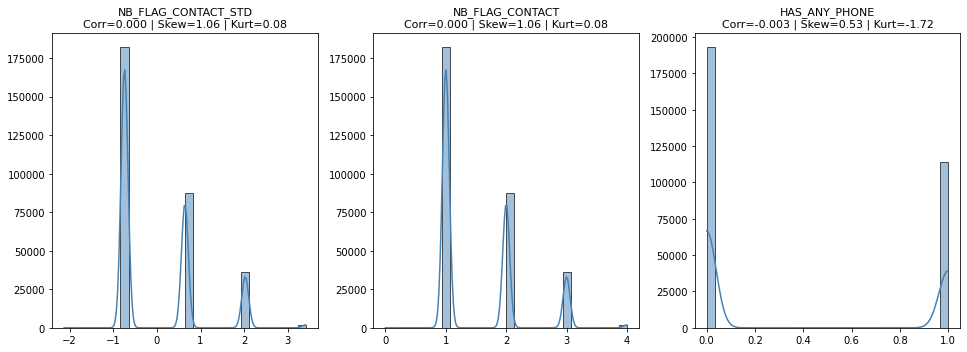

In [337]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['NB_FLAG_CONTACT_STD', 'NB_FLAG_CONTACT', 'HAS_ANY_PHONE']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

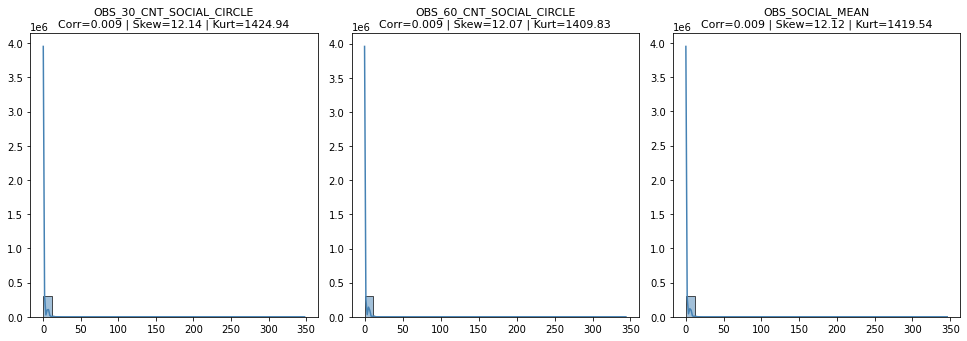

In [338]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_SOCIAL_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

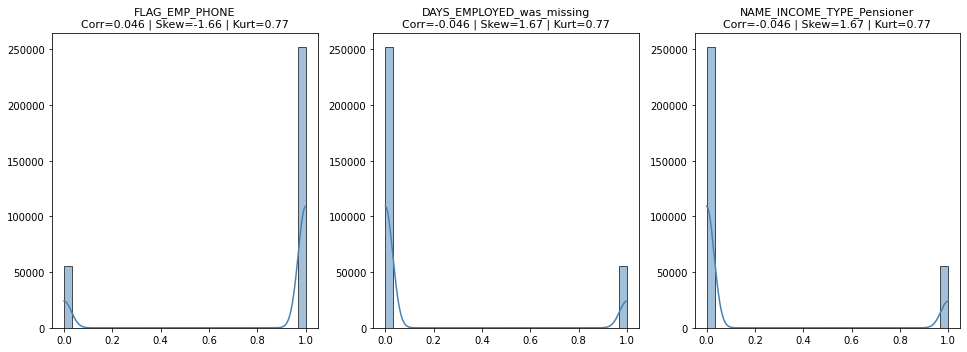

In [339]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['FLAG_EMP_PHONE', 'DAYS_EMPLOYED_was_missing', 'NAME_INCOME_TYPE_Pensioner']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET'
)

In [ ]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING', 'WALLSMATERIAL_MODE_MISSING', 'WALLSMATERIAL_MODE_was_missing', 'HOUSETYPE_MODE_block of flats', 
    'EMERGENCYSTATE_MODE_MISSING', 'LIVINGAREA_AVG',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_2_3',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'INCOME_PER_PERSON'
]

df_train_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [343]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


- On a fini les préparations pour le fichier application train mais il faut faire exactement les mêmes préparations pour le fichier test avant de passer aux fichiers subsidiaires que l'on fusionnera aux fichiers train et test pour avoir des données exploitables en un seul endroit à chaque fois.

### Préparation des données - application_test.csv

In [344]:
# Sauvegarde du dataframe d'origine.

df_init_test = df_appli_test.copy()

In [345]:
# Forme du dataframe.

print_dataframe_shape(df_appli_test)

Le DataFrame contient 48,744 lignes et 121 colonnes.


In [346]:
# Echantillon du dataframe.

df_appli_test.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [347]:
# Différence de variables entre les deux bases de données application

cols_df_init_train = set(df_init_train.columns)
cols_df_init_test = set(df_init_test.columns)

# Colonnes présentes dans df1 mais pas dans df2 :
diff_cols = cols_df_init_train - cols_df_init_test

print("Colonnes dans df_init_train mais pas dans df_init_test :", diff_cols)

Colonnes dans df_init_train mais pas dans df_init_test : {'TARGET'}


- Dans ce dataframe, on remarquera l'absence de la variable TARGET d'où la différence du nombre de variable.

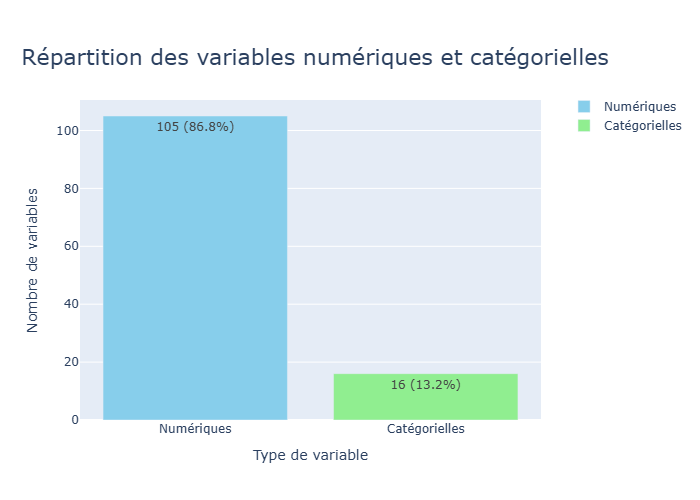

In [348]:
# Visualisation de la répartition des variables numériques et catégorielles en rappel.

num_cat_appli_test = plot_num_cat_distribution(df= df_appli_test,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_test.show()

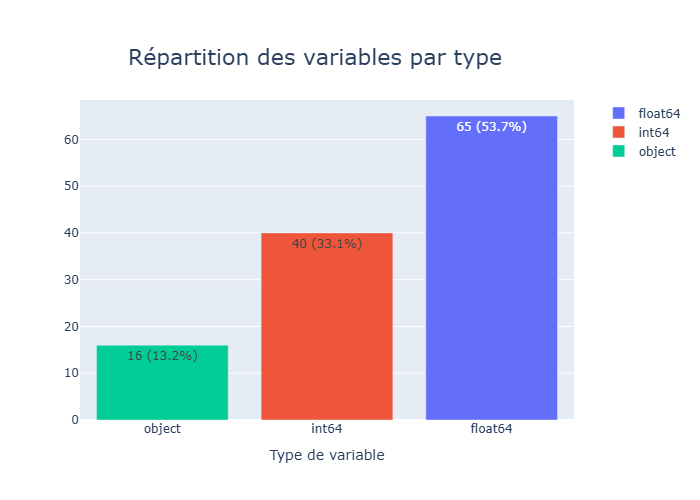

In [349]:
var_distrib_appli_test = plot_variable_types_distribution(df=df_appli_test,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_test.show()

In [350]:
n, cols = missing_columns_summary(df_appli_test, threshold=0)
print(f"{n} colonnes avec des valeurs manquantes : {cols}")

64 colonnes avec des valeurs manquantes : ['AMT_ANNUITY', 'NAME_TYPE_SUITE', 'OWN_CAR_AGE', 'OCCUPATION_TYPE', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_ME

In [351]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_appli_test)

'Le DataFrame contient 1404419 valeurs manquantes sur 5898024 observations, soit 23.81%.'

##### - Valeurs aberrantes de application_test

In [352]:
# Liste des variables catégorielles du dataframe.

df_appli_test.select_dtypes(include=['object']).nunique()

NAME_CONTRACT_TYPE             2
CODE_GENDER                    2
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

In [353]:
# Comparaison des valeurs uniques pour les variables catégorielles train/test.

cat_cols = df_init_train.select_dtypes(include=['object', 'category']).columns

# 2. Comparer les valeurs uniques
for col in cat_cols:
    train_vals = set(df_init_train[col].dropna().unique())
    test_vals = set(df_appli_test[col].dropna().unique())
    
    only_in_train = train_vals - test_vals
    only_in_test = test_vals - train_vals
    
    if only_in_train or only_in_test:
        print(f"\n Colonne : {col}")
        if only_in_train:
            print(f"  - Valeurs uniquement dans TRAIN : {only_in_train}")
        if only_in_test:
            print(f"  - Valeurs uniquement dans TEST : {only_in_test}")


 Colonne : CODE_GENDER
  - Valeurs uniquement dans TRAIN : {'XNA'}

 Colonne : NAME_INCOME_TYPE
  - Valeurs uniquement dans TRAIN : {'Maternity leave'}

 Colonne : NAME_FAMILY_STATUS
  - Valeurs uniquement dans TRAIN : {'Unknown'}


- Pas de soucis avec les valeurs uniques de application test puisque l'on a supprimé ces valeurs dans le fichier train et il n'y a pas de valeurs seulement présente dans test et non dans train (même si c'est l'inverse qui pose le plus problème pour l'entrainement des modèles).
- Ensuite on peut vérifier les variables quantitatives :

In [354]:
# Visualisation des variables présentant des valeurs anormales.

detect_aberrant_values(df_appli_test)['Variable'].unique()

array(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'OWN_CAR_AGE', 'FLAG_CONT_MOBILE', 'CNT_FAM_MEMBERS',
       'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'APARTMENTS_AVG', 'BASEMENTAREA_AVG',
       'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG',
       'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG',
       'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG',
       'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE',
       'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE',
       'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE',
       'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE',
       'APARTMENTS_MEDI

In [355]:
report_aberrante_val = detect_aberrant_values(df_appli_test, min_occurrences=2)
report_aberrante_val

,Variable,Valeur_aberrante,Occurrences
0,CNT_CHILDREN,4.0,49
1,CNT_CHILDREN,5.0,12
2,CNT_CHILDREN,8.0,3
3,CNT_CHILDREN,6.0,3
4,CNT_CHILDREN,11.0,2
...,...,...,...
2375,AMT_REQ_CREDIT_BUREAU_YEAR,9.0,122
2376,AMT_REQ_CREDIT_BUREAU_YEAR,10.0,21
2377,AMT_REQ_CREDIT_BUREAU_YEAR,11.0,12
2378,AMT_REQ_CREDIT_BUREAU_YEAR,12.0,5


In [356]:
#  Visualisation des valeurs aberrantes négatives potentielles.

report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] < 0]

,Variable,Valeur_aberrante,Occurrences
235,DAYS_BIRTH,-24807.0,6
236,DAYS_BIRTH,-24820.0,6
237,DAYS_BIRTH,-8290.0,6
238,DAYS_BIRTH,-24417.0,5
239,DAYS_BIRTH,-8120.0,5
...,...,...,...
2355,DAYS_LAST_PHONE_CHANGE,-3599.0,2
2356,DAYS_LAST_PHONE_CHANGE,-3574.0,2
2357,DAYS_LAST_PHONE_CHANGE,-3509.0,2
2358,DAYS_LAST_PHONE_CHANGE,-3556.0,2


In [357]:
report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] < 0]["Variable"].unique()

array(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
       'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE'], dtype=object)

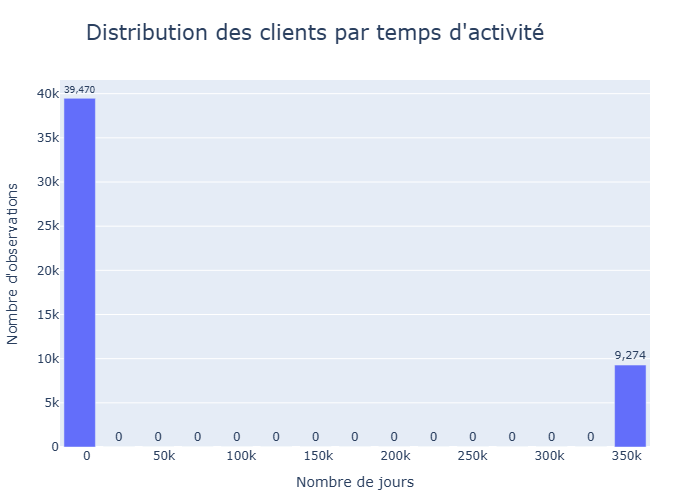

In [358]:
# Visualisation de la répartition pour la variable "DAYS_EMPLOYED".

plot_histogram_quantitative(
    df_appli_test,
    x='DAYS_EMPLOYED',
    title="Distribution des clients par temps d'activité",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    width=1000,
    height=600
)

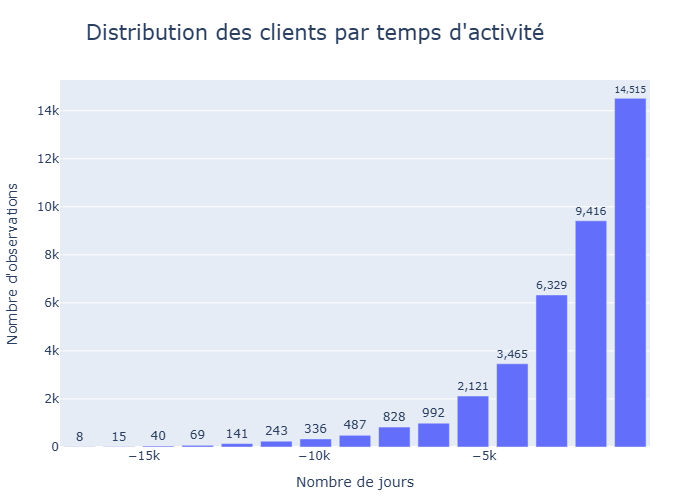

In [359]:
# Visualisation de la répartition pour la variable "DAYS_EMPLOYED" sans les valeurs potentiellement aberrantes.

plot_histogram_quantitative(
    df_appli_test,
    x='DAYS_EMPLOYED',
    title="Distribution des clients par temps d'activité",
    title_layout={"x": 0.45},
    title_font_size=21,
    xaxis_title="Nombre de jours",
    yaxis_title="Nombre d'observations",
    max_quantile=0.80,
    width=1000,
    height=600
)

- Même constat que précédemment pour le dataframe df_appli_train.

In [360]:
# Correction des valeurs aberrantes pour la variable 'DAYS_EMPLOYED'.

df_appli_test['DAYS_EMPLOYED'].replace(365243, np.nan, inplace=True)

C:\Users\Caomghin\AppData\Local\Temp/ipykernel_18248/4210566961.py:3: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [361]:
# Vérification des changements apportés.

df_appli_test['DAYS_EMPLOYED'].value_counts(dropna=False).head()

DAYS_EMPLOYED
 NaN       9274
-1119.0      32
-389.0       31
-1240.0      30
-148.0       28
Name: count, dtype: int64

In [362]:
report_aberrante_val.loc[report_aberrante_val['Occurrences'] > 100]["Variable"].unique()

array(['AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'OWN_CAR_AGE',
       'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_3', 'APARTMENTS_AVG',
       'APARTMENTS_MODE', 'APARTMENTS_MEDI', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'FLAG_DOCUMENT_9', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype=object)

In [363]:
report_aberrante_val.loc[report_aberrante_val['Occurrences'] > 1000]["Variable"].unique()

array([], dtype=object)

In [364]:
report_aberrante_val.loc[report_aberrante_val['Valeur_aberrante'] > 10]["Variable"].unique()

array(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'HOUR_APPR_PROCESS_START',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'AMT_REQ_CREDIT_BUREAU_YEAR'], dtype=object)

In [365]:
# Vérification pour les variables de type "FLAG_DOCUMENT".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('FLAG_DOCUMENT')]

,Variable,Valeur_aberrante,Occurrences
2360,FLAG_DOCUMENT_4,1.0,5
2361,FLAG_DOCUMENT_7,1.0,2
2362,FLAG_DOCUMENT_9,1.0,219
2363,FLAG_DOCUMENT_11,1.0,57
2364,FLAG_DOCUMENT_18,1.0,76


In [366]:
# Vérification pour les variables de type "AMT_REQ_CREDIT_BUREAU".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('AMT_REQ_CREDIT_BUREAU')]

,Variable,Valeur_aberrante,Occurrences
2365,AMT_REQ_CREDIT_BUREAU_HOUR,1.0,88
2366,AMT_REQ_CREDIT_BUREAU_DAY,1.0,63
2367,AMT_REQ_CREDIT_BUREAU_DAY,2.0,7
2368,AMT_REQ_CREDIT_BUREAU_WEEK,1.0,113
2369,AMT_REQ_CREDIT_BUREAU_WEEK,2.0,3
2370,AMT_REQ_CREDIT_BUREAU_MON,1.0,324
2371,AMT_REQ_CREDIT_BUREAU_MON,2.0,23
2372,AMT_REQ_CREDIT_BUREAU_MON,3.0,4
2373,AMT_REQ_CREDIT_BUREAU_QRT,4.0,57
2374,AMT_REQ_CREDIT_BUREAU_QRT,5.0,11


In [367]:
# Vérification pour les variables de type "SOCIAL_CIRCLE".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('SOCIAL_CIRCLE')]

,Variable,Valeur_aberrante,Occurrences
2195,OBS_30_CNT_SOCIAL_CIRCLE,11.0,135
2196,OBS_30_CNT_SOCIAL_CIRCLE,12.0,107
2197,OBS_30_CNT_SOCIAL_CIRCLE,13.0,64
2198,OBS_30_CNT_SOCIAL_CIRCLE,14.0,49
2199,OBS_30_CNT_SOCIAL_CIRCLE,15.0,30
2200,OBS_30_CNT_SOCIAL_CIRCLE,16.0,20
2201,OBS_30_CNT_SOCIAL_CIRCLE,17.0,16
2202,OBS_30_CNT_SOCIAL_CIRCLE,18.0,10
2203,OBS_30_CNT_SOCIAL_CIRCLE,20.0,9
2204,OBS_30_CNT_SOCIAL_CIRCLE,19.0,8


In [368]:
# Vérification pour les variables de type "_AVG".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_AVG')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
1182,LANDAREA_AVG,1.0,20
1312,NONLIVINGAPARTMENTS_AVG,1.0,14
1106,YEARS_BUILD_AVG,1.0,8
1161,FLOORSMAX_AVG,1.0,34
1174,FLOORSMIN_AVG,1.0,25
...,...,...,...
1217,LIVINGAPARTMENTS_AVG,0.0,46
1071,YEARS_BEGINEXPLUATATION_AVG,0.0,58
1104,YEARS_BUILD_AVG,0.0,18
1145,ENTRANCES_AVG,0.0,38


In [369]:
# Vérification pour les variables de type "_MEDI".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_MEDI')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
1894,COMMONAREA_MEDI,1.0,19
1935,FLOORSMAX_MEDI,1.0,36
1911,ELEVATORS_MEDI,1.0,24
1809,BASEMENTAREA_MEDI,1.0,21
1878,YEARS_BUILD_MEDI,1.0,9
...,...,...,...
1989,LIVINGAPARTMENTS_MEDI,0.0,47
2019,LIVINGAREA_MEDI,0.0,49
1876,YEARS_BUILD_MEDI,0.0,19
1843,YEARS_BEGINEXPLUATATION_MEDI,0.0,61


In [370]:
# Vérification pour les variables de type "_MODE".

report_aberrante_val.loc[report_aberrante_val['Variable'].str.contains('_MODE')].sort_values(by='Valeur_aberrante', ascending=False)

,Variable,Valeur_aberrante,Occurrences
1540,ENTRANCES_MODE,1.0,29
1531,ELEVATORS_MODE,1.0,24
1427,BASEMENTAREA_MODE,1.0,19
2138,TOTALAREA_MODE,1.0,31
1634,LIVINGAREA_MODE,1.0,36
...,...,...,...
1633,LIVINGAREA_MODE,0.0,69
2137,TOTALAREA_MODE,0.0,73
1496,YEARS_BUILD_MODE,0.0,17
1461,YEARS_BEGINEXPLUATATION_MODE,0.0,76


In [371]:
df_appli_test.describe()

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,39470.000000,48744.000000,...,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,-2476.738941,-4967.652716,...,0.001559,0.0,0.0,0.0,0.002108,0.001803,0.002787,0.009299,0.546902,1.983769
std,103169.547296,0.709047,1.015226e+05,3.653970e+05,16016.368315,3.367102e+05,0.014428,4325.900393,2307.963913,3552.612035,...,0.039456,0.0,0.0,0.0,0.046373,0.046132,0.054037,0.110924,0.693305,1.838873
min,100001.000000,0.000000,2.694150e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,-25195.000000,-17463.000000,-23722.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,188557.750000,0.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,-19637.000000,-3328.750000,-7459.250000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,277549.000000,0.000000,1.575000e+05,4.500000e+05,26199.000000,3.960000e+05,0.018850,-15785.000000,-1765.000000,-4490.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,367555.500000,1.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,-12496.000000,-861.000000,-1901.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
max,456250.000000,20.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,-7338.000000,-1.000000,0.000000,...,1.000000,0.0,0.0,0.0,2.000000,2.000000,2.000000,6.000000,7.000000,17.000000


In [372]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_appli_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
COMMONAREA_MEDI,33495,68.716150
COMMONAREA_MODE,33495,68.716150
COMMONAREA_AVG,33495,68.716150
NONLIVINGAPARTMENTS_MODE,33347,68.412523
NONLIVINGAPARTMENTS_AVG,33347,68.412523
NONLIVINGAPARTMENTS_MEDI,33347,68.412523
FONDKAPREMONT_MODE,32797,67.284179
LIVINGAPARTMENTS_MEDI,32780,67.249302
LIVINGAPARTMENTS_AVG,32780,67.249302
LIVINGAPARTMENTS_MODE,32780,67.249302


<Figure size 720x432 with 0 Axes>

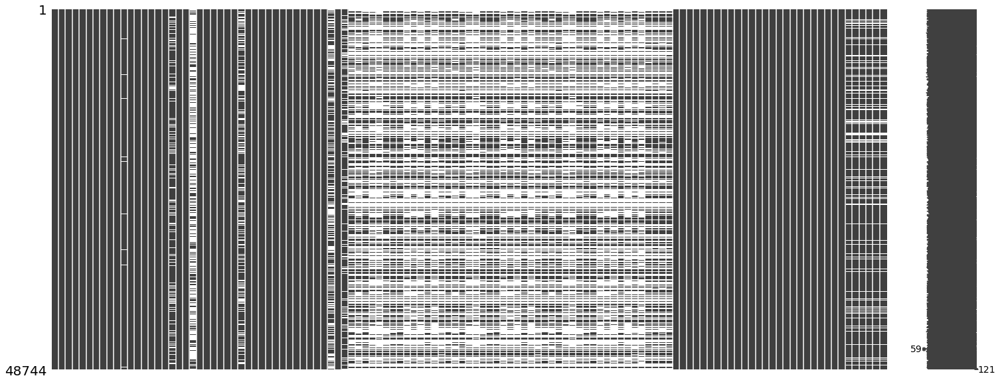

In [373]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_appli_test.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [374]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_appli_test)

'Le DataFrame contient 1413693 valeurs manquantes sur 5898024 observations, soit 23.97%.'

In [375]:
# Suppression des variables avec trop de valeurs manquantes et peu corrélées à la TARGET (par rapport à train).

cols_to_del = [
    "COMMONAREA_MEDI", "COMMONAREA_AVG", "COMMONAREA_MODE",
    "NONLIVINGAPARTMENTS_MEDI", "NONLIVINGAPARTMENTS_MODE", "NONLIVINGAPARTMENTS_AVG",
    "FONDKAPREMONT_MODE", "LIVINGAPARTMENTS_MODE", "LIVINGAPARTMENTS_MEDI",
    "LIVINGAPARTMENTS_AVG", "FLOORSMIN_MODE", "FLOORSMIN_MEDI",
    "FLOORSMIN_AVG", "YEARS_BUILD_MODE", "YEARS_BUILD_MEDI",
    "YEARS_BUILD_AVG"
]

df_appli_test.drop(columns=cols_to_del, inplace=True)
print(f"Colonnes encore présentes : {[col for col in cols_to_del if col in df_appli_test.columns]}")

Colonnes encore présentes : []


- On apporte à chaque fois les mêmes modifications que l'on a réalisé pour application train puisque il faut que l'on ai les mêmes variables que ce soit à l'entrainement ou en validation/test des modèles.
- On suivra donc le même procédé jusqu'à la fin de application test.

In [376]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_appli_test.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_appli_test.select_dtypes(exclude=["object"]).columns.tolist()

datasets_test = create_datasets(df_appli_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

In [377]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_test_median_mode_linear = datasets_test["median_mode_linear"]
df_test_median_missing_linear = datasets_test["median_missing_linear"]
df_test_iterative_mode_linear = datasets_test["iterative_mode_linear"]
df_test_nan_missing_linear = datasets_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_test_median_mode = datasets_test["median_mode_tree"]
df_test_median_missing = datasets_test["median_missing_tree"]
df_test_iterative_mode = datasets_test["iterative_mode_tree"]
df_test_nan_missing = datasets_test["nan_missing_tree"]

print(df_test_median_mode_linear.head())
print(df_test_median_missing_linear.head())
print(df_test_iterative_mode_linear.head())
print(df_test_nan_missing_linear.head())

   SK_ID_CURR NAME_CONTRACT_TYPE CODE_GENDER FLAG_OWN_CAR FLAG_OWN_REALTY  \
0      100001         Cash loans           F            N               Y   
1      100005         Cash loans           M            N               Y   
2      100013         Cash loans           M            Y               Y   
3      100028         Cash loans           F            N               Y   
4      100038         Cash loans           M            Y               N   

   CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  AMT_ANNUITY  AMT_GOODS_PRICE  \
0             0          135000.0    568800.0      20560.5         450000.0   
1             0           99000.0    222768.0      17370.0         180000.0   
2             0          202500.0    663264.0      69777.0         630000.0   
3             2          315000.0   1575000.0      49018.5        1575000.0   
4             1          180000.0    625500.0      32067.0         625500.0   

   ... FLAG_DOCUMENT_18 FLAG_DOCUMENT_19 FLAG_DOCUMENT_20 FLAG

In [378]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_test_median_mode_linear))
print(summarize_missing_values(df_test_median_missing_linear))
print(summarize_missing_values(df_test_iterative_mode_linear))
print(summarize_missing_values(df_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 5118120 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 5118120 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 5118120 observations, soit 0.00%.
Le DataFrame contient 802941 valeurs manquantes sur 5118120 observations, soit 15.69%.


In [379]:
print(summarize_missing_values(df_test_median_mode))
print(summarize_missing_values(df_test_median_missing))
print(summarize_missing_values(df_test_iterative_mode))
print(summarize_missing_values(df_test_nan_missing))

Le DataFrame contient 0 valeurs manquantes sur 10236240 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 10236240 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 10236240 observations, soit 0.00%.
Le DataFrame contient 802941 valeurs manquantes sur 10236240 observations, soit 7.84%.


In [380]:
# Information relatives aux dataframes pour visualiser les changements apportés.

print(df_test_median_mode_linear.info(show_counts=True))
print(df_test_median_missing_linear.info(show_counts=True))
print(df_test_iterative_mode_linear.info(show_counts=True))
print(df_test_nan_missing_linear.info(show_counts=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(39), object(15)
memory usage: 39.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(39), object(15)
memory usage: 39.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(90), object(15)
memory usage: 39.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(51), int64(39), object(15)
memory usage: 39.0+ MB
None


In [381]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_test_median_mode_linear)
optimize_types(df_test_median_missing_linear)
optimize_types(df_test_iterative_mode_linear)
optimize_types(df_test_nan_missing_linear)
optimize_types(df_test_median_mode)
optimize_types(df_test_median_missing)
optimize_types(df_test_iterative_mode)
optimize_types(df_test_nan_missing)

 Mémoire avant : 79.70 MB
 Mémoire après : 62.96 MB
 Gain : 21.0%
 Mémoire avant : 79.67 MB
 Mémoire après : 62.94 MB
 Gain : 21.0%
 Mémoire avant : 79.70 MB
 Mémoire après : 62.96 MB
 Gain : 21.0%
 Mémoire avant : 79.67 MB
 Mémoire après : 63.49 MB
 Gain : 20.3%
 Mémoire avant : 99.22 MB
 Mémoire après : 82.49 MB
 Gain : 16.9%
 Mémoire avant : 99.19 MB
 Mémoire après : 82.46 MB
 Gain : 16.9%
 Mémoire avant : 99.22 MB
 Mémoire après : 82.49 MB
 Gain : 16.9%
 Mémoire avant : 99.19 MB
 Mémoire après : 83.02 MB
 Gain : 16.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,NAME_INCOME_TYPE_was_missing,NAME_EDUCATION_TYPE_was_missing,NAME_FAMILY_STATUS_was_missing,NAME_HOUSING_TYPE_was_missing,OCCUPATION_TYPE_was_missing,WEEKDAY_APPR_PROCESS_START_was_missing,ORGANIZATION_TYPE_was_missing,HOUSETYPE_MODE_was_missing,WALLSMATERIAL_MODE_was_missing,EMERGENCYSTATE_MODE_was_missing
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,1,0,0,0,0,0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0,0,0,1,1,1
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0,0,0,1,1,1
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0,0,0,0,0,0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,1,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,Cash loans,F,N,Y,0,121500.0,412560.0,17473.5,270000.0,...,0,0,0,0,1,0,0,1,1,1
48740,456222,Cash loans,F,N,N,2,157500.0,622413.0,31909.5,495000.0,...,0,0,0,0,0,0,0,1,1,1
48741,456223,Cash loans,F,Y,Y,1,202500.0,315000.0,33205.5,315000.0,...,0,0,0,0,1,0,0,0,0,0
48742,456224,Cash loans,M,N,N,0,225000.0,450000.0,25128.0,450000.0,...,0,0,0,0,0,0,0,0,0,0


In [382]:
print(df_test_median_mode_linear.info(show_counts=True))
print(df_test_median_missing_linear.info(show_counts=True))
print(df_test_iterative_mode_linear.info(show_counts=True))
print(df_test_nan_missing_linear.info(show_counts=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float32(36), int32(54), object(15)
memory usage: 22.3+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float32(36), int32(54), object(15)
memory usage: 22.3+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float32(48), int32(42), object(15)
memory usage: 22.3+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: Int32(12), float32(36), int32(42), object(15)
memory usage: 22.9+ MB
None


In [383]:
print(df_test_median_mode.info(show_counts=True))
print(df_test_median_missing.info(show_counts=True))
print(df_test_iterative_mode.info(show_counts=True))
print(df_test_nan_missing.info(show_counts=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 210 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(36), int32(159), object(15)
memory usage: 41.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 210 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(36), int32(159), object(15)
memory usage: 41.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 210 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: float32(48), int32(147), object(15)
memory usage: 41.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 210 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_was_missing
dtypes: Int32(12), float32(36), int32(147), object(15)
memory usage: 42.4+ MB
None


In [384]:
# Visualisation des variables à encoder pour les dataframes utilisant le mode (2 dataframes).

binary_categorical = [col for col in df_test_median_mode_linear.columns 
                      if df_test_median_mode_linear[col].dtype == 'object' and df_test_median_mode_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical)

Variables catégorielles binaires : ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'EMERGENCYSTATE_MODE']


In [387]:
# Visualisation des variables à encoder pour les dataframes utilisant missing ou des nan.

binary_categorical_miss = [col for col in df_test_nan_missing_linear.columns 
                      if df_test_nan_missing_linear[col].dtype == 'object' and df_test_nan_missing_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical_miss)

Variables catégorielles binaires : ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']


In [390]:
# Liste des DataFrames test classiques
datasets_test = [
    df_appli_test,
    df_test_median_mode_linear,
    df_test_median_missing_linear,
    df_test_iterative_mode_linear,
    df_test_nan_missing_linear,
    df_test_median_mode,
    df_test_median_missing,
    df_test_iterative_mode,
    df_test_nan_missing,
]

# Application des encodeurs LabelEncoder du train
for df in datasets_test:
    for col, le in encoders.items():
        if col in df.columns:
            df[col] = df[col].map(lambda x: le.transform([x])[0] if x in le.classes_ else -1)


In [391]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_mode_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']]

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,EMERGENCYSTATE_MODE
0,0,0,0,1,No
1,0,1,0,1,No
2,0,1,1,1,No
3,0,0,0,1,No
4,0,1,1,0,No
...,...,...,...,...,...
48739,0,0,0,1,No
48740,0,0,0,0,No
48741,0,0,1,1,No
48742,0,1,0,0,No


In [394]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_mode[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']]

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY
0,0,0,0,1
1,0,1,0,1
2,0,1,1,1
3,0,0,0,1
4,0,1,1,0
...,...,...,...,...
48739,0,0,0,1
48740,0,0,0,0
48741,0,0,1,1
48742,0,1,0,0


In [396]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_mode_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype
---  ------              --------------  -----
 0   NAME_CONTRACT_TYPE  48744 non-null  int32
 1   CODE_GENDER         48744 non-null  int32
 2   FLAG_OWN_CAR        48744 non-null  int32
 3   FLAG_OWN_REALTY     48744 non-null  int32
dtypes: int32(4)
memory usage: 761.8 KB


In [397]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_missing_linear[['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype
---  ------              --------------  -----
 0   NAME_CONTRACT_TYPE  48744 non-null  int32
 1   CODE_GENDER         48744 non-null  int32
 2   FLAG_OWN_CAR        48744 non-null  int32
 3   FLAG_OWN_REALTY     48744 non-null  int32
dtypes: int32(4)
memory usage: 761.8 KB


In [398]:
# Visualisation du nombre de valeurs uniques pour les dataframes utilisant le mode.

df_test_median_mode.select_dtypes("object").nunique()

NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

In [399]:
# Visualisation du nombre de valeurs uniques pour les dataframes utilisant la modalité "MISSING".

df_test_median_missing.select_dtypes("object").nunique()

NAME_TYPE_SUITE                8
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               19
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
HOUSETYPE_MODE                 4
WALLSMATERIAL_MODE             8
EMERGENCYSTATE_MODE            3
dtype: int64

In [400]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_test_median_mode_linear.columns 
                      if df_test_median_mode_linear[col].dtype == 'object' and df_test_median_mode_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var)

Variables catégorielles avec One Hot Encoder : ['NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']


In [401]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var_miss = [col for col in df_test_median_missing_linear.columns 
                      if df_test_median_missing_linear[col].dtype == 'object' and df_test_median_missing_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var_miss)

Variables catégorielles avec One Hot Encoder : ['NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']


In [402]:
# Encodage des variables catégorielles avec One Hot Encoder.

datasets_linear = [
    df_test_median_missing_linear,
    df_test_median_mode_linear,
    df_test_iterative_mode_linear,
    df_test_nan_missing_linear
]

encoded_dfs_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

# Récupération dans les bonnes variables

df_test_median_missing_linear = encoded_dfs_linear[0]
df_test_median_mode_linear = encoded_dfs_linear[1]
df_test_iterative_mode_linear = encoded_dfs_linear[2]
df_test_nan_missing_linear = encoded_dfs_linear[3]

datasets = [
    df_test_median_missing,
    df_test_median_mode,
    df_test_iterative_mode,
    df_test_nan_missing
]

encoded_dfs = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

# Récupération dans les bonnes variables

df_test_median_missing = encoded_dfs[0]
df_test_median_mode = encoded_dfs[1]
df_test_iterative_mode = encoded_dfs[2]
df_test_nan_missing = encoded_dfs[3]

In [407]:
df_test_median_missing_linear.loc[:, df_test_median_missing_linear.columns.str.contains('EMERGENCYSTATE_MODE')]

,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,1.0,0.0
1,0.0,0.0
2,0.0,0.0
3,1.0,0.0
4,0.0,0.0
...,...,...
48739,0.0,0.0
48740,0.0,0.0
48741,1.0,0.0
48742,1.0,0.0


In [408]:
df_test_median_missing.loc[:, df_test_median_missing.columns.str.contains('EMERGENCYSTATE_MODE')]

,EMERGENCYSTATE_MODE_was_missing,EMERGENCYSTATE_MODE_MISSING,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,0,0.0,1.0,0.0
1,1,1.0,0.0,0.0
2,1,1.0,0.0,0.0
3,0,0.0,1.0,0.0
4,1,1.0,0.0,0.0
...,...,...,...,...
48739,1,1.0,0.0,0.0
48740,1,1.0,0.0,0.0
48741,0,0.0,1.0,0.0
48742,0,0.0,1.0,0.0


In [403]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_mode_linear.select_dtypes("object").nunique()

OCCUPATION_TYPE      18
ORGANIZATION_TYPE    58
dtype: int64

In [404]:
# Vérification des changements pour ces variables catégorielles binaires.

df_test_median_missing_linear.select_dtypes("object").nunique()

OCCUPATION_TYPE      19
ORGANIZATION_TYPE    58
dtype: int64

#### Feature engineering - df_test_median_mode_linear

In [409]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_test_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999867
2,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.999543
3,YEARS_BEGINEXPLUATATION_AVG / YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,0.997683
4,FLOORSMAX_AVG / FLOORSMAX_MEDI,FLOORSMAX_AVG,FLOORSMAX_MEDI,0.997103
5,APARTMENTS_AVG / APARTMENTS_MEDI,APARTMENTS_AVG,APARTMENTS_MEDI,0.996884
6,ENTRANCES_AVG / ENTRANCES_MEDI,ENTRANCES_AVG,ENTRANCES_MEDI,0.996623
7,ELEVATORS_AVG / ELEVATORS_MEDI,ELEVATORS_AVG,ELEVATORS_MEDI,0.996594
8,NONLIVINGAREA_AVG / NONLIVINGAREA_MEDI,NONLIVINGAREA_AVG,NONLIVINGAREA_MEDI,0.995935
9,LIVINGAREA_AVG / LIVINGAREA_MEDI,LIVINGAREA_AVG,LIVINGAREA_MEDI,0.995031


In [410]:
df_test_median_mode_linear.loc[:, df_test_median_mode_linear.columns.str.contains("_AVG")]

,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,LANDAREA_AVG,LIVINGAREA_AVG,NONLIVINGAREA_AVG
0,0.0660,0.0590,0.9732,0.00,0.1379,0.1250,0.0483,0.0505,0.0038
1,0.0928,0.0781,0.9816,0.00,0.1379,0.1667,0.0483,0.0770,0.0038
2,0.0928,0.0781,0.9816,0.00,0.1379,0.1667,0.0483,0.0770,0.0038
3,0.3052,0.1974,0.9970,0.32,0.2759,0.3750,0.2042,0.3673,0.0800
4,0.0928,0.0781,0.9816,0.00,0.1379,0.1667,0.0483,0.0770,0.0038
...,...,...,...,...,...,...,...,...,...
48739,0.0928,0.0781,0.9816,0.00,0.1379,0.1667,0.0483,0.0770,0.0038
48740,0.0928,0.0781,0.9816,0.00,0.1379,0.1667,0.0483,0.0770,0.0038
48741,0.1113,0.1364,0.9955,0.16,0.1379,0.3333,0.0483,0.1383,0.0542
48742,0.1629,0.0723,0.9896,0.16,0.0690,0.6250,0.0483,0.1563,0.1490


In [411]:
df_test_median_mode_linear.loc[:, df_test_median_mode_linear.columns.str.contains("_MEDI")]

,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,LANDAREA_MEDI,LIVINGAREA_MEDI,NONLIVINGAREA_MEDI
0,0.0666,0.0590,0.9732,0.00,0.1379,0.1250,0.0488,0.0514,0.0031
1,0.0926,0.0778,0.9816,0.00,0.1379,0.1667,0.0488,0.0776,0.0031
2,0.0926,0.0778,0.9816,0.00,0.1379,0.1667,0.0488,0.0776,0.0031
3,0.3081,0.1974,0.9970,0.32,0.2759,0.3750,0.2078,0.3739,0.0817
4,0.0926,0.0778,0.9816,0.00,0.1379,0.1667,0.0488,0.0776,0.0031
...,...,...,...,...,...,...,...,...,...
48739,0.0926,0.0778,0.9816,0.00,0.1379,0.1667,0.0488,0.0776,0.0031
48740,0.0926,0.0778,0.9816,0.00,0.1379,0.1667,0.0488,0.0776,0.0031
48741,0.1124,0.1364,0.9955,0.16,0.1379,0.3333,0.0488,0.1408,0.0554
48742,0.1645,0.0723,0.9896,0.16,0.0690,0.6250,0.0488,0.1591,0.1521


In [412]:
df_test_median_mode_linear.loc[:, df_test_median_mode_linear.columns.str.contains("_MODE")].columns

Index(['APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'LANDAREA_MODE',
       'LIVINGAREA_MODE', 'NONLIVINGAREA_MODE', 'TOTALAREA_MODE',
       'HOUSETYPE_MODE_block of flats', 'HOUSETYPE_MODE_specific housing',
       'HOUSETYPE_MODE_terraced house', 'WALLSMATERIAL_MODE_MISSING',
       'WALLSMATERIAL_MODE_Mixed', 'WALLSMATERIAL_MODE_Monolithic',
       'WALLSMATERIAL_MODE_Others', 'WALLSMATERIAL_MODE_Panel',
       'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Wooden',
       'EMERGENCYSTATE_MODE_No', 'EMERGENCYSTATE_MODE_Yes'],
      dtype='object')

In [413]:
# Suppression des variables trop corrélées ("_MODE" et "_AVG")

cols_to_drop = df_test_median_mode_linear.loc[:, df_test_median_mode_linear.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_test_median_mode_linear.columns.str.contains("_AVG|_MODE")].columns.tolist()

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True)
df_test_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True)
df_test_median_missing_linear.drop(columns=cols_to_drop, inplace=True)
df_test_nan_missing_linear.drop(columns=cols_to_drop, inplace=True)

In [414]:
# Vérification des changements apportés.

df_test_median_mode_linear.loc[:, df_test_median_mode_linear.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_test_median_mode_linear.columns.str.contains("_AVG|_MODE")].columns

Index([], dtype='object')

In [415]:
# Visualisation des fortes corrélations restantes entre les variables.

get_correlation_pairs(df_test_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999867
2,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.999543
3,AMT_CREDIT / AMT_GOODS_PRICE,AMT_CREDIT,AMT_GOODS_PRICE,0.988056
4,REGION_RATING_CLIENT / REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.942479
5,LIVINGAREA_MEDI / TOTALAREA_MODE,LIVINGAREA_MEDI,TOTALAREA_MODE,0.909577
6,NAME_EDUCATION_TYPE_Higher education / NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,-0.892050
7,DEF_30_CNT_SOCIAL_CIRCLE / DEF_60_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,0.888881
8,APARTMENTS_MEDI / LIVINGAREA_MEDI,APARTMENTS_MEDI,LIVINGAREA_MEDI,0.887645
9,CNT_CHILDREN / CNT_FAM_MEMBERS,CNT_CHILDREN,CNT_FAM_MEMBERS,0.877445


In [416]:
# Suppression d'une des deux variables pour celles sélectionnées.

cols_to_drop = ['NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'TOTALAREA_MODE', 'NAME_EDUCATION_TYPE_Secondary / secondary special','LIVINGAREA_MEDI', 
                'APARTMENTS_MEDI', 'REG_REGION_NOT_WORK_REGION', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_EMP_PHONE']

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True)

In [417]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_median_mode_linear)

In [418]:
optimize_types(df_test_median_mode_linear)

 Mémoire avant : 65.69 MB
 Mémoire après : 48.40 MB
 Gain : 26.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.05,2,1,0,1.186751,0.502663,0.693147,0.124752,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.05,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.04879
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.05,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.04879
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.05,3,0,0,1.186751,1.862891,0.693147,0.124752,0.04879


In [419]:
df_test_median_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 212 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(13), float32(92), int32(105), object(2)
memory usage: 42.8+ MB


#### Corrélation des variables - df_test_median_mode_linear

In [420]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN",

    "CITY_NOT_WORK_OR_LIVE", "CITY_MOBILITY_SCORE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE", "DEF_SOCIAL_MEAN",

    "ANNUITY_INCOME_RATIO", "ANNUITY_INCOME_RATIO_LOG", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "RATING_INCOME_INTER", "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "CHILDREN_RATIO", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EMERGENCYSTATE_MODE_Yes",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD",
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [421]:
df_test_median_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 132 entries, SK_ID_CURR to HAS_CONTACT_AND_REALTY
dtypes: Int64(10), float32(31), int32(89), object(2)
memory usage: 27.2+ MB


In [422]:
# Vérification des fortes corrélations potentiellement restantes.
get_correlation_pairs(df_test_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
1,EXT_SOURCE_1_3 / EXT_SOURCE_MEAN,EXT_SOURCE_MEAN,EXT_SOURCE_1_3,0.815928
2,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153


In [456]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)


Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


- Deux points important à souligner, la présence de fortes corrélations restantes pour *"df_test_median_mode_linear"* sans doute dû au fait de l'échantillon de donnée plus petit pour test que pour train (**50K** lignes contre **300K** pour train donc *distributions légèrement différentes* ou simple *effet statistique* (exemple corrélation à **0.79** sur train et **0.80** sur test donc cela apparait ici puisque le seuil choisi est à **0.80**)). On peut laisser cela comme ça puisque sur le dataframe train qui va servir à l'entrainement est clean ce qui est le plus important (ça ne crée *aucune fuite d’information*, ni de *problème de calcul* ou *instabilité des coefficients*).

- Ensuite on remarque une différence au niveau des variables restantes ce qui résulte du fait que dans *train* on a la **"TARGET"** mais pas dans le *test*.

- On réitére pour tous les dataframes restants ces opérations en respectant la suppression réalisé sur les dataframes train correspondant.

#### Feature engineering - df_test_iterative_mode_linear

In [427]:
df_test_iterative_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 122 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_Yes
dtypes: float32(30), float64(44), int32(46), object(2)
memory usage: 31.2+ MB


In [428]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_iterative_mode_linear)

In [429]:
optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 66.25 MB
 Mémoire après : 50.07 MB
 Gain : 24.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.05,2,1,0,1.186751,0.502663,0.693147,0.124752,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.05,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.04879
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.05,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.04879
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.05,3,0,0,1.186751,1.862891,0.693147,0.124752,0.04879


In [430]:
df_test_iterative_mode_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 221 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(13), float32(107), int32(99), object(2)
memory usage: 44.5+ MB


#### Corrélation des variables - df_test_iterative_mode_linear

In [431]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN",

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'LIVE_REGION_NOT_WORK_REGION',

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER", "EMERGENCYSTATE_MODE_Yes"
]

df_test_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [432]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
1,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153
2,ANNUITY_INCOME_RATIO_LOG / GOODS_INCOME_RATIO_LOG,ANNUITY_INCOME_RATIO_LOG,GOODS_INCOME_RATIO_LOG,0.800782


In [480]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_median_missing_linear

In [434]:
df_test_median_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 122 entries, SK_ID_CURR to EMERGENCYSTATE_MODE_Yes
dtypes: float32(18), float64(44), int32(58), object(2)
memory usage: 31.2+ MB


In [435]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_median_missing_linear)

In [436]:
optimize_types(df_test_median_missing_linear)

 Mémoire avant : 67.91 MB
 Mémoire après : 50.06 MB
 Gain : 26.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.05,2,1,0,1.186751,0.502663,0.693147,0.124752,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.05,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.04879
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.05,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.04879
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.05,3,0,0,1.186751,1.862891,0.693147,0.124752,0.04879


In [437]:
df_test_median_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 221 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(13), float32(95), int32(111), object(2)
memory usage: 44.5+ MB


#### Corrélation des variables - df_test_median_missing_linear

In [446]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN", 'LIVE_REGION_NOT_WORK_REGION',

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',
    'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_MISSING', 'HOUSETYPE_MODE_block of flats',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_test_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [439]:
df_test_median_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 135 entries, SK_ID_CURR to HAS_CONTACT_AND_REALTY
dtypes: Int64(10), float32(34), int32(89), object(2)
memory usage: 27.8+ MB


In [447]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
1,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153
2,ANNUITY_INCOME_RATIO_LOG / GOODS_INCOME_RATIO_LOG,ANNUITY_INCOME_RATIO_LOG,GOODS_INCOME_RATIO_LOG,0.800444


In [481]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_nan_missing_linear

In [442]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_nan_missing_linear)

In [443]:
optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 68.93 MB
 Mémoire après : 52.94 MB
 Gain : 23.2%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.05,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.04879
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.05,2,1,0,1.186751,0.502663,0.693147,0.124752,0.04879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.05,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.04879
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.05,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.04879
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.05,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.04879
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.05,3,0,0,1.186751,1.862891,0.693147,0.124752,0.04879


In [444]:
df_test_nan_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 221 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Float64(10), Int32(12), Int64(13), float32(85), int32(99), object(2)
memory usage: 47.4+ MB


#### Corrélation des variables - df_test_nan_missing_linear

In [449]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    "CITY_MOBILITY_SCORE_STD", "AMT_INCOME_TOTAL", "AMT_INCOME_TOTAL_STD", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_STD",
    "REGION_RATING_CLIENT_CENTERED", "REG_CITY_NOT_WORK_CITY", "REGION_RATING_MEAN", 'LIVE_REGION_NOT_WORK_REGION',

    "CITY_NOT_WORK_OR_LIVE",
    "CREDIT_INCOME_EXT_MEAN", "INCOME_PER_ADULT",
    "INCOME_PER_ADULT_LOG",

    "DOCS_RATIO", "DOCS_RATIO_STD", "DOCS_RATIO_LOG", "HAS_NO_DOC",
    "DAYS_BIRTH", "AGE_LOG",

    "DAYS_ID_PUBLISH", "ID_PUBLISH_YEARS_SQ", "ID_PUBLISH_YEARS_LOG",
    "ID_PUBLISH_YEARS", "IDPUBLISH_AGE_RATIO", "DAYS_REGISTRATION",

    "REGISTRATION_YEARS_SQ", "REGISTRATION_YEARS_LOG",
    "EXT_REG_INTER", "REGISTRATION_AGE_RATIO", "DAYS_EMPLOYED",
    "NB_DOCUMENTS_PROVIDED_LOG",

    "AGE_LOG_STD", "AGE_SQ", "DAYS_LAST_PHONE_CHANGE", "LAST_PHONE_CHANGE_YEARS",
    "LAST_PHONE_CHANGE_YEARS_LOG", "LAST_PHONE_CHANGE_YEARS_SQ",

    "PHONECHANGE_AGE_RATIO", "EMPLOYED_YEARS", "EMPLOYED_LOG_STD",
    "EMPLOYED_SQ", "EMPLOYED_RATIO", "EXT_EMPLOYED_INTER",

    "CREDIT_GOODS_RATIO", "OBS_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
    "DEF_30_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE",

    "ANNUITY_INCOME_RATIO_LOG", "ANNUITY_EMPLOYED_INTER", "AMT_CREDIT", "AMT_GOODS_PRICE",
    "AMT_CREDIT_SQRT", "AMT_CREDIT_CLIPPED", "EXT_SOURCE_1_SQ", "EXT_SOURCE_1_SQRT",

    "EXT_SOURCE_2_SQ", "EXT_SOURCE_2_SQRT", "EXT_SOURCE_3_SQ",
    "EXT_SOURCE_3_SQRT", "GOODS_INCOME_RATIO", "CREDIT_INCOME_RATIO", "CREDIT_INCOME_RATIO_LOG",

    "INCOME_PER_PERSON", "INCOME_PER_AGE",
    "INCOME_AGE_INTER", "MOBILITY_RATING_INTER",

    "LIVINGAREA_MEDI", "APARTMENTS_MEDI", "TOTALAREA_MODE",

    'NAME_TYPE_SUITE_Unaccompanied', 'WALLSMATERIAL_MODE_Stone, brick', 'NAME_EDUCATION_TYPE_Secondary / secondary special',
    'WALLSMATERIAL_MODE_MISSING', 'HOUSETYPE_MODE_MISSING', 'HOUSETYPE_MODE_block of flats',

    "CNT_FAM_MEMBERS", "CNT_CHILDREN", "EXT_SOURCE_MEDIAN",
    "EXT_SOURCE_2_3", "EXT_SOURCE_1_2", "EXT_SOURCE_1_3",

    "HAS_ANY_PHONE", "NB_FLAG_CONTACT", "NB_FLAG_CONTACT_STD", 'FLAG_EMP_PHONE',
    "HAS_NO_DOC", "EXT_AGE_INTER"
]

df_test_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [450]:
df_test_nan_missing_linear.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 135 entries, SK_ID_CURR to HAS_CONTACT_AND_REALTY
dtypes: Float64(4), Int32(7), Int64(10), float32(30), int32(82), object(2)
memory usage: 29.1+ MB


In [451]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
1,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153


In [482]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_median_mode

In [457]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_test_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,EMERGENCYSTATE_MODE_No / EMERGENCYSTATE_MODE_Yes,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,-1.000000
1,FLAG_OWN_CAR / OWN_CAR_AGE_was_missing,FLAG_OWN_CAR,OWN_CAR_AGE_was_missing,-0.999954
2,DAYS_EMPLOYED_was_missing / FLAG_EMP_PHONE,FLAG_EMP_PHONE,DAYS_EMPLOYED_was_missing,-0.999933
3,DAYS_EMPLOYED_was_missing / NAME_INCOME_TYPE_Pensioner,DAYS_EMPLOYED_was_missing,NAME_INCOME_TYPE_Pensioner,0.999933
4,FLAG_EMP_PHONE / NAME_INCOME_TYPE_Pensioner,FLAG_EMP_PHONE,NAME_INCOME_TYPE_Pensioner,-0.999867
5,OBS_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.997634
6,YEARS_BEGINEXPLUATATION_AVG / YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,0.996057
7,FLOORSMAX_AVG / FLOORSMAX_MEDI,FLOORSMAX_AVG,FLOORSMAX_MEDI,0.991773
8,LANDAREA_AVG / LANDAREA_MEDI,LANDAREA_AVG,LANDAREA_MEDI,0.990656
9,ENTRANCES_AVG / ENTRANCES_MEDI,ENTRANCES_AVG,ENTRANCES_MEDI,0.988611


In [458]:
df_test_median_mode.loc[:, df_test_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_test_median_mode.columns.str.contains("_MEDI|_MODE")].columns.tolist()

['APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'LANDAREA_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'ELEVATORS_MEDI',
 'ENTRANCES_MEDI',
 'FLOORSMAX_MEDI',
 'LANDAREA_MEDI',
 'LIVINGAREA_MEDI',
 'NONLIVINGAREA_MEDI',
 'APARTMENTS_MODE_was_missing',
 'BASEMENTAREA_MODE_was_missing',
 'YEARS_BEGINEXPLUATATION_MODE_was_missing',
 'ELEVATORS_MODE_was_missing',
 'ENTRANCES_MODE_was_missing',
 'FLOORSMAX_MODE_was_missing',
 'LANDAREA_MODE_was_missing',
 'LIVINGAREA_MODE_was_missing',
 'NONLIVINGAREA_MODE_was_missing',
 'APARTMENTS_MEDI_was_missing',
 'BASEMENTAREA_MEDI_was_missing',
 'YEARS_BEGINEXPLUATATION_MEDI_was_missing',
 'ELEVATORS_MEDI_was_missing',
 'ENTRANCES_MEDI_was_missing',
 'FLOORSMAX_MEDI_was_missing',
 'LANDAREA_MEDI_was_missing',
 'LIVINGAREA_MEDI_was_missing',
 'NONLIVINGAREA_MEDI_was_missing']

In [459]:
# Suppression des variables trop corrélées ("_MODE" et "_MEDI")

cols_to_drop = df_test_median_mode.loc[:, df_test_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_test_median_mode.columns.str.contains("_MEDI|_MODE")].columns.tolist()

df_test_median_mode.drop(columns=cols_to_drop, inplace=True)
df_test_iterative_mode.drop(columns=cols_to_drop, inplace=True)
df_test_median_missing.drop(columns=cols_to_drop, inplace=True)
df_test_nan_missing.drop(columns=cols_to_drop, inplace=True)

In [460]:
# Vérification des changements apportés.

df_test_median_mode.loc[:, df_test_median_mode.columns.str.contains("APARTMENTS|BASEMENTAREA|YEARS_BEGINEXPLUATATION|ELEVATORS|ENTRANCES|FLOORSMAX|LANDAREA|LIVINGAREA|NONLIVINGAREA") & df_test_median_mode.columns.str.contains("_MEDI|_MODE")].columns

Index([], dtype='object')

In [461]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_median_mode)

In [462]:
optimize_types(df_test_median_mode)

 Mémoire avant : 87.45 MB
 Mémoire après : 67.92 MB
 Gain : 22.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.025,2,1,0,1.186751,0.502663,0.693147,0.124752,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.025,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.024693
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.025,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.024693
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.025,3,0,0,1.186751,1.862891,0.693147,0.124752,0.024693


#### Corrélation des variables - df_test_median_mode

In [463]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'EMERGENCYSTATE_MODE_Yes', 'INCOME_PER_PERSON'
]

df_test_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [464]:
df_test_median_mode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 256 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(12), float32(63), int32(179), object(2)
memory usage: 50.8+ MB


In [465]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED,NB_DOCUMENTS_PROVIDED,HAS_NO_DOC,-1.000000
1,DOCS_RATIO / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO,-1.000000
2,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED_LOG,HAS_NO_DOC,NB_DOCUMENTS_PROVIDED_LOG,-1.000000
3,DOCS_RATIO_STD / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_STD,-1.000000
4,DOCS_RATIO_LOG / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_LOG,-1.000000
5,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488


In [483]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_iterative_mode

In [467]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_iterative_mode)

In [468]:
optimize_types(df_test_iterative_mode)

 Mémoire avant : 85.77 MB
 Mémoire après : 67.92 MB
 Gain : 20.8%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.025,2,1,0,1.186751,0.502663,0.693147,0.124752,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.025,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.024693
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.025,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.024693
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.025,3,0,0,1.186751,1.862891,0.693147,0.124752,0.024693


In [469]:
df_test_iterative_mode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 317 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(13), float32(107), int32(195), object(2)
memory usage: 62.3+ MB


#### Corrélation des variables - df_test_iterative_mode

In [470]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'EMERGENCYSTATE_MODE_Yes', 'INCOME_PER_PERSON'
]

df_test_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [471]:
df_test_iterative_mode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 247 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(12), float32(62), int32(171), object(2)
memory usage: 49.1+ MB


In [472]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,DOCS_RATIO_LOG / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_LOG,-1.000000
1,DOCS_RATIO_STD / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_STD,-1.000000
2,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED_LOG,HAS_NO_DOC,NB_DOCUMENTS_PROVIDED_LOG,-1.000000
3,DOCS_RATIO / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO,-1.000000
4,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED,NB_DOCUMENTS_PROVIDED,HAS_NO_DOC,-1.000000
5,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
6,AMT_REQ_CREDIT_BUREAU_MON / AMT_REQ_CREDIT_BUREAU_QRT_was_missing,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT_was_missing,0.956672
7,AMT_REQ_CREDIT_BUREAU_MON / AMT_REQ_CREDIT_BUREAU_YEAR_was_missing,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_YEAR_was_missing,0.956672
8,AMT_REQ_CREDIT_BUREAU_MON / AMT_REQ_CREDIT_BUREAU_MON_was_missing,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_MON_was_missing,0.956672
9,AMT_REQ_CREDIT_BUREAU_MON / AMT_REQ_CREDIT_BUREAU_WEEK_was_missing,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_WEEK_was_missing,0.956672


In [484]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_median_missing

In [474]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_median_missing)

In [475]:
optimize_types(df_test_median_missing)

 Mémoire avant : 87.43 MB
 Mémoire après : 67.91 MB
 Gain : 22.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.025,2,1,0,1.186751,0.502663,0.693147,0.124752,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.025,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.024693
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.025,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.024693
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.025,3,0,0,1.186751,1.862891,0.693147,0.124752,0.024693


In [476]:
df_test_median_missing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 317 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(13), float32(95), int32(207), object(2)
memory usage: 62.3+ MB


#### Corrélation des variables - df_test_median_missing

In [477]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING', 'WALLSMATERIAL_MODE_MISSING', 'WALLSMATERIAL_MODE_was_missing', 'HOUSETYPE_MODE_block of flats', 
    'EMERGENCYSTATE_MODE_MISSING',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',
    'DAYS_ID_PUBLISH',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'INCOME_PER_PERSON'
]

df_test_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [478]:
df_test_median_missing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 243 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(12), float32(56), int32(173), object(2)
memory usage: 48.3+ MB


In [479]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_test_median_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED,NB_DOCUMENTS_PROVIDED,HAS_NO_DOC,-1.000000
1,DOCS_RATIO / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO,-1.000000
2,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED_LOG,HAS_NO_DOC,NB_DOCUMENTS_PROVIDED_LOG,-1.000000
3,DOCS_RATIO_STD / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_STD,-1.000000
4,DOCS_RATIO_LOG / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_LOG,-1.000000
5,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488


In [485]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Feature engineering - df_test_nan_missing

In [486]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

add_feature_engineering(df_test_nan_missing)

In [487]:
optimize_types(df_test_nan_missing)

 Mémoire avant : 88.45 MB
 Mémoire après : 70.79 MB
 Gain : 20.0%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,HAS_NO_DOC,DOCS_RATIO,FLAG_CONTACT_DOC_INTER,FLAG_CAR_REALTY_DOC_INTER,HAS_CONTACT_AND_REALTY,CITY_MOBILITY_SCORE_STD,NB_FLAG_CONTACT_STD,NB_DOCUMENTS_PROVIDED_LOG,DOCS_RATIO_STD,DOCS_RATIO_LOG
0,100001,0,0,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
1,100005,0,1,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
2,100013,0,1,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0.025,1,1,0,-0.513781,-0.857566,0.693147,0.124752,0.024693
3,100028,0,0,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
4,100038,0,1,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0.025,2,1,0,1.186751,0.502663,0.693147,0.124752,0.024693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,412560.0,17473.5,270000.0,...,0,0.025,3,1,1,-0.513781,1.862891,0.693147,0.124752,0.024693
48740,456222,0,0,0,0,2,157500.0,622413.0,31909.5,495000.0,...,0,0.025,1,0,0,1.186751,-0.857566,0.693147,0.124752,0.024693
48741,456223,0,0,1,1,1,202500.0,315000.0,33205.5,315000.0,...,0,0.025,2,1,1,-0.513781,0.502663,0.693147,0.124752,0.024693
48742,456224,0,1,0,0,0,225000.0,450000.0,25128.0,450000.0,...,0,0.025,3,0,0,1.186751,1.862891,0.693147,0.124752,0.024693


In [ ]:
df_test_nan_missing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 243 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Int64(12), float32(56), int32(173), object(2)
memory usage: 48.3+ MB


#### Corrélation des variables - df_test_nan_missing

In [489]:
# Suppression des variables moins pertinentes parmis les fortes corrélations.

cols_to_drop = [
    'FLOORSMAX_AVG_was_missing', 'ENTRANCES_AVG_was_missing', 'YEARS_BEGINEXPLUATATION_AVG_was_missing', 'LIVINGAREA_AVG_was_missing', 
    'APARTMENTS_AVG_was_missing', 'HOUSETYPE_MODE_was_missing', 'EMERGENCYSTATE_MODE_was_missing', 'TOTALAREA_MODE_was_missing', 
    'ELEVATORS_AVG_was_missing', 'HOUSETYPE_MODE_MISSING', 'WALLSMATERIAL_MODE_MISSING', 'WALLSMATERIAL_MODE_was_missing', 'HOUSETYPE_MODE_block of flats', 
    'EMERGENCYSTATE_MODE_MISSING', 'LIVINGAREA_AVG',

    'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',

    'EMPLOYED_LOG_STD', 'EMPLOYED_SQ', 'DAYS_EMPLOYED', 'EMPLOYED_YEARS', 'EMPLOYED_LOG',

    'DAYS_LAST_PHONE_CHANGE', 'PHONECHANGE_AGE_RATIO', 'LAST_PHONE_CHANGE_YEARS_LOG',
    'LAST_PHONE_CHANGE_YEARS', 'LAST_PHONE_CHANGE_YEARS_SQ',

    'REGISTRATION_YEARS_LOG', 'REGISTRATION_YEARS', 'DAYS_REGISTRATION',
    'REGISTRATION_YEARS_SQ',

    'ID_PUBLISH_YEARS_SQ', 'ID_PUBLISH_YEARS_LOG', 'ID_PUBLISH_YEARS',

    'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_RATING_CLIENT_CENTERED',
    'REGION_RATING_CLIENT_STD',

    'CITY_MOBILITY_SCORE', 'REG_CITY_NOT_WORK_CITY', 'MOBILITY_RATING_INTER',
    'CITY_NOT_WORK_OR_LIVE',

    'AMT_CREDIT', 'AMT_CREDIT_SQRT', 'AMT_CREDIT_CLIPPED',
    'AMT_CREDIT_LOG',

    'CREDIT_INCOME_RATIO', 'CREDIT_INCOME_RATIO_LOG', 'GOODS_INCOME_RATIO_LOG',
    
    'AGE_LOG', 'AGE_LOG_STD', 'AGE_SQ', 'DAYS_BIRTH',
    
    'EXT_SOURCE_3', 'EXT_SOURCE_3_SQ', 'EXT_SOURCE_1', 'EXT_SOURCE_1_SQ', 'EXT_SOURCE_2', 'EXT_SOURCE_2_SQ',
    'EXT_SOURCE_MEDIAN', 'EXT_SOURCE_2_3',

    'NAME_INCOME_TYPE_Pensioner', 'DAYS_EMPLOYED_was_missing', 

    'OBS_60_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'NB_FLAG_CONTACT', 'NB_FLAG_CONTACT_STD',

    'DAYS_LAST_PHONE_CHANGE_was_missing', 'ANNUITY_INCOME_RATIO_LOG', 'CREDIT_GOODS_DIFF_RATIO', 'OWN_CAR_AGE_was_missing',
    'DEF_30_CNT_SOCIAL_CIRCLE', 'CHILDREN_RATIO', 'INCOME_PER_PERSON'
]

df_test_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [490]:
df_test_nan_missing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 243 entries, SK_ID_CURR to DOCS_RATIO_LOG
dtypes: Float64(6), Int32(6), Int64(12), float32(49), int32(168), object(2)
memory usage: 50.0+ MB


In [491]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_test_nan_missing, method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED,NB_DOCUMENTS_PROVIDED,HAS_NO_DOC,-1.000000
1,DOCS_RATIO / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO,-1.000000
2,HAS_NO_DOC / NB_DOCUMENTS_PROVIDED_LOG,HAS_NO_DOC,NB_DOCUMENTS_PROVIDED_LOG,-1.000000
3,DOCS_RATIO_STD / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_STD,-1.000000
4,DOCS_RATIO_LOG / HAS_NO_DOC,HAS_NO_DOC,DOCS_RATIO_LOG,-1.000000
5,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488


In [492]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


- La préparation des données des principaux fichiers application (train/test), on peut passer aux différents datasets subisdiaires.

### Préparation des données - bureau.csv

In [ ]:
# Sauvegarde du dataframe d'origine.

df_init_bureau = df_bureau.copy()

In [ ]:
#df_bureau = df_init_bureau.copy()

In [521]:
# Forme du dataframe.

print_dataframe_shape(df_bureau)

Le DataFrame contient 1,716,428 lignes et 17 colonnes.


In [522]:
# Echantillon du dataframe.

df_bureau.head(5)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


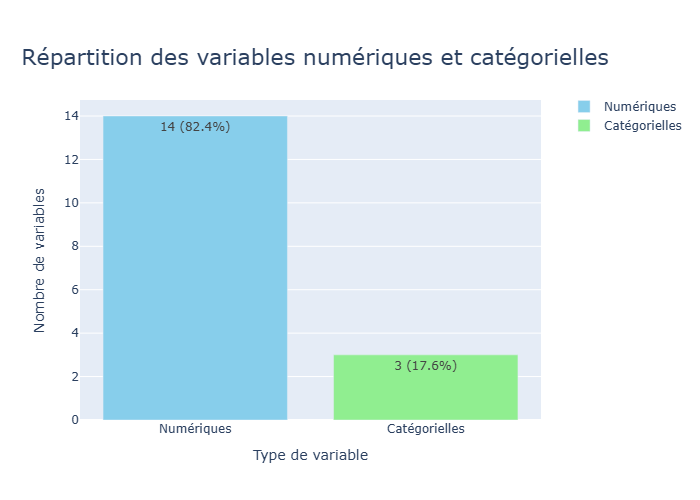

In [523]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_bureau,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

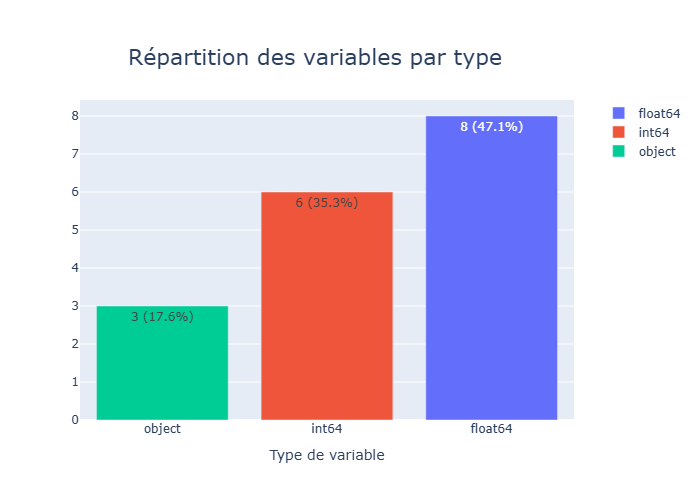

In [524]:
# Visualisation de la répartition des variables par type.

var_distrib_appli_train = plot_variable_types_distribution(df=df_bureau,
                          chart_type='bar',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.90,
                          annotation_format= 'both',
                          bar_orientation= 'v',
                          width=800,
                          height=800)

var_distrib_appli_train.show()

##### - Valeurs aberrantes de df_bureau

In [525]:
# Liste des variables catégorielles du dataframe.

df_bureau.select_dtypes(include=['object']).nunique()

CREDIT_ACTIVE       4
CREDIT_CURRENCY     4
CREDIT_TYPE        15
dtype: int64

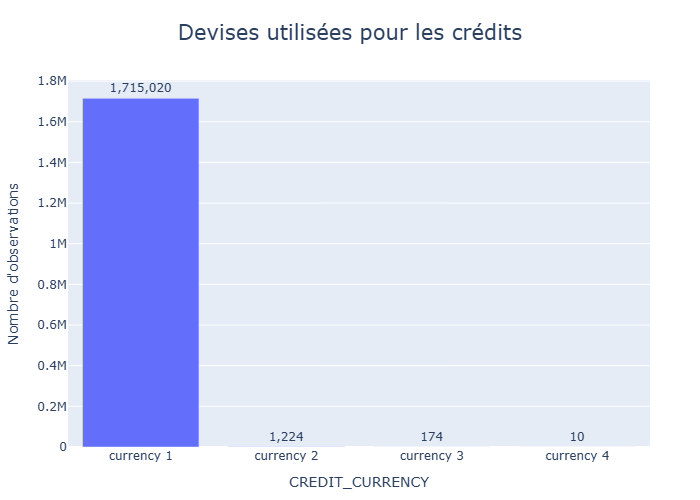

In [526]:
# Visualisation de la répartition pour la variable "CREDIT_CURRENCY"

plot_histogram_categorical(
    df=df_bureau,
    x="CREDIT_CURRENCY",
    title="Devises utilisées pour les crédits",
    title_font_size=21
)

- Il n'y a pas de valeurs aberrante mais certaines modalités sont très rare, ce que l'on peut simplifier en réduisant les classes en 2 catégories puisque plus de 99.9 % des devises sont la classe 1, on peut donc réduire les 3 suivantes en *"other_currency"*.

In [527]:
# Changement des modalités concernées pour la variable 'CREDIT_CURRENCY'.

rare_currencies = df_bureau['CREDIT_CURRENCY'].value_counts(normalize=True)
rare_currencies = rare_currencies[rare_currencies < 0.01].index
df_bureau['CREDIT_CURRENCY'] = df_bureau['CREDIT_CURRENCY'].replace(rare_currencies, 'currency_other')

In [528]:
# Vérification des changements apportés.

df_bureau['CREDIT_CURRENCY'].unique()

array(['currency 1', 'currency_other'], dtype=object)

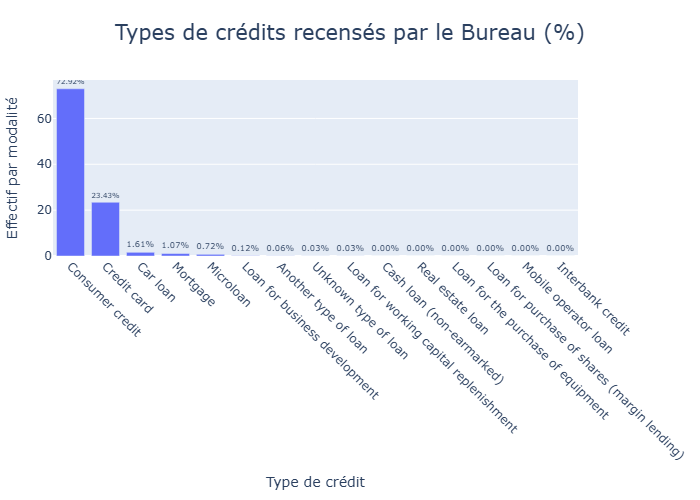

In [529]:
# Visualisation de la répartition pour la variable "CREDIT_TYPE".

plot_histogram_categorical(
    df=df_bureau,
    color_map = 'rainbow',
    x="CREDIT_TYPE",
    title="Types de crédits recensés par le Bureau (%) ",
    xaxis_title= 'Type de crédit',
    yaxis_title= 'Effectif par modalité',
    tickangle=45,
    title_font_size=21,
    height=700,
    width=900, 
    percent=True
)

- Même constat que précédemment, il y a beaucoup de catégorie mais certaines sont peu représentées, il est donc possible de les regrouper en 1 groupe afin de réduire le nombre de modalité pour cette variable.

In [530]:
# Changement des modalités concernées pour la variable 'CREDIT_CURRENCY'.

rare_types = df_bureau['CREDIT_TYPE'].value_counts(normalize=True)
rare_types = rare_types[rare_types < 0.005].index
df_bureau['CREDIT_TYPE'] = df_bureau['CREDIT_TYPE'].replace(rare_types, 'Other')

In [531]:
# Vérification des changements apportés.

df_bureau['CREDIT_TYPE'].unique()

array(['Consumer credit', 'Credit card', 'Mortgage', 'Car loan',
       'Microloan', 'Other'], dtype=object)

- On peut donc passer aux variables quantitatives:

In [532]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_bureau.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_CURR',
 'SK_ID_BUREAU',
 'DAYS_CREDIT',
 'CREDIT_DAY_OVERDUE',
 'DAYS_CREDIT_ENDDATE',
 'DAYS_ENDDATE_FACT',
 'AMT_CREDIT_MAX_OVERDUE',
 'CNT_CREDIT_PROLONG',
 'AMT_CREDIT_SUM',
 'AMT_CREDIT_SUM_DEBT',
 'AMT_CREDIT_SUM_LIMIT',
 'AMT_CREDIT_SUM_OVERDUE',
 'DAYS_CREDIT_UPDATE',
 'AMT_ANNUITY']


In [533]:
report_aberr_val_bureau = detect_aberrant_values(df_bureau.iloc[:, 2:], min_occurrences=2)
report_aberr_val_bureau

,Variable,Valeur_aberrante,Occurrences
0,DAYS_CREDIT,-28.000,782
1,DAYS_CREDIT,-35.000,689
2,DAYS_CREDIT,-29.000,666
3,DAYS_CREDIT,-32.000,666
4,DAYS_CREDIT,-36.000,654
...,...,...,...
5788,AMT_ANNUITY,154891.305,2
5789,AMT_ANNUITY,119488.500,2
5790,AMT_ANNUITY,127138.500,2
5791,AMT_ANNUITY,160714.305,2


In [534]:
#  Visualisation des valeurs aberrantes négatives potentielles.

report_aberr_val_bureau.loc[report_aberr_val_bureau['Valeur_aberrante'] < 0]

,Variable,Valeur_aberrante,Occurrences
0,DAYS_CREDIT,-28.0,782
1,DAYS_CREDIT,-35.0,689
2,DAYS_CREDIT,-29.0,666
3,DAYS_CREDIT,-32.0,666
4,DAYS_CREDIT,-36.0,654
...,...,...,...
5175,DAYS_CREDIT_UPDATE,-41868.0,2
5176,DAYS_CREDIT_UPDATE,-2834.0,2
5177,DAYS_CREDIT_UPDATE,-2910.0,2
5178,DAYS_CREDIT_UPDATE,-2861.0,2


In [535]:
report_aberr_val_bureau.loc[report_aberr_val_bureau['Valeur_aberrante'] < 0]['Variable'].unique()

array(['DAYS_CREDIT', 'DAYS_CREDIT_ENDDATE', 'DAYS_ENDDATE_FACT',
       'AMT_CREDIT_SUM_DEBT', 'DAYS_CREDIT_UPDATE'], dtype=object)

In [536]:
df_bureau['DAYS_CREDIT_ENDDATE'].describe().round(0)

count    1610875.0
mean         511.0
std         4994.0
min       -42060.0
25%        -1138.0
50%         -330.0
75%          474.0
max        31199.0
Name: DAYS_CREDIT_ENDDATE, dtype: float64

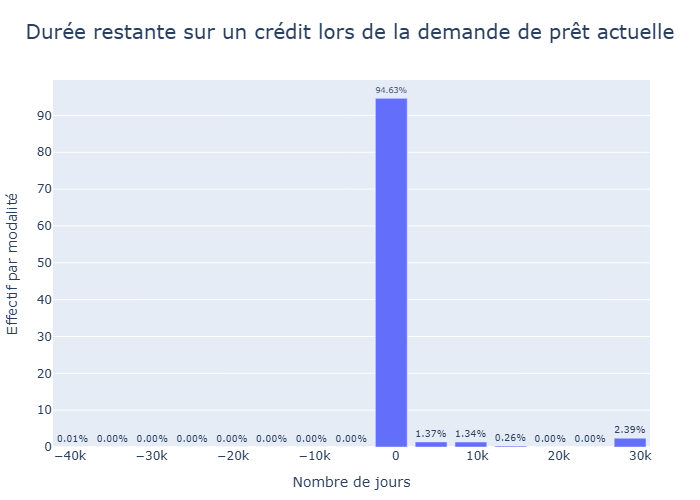

In [537]:
# Visualisation de la répartition pour la variable "DAYS_CREDIT_ENDDATE".

plot_histogram_quantitative(
    df=df_bureau,
    color_map = 'rainbow',
    x="DAYS_CREDIT_ENDDATE",
    title="Durée restante sur un crédit lors de la demande de prêt actuelle",
    xaxis_title= 'Nombre de jours',
    yaxis_title= 'Effectif par modalité',
    title_font_size=20,
    height=700,
    width=900, 
    percent=True
)

In [538]:
df_bureau['DAYS_CREDIT_UPDATE'].describe().round(0)

count    1716428.0
mean        -594.0
std          721.0
min       -41947.0
25%         -908.0
50%         -395.0
75%          -33.0
max          372.0
Name: DAYS_CREDIT_UPDATE, dtype: float64

- Ici on retrouve des variables temporelles relative à demande de prêt actuelle donc les valeurs négatives sont normales ici mais pour certaines elles vont beaucoup trop loin dans le temps comme par exemple *"DAYS_ENDDATE_FACT"* qui atteint -42K soit 115 ans donc il faut corriger cela.

In [539]:
# Correction des valeurs aberrantes pour les variables temporelles concernées.

df_bureau.loc[df_bureau['DAYS_CREDIT_ENDDATE'] < -25000, 'DAYS_CREDIT_ENDDATE'] = np.nan
df_bureau.loc[df_bureau['DAYS_ENDDATE_FACT'] < -25000, 'DAYS_ENDDATE_FACT'] = np.nan
df_bureau.loc[df_bureau['DAYS_CREDIT_UPDATE'] < -25000, 'DAYS_CREDIT_UPDATE'] = np.nan


In [540]:
# Vérification des changements apportés.

df_bureau.loc[df_bureau['DAYS_CREDIT_ENDDATE'] < -25000, 'DAYS_CREDIT_ENDDATE']

Series([], Name: DAYS_CREDIT_ENDDATE, dtype: float64)

In [541]:
report_aberr_val_bureau.loc[report_aberr_val_bureau['Valeur_aberrante'] > 0]['Variable'].unique()

array(['CREDIT_DAY_OVERDUE', 'DAYS_CREDIT_ENDDATE',
       'AMT_CREDIT_MAX_OVERDUE', 'CNT_CREDIT_PROLONG', 'AMT_CREDIT_SUM',
       'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT',
       'AMT_CREDIT_SUM_OVERDUE', 'DAYS_CREDIT_UPDATE', 'AMT_ANNUITY'],
      dtype=object)

In [542]:
df_bureau['DAYS_CREDIT_UPDATE'].describe().round(0)

count    1716333.0
mean        -591.0
std          652.0
min        -2917.0
25%         -908.0
50%         -395.0
75%          -33.0
max          372.0
Name: DAYS_CREDIT_UPDATE, dtype: float64

- On retrouve de nouveau cette variable temporelle, qui a des valeurs positives à supprimer puisque l'on se place normalement par rapport à la date de la demande actuelle de prêt donc des valeurs positives renvoient dans le futur ce qui est absurde.
- De plus, pour la variable *'DAYS_CREDIT_ENDDATE'*, les valeurs positives sont normales mais trop importantes pour certaines, il faut donc aussi corriger cela.

In [543]:
# Correction des valeurs aberrantes pour la variable temporelle 'DAYS_CREDIT_UPDATE'.

df_bureau.loc[df_bureau['DAYS_CREDIT_UPDATE'] > 0, 'DAYS_CREDIT_UPDATE'] = np.nan

# Vérification des changements apportés.

df_bureau.loc[df_bureau['DAYS_CREDIT_UPDATE'] > 0, 'DAYS_CREDIT_UPDATE']

Series([], Name: DAYS_CREDIT_UPDATE, dtype: float64)

In [544]:
# Correction des valeurs aberrantes pour la variable temporelle 'DAYS_CREDIT_ENDDATE'.

df_bureau.loc[df_bureau['DAYS_CREDIT_ENDDATE'] > 10000, 'DAYS_CREDIT_ENDDATE'] = np.nan

# Vérification des changements apportés.

df_bureau.loc[df_bureau['DAYS_CREDIT_ENDDATE'] > 10000, 'DAYS_CREDIT_ENDDATE']

Series([], Name: DAYS_CREDIT_ENDDATE, dtype: float64)

In [545]:
for col in ['AMT_CREDIT_MAX_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_ANNUITY', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT', 'AMT_CREDIT_SUM_OVERDUE']:
    print(col, ":", df_bureau[col].describe([.01, .05, .5, .95, .99]))

AMT_CREDIT_MAX_OVERDUE : count    5.919400e+05
mean     3.825418e+03
std      2.060316e+05
min      0.000000e+00
1%       0.000000e+00
5%       0.000000e+00
50%      0.000000e+00
95%      1.422045e+04
99%      4.198875e+04
max      1.159872e+08
Name: AMT_CREDIT_MAX_OVERDUE, dtype: float64
AMT_CREDIT_SUM : count    1.716415e+06
mean     3.549946e+05
std      1.149811e+06
min      0.000000e+00
1%       0.000000e+00
5%       1.125000e+04
50%      1.255185e+05
95%      1.350000e+06
99%      3.700916e+06
max      5.850000e+08
Name: AMT_CREDIT_SUM, dtype: float64
AMT_ANNUITY : count    4.896370e+05
mean     1.571276e+04
std      3.258269e+05
min      0.000000e+00
1%       0.000000e+00
5%       0.000000e+00
50%      0.000000e+00
95%      4.657140e+04
99%      1.184519e+05
max      1.184534e+08
Name: AMT_ANNUITY, dtype: float64
AMT_CREDIT_SUM_DEBT : count    1.458759e+06
mean     1.370851e+05
std      6.774011e+05
min     -4.705600e+06
1%       0.000000e+00
5%       0.000000e+00
50%      0.000

- Plusieurs points à corriger comme les valeurs négatives pour certaines variables qui ne sont pas possible et surtout des valeurs positives extrêmes qui sont sans doutes des erreurs de saisie puisque on est sur des montants de l'ordre de millions à plusieurs centaines de millions, ce qui est improbable. Donc par précaution, on peut réaliser un clipping sur les valeurs extrêmes car pour ce fichier bureau, les données proviennent de sources externes et donc potentiellement moins fiable que Home Credit.

In [546]:
# Correction des valeurs aberrantes pour les variables monétaires.
    
for col in ['AMT_CREDIT_MAX_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_ANNUITY', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT']:

    upper = df_bureau[col].quantile(0.99)
    df_bureau.loc[df_bureau[col] > upper, col] = upper

# Correction des valeurs négatives

for col in ['AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT']:

    df_bureau.loc[df_bureau[col] < 0, col] = np.nan

In [547]:
# Vérification des changements apportés.

df_bureau['AMT_CREDIT_SUM_DEBT'].describe().round(0)

count    1450341.0
mean      110732.0
std       331107.0
min            0.0
25%            0.0
50%            0.0
75%        41400.0
max      2259728.0
Name: AMT_CREDIT_SUM_DEBT, dtype: float64

- Enfin on vérifie et on corrige certains montants qui ne peuvent en excéder d'autre tel que par exemple le montant total d'un crédit inférieure au montant restant/montant en retard par exemple.

In [548]:
# Montant de la dette restante supérieur au montant total du crédit à corriger.
df_bureau.loc[df_bureau['AMT_CREDIT_SUM_DEBT'] > df_bureau['AMT_CREDIT_SUM'], 'AMT_CREDIT_SUM_DEBT'] = np.nan

# Montant en retard supérieur au montant total du crédit à corriger.
df_bureau.loc[df_bureau['AMT_CREDIT_SUM_OVERDUE'] > df_bureau['AMT_CREDIT_SUM'], 'AMT_CREDIT_SUM_OVERDUE'] = np.nan

# Montant en retard supérieur au montant de la dette restante à corriger.
df_bureau.loc[df_bureau['AMT_CREDIT_SUM_OVERDUE'] > df_bureau['AMT_CREDIT_SUM_DEBT'], 'AMT_CREDIT_SUM_OVERDUE'] = np.nan

- Après la correction des valeurs aberrantes, on peut passer à l'imputation des valeurs manquantes en séparant les données train et test qui sont contenus dans le même fichier pour tous les fichiers subsidiaires.

In [549]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_bureau)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633654,36.917016
AMT_CREDIT_SUM_LIMIT,592131,34.497864
AMT_CREDIT_SUM_DEBT,295112,17.193381
DAYS_CREDIT_ENDDATE,157702,9.187802
AMT_CREDIT_SUM_OVERDUE,824,0.048007
DAYS_CREDIT_UPDATE,112,0.006525
AMT_CREDIT_SUM,13,0.000757


<Figure size 720x432 with 0 Axes>

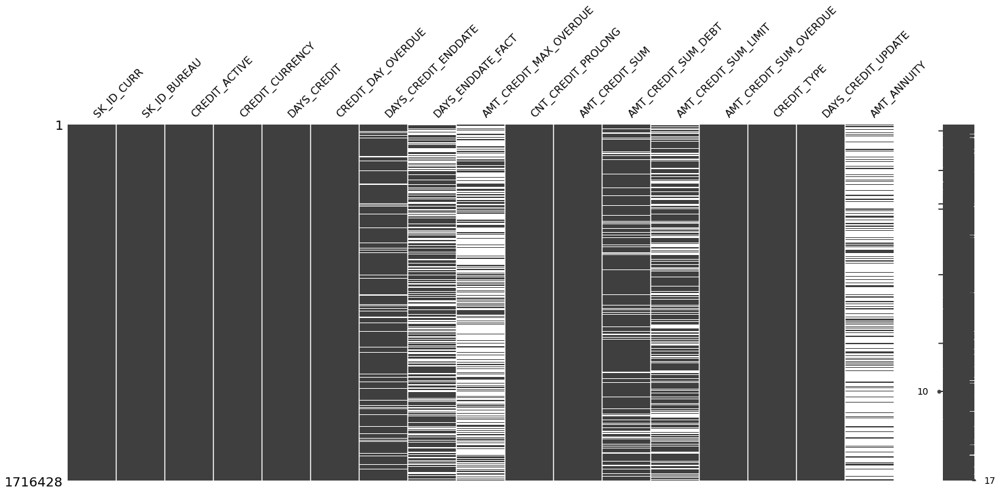

In [550]:
# Visualisation des valeurs manquantes à l'aide d'un graphique.

plot_missing_values(df_bureau.iloc[:, :],
                    use_missingno= 'matrix',
                    height=1000
                    )

In [551]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour l'ensemble du dataframe.

summarize_missing_values(df_bureau)

'Le DataFrame contient 4030827 valeurs manquantes sur 29179276 observations, soit 13.81%.'

In [552]:
# Variables avec plus de la moitié de valeurs manquantes

missing_columns_summary(df_bureau, threshold=50)

(2, ['AMT_CREDIT_MAX_OVERDUE', 'AMT_ANNUITY'])

- On peut voir ici les valeurs manquantes sur l'ensemble du dataframe mais il faut split les données pour savoir ce qu'il en est réellement par dataset.

In [553]:
# Séparation des données train et test avant imputation pour éviter la fuite d'informations.

df_bureau_train = df_bureau[df_bureau['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_bureau_test  = df_bureau[df_bureau['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

In [554]:
print_dataframe_shape(df_bureau_train)

Le DataFrame contient 1,465,289 lignes et 17 colonnes.


In [555]:
print_dataframe_shape(df_bureau_test)

Le DataFrame contient 251,103 lignes et 17 colonnes.


In [556]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_bureau_train)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_ANNUITY,1129977,77.116323
AMT_CREDIT_MAX_OVERDUE,948520,64.732623
DAYS_ENDDATE_FACT,544659,37.170756
AMT_CREDIT_SUM_LIMIT,490004,33.440775
AMT_CREDIT_SUM_DEBT,255984,17.469864
DAYS_CREDIT_ENDDATE,133216,9.091449
AMT_CREDIT_SUM_OVERDUE,728,0.049683
DAYS_CREDIT_UPDATE,112,0.007644
AMT_CREDIT_SUM,3,0.000205


In [557]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_bureau_test)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes
AMT_CREDIT_MAX_OVERDUE,175943,70.068060
AMT_CREDIT_SUM_LIMIT,102110,40.664588
AMT_ANNUITY,96778,38.541156
DAYS_ENDDATE_FACT,88980,35.435658
AMT_CREDIT_SUM_DEBT,39118,15.578468
DAYS_CREDIT_ENDDATE,24483,9.750182
AMT_CREDIT_SUM_OVERDUE,96,0.038231
AMT_CREDIT_SUM,10,0.003982


- Comme on peut le voir, ce partage des données entre train et test montre des différences non négligeable pour le pourcentage de valeurs manquantes (notamment AMT_ANNUITY qui a 77 % de valeurs manquantes pour train contre 38 % pour test) dont il y a peut être des profils différents entre les deux datasets.
- Malgré certains pourcentages important on garde toutes les variables des deux datasets pour garder un raisonnement métier logique puisque l'on a 4 méthodes d'imputation différentes à tester dont "nan/missing" qui permet de palier à cela surtout pour les modèles non linéaires.

In [558]:
# Création des datasets suivant les différentes configurations.

cat_cols = df_bureau.select_dtypes(include=["object"]).columns.tolist()
num_cols = df_bureau.select_dtypes(exclude=["object"]).columns.tolist()

datasets_bureau_train = create_datasets(df_bureau_train, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))
datasets_bureau_test = create_datasets(df_bureau_test, cat_cols, num_cols, setups=("median_mode", "median_missing", "iterative_mode", "nan_missing"))

c:\Users\Caomghin\anaconda3\lib\site-packages\sklearn\impute\_iterative.py:825: ConvergenceWarning:

[IterativeImputer] Early stopping criterion not reached.



In [559]:
# On assigne chaque setup à un dataframe.

# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_bureau_train_median_mode_linear = datasets_bureau_train["median_mode_linear"]
df_bureau_train_median_missing_linear = datasets_bureau_train["median_missing_linear"]
df_bureau_train_iterative_mode_linear = datasets_bureau_train["iterative_mode_linear"]
df_bureau_train_nan_missing_linear = datasets_bureau_train["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_bureau_train_median_mode = datasets_bureau_train["median_mode_tree"]
df_bureau_train_median_missing = datasets_bureau_train["median_missing_tree"]
df_bureau_train_iterative_mode = datasets_bureau_train["iterative_mode_tree"]
df_bureau_train_nan_missing = datasets_bureau_train["nan_missing_tree"]


# Versions pour modèles linéaires (régression logistique, Lasso, Ridge, etc.)
df_bureau_test_median_mode_linear = datasets_bureau_test["median_mode_linear"]
df_bureau_test_median_missing_linear = datasets_bureau_test["median_missing_linear"]
df_bureau_test_iterative_mode_linear = datasets_bureau_test["iterative_mode_linear"]
df_bureau_test_nan_missing_linear = datasets_bureau_test["nan_missing_linear"]

# Versions pour modèles non-linéaires (arbres, LightGBM, RF, XGB, etc.)
df_bureau_test_median_mode = datasets_bureau_test["median_mode_tree"]
df_bureau_test_median_missing = datasets_bureau_test["median_missing_tree"]
df_bureau_test_iterative_mode = datasets_bureau_test["iterative_mode_tree"]
df_bureau_test_nan_missing = datasets_bureau_test["nan_missing_tree"]

In [560]:
# Calcul du nombre et du pourcentage de valeurs manquantes restantes pour ces nouveaux dataframes.

print(summarize_missing_values(df_bureau_train_median_mode_linear))
print(summarize_missing_values(df_bureau_train_median_missing_linear))
print(summarize_missing_values(df_bureau_train_iterative_mode_linear))
print(summarize_missing_values(df_bureau_train_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 24909913 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 24909913 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 24909913 observations, soit 0.00%.
Le DataFrame contient 3503203 valeurs manquantes sur 24909913 observations, soit 14.06%.


In [561]:
print(summarize_missing_values(df_bureau_test_median_mode_linear))
print(summarize_missing_values(df_bureau_test_median_missing_linear))
print(summarize_missing_values(df_bureau_test_iterative_mode_linear))
print(summarize_missing_values(df_bureau_test_nan_missing_linear))

Le DataFrame contient 0 valeurs manquantes sur 4268751 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 4268751 observations, soit 0.00%.
Le DataFrame contient 0 valeurs manquantes sur 4268751 observations, soit 0.00%.
Le DataFrame contient 527518 valeurs manquantes sur 4268751 observations, soit 12.36%.


In [562]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_bureau_train_median_mode_linear)
optimize_types(df_bureau_train_median_missing_linear)
optimize_types(df_bureau_train_iterative_mode_linear)
optimize_types(df_bureau_train_nan_missing_linear)
optimize_types(df_bureau_train_median_mode)
optimize_types(df_bureau_train_median_missing)
optimize_types(df_bureau_train_iterative_mode)
optimize_types(df_bureau_train_nan_missing)

 Mémoire avant : 448.30 MB
 Mémoire après : 370.05 MB
 Gain : 17.5%
 Mémoire avant : 448.30 MB
 Mémoire après : 370.05 MB
 Gain : 17.5%
 Mémoire avant : 448.30 MB
 Mémoire après : 370.05 MB
 Gain : 17.5%
 Mémoire avant : 448.30 MB
 Mémoire après : 374.24 MB
 Gain : 16.5%
 Mémoire avant : 543.32 MB
 Mémoire après : 465.07 MB
 Gain : 14.4%
 Mémoire avant : 543.32 MB
 Mémoire après : 465.07 MB
 Gain : 14.4%
 Mémoire avant : 543.32 MB
 Mémoire après : 465.07 MB
 Gain : 14.4%
 Mémoire avant : 543.32 MB
 Mémoire après : 469.26 MB
 Gain : 13.6%


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,...,CNT_CREDIT_PROLONG_was_missing,AMT_CREDIT_SUM_was_missing,AMT_CREDIT_SUM_DEBT_was_missing,AMT_CREDIT_SUM_LIMIT_was_missing,AMT_CREDIT_SUM_OVERDUE_was_missing,DAYS_CREDIT_UPDATE_was_missing,AMT_ANNUITY_was_missing,CREDIT_ACTIVE_was_missing,CREDIT_CURRENCY_was_missing,CREDIT_TYPE_was_missing
0,215354,5714462,Closed,currency 1,-497,0,-153,-153,NaN,0,...,0,0,0,1,0,0,1,0,0,0
1,215354,5714463,Active,currency 1,-208,0,1075,<NA>,NaN,0,...,0,0,0,1,0,0,1,0,0,0
2,215354,5714464,Active,currency 1,-203,0,528,<NA>,NaN,0,...,0,0,1,1,0,0,1,0,0,0
3,215354,5714465,Active,currency 1,-203,0,<NA>,<NA>,NaN,0,...,0,0,1,1,0,0,1,0,0,0
4,215354,5714466,Active,currency 1,-629,0,1197,<NA>,41988.746094,0,...,0,0,1,1,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,5057750,Active,currency 1,-44,0,-30,<NA>,0.000000,0,...,0,0,0,0,0,0,1,0,0,0
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433,-2493,5476.500000,0,...,0,0,0,0,0,0,1,0,0,0
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628,-970,NaN,0,...,0,0,1,1,0,0,1,0,0,0
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513,-1513,NaN,0,...,0,0,0,0,0,0,1,0,0,0


In [563]:
# Optimisation des types de variables et de la mémoire du dataframe.

optimize_types(df_bureau_test_median_mode_linear)
optimize_types(df_bureau_test_median_missing_linear)
optimize_types(df_bureau_test_iterative_mode_linear)
optimize_types(df_bureau_test_nan_missing_linear)
optimize_types(df_bureau_test_median_mode)
optimize_types(df_bureau_test_median_missing)
optimize_types(df_bureau_test_iterative_mode)
optimize_types(df_bureau_test_nan_missing)

 Mémoire avant : 76.82 MB
 Mémoire après : 63.41 MB
 Gain : 17.5%
 Mémoire avant : 76.82 MB
 Mémoire après : 63.41 MB
 Gain : 17.5%
 Mémoire avant : 76.82 MB
 Mémoire après : 63.41 MB
 Gain : 17.5%
 Mémoire avant : 76.82 MB
 Mémoire après : 63.88 MB
 Gain : 16.8%
 Mémoire avant : 93.10 MB
 Mémoire après : 79.69 MB
 Gain : 14.4%
 Mémoire avant : 93.10 MB
 Mémoire après : 79.69 MB
 Gain : 14.4%
 Mémoire avant : 93.10 MB
 Mémoire après : 79.69 MB
 Gain : 14.4%
 Mémoire avant : 93.10 MB
 Mémoire après : 80.17 MB
 Gain : 13.9%


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,...,CNT_CREDIT_PROLONG_was_missing,AMT_CREDIT_SUM_was_missing,AMT_CREDIT_SUM_DEBT_was_missing,AMT_CREDIT_SUM_LIMIT_was_missing,AMT_CREDIT_SUM_OVERDUE_was_missing,DAYS_CREDIT_UPDATE_was_missing,AMT_ANNUITY_was_missing,CREDIT_ACTIVE_was_missing,CREDIT_CURRENCY_was_missing,CREDIT_TYPE_was_missing
3211,261883,5718424,Active,currency 1,-326,0,-142,<NA>,NaN,0,...,0,0,0,1,0,0,1,0,0,0
3212,261883,5718426,Closed,currency 1,-1039,0,-769,-769,NaN,0,...,0,0,0,1,0,0,0,0,0,0
3213,261883,5718427,Closed,currency 1,-702,0,28,-671,NaN,0,...,0,0,0,1,0,0,0,0,0,0
3214,261883,5718428,Closed,currency 1,-378,0,-144,-144,0.0,0,...,0,0,0,0,0,0,1,0,0,0
3215,261883,5718429,Closed,currency 1,-671,0,-343,-343,0.0,0,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1713506,252265,5078696,Closed,currency 1,-1630,0,-1265,-1510,NaN,0,...,0,0,0,0,0,0,0,0,0,0
1713507,252265,5078700,Closed,currency 1,-1948,0,-1581,-1592,NaN,0,...,0,0,0,1,0,0,0,0,0,0
1713508,252265,5078702,Closed,currency 1,-2256,0,-2072,-2072,NaN,0,...,0,0,0,1,0,0,0,0,0,0
1713509,118697,5078733,Closed,currency 1,-2804,0,-2591,-2620,NaN,0,...,0,0,0,1,0,0,1,0,0,0


In [564]:
# Visualisation des variables à encoder pour les dataframes utilisant le mode (2 dataframes).

binary_categorical = [col for col in df_bureau_train_median_mode_linear.columns 
                      if df_bureau_train_median_mode_linear[col].dtype == 'object' and df_bureau_train_median_mode_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical)

Variables catégorielles binaires : ['CREDIT_CURRENCY']


In [565]:
# Visualisation des variables à encoder pour les dataframes utilisant missing ou des nan.

binary_categorical_miss = [col for col in df_bureau_train_nan_missing_linear.columns 
                      if df_bureau_train_nan_missing_linear[col].dtype == 'object' and df_bureau_train_nan_missing_linear[col].nunique() == 2]

print("Variables catégorielles binaires :", binary_categorical_miss)

Variables catégorielles binaires : ['CREDIT_CURRENCY']


In [566]:
df_bureau_train_median_mode_linear['CREDIT_CURRENCY'].unique()

array(['currency 1', 'currency_other'], dtype=object)

In [567]:
# Encodage des variables catégorielles binaires avec LabelEncoder.

encoders = {}

# Liste des datasets concernés
datasets = [
    df_bureau,
    df_bureau_train_median_mode_linear,
    df_bureau_train_median_missing_linear,
    df_bureau_train_iterative_mode_linear,
    df_bureau_train_nan_missing_linear,
    df_bureau_train_median_mode,
    df_bureau_train_median_missing,
    df_bureau_train_iterative_mode,
    df_bureau_train_nan_missing,
    df_bureau_test_median_mode_linear,
    df_bureau_test_median_missing_linear,
    df_bureau_test_iterative_mode_linear,
    df_bureau_test_nan_missing_linear,
    df_bureau_test_median_mode,
    df_bureau_test_median_missing,
    df_bureau_test_iterative_mode,
    df_bureau_test_nan_missing
]

for col in binary_categorical:
    # Encodage avec la fonction générique
    dfs_encoded, le = label_encode(datasets, col)
    
    # Mise à jour des DataFrames originaux
    df_bureau = dfs_encoded[0]
    df_bureau_train_median_mode_linear = dfs_encoded[1]
    df_bureau_train_median_missing_linear = dfs_encoded[2]
    df_bureau_train_iterative_mode_linear = dfs_encoded[3]
    df_bureau_train_nan_missing_linear = dfs_encoded[4]
    df_bureau_train_median_mode = dfs_encoded[5]
    df_bureau_train_median_missing = dfs_encoded[6]
    df_bureau_train_iterative_mode = dfs_encoded[7]
    df_bureau_train_nan_missing = dfs_encoded[8]
    df_bureau_test_median_mode_linear = dfs_encoded[9]
    df_bureau_test_median_missing_linear = dfs_encoded[10]
    df_bureau_test_iterative_mode_linear = dfs_encoded[11]
    df_bureau_test_nan_missing_linear = dfs_encoded[12]
    df_bureau_test_median_mode = dfs_encoded[13]
    df_bureau_test_median_missing = dfs_encoded[14]
    df_bureau_test_iterative_mode = dfs_encoded[15]
    df_bureau_test_nan_missing = dfs_encoded[16]
    
    # Stocker l’encodeur pour usage futur
    encoders[col] = le


In [568]:
df_bureau['CREDIT_CURRENCY'].unique()

array([0, 1], dtype=object)

In [569]:
# Changement des types des variables concernées.

for col in binary_categorical:
    for df in [
        df_bureau,
        df_bureau_train_median_mode_linear, df_bureau_train_median_missing_linear,
        df_bureau_train_iterative_mode_linear, df_bureau_train_nan_missing_linear,
        df_bureau_train_median_mode, df_bureau_train_median_missing,
        df_bureau_train_iterative_mode, df_bureau_train_nan_missing,
        df_bureau_test_median_mode_linear, df_bureau_test_median_missing_linear,
        df_bureau_test_iterative_mode_linear, df_bureau_test_nan_missing_linear,
        df_bureau_test_median_mode, df_bureau_test_median_missing,
        df_bureau_test_iterative_mode, df_bureau_test_nan_missing
    ]:
        if col in df.columns:
            df[col] = df[col].astype(int)


- Puis pour les variables catégorielles restantes, on utilisera de nouveau One Hot Encoder comme pour application train/test.

In [570]:
df_bureau.select_dtypes("object").nunique()

CREDIT_ACTIVE    4
CREDIT_TYPE      6
dtype: int64

In [571]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_bureau_train_median_mode_linear.columns 
                      if df_bureau_train_median_mode_linear[col].dtype == 'object' and df_bureau_train_median_mode_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var)

Variables catégorielles avec One Hot Encoder : ['CREDIT_ACTIVE', 'CREDIT_TYPE']


In [572]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var_miss = [col for col in df_bureau_train_nan_missing_linear.columns 
                      if df_bureau_train_nan_missing_linear[col].dtype == 'object' and df_bureau_train_nan_missing_linear[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var_miss)

Variables catégorielles avec One Hot Encoder : ['CREDIT_ACTIVE', 'CREDIT_TYPE']


In [573]:
#Encodage des variables catégorielles avec One Hot Encoder.


# Liste des datasets à encoder
datasets_linear = [
    df_bureau_train_median_missing_linear,
    df_bureau_train_median_mode_linear,
    df_bureau_train_iterative_mode_linear,
    df_bureau_train_nan_missing_linear,
    df_bureau_test_median_mode_linear,
    df_bureau_test_median_missing_linear,
    df_bureau_test_iterative_mode_linear,
    df_bureau_test_nan_missing_linear
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

df_bureau_train_median_missing_linear = encoded_ohe_linear[0]
df_bureau_train_median_mode_linear = encoded_ohe_linear[1]
df_bureau_train_iterative_mode_linear = encoded_ohe_linear[2]
df_bureau_train_nan_missing_linear = encoded_ohe_linear[3]
df_bureau_test_median_mode_linear = encoded_ohe_linear[4]
df_bureau_test_median_missing_linear = encoded_ohe_linear[5]
df_bureau_test_iterative_mode_linear = encoded_ohe_linear[6]
df_bureau_test_nan_missing_linear = encoded_ohe_linear[7]

# Liste des datasets à encoder
datasets = [
    df_bureau_train_median_missing,
    df_bureau_train_median_mode,
    df_bureau_train_iterative_mode,
    df_bureau_train_nan_missing,
    df_bureau_test_median_mode,
    df_bureau_test_median_missing,
    df_bureau_test_iterative_mode,
    df_bureau_test_nan_missing
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

df_bureau_train_median_missing = encoded_ohe[0]
df_bureau_train_median_mode = encoded_ohe[1]
df_bureau_train_iterative_mode = encoded_ohe[2]
df_bureau_train_nan_missing = encoded_ohe[3]
df_bureau_test_median_mode = encoded_ohe[4]
df_bureau_test_median_missing = encoded_ohe[5]
df_bureau_test_iterative_mode = encoded_ohe[6]
df_bureau_test_nan_missing = encoded_ohe[7]


In [585]:
df_bureau_train_median_missing_linear.loc[:, df_bureau_train_median_missing_linear.columns.str.contains('CREDIT_ACTIVE')]

,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold
0,0.0,1.0,0.0
1,0.0,0.0,0.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,0.0,0.0
...,...,...,...
1716423,0.0,0.0,0.0
1716424,0.0,1.0,0.0
1716425,0.0,1.0,0.0
1716426,0.0,1.0,0.0


In [586]:
df_bureau_train_median_missing.loc[:, df_bureau_train_median_missing.columns.str.contains('CREDIT_ACTIVE')]

,CREDIT_ACTIVE_was_missing,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold
0,0,0.0,0.0,1.0,0.0
1,0,1.0,0.0,0.0,0.0
2,0,1.0,0.0,0.0,0.0
3,0,1.0,0.0,0.0,0.0
4,0,1.0,0.0,0.0,0.0
...,...,...,...,...,...
1716423,0,1.0,0.0,0.0,0.0
1716424,0,0.0,0.0,1.0,0.0
1716425,0,0.0,0.0,1.0,0.0
1716426,0,0.0,0.0,1.0,0.0


In [587]:
# Fonction ajoutant quelques features intéressantes pour ce fichier

def add_bureau_features(df):

    """
    Ajoute des features dérivées au dataset bureau.csv de Home Credit Default Risk.
    df : DataFrame pandas
    """
    
    # Quelques ratios sur les montants des crédits

    # Proportion de dette par rapport au crédit total possible (crédit + limite)
    df["DEBT_TOTAL_RATIO"] = df["AMT_CREDIT_SUM_DEBT"] / (df["AMT_CREDIT_SUM"] + df["AMT_CREDIT_SUM_LIMIT"] + 1e-6)
    
    # Proportion de dette par rapport au montant actuel du crédit
    df["DEBT_CREDIT_RATIO"] = df["AMT_CREDIT_SUM_DEBT"] / (df["AMT_CREDIT_SUM"] + 1e-6)

    # Rapport entre la limite de carte de crédit au montant actuel du crédit
    df["LIMIT_CREDIT_RATIO"] = df["AMT_CREDIT_SUM_LIMIT"] / (df["AMT_CREDIT_SUM"] + 1e-6)

    # Rapport entre montant en retard et montant total du crédit
    df["OVERDUE_TO_CREDIT_RATIO"] = df["AMT_CREDIT_SUM_OVERDUE"] / (df["AMT_CREDIT_SUM"] + 1e-6)

    # Rapport entre montant en retard et montant total du crédit
    df["OVERDUE_TO_DEBT_RATIO"] = df["AMT_CREDIT_SUM_OVERDUE"] / (df["AMT_CREDIT_SUM_DEBT"] + 1e-6)

    # Ratio du crédit actuel sur le montant maximal jamais dû
    df["CURRENT_OVER_MAX_OVERDUE_RATIO"] = df["AMT_CREDIT_SUM"] / (df["AMT_CREDIT_MAX_OVERDUE"] + 1e-6)
    
    # Quelques intéractions temporelles facilitant la compréhension des modèles

    df["CREDIT_DURATION"] = df["DAYS_CREDIT_ENDDATE"] - df["DAYS_CREDIT"]
    df["IS_EARLY_REPAYMENT"] = (df["DAYS_ENDDATE_FACT"] < df["DAYS_CREDIT_ENDDATE"]).astype(float)
    df["IS_LATE_REPAYMENT"] = (df["DAYS_ENDDATE_FACT"] > df["DAYS_CREDIT_ENDDATE"]).astype(float)

    df["HAS_PROLONGATION"] = (df["CNT_CREDIT_PROLONG"] > 0).astype(int)
    df["MULTIPLE_PROLONGATION"] = (df["CNT_CREDIT_PROLONG"] >= 2).astype(int)

    df["DAYS_SINCE_LAST_UPDATE"] = df["DAYS_CREDIT"] - df["DAYS_CREDIT_UPDATE"]
    
    # Remplacer les infinities ou NaN problématiques

    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    

In [588]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

for df in [
    df_bureau_train_median_mode_linear, df_bureau_train_median_missing_linear,
    df_bureau_train_iterative_mode_linear, df_bureau_train_nan_missing_linear,
    df_bureau_train_median_mode, df_bureau_train_median_missing,
    df_bureau_train_iterative_mode, df_bureau_train_nan_missing,
    df_bureau_test_median_mode_linear, df_bureau_test_median_missing_linear,
    df_bureau_test_iterative_mode_linear, df_bureau_test_nan_missing_linear,
    df_bureau_test_median_mode, df_bureau_test_median_missing,
    df_bureau_test_iterative_mode, df_bureau_test_nan_missing
    ]:

    add_bureau_features(df)

- Ensuite après avoir créer quelques variables supplémentaires qui peuvent être intéressante, puisque l'on a plusieurs lignes par client dans ce dataframe mais que l'on veut ajouter ces variables aux dataframes principaux application train/test, il est nécessaire de réaliser une agrégation par client.

In [589]:
df_bureau_train_median_mode.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1465289 entries, 0 to 1716427
Data columns (total 54 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   SK_ID_CURR                          1465289 non-null  int32  
 1   SK_ID_BUREAU                        1465289 non-null  int32  
 2   CREDIT_CURRENCY                     1465289 non-null  int32  
 3   DAYS_CREDIT                         1465289 non-null  int32  
 4   CREDIT_DAY_OVERDUE                  1465289 non-null  int32  
 5   DAYS_CREDIT_ENDDATE                 1465289 non-null  int32  
 6   DAYS_ENDDATE_FACT                   1465289 non-null  int32  
 7   AMT_CREDIT_MAX_OVERDUE              1465289 non-null  float32
 8   CNT_CREDIT_PROLONG                  1465289 non-null  int32  
 9   AMT_CREDIT_SUM                      1465289 non-null  float32
 10  AMT_CREDIT_SUM_DEBT                 1465289 non-null  float32
 11  AMT_CREDIT_SUM_L

In [590]:
def aggregate_bureau_df(df, ohe_var=None):
    """
    Agrège le dataframe 'bureau' au niveau de SK_ID_CURR.
    df : DataFrame pandas
    ohe_var : variables one hot encoder
    """

    import numpy as np
    import pandas as pd

    data = df.copy()

    # Colonnes à exclure de l'agrégation classique
    exclude_cols = ["SK_ID_BUREAU"]

    # Colonnes _was_missing
    was_missing_cols = [c for c in data.columns if c.endswith("_was_missing")]

    # Colonnes OHE selon les préfixes passés 
    ohe_cols = []
    if ohe_var is not None:
        ohe_cols = [
            c for c in data.columns
            if any(c.startswith(prefix) for prefix in ohe_var)
        ]

    # Colonnes numériques
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + was_missing_cols + ohe_cols + ["SK_ID_CURR"]
    ]

    # Dictionnaire d'agrégation principal
    agg_dict = {
        'CREDIT_CURRENCY': ['mean', 'sum'],
        'DAYS_CREDIT': ['mean', 'min', 'max'],
        'CREDIT_DAY_OVERDUE': ['mean', 'max'],
        'DAYS_CREDIT_ENDDATE': ['mean', 'min', 'max'],
        'DAYS_ENDDATE_FACT': ['mean', 'min', 'max'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean', 'max'],
        'CNT_CREDIT_PROLONG': ['mean', 'sum', 'max'],
        'AMT_CREDIT_SUM': ['mean', 'sum', 'max'],
        'AMT_CREDIT_SUM_DEBT': ['mean', 'sum', 'max'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum', 'max'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean', 'sum', 'max'],
        'DAYS_CREDIT_UPDATE': ['mean', 'min', 'max'],
        'AMT_ANNUITY': ['mean', 'max'],
        'DEBT_TOTAL_RATIO': ['mean', 'max'],
        'DEBT_CREDIT_RATIO': ['mean', 'max'],
        'LIMIT_CREDIT_RATIO': ['mean', 'max'],
        'OVERDUE_TO_CREDIT_RATIO': ['mean', 'max'],
        'OVERDUE_TO_DEBT_RATIO': ['mean', 'max'],
        'CURRENT_OVER_MAX_OVERDUE_RATIO': ['mean', 'max'],
        'CREDIT_DURATION': ['mean', 'max'],
        'DAYS_SINCE_LAST_UPDATE': ['mean', 'min', 'max'],
        'IS_EARLY_REPAYMENT': ['mean'],
        'IS_LATE_REPAYMENT': ['mean'],
        'HAS_PROLONGATION': ['mean', 'sum'],
        'MULTIPLE_PROLONGATION': ['mean', 'sum']
    }

    # On garde uniquement les variables existantes dans le dataframe
    agg_dict = {k: v for k, v in agg_dict.items() if k in numeric_cols}

    # Agrégations des variables du dictionnaire
    bureau_agg = data.groupby('SK_ID_CURR').agg(agg_dict)
    bureau_agg.columns = [f"BUREAU_{col.upper()}_{stat.upper()}" for col, stat in bureau_agg.columns]
    bureau_agg.reset_index(inplace=True)

    # Agrégations sur les colonnes OHE 
    if len(ohe_cols) > 0:
        ohe_agg = data.groupby('SK_ID_CURR')[ohe_cols].agg(['mean', 'sum'])
        ohe_agg.columns = [f"BUREAU_{col.upper()}_{stat.upper()}" for col, stat in ohe_agg.columns]
        ohe_agg.reset_index(inplace=True)
        bureau_agg = bureau_agg.merge(ohe_agg, on='SK_ID_CURR', how='left')

    # Agrégations sur les colonnes _was_missing
    if len(was_missing_cols) > 0:
        missing_agg = data.groupby('SK_ID_CURR')[was_missing_cols].agg(['mean', 'sum'])
        missing_agg.columns = [f"BUREAU_{col.upper()}_{stat.upper()}" for col, stat in missing_agg.columns]
        missing_agg.reset_index(inplace=True)
        bureau_agg = bureau_agg.merge(missing_agg, on='SK_ID_CURR', how='left')

    # Ajout de certaines variables utiles après agrégation.
    bureau_agg["BUREAU_NB_LOANS"] = data.groupby("SK_ID_CURR").size().values
    if "CREDIT_ACTIVE_Active" in data.columns:
        bureau_agg["BUREAU_PCT_ACTIVE"] = (
            data.groupby("SK_ID_CURR")["CREDIT_ACTIVE_Active"].mean().fillna(0).values
    )
    bureau_agg["BUREAU_NB_OVERDUE"] = (
    df.groupby("SK_ID_CURR")["CREDIT_DAY_OVERDUE"].apply(lambda x: (x > 0).sum()).values
)

    # Gestion de certaines valeurs aberrantes qui pourraient apparaitre.
    bureau_agg.replace([np.inf, -np.inf], np.nan, inplace=True)


    print(f"Agrégation complète — shape final : {bureau_agg.shape}")
    return bureau_agg

In [591]:
# Application de la fonction à l'ensemble des dataframes bureau.

df_bureau_train_median_mode_linear_agg = aggregate_bureau_df(df_bureau_train_median_mode_linear, ohe_var=ohe_var)
df_bureau_train_median_missing_linear_agg = aggregate_bureau_df(df_bureau_train_median_missing_linear, ohe_var=ohe_var)
df_bureau_train_iterative_mode_linear_agg = aggregate_bureau_df(df_bureau_train_iterative_mode_linear, ohe_var=ohe_var)
df_bureau_train_nan_missing_linear_agg = aggregate_bureau_df(df_bureau_train_nan_missing_linear, ohe_var=ohe_var)

df_bureau_train_median_mode_agg = aggregate_bureau_df(df_bureau_train_median_mode, ohe_var=ohe_var)
df_bureau_train_median_missing_agg = aggregate_bureau_df(df_bureau_train_median_missing, ohe_var=ohe_var)
df_bureau_train_iterative_mode_agg = aggregate_bureau_df(df_bureau_train_iterative_mode, ohe_var=ohe_var)
df_bureau_train_nan_missing_agg = aggregate_bureau_df(df_bureau_train_nan_missing, ohe_var=ohe_var)

df_bureau_test_median_mode_linear_agg = aggregate_bureau_df(df_bureau_test_median_mode_linear, ohe_var=ohe_var)
df_bureau_test_median_missing_linear_agg = aggregate_bureau_df(df_bureau_test_median_missing_linear, ohe_var=ohe_var)
df_bureau_test_iterative_mode_linear_agg = aggregate_bureau_df(df_bureau_test_iterative_mode_linear, ohe_var=ohe_var)
df_bureau_test_nan_missing_linear_agg = aggregate_bureau_df(df_bureau_test_nan_missing_linear, ohe_var=ohe_var)

df_bureau_test_median_mode_agg = aggregate_bureau_df(df_bureau_test_median_mode, ohe_var=ohe_var)
df_bureau_test_median_missing_agg = aggregate_bureau_df(df_bureau_test_median_missing, ohe_var=ohe_var)
df_bureau_test_iterative_mode_agg = aggregate_bureau_df(df_bureau_test_iterative_mode, ohe_var=ohe_var)
df_bureau_test_nan_missing_agg = aggregate_bureau_df(df_bureau_test_nan_missing, ohe_var=ohe_var)

Agrégation complète — shape final : (263485, 77)
Agrégation complète — shape final : (263485, 77)
Agrégation complète — shape final : (263485, 77)
Agrégation complète — shape final : (263485, 77)
Agrégation complète — shape final : (263485, 120)
Agrégation complète — shape final : (263485, 120)
Agrégation complète — shape final : (263485, 120)
Agrégation complète — shape final : (263485, 120)
Agrégation complète — shape final : (42320, 77)
Agrégation complète — shape final : (42320, 77)
Agrégation complète — shape final : (42320, 77)
Agrégation complète — shape final : (42320, 77)
Agrégation complète — shape final : (42320, 120)
Agrégation complète — shape final : (42320, 120)
Agrégation complète — shape final : (42320, 120)
Agrégation complète — shape final : (42320, 120)


In [592]:
df_bureau_train_median_mode_linear_agg.head()

,SK_ID_CURR,BUREAU_CREDIT_CURRENCY_MEAN,BUREAU_CREDIT_CURRENCY_SUM,BUREAU_DAYS_CREDIT_MEAN,BUREAU_DAYS_CREDIT_MIN,BUREAU_DAYS_CREDIT_MAX,BUREAU_CREDIT_DAY_OVERDUE_MEAN,BUREAU_CREDIT_DAY_OVERDUE_MAX,BUREAU_DAYS_CREDIT_ENDDATE_MEAN,BUREAU_DAYS_CREDIT_ENDDATE_MIN,...,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_LOANS,BUREAU_NB_OVERDUE
0,100002,0.0,0,-874.000000,-1437,-103,0.0,0,-356.500000,-1072,...,0.5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,8,0
1,100003,0.0,0,-1400.750000,-2586,-606,0.0,0,-544.500000,-2434,...,0.5,2.0,0.0,0.0,0.0,0.0,0.0,0.0,4,0
2,100004,0.0,0,-867.000000,-1326,-408,0.0,0,-488.500000,-595,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,0
3,100007,0.0,0,-1149.000000,-1149,-1149,0.0,0,-783.000000,-783,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
4,100008,0.0,0,-757.333333,-1097,-78,0.0,0,-391.333333,-853,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,0


In [593]:
calculate_missing_values(df_bureau_train_median_mode_linear_agg)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


- La phase d'agrégation étant terminée, on remarque assez facilement qu'il y a une différence du nombre de ligne entre le nombre de clients unique ici et celui des fichiers application train/test qui résulte du fait, que certains clients n'ont pas d'antécédents de crédit avant la demande de prêt actuelle.
- On passe donc à l'avant dernière étape qui consiste au merge des features du fichier bureau agrégé à celles du fichier principal application train/test.

In [594]:
# Merge des pairs bureau/application pour les datasets train

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_bureau_train_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_bureau_train_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_bureau_train_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_bureau_train_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_bureau_train_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_bureau_train_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_bureau_train_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_bureau_train_nan_missing_agg, on="SK_ID_CURR", how="left"
)

# Merge des pairs bureau/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_bureau_test_median_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_bureau_test_median_missing_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_bureau_test_iterative_mode_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_bureau_test_nan_missing_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_bureau_test_median_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_bureau_test_median_missing_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_bureau_test_iterative_mode_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_bureau_test_nan_missing_agg, on="SK_ID_CURR", how="left"
)

In [595]:
# Visualisation des changements apportés.

df_train_median_mode_linear.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_LOANS,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.5,2.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [596]:
df_train_median_mode_linear.info(display, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307500 entries, 0 to 307499
Data columns (total 209 columns):
 #    Column                                      Non-Null Count   Dtype  
---   ------                                      --------------   -----  
 0    SK_ID_CURR                                  307500 non-null  int32  
 1    TARGET                                      307500 non-null  int32  
 2    NAME_CONTRACT_TYPE                          307500 non-null  Int64  
 3    CODE_GENDER                                 307500 non-null  Int64  
 4    FLAG_OWN_CAR                                307500 non-null  Int64  
 5    FLAG_OWN_REALTY                             307500 non-null  Int64  
 6    AMT_ANNUITY                                 307500 non-null  float32
 7    REGION_POPULATION_RELATIVE                  307500 non-null  float32
 8    OWN_CAR_AGE                                 307500 non-null  int32  
 9    FLAG_MOBIL                                  307500 non-nu

In [597]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


- Le merge à bien été effectué pour l'ensemble des datasets que l'on a mis en place pour la modèlisation. 
- Pour les dataframes reservès aux modèles linéaires, on a choisi de remplir les valeurs manquantes par 0 car pour les clients sans antécédents de crédit cela poserai problème par la suite. 
- En effet, si certains modèles non linéaires peuvent gérer les Nan, ce n'est pas le cas pour les modèles linéaires donc il restait soit une imputation mais qui ne donne pas sens puisque ces clients n'ont pas de crédit précédent la demande actuelle. Donc il a été choisi de remplacer par 0 comme symbolique d'absence de crédit antérieure à la demande de prêt actuelle.

Pour finir, on peut s'intéresser aux corrélation entre les variables afin d'éliminer les variables trop corrélées entre elles.

#### Corrélation des variables - df_train_median_mode_linear

In [598]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_bureau_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_DEBT_CREDIT_RATIO_MEAN / BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_CREDIT_RATIO_MEAN,0.999078
1,BUREAU_DEBT_CREDIT_RATIO_MAX / BUREAU_DEBT_TOTAL_RATIO_MAX,BUREAU_DEBT_TOTAL_RATIO_MAX,BUREAU_DEBT_CREDIT_RATIO_MAX,0.998722
2,BUREAU_CNT_CREDIT_PROLONG_MAX / BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_MAX,0.988611
3,BUREAU_AMT_CREDIT_SUM_MAX / BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX,BUREAU_AMT_CREDIT_SUM_MAX,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX,0.976483
4,BUREAU_AMT_CREDIT_SUM_MEAN / BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN,BUREAU_AMT_CREDIT_SUM_MEAN,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN,0.968818
5,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_NB_LOANS,0.943611
6,BUREAU_CREDIT_DURATION_MAX / BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_CREDIT_DURATION_MAX,0.940186
7,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.935354
8,BUREAU_AMT_CREDIT_SUM_DEBT_MAX / BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_MAX,0.933979
9,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_NB_LOANS,0.932987


In [600]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_bureau_train_median_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [601]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [603]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_DAYS_CREDIT_MEAN,0.083939,0.087374,0.083939,0.087374,0.085656
BUREAU_DAYS_CREDIT_UPDATE_MEAN,0.073339,0.078399,0.073339,0.078399,0.075869
BUREAU_DAYS_CREDIT_MIN,0.072845,0.070928,0.072845,0.070928,0.071886
BUREAU_DAYS_CREDIT_UPDATE_MIN,0.064255,0.064979,0.064255,0.064979,0.064617
BUREAU_DAYS_ENDDATE_FACT_MIN,0.058812,0.061615,0.058812,0.061615,0.060214
BUREAU_DAYS_SINCE_LAST_UPDATE_MEAN,0.058755,0.066117,0.058755,0.066117,0.062436
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.058508,0.044673,0.058508,0.044673,0.051590
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.058094,0.044439,0.058094,0.044439,0.051267
BUREAU_DAYS_SINCE_LAST_UPDATE_MIN,0.054855,0.056477,0.054855,0.056477,0.055666
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.053361,0.059941,0.053361,0.059941,0.056651


In [604]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_DAYS_CREDIT_UPDATE_MEAN, BUREAU_DAYS_ENDDATE_FACT_MEAN, BUREAU_DAYS_CREDIT_ENDDATE_MIN, BUREAU_DAYS_CREDIT_UPDATE_MIN, BUREAU_DAYS_CREDIT_MIN, BUREAU_DAYS_ENDDATE_FACT_MIN, BUREAU_DAYS_CREDIT_MEAN]",7,0.083939,BUREAU_DAYS_CREDIT_MEAN
1,"[BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM]",3,0.004000,BUREAU_HAS_PROLONGATION_SUM
2,"[BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_SUM]",3,0.030678,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX
3,"[BUREAU_NB_LOANS, BUREAU_CREDIT_ACTIVE_CLOSED_SUM, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",3,0.037217,BUREAU_CREDIT_ACTIVE_CLOSED_SUM
4,"[BUREAU_DEBT_TOTAL_RATIO_MEAN, BUREAU_DEBT_CREDIT_RATIO_MEAN]",2,0.058508,BUREAU_DEBT_CREDIT_RATIO_MEAN
5,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.042873,BUREAU_DEBT_CREDIT_RATIO_MAX
6,"[BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN, BUREAU_AMT_CREDIT_SUM_MEAN]",2,0.036083,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN
7,"[BUREAU_DAYS_CREDIT_ENDDATE_MAX, BUREAU_CREDIT_DURATION_MAX]",2,0.025358,BUREAU_CREDIT_DURATION_MAX
8,"[BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM]",2,0.013753,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX
9,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX]",2,0.012473,BUREAU_AMT_CREDIT_SUM_DEBT_SUM


In [605]:
pd.reset_option('display.max_colwidth')

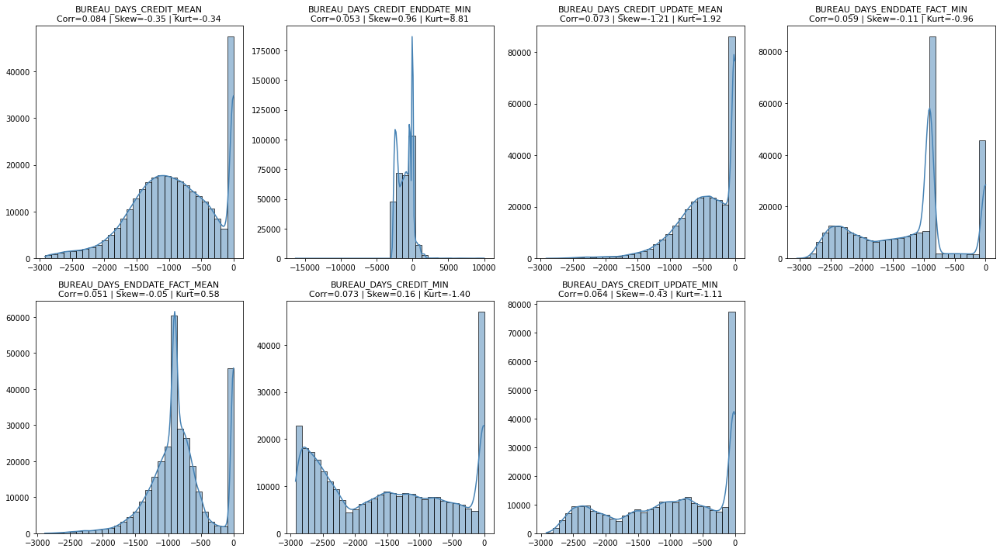

In [607]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_CREDIT_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 
            'BUREAU_DAYS_ENDDATE_FACT_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 
            'BUREAU_DAYS_CREDIT_UPDATE_MIN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

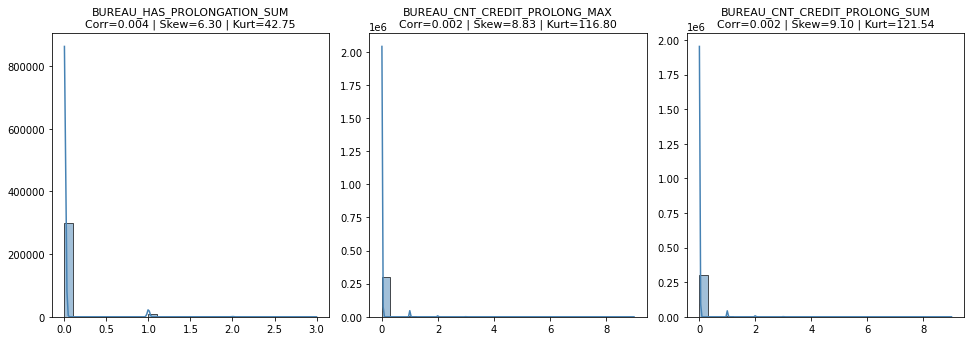

In [608]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

- On peut voir qu'il y a pas mal de variables avec des distribution très asymétrique donc on peut essayer d'améliorer cela surtout pour les modèles linéaires lorsque cela est possible.

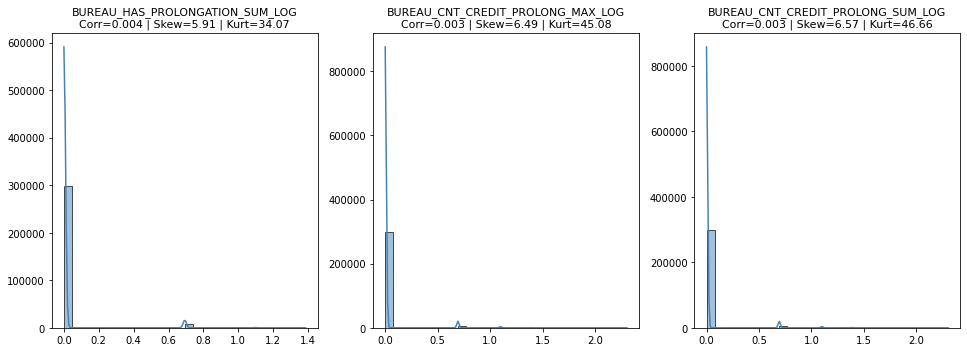

In [ ]:
df_train_median_mode_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_train_median_mode_linear['BUREAU_HAS_PROLONGATION_SUM'])
df_train_median_mode_linear['BUREAU_CNT_CREDIT_PROLONG_MAX_LOG'] = np.log1p(df_train_median_mode_linear['BUREAU_CNT_CREDIT_PROLONG_MAX'])
df_train_median_mode_linear['BUREAU_CNT_CREDIT_PROLONG_SUM_LOG'] = np.log1p(df_train_median_mode_linear['BUREAU_CNT_CREDIT_PROLONG_SUM'])

transfos = ['BUREAU_HAS_PROLONGATION_SUM_LOG', 'BUREAU_CNT_CREDIT_PROLONG_MAX_LOG', 'BUREAU_CNT_CREDIT_PROLONG_SUM_LOG']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



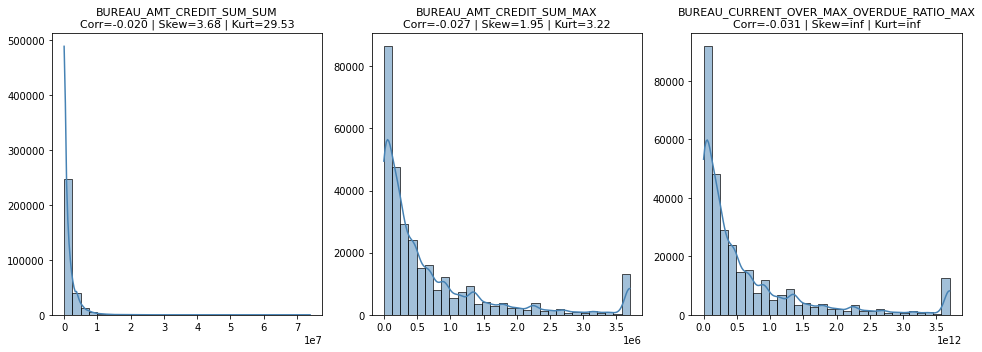

In [609]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

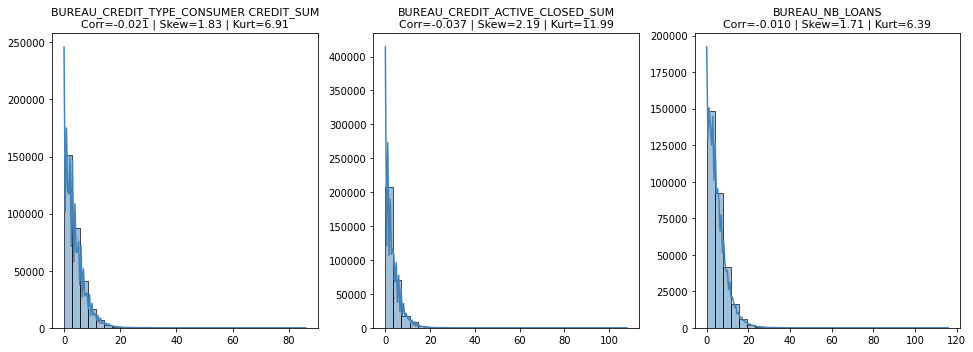

In [610]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

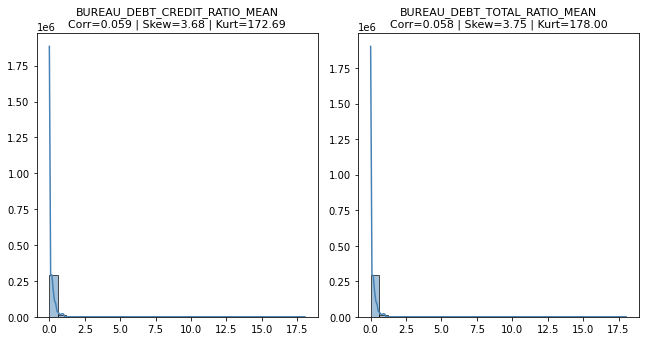

In [611]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

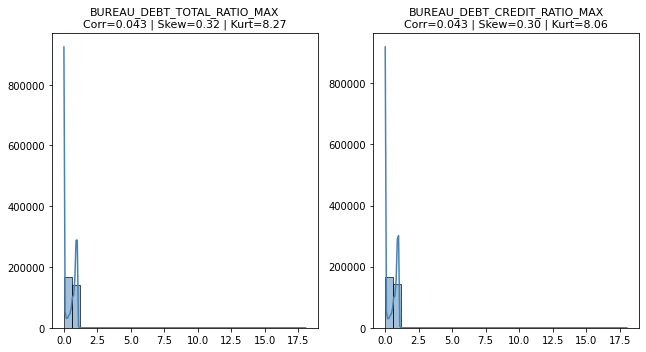

In [612]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



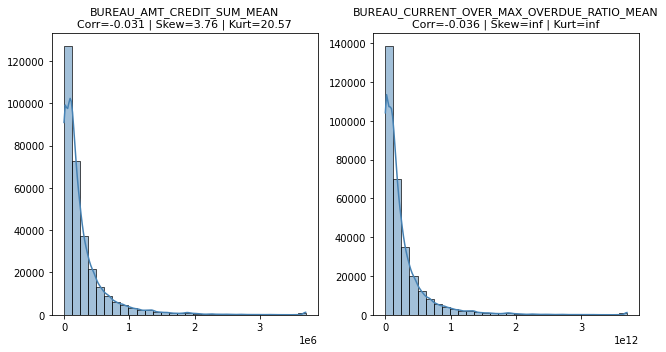

In [613]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

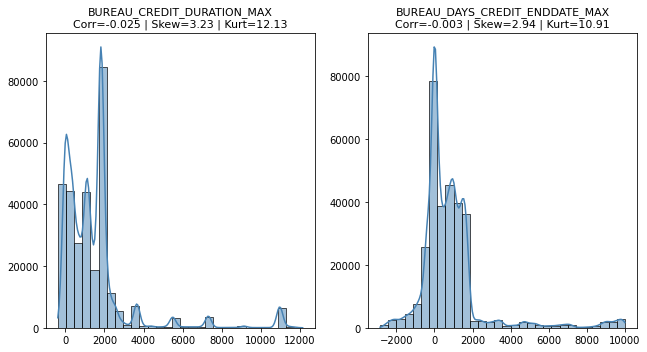

In [614]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_DURATION_MAX', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

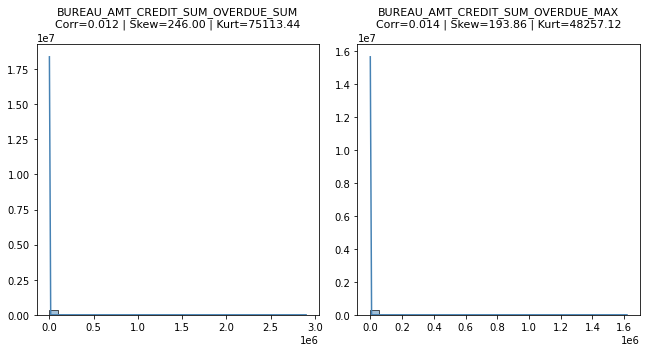

In [615]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

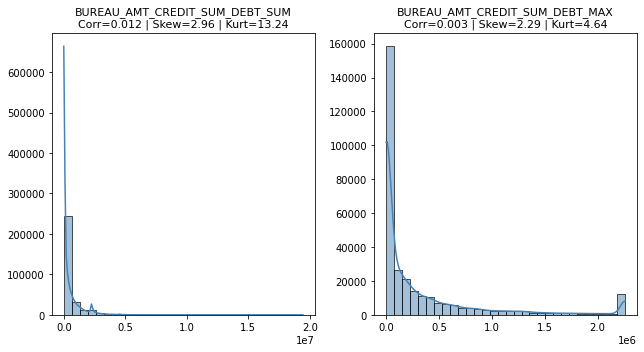

In [616]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

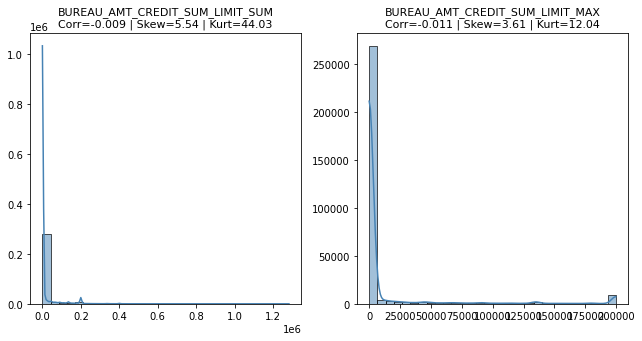

In [617]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

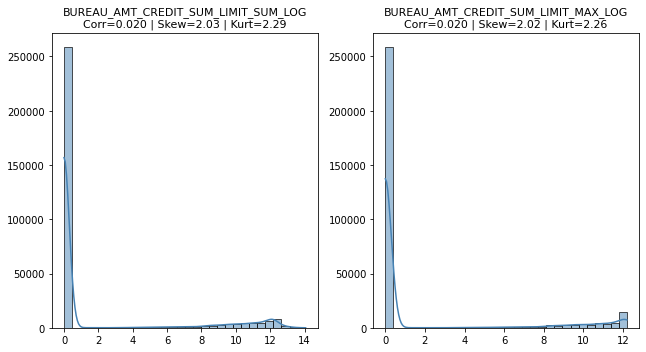

In [618]:
df_train_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG'] = np.log1p(df_train_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_SUM'])
df_train_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_train_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])

# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

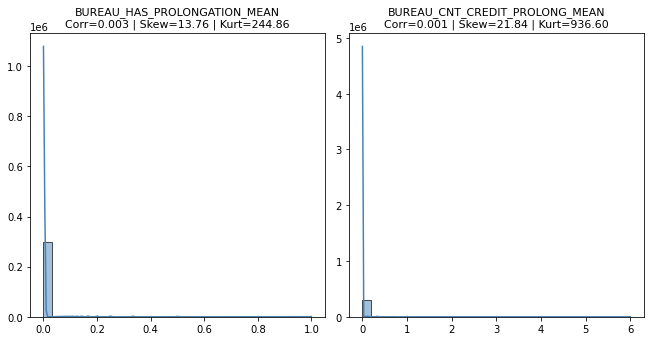

In [619]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



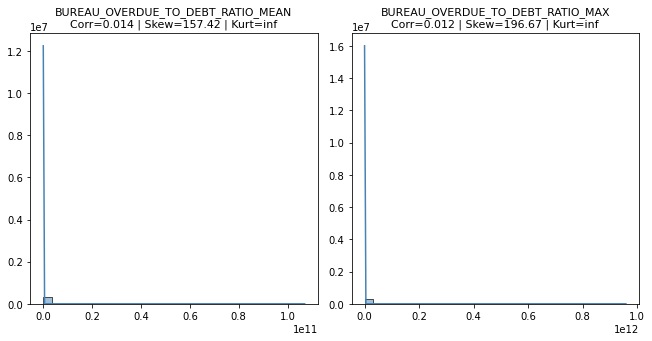

In [620]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

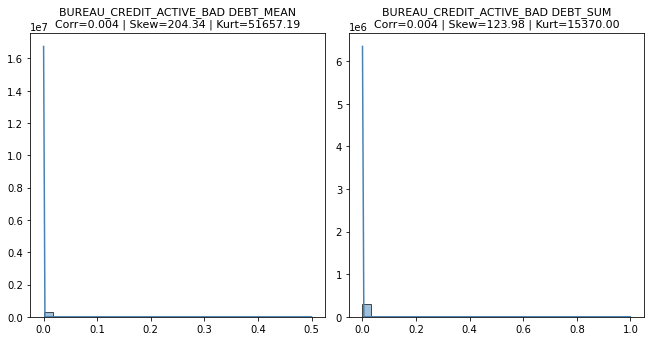

In [621]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

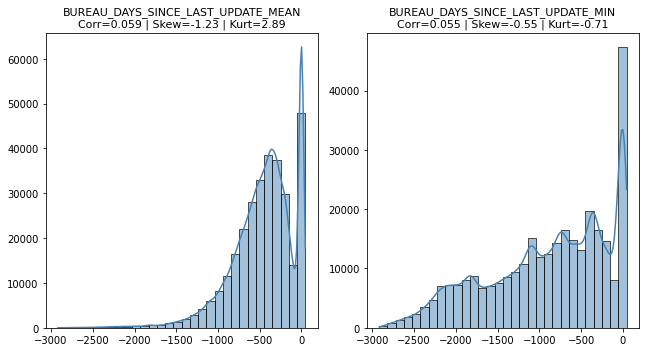

In [622]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_SINCE_LAST_UPDATE_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



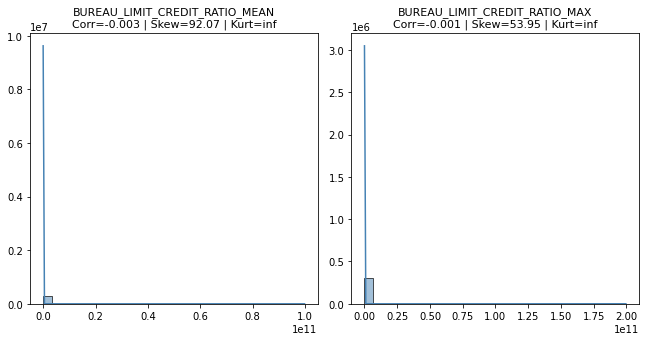

In [623]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_LIMIT_CREDIT_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [ ]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',
    'BUREAU_CNT_CREDIT_PROLONG_MAX_LOG', 'BUREAU_CNT_CREDIT_PROLONG_SUM_LOG',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX',
    
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX',
    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN',

    'BUREAU_LIMIT_CREDIT_RATIO_MEAN'

]

df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [839]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [631]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 372.52 MB
 Mémoire après : 273.98 MB
 Gain : 26.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.500000,4,0.0,0,0.0,0,0.0,0,0,10.373165
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.500000,2,0.0,0,0.0,0,0.0,0,0,12.204179
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0.250000,1,0.0,0,0.0,0,0.0,0,0,0.000000
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.000000,0,0.0,0,0.0,0,0.0,0,0,0.000000


#### Corrélation des variables - df_train_median_missing_linear

In [632]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_bureau_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_DEBT_CREDIT_RATIO_MEAN / BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_CREDIT_RATIO_MEAN,0.999078
1,BUREAU_DEBT_CREDIT_RATIO_MAX / BUREAU_DEBT_TOTAL_RATIO_MAX,BUREAU_DEBT_TOTAL_RATIO_MAX,BUREAU_DEBT_CREDIT_RATIO_MAX,0.998722
2,BUREAU_CNT_CREDIT_PROLONG_MAX / BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_MAX,0.988611
3,BUREAU_AMT_CREDIT_SUM_MAX / BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX,BUREAU_AMT_CREDIT_SUM_MAX,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX,0.976483
4,BUREAU_AMT_CREDIT_SUM_MEAN / BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN,BUREAU_AMT_CREDIT_SUM_MEAN,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN,0.968818
5,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_NB_LOANS,0.943611
6,BUREAU_CREDIT_DURATION_MAX / BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_CREDIT_DURATION_MAX,0.940186
7,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.935354
8,BUREAU_AMT_CREDIT_SUM_DEBT_MAX / BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_MAX,0.933979
9,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_NB_LOANS,0.932987


In [633]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_bureau_train_median_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [634]:
var_corr= df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [635]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_DAYS_CREDIT_MEAN,0.083939,0.087374,0.083939,0.087374,0.085656
BUREAU_DAYS_CREDIT_UPDATE_MEAN,0.073339,0.078399,0.073339,0.078399,0.075869
BUREAU_DAYS_CREDIT_MIN,0.072845,0.070928,0.072845,0.070928,0.071886
BUREAU_DAYS_CREDIT_UPDATE_MIN,0.064255,0.064979,0.064255,0.064979,0.064617
BUREAU_DAYS_ENDDATE_FACT_MIN,0.058812,0.061615,0.058812,0.061615,0.060214
BUREAU_DAYS_SINCE_LAST_UPDATE_MEAN,0.058755,0.066117,0.058755,0.066117,0.062436
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.058508,0.044673,0.058508,0.044673,0.051590
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.058094,0.044439,0.058094,0.044439,0.051267
BUREAU_DAYS_SINCE_LAST_UPDATE_MIN,0.054855,0.056477,0.054855,0.056477,0.055666
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.053361,0.059941,0.053361,0.059941,0.056651


In [636]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_DAYS_CREDIT_UPDATE_MEAN, BUREAU_DAYS_ENDDATE_FACT_MEAN, BUREAU_DAYS_CREDIT_ENDDATE_MIN, BUREAU_DAYS_CREDIT_UPDATE_MIN, BUREAU_DAYS_CREDIT_MIN, BUREAU_DAYS_ENDDATE_FACT_MIN, BUREAU_DAYS_CREDIT_MEAN]",7,0.083939,BUREAU_DAYS_CREDIT_MEAN
1,"[BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM]",3,0.004000,BUREAU_HAS_PROLONGATION_SUM
2,"[BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_SUM]",3,0.030678,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX
3,"[BUREAU_NB_LOANS, BUREAU_CREDIT_ACTIVE_CLOSED_SUM, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",3,0.037217,BUREAU_CREDIT_ACTIVE_CLOSED_SUM
4,"[BUREAU_DEBT_TOTAL_RATIO_MEAN, BUREAU_DEBT_CREDIT_RATIO_MEAN]",2,0.058508,BUREAU_DEBT_CREDIT_RATIO_MEAN
5,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.042873,BUREAU_DEBT_CREDIT_RATIO_MAX
6,"[BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN, BUREAU_AMT_CREDIT_SUM_MEAN]",2,0.036083,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN
7,"[BUREAU_DAYS_CREDIT_ENDDATE_MAX, BUREAU_CREDIT_DURATION_MAX]",2,0.025358,BUREAU_CREDIT_DURATION_MAX
8,"[BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM]",2,0.013753,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX
9,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX]",2,0.012473,BUREAU_AMT_CREDIT_SUM_DEBT_SUM


In [637]:
pd.reset_option('display.max_colwidth')

- On retrouve les mêmes corrélations pour ce dataframe.

In [ ]:
# Création des variables précédentes que l'on a garder.

df_train_median_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_train_median_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_train_median_missing_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_train_median_missing_linear['BUREAU_HAS_PROLONGATION_SUM'])

In [ ]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',
    'BUREAU_CNT_CREDIT_PROLONG_MAX_LOG', 'BUREAU_CNT_CREDIT_PROLONG_SUM_LOG',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX',
    
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX',
    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN',

    'BUREAU_LIMIT_CREDIT_RATIO_MEAN'

]

df_train_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [647]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [641]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 314.95 MB
 Mémoire après : 276.24 MB
 Gain : 12.3%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,4,0.500000,4,0.0,0,0.0,0,0.0,0,0
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,2,0.500000,2,0.0,0,0.0,0,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,2,0.000000,0,0.0,0,0.0,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,1,0.000000,0,0.0,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,3,0.250000,1,0.0,0,0.0,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,1,0.000000,0,0.0,0,0.0,0,0.0,0,0


#### Corrélation des variables - df_train_iterative_mode_linear

In [648]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_bureau_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_CNT_CREDIT_PROLONG_MAX / BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_MAX,0.988611
1,BUREAU_CREDIT_DURATION_MAX / BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_CREDIT_DURATION_MAX,0.946588
2,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_NB_LOANS,0.943611
3,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.935392
4,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_NB_LOANS,0.932987
5,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,0.929096
6,BUREAU_DEBT_CREDIT_RATIO_MEAN / BUREAU_LIMIT_CREDIT_RATIO_MEAN,BUREAU_DEBT_CREDIT_RATIO_MEAN,BUREAU_LIMIT_CREDIT_RATIO_MEAN,0.920944
7,BUREAU_CNT_CREDIT_PROLONG_SUM / BUREAU_HAS_PROLONGATION_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_HAS_PROLONGATION_SUM,0.915278
8,BUREAU_CNT_CREDIT_PROLONG_MEAN / BUREAU_HAS_PROLONGATION_MEAN,BUREAU_CNT_CREDIT_PROLONG_MEAN,BUREAU_HAS_PROLONGATION_MEAN,0.911631
9,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX / BUREAU_AMT_CREDIT_SUM_LIMIT_SUM,BUREAU_AMT_CREDIT_SUM_LIMIT_SUM,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX,0.901428


In [649]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_bureau_train_iterative_mode_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [650]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [651]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_DAYS_CREDIT_MEAN,0.083939,0.087374,0.083939,0.087374,0.085656
BUREAU_DAYS_ENDDATE_FACT_MEAN,0.074498,0.086367,0.074498,0.086367,0.080432
BUREAU_DAYS_CREDIT_UPDATE_MEAN,0.073348,0.078414,0.073348,0.078414,0.075881
BUREAU_DAYS_CREDIT_MIN,0.072845,0.070928,0.072845,0.070928,0.071886
BUREAU_DAYS_ENDDATE_FACT_MIN,0.067383,0.069500,0.067383,0.069500,0.068441
BUREAU_DAYS_CREDIT_UPDATE_MIN,0.064261,0.064989,0.064261,0.064989,0.064625
BUREAU_DAYS_SINCE_LAST_UPDATE_MEAN,0.058744,0.066105,0.058744,0.066105,0.062425
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.056094,0.064426,0.056094,0.064426,0.060260
BUREAU_DAYS_SINCE_LAST_UPDATE_MIN,0.054841,0.056461,0.054841,0.056461,0.055651
BUREAU_AMT_CREDIT_SUM_DEBT_SUM,0.019676,0.030075,0.019676,0.030075,0.024876


In [652]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_DAYS_CREDIT_UPDATE_MEAN, BUREAU_DAYS_ENDDATE_FACT_MEAN, BUREAU_DAYS_CREDIT_ENDDATE_MIN, BUREAU_DAYS_CREDIT_UPDATE_MIN, BUREAU_DAYS_CREDIT_MIN, BUREAU_DAYS_ENDDATE_FACT_MIN, BUREAU_DAYS_CREDIT_MEAN]",7,0.083939,BUREAU_DAYS_CREDIT_MEAN
1,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_SUM, BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_AMT_CREDIT_SUM_DEBT_MAX]",4,0.027107,BUREAU_AMT_CREDIT_SUM_MAX
2,"[BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM]",3,0.004000,BUREAU_HAS_PROLONGATION_SUM
3,"[BUREAU_NB_LOANS, BUREAU_CREDIT_ACTIVE_CLOSED_SUM, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",3,0.037217,BUREAU_CREDIT_ACTIVE_CLOSED_SUM
4,"[BUREAU_DAYS_CREDIT_ENDDATE_MAX, BUREAU_CREDIT_DURATION_MAX]",2,0.026409,BUREAU_CREDIT_DURATION_MAX
5,"[BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM]",2,0.013852,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX
6,"[BUREAU_LIMIT_CREDIT_RATIO_MEAN, BUREAU_DEBT_CREDIT_RATIO_MEAN]",2,0.004587,BUREAU_LIMIT_CREDIT_RATIO_MEAN
7,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_MEAN]",2,0.002772,BUREAU_HAS_PROLONGATION_MEAN
8,"[BUREAU_AMT_CREDIT_SUM_LIMIT_SUM, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",2,0.015960,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX
9,"[BUREAU_LIMIT_CREDIT_RATIO_MAX, BUREAU_DEBT_CREDIT_RATIO_MAX]",2,0.006460,BUREAU_LIMIT_CREDIT_RATIO_MAX


In [653]:
pd.reset_option('display.max_colwidth')

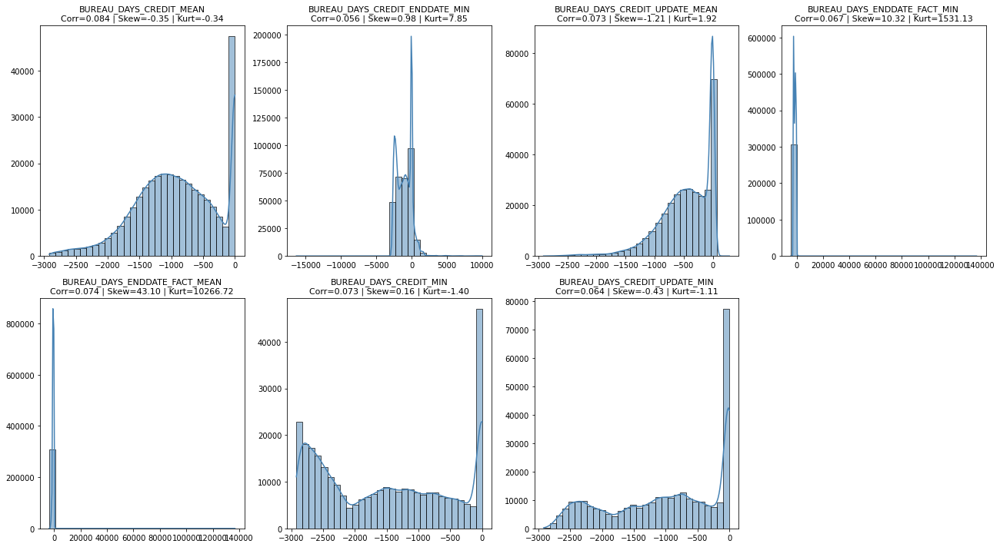

In [654]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_CREDIT_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 
            'BUREAU_DAYS_ENDDATE_FACT_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 
            'BUREAU_DAYS_CREDIT_UPDATE_MIN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

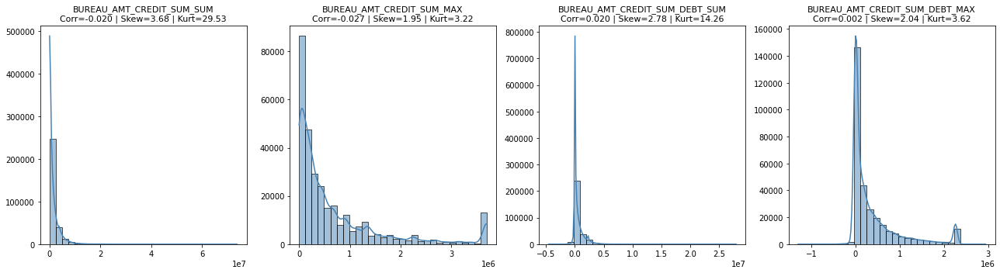

In [655]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 
            'BUREAU_AMT_CREDIT_SUM_DEBT_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

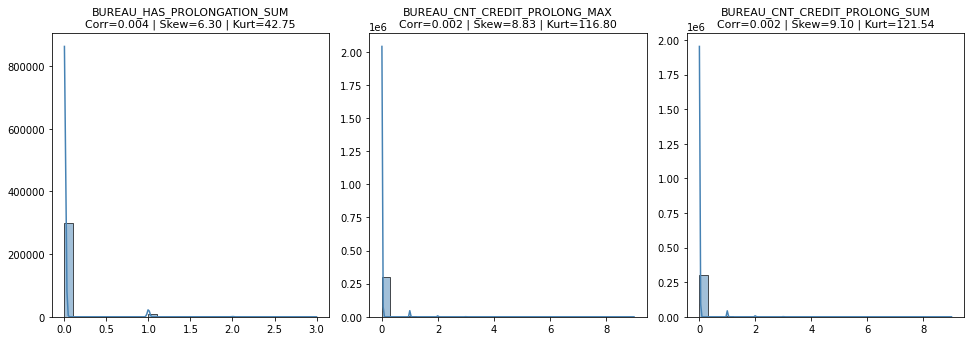

In [656]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

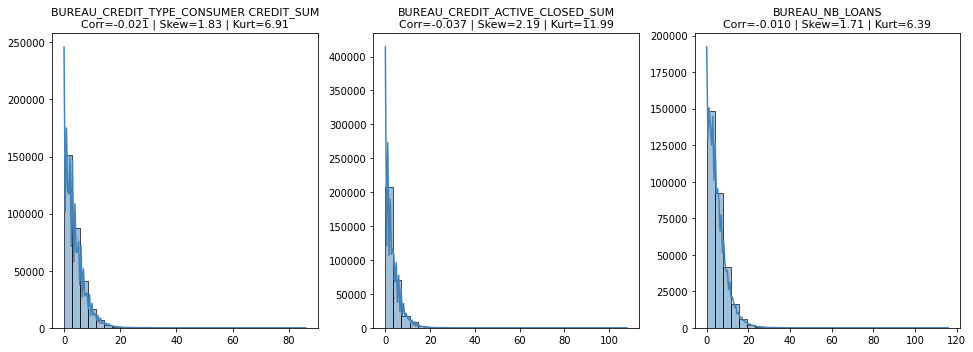

In [657]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

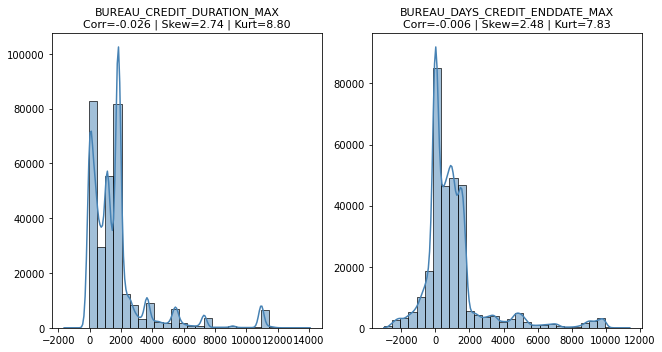

In [658]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_DURATION_MAX', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

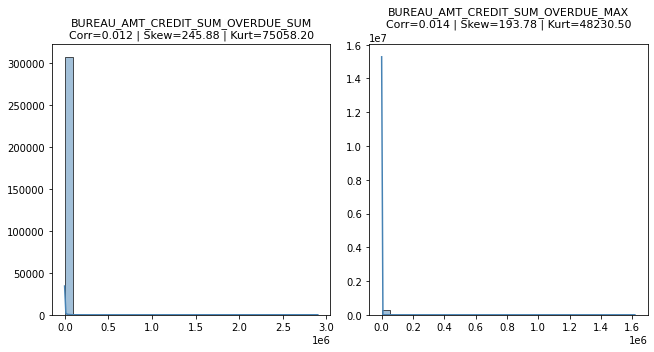

In [659]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



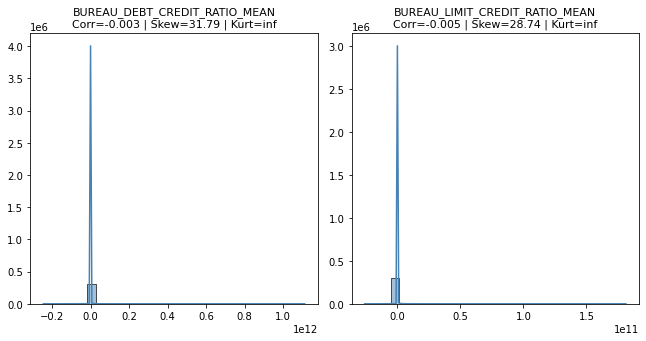

In [661]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

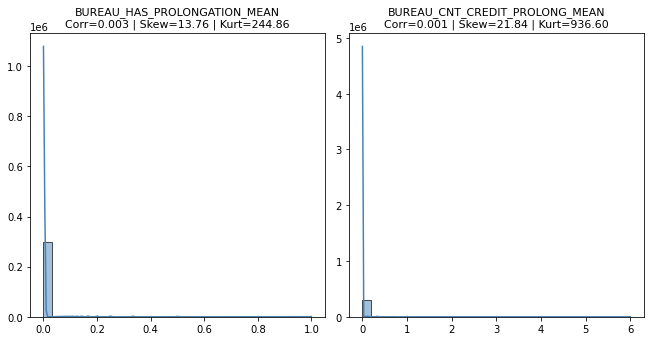

In [663]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

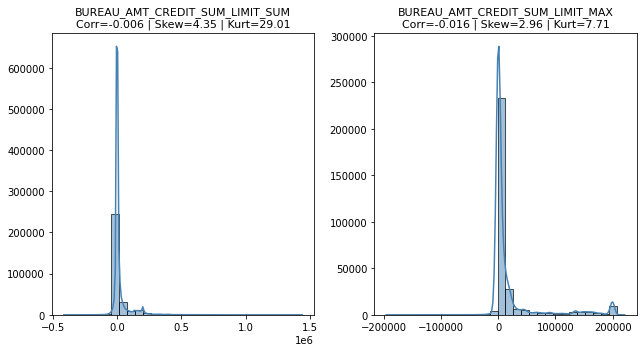

In [664]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



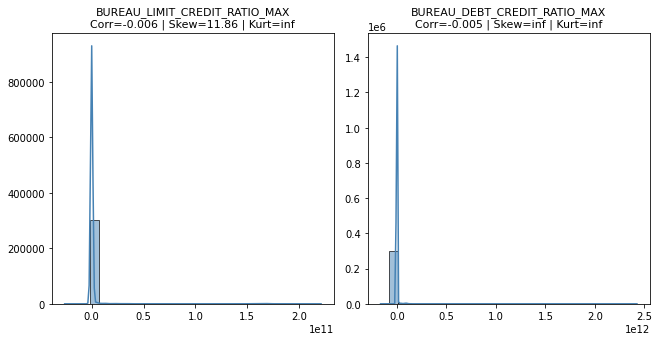

In [665]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

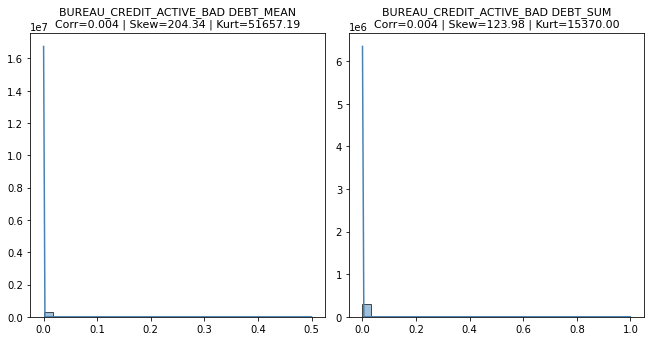

In [666]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

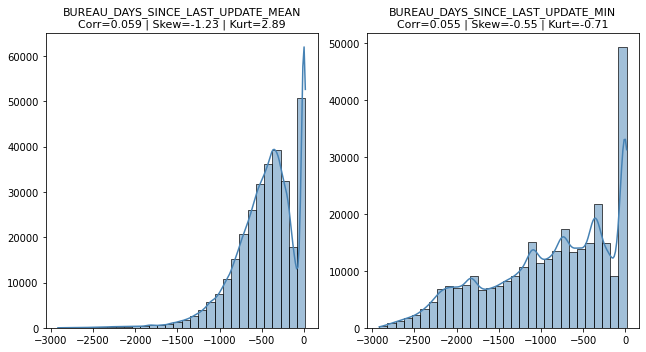

In [667]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_SINCE_LAST_UPDATE_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN']

plot_transformations_distributions(
    df=df_train_iterative_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [855]:
# Création des variables précédentes que l'on a garder.

df_train_iterative_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_train_iterative_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_train_iterative_mode_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_train_iterative_mode_linear['BUREAU_HAS_PROLONGATION_SUM'])

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning:

invalid value encountered in log1p



In [ ]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS',

    'BUREAU_DAYS_CREDIT_ENDDATE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX',

    'BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM',

    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN']

df_train_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [856]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [671]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 316.21 MB
 Mémoire après : 279.85 MB
 Gain : 11.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,4,0.500000,4,0.0,0,0.0,0,0.0,0,0
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,2,0.500000,2,0.0,0,0.0,0,0.0,0,0
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,2,0.000000,0,0.0,0,0.0,0,0.0,0,0
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,1,0.000000,0,0.0,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,3,0.250000,1,0.0,0,0.0,0,0.0,0,0
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,1,0.000000,0,0.0,0,0.0,0,0.0,0,0


#### Corrélation des variables - df_train_nan_missing_linear

In [672]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_bureau_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_CNT_CREDIT_PROLONG_MAX / BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_MAX,0.988567
1,BUREAU_CREDIT_DURATION_MAX / BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_DAYS_CREDIT_ENDDATE_MAX,BUREAU_CREDIT_DURATION_MAX,0.946808
2,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.935352
3,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_NB_LOANS,0.932383
4,BUREAU_AMT_CREDIT_SUM_DEBT_MAX / BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT_MAX,0.929328
5,BUREAU_DEBT_CREDIT_RATIO_MEAN / BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_CREDIT_RATIO_MEAN,0.927290
6,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_NB_LOANS,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_NB_LOANS,0.923680
7,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX / BUREAU_AMT_CREDIT_SUM_LIMIT_SUM,BUREAU_AMT_CREDIT_SUM_LIMIT_SUM,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX,0.920554
8,BUREAU_CREDIT_ACTIVE_CLOSED_SUM / BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_CREDIT_ACTIVE_CLOSED_SUM,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,0.917932
9,BUREAU_CNT_CREDIT_PROLONG_SUM / BUREAU_HAS_PROLONGATION_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_HAS_PROLONGATION_SUM,0.914938


In [673]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_bureau_train_nan_missing_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [674]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [675]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ['TARGET']], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.091609,0.084184,0.091609,0.084184,0.087896
BUREAU_DAYS_CREDIT_MEAN,0.089732,0.095299,0.089732,0.095299,0.092516
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.088175,0.081266,0.088175,0.081266,0.084721
BUREAU_DAYS_CREDIT_MIN,0.075251,0.072485,0.075251,0.072485,0.073868
BUREAU_DEBT_TOTAL_RATIO_MAX,0.074597,0.082767,0.074597,0.082767,0.078682
BUREAU_DEBT_CREDIT_RATIO_MAX,0.073587,0.086205,0.073587,0.086205,0.079896
BUREAU_DAYS_CREDIT_UPDATE_MIN,0.062186,0.064247,0.062186,0.064247,0.063217
BUREAU_DAYS_ENDDATE_FACT_MIN,0.056152,0.055682,0.056152,0.055682,0.055917
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.053715,0.060949,0.053715,0.060949,0.057332
BUREAU_DAYS_ENDDATE_FACT_MEAN,0.053212,0.057402,0.053212,0.057402,0.055307


In [676]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_DAYS_ENDDATE_FACT_MEAN, BUREAU_DAYS_CREDIT_ENDDATE_MIN, BUREAU_DAYS_CREDIT_UPDATE_MIN, BUREAU_DAYS_CREDIT_MIN, BUREAU_DAYS_ENDDATE_FACT_MIN, BUREAU_DAYS_CREDIT_MEAN]",6,0.089732,BUREAU_DAYS_CREDIT_MEAN
1,"[BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM]",3,0.006716,BUREAU_HAS_PROLONGATION_SUM
2,"[BUREAU_NB_LOANS, BUREAU_CREDIT_ACTIVE_CLOSED_SUM, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",3,0.030813,BUREAU_CREDIT_ACTIVE_CLOSED_SUM
3,"[BUREAU_DAYS_CREDIT_ENDDATE_MAX, BUREAU_CREDIT_DURATION_MAX]",2,0.014630,BUREAU_CREDIT_DURATION_MAX
4,"[BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM]",2,0.015360,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX
5,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX]",2,0.022035,BUREAU_AMT_CREDIT_SUM_DEBT_SUM
6,"[BUREAU_DEBT_TOTAL_RATIO_MEAN, BUREAU_DEBT_CREDIT_RATIO_MEAN]",2,0.091609,BUREAU_DEBT_CREDIT_RATIO_MEAN
7,"[BUREAU_AMT_CREDIT_SUM_LIMIT_SUM, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",2,0.007827,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX
8,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_MEAN]",2,0.004746,BUREAU_HAS_PROLONGATION_MEAN
9,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.074597,BUREAU_DEBT_TOTAL_RATIO_MAX


In [677]:
pd.reset_option('display.max_colwidth') 

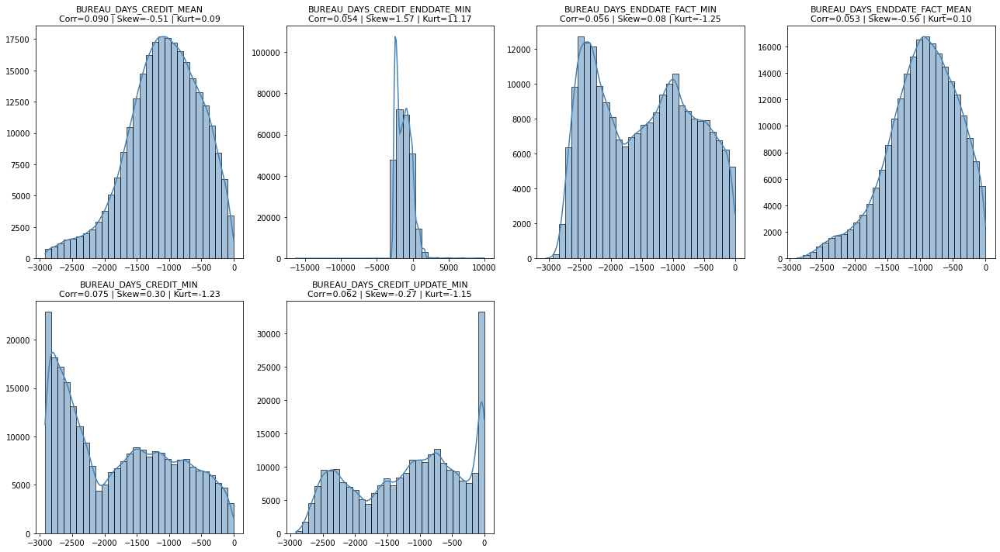

In [678]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_CREDIT_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
            'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 
            'BUREAU_DAYS_CREDIT_UPDATE_MIN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

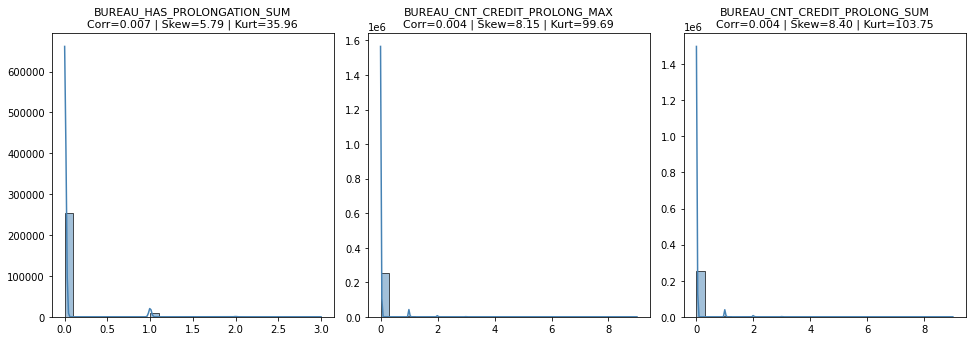

In [679]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

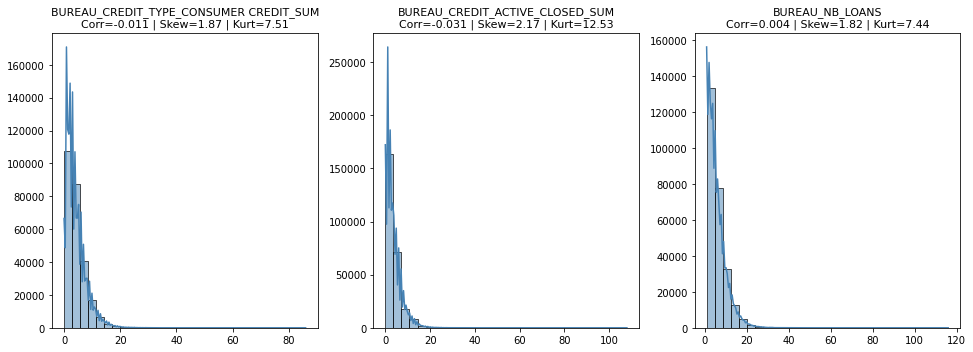

In [680]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

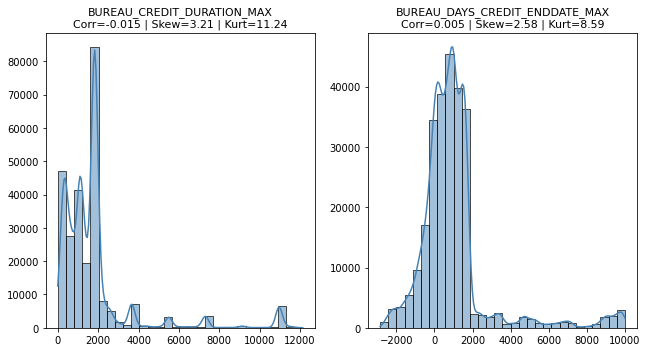

In [681]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_DURATION_MAX', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

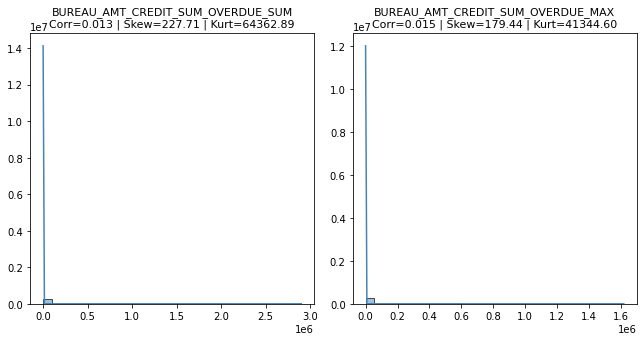

In [682]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

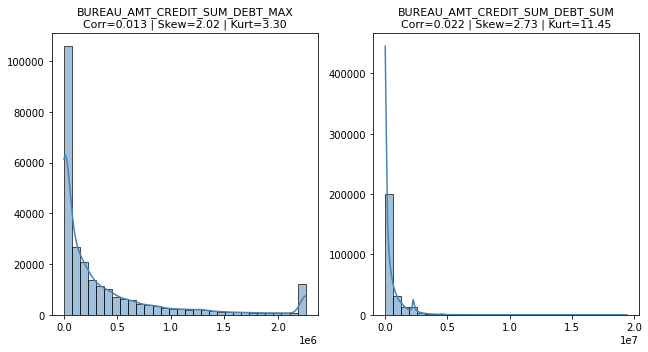

In [683]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

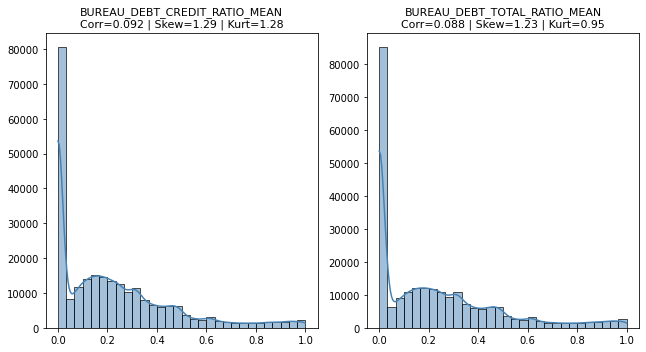

In [684]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

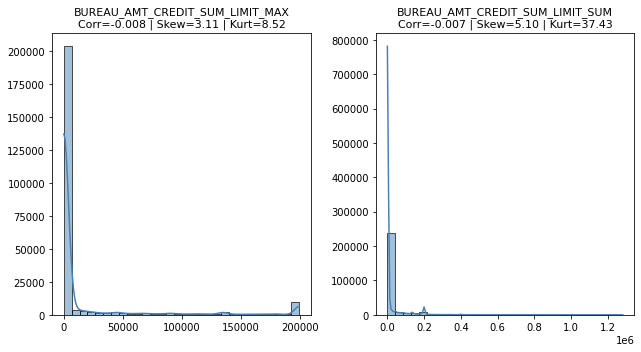

In [685]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

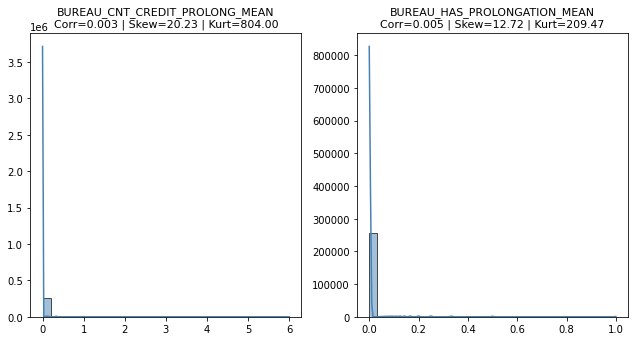

In [686]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_HAS_PROLONGATION_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

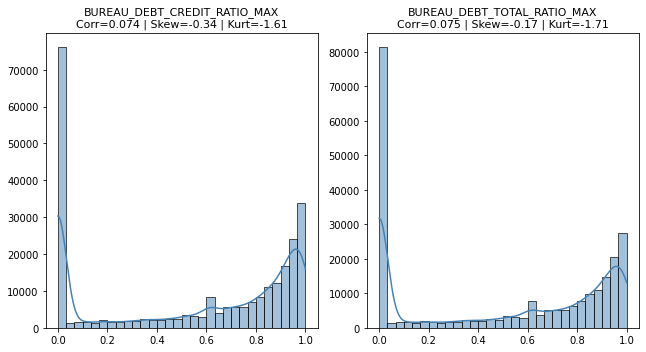

In [687]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_TOTAL_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

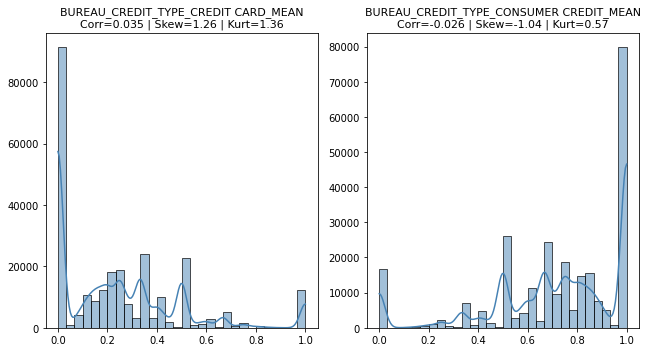

In [688]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN', 'BUREAU_CREDIT_TYPE_CONSUMER CREDIT_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



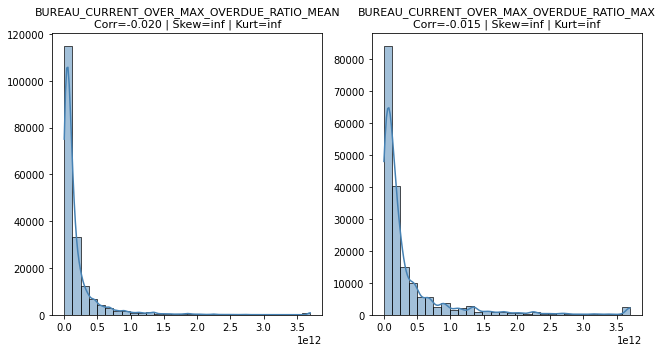

In [689]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

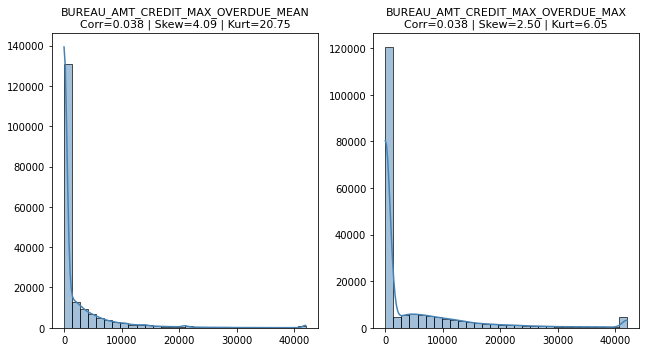

In [690]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

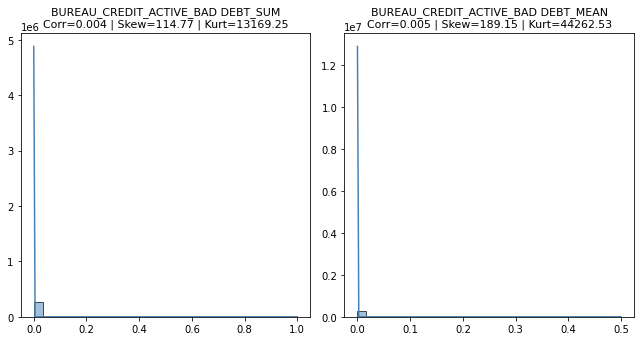

In [691]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

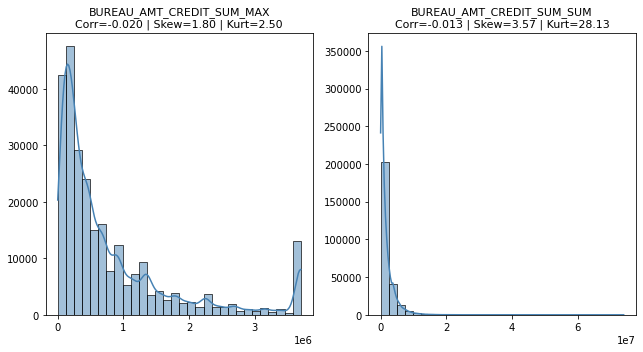

In [692]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

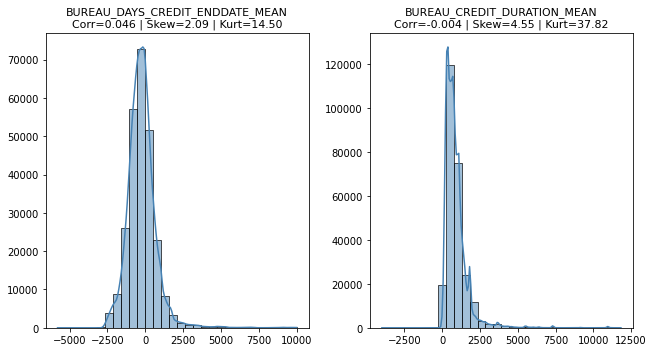

In [693]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_MEAN', 'BUREAU_CREDIT_DURATION_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

In [696]:
# Création des variables précédentes que l'on a garder.

df_train_nan_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_train_nan_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_train_nan_missing_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_train_nan_missing_linear['BUREAU_HAS_PROLONGATION_SUM'])

In [ ]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_HAS_PROLONGATION_SUM',

    'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS',

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',
    'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_CREDIT_TYPE_CONSUMER CREDIT_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM',

    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN', 'BUREAU_CREDIT_DURATION_MEAN']

df_train_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [700]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [701]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 322.86 MB
 Mémoire après : 295.88 MB
 Gain : 8.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG,BUREAU_HAS_PROLONGATION_SUM_LOG
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,4,0.0,0,0.0,0,0.0,0,0,10.373165,0.000000
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,2,0.0,0,0.0,0,0.0,0,0,12.204179,0.000000
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.000000
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,<NA>,NaN,<NA>,NaN,<NA>,NaN,<NA>,<NA>,NaN,NaN
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,<NA>,NaN,<NA>,NaN,<NA>,NaN,<NA>,<NA>,NaN,NaN
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,<NA>,NaN,<NA>,NaN,<NA>,NaN,<NA>,<NA>,NaN,NaN
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,1,0.0,0,0.0,0,0.0,0,0,0.000000,0.000000
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,0,0.0,0,0.0,0,0.0,0,0,NaN,0.000000


#### Corrélation des variables - df_train_median_mode

In [702]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode[df_bureau_train_median_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,1.000000
1,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN / BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN,BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,1.000000
2,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,1.000000
3,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN / BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,1.000000
4,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX / BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,1.000000
5,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.999999
6,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,0.999999
7,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,0.999998
8,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.999998
9,BUREAU_CREDIT_CURRENCY_MEAN / BUREAU_CREDIT_CURRENCY_SUM,BUREAU_CREDIT_CURRENCY_MEAN,BUREAU_CREDIT_CURRENCY_SUM,0.999998


In [703]:
df_corr = get_correlation_pairs(df_train_median_mode[df_bureau_train_median_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [704]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [705]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_DEBT_CREDIT_RATIO_MAX,0.068641,0.080648,0.068641,0.080648,0.003683,0.138017
BUREAU_DEBT_TOTAL_RATIO_MAX,0.068309,0.079254,0.068309,0.079254,0.004176,0.147818
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN,0.077793,0.078569,0.077793,0.078569,0.006568,0.202182
BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN,0.077357,0.078135,0.077357,0.078135,0.006049,0.190806
BUREAU_PCT_ACTIVE,0.077357,0.078135,0.077357,0.078135,0.006346,0.197128
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.078547,0.073488,0.078547,0.073488,0.002288,0.109467
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.077991,0.073169,0.077991,0.073169,0.002266,0.108646
BUREAU_DAYS_ENDDATE_FACT_MIN,0.056083,0.059655,0.056083,0.059655,0.006318,0.180623
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.049499,0.058652,0.049499,0.058652,0.003564,0.119033
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM,0.067371,0.057264,0.067371,0.057264,0.008757,0.236030


In [706]:
pd.reset_option('display.max_rows')

In [707]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX, BUREAU_OVERDUE_TO_DEBT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM, BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN, BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN, BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN]",7,0.025803,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX
1,"[BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_SUM, BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_AMT_CREDIT_SUM_MEAN, BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN]",5,0.031626,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN
2,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM, BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_MEAN]",5,0.006716,BUREAU_HAS_PROLONGATION_SUM
3,"[BUREAU_LIMIT_CREDIT_RATIO_MEAN, BUREAU_LIMIT_CREDIT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_LIMIT_SUM, BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",5,0.009011,BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN
4,"[BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN, BUREAU_PCT_ACTIVE, BUREAU_CREDIT_ACTIVE_CLOSED_MEAN, BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN]",4,0.079371,BUREAU_CREDIT_ACTIVE_CLOSED_MEAN
5,"[BUREAU_CREDIT_DAY_OVERDUE_MEAN, BUREAU_CREDIT_DAY_OVERDUE_MAX, BUREAU_NB_OVERDUE]",3,0.042019,BUREAU_NB_OVERDUE
6,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX, BUREAU_AMT_CREDIT_SUM_DEBT_MEAN]",3,0.022035,BUREAU_AMT_CREDIT_SUM_DEBT_SUM
7,"[BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM, BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN]",2,0.000977,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM
8,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.068641,BUREAU_DEBT_CREDIT_RATIO_MAX
9,"[BUREAU_NB_LOANS, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",2,0.010707,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM


In [708]:
pd.reset_option('display.max_colwidth')

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



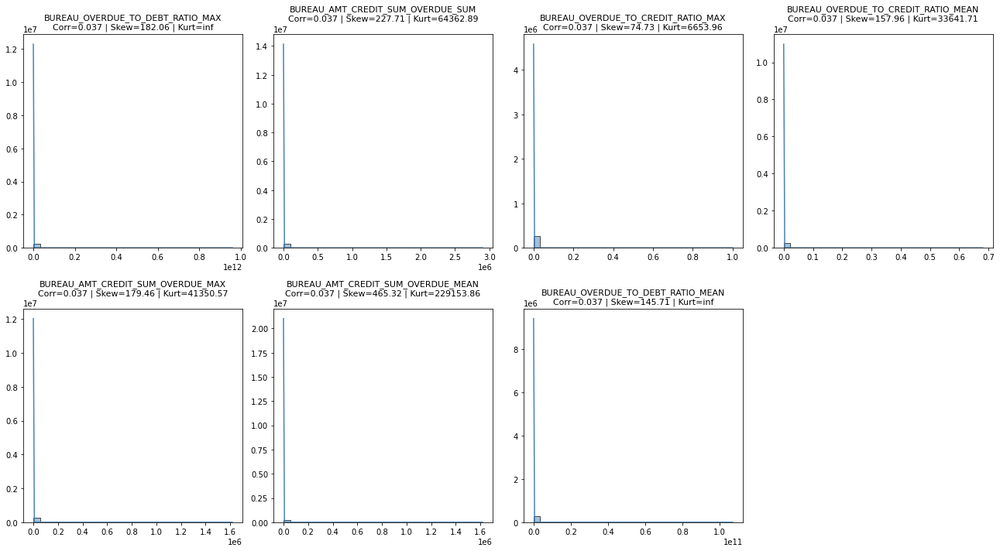

In [709]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 
            'BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
            'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



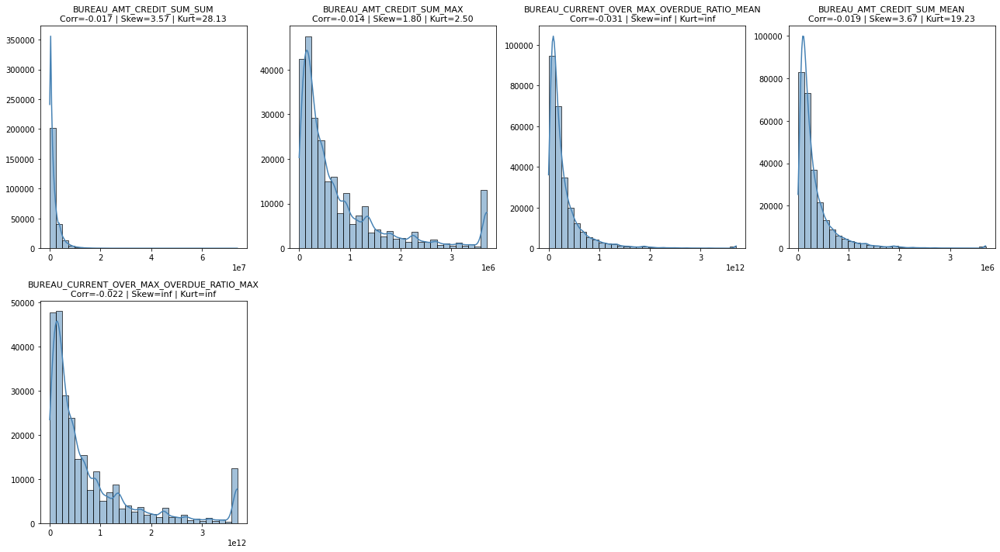

In [710]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 
            'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_AMT_CREDIT_SUM_MEAN', 
            'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

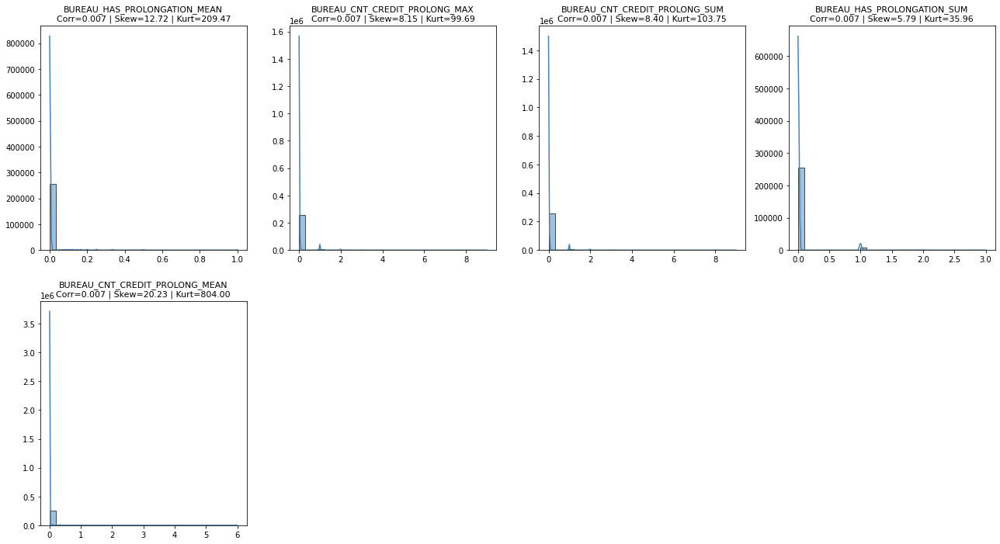

In [711]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 
            'BUREAU_CNT_CREDIT_PROLONG_SUM', 'BUREAU_HAS_PROLONGATION_SUM', 
            'BUREAU_CNT_CREDIT_PROLONG_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



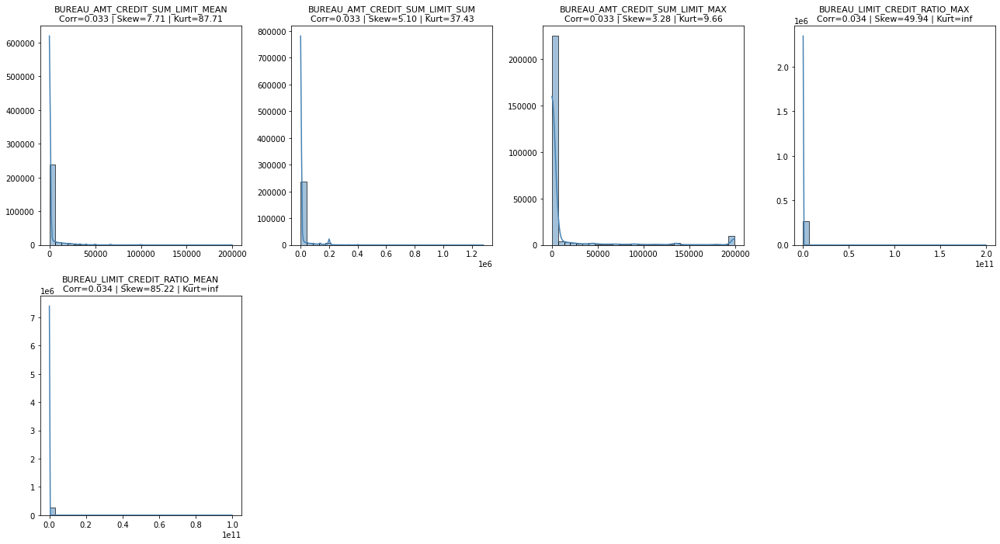

In [712]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 
            'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
            'BUREAU_LIMIT_CREDIT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

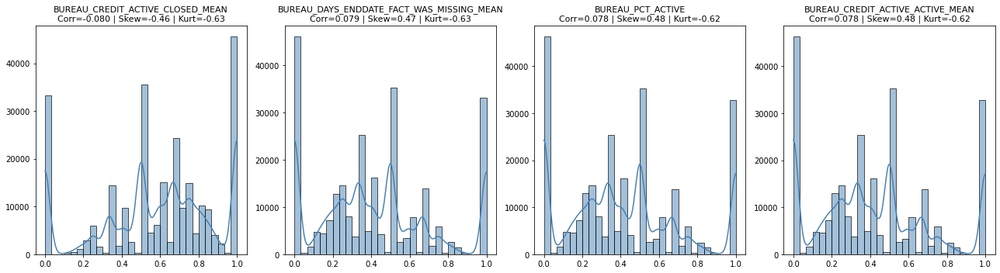

In [713]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_CLOSED_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 
            'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

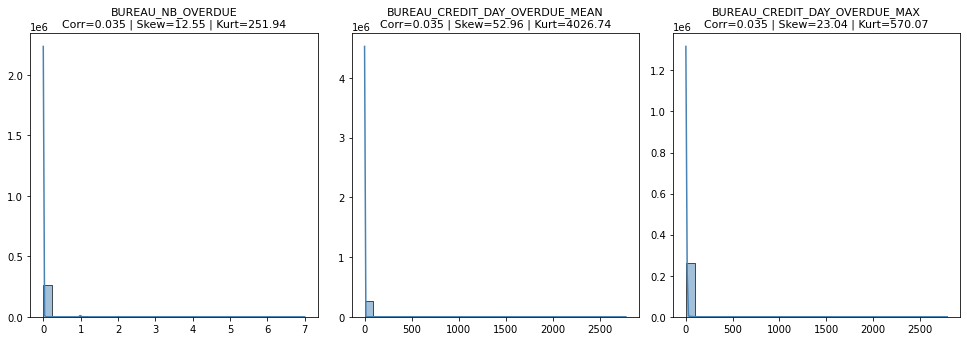

In [714]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_NB_OVERDUE', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 
            'BUREAU_CREDIT_DAY_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

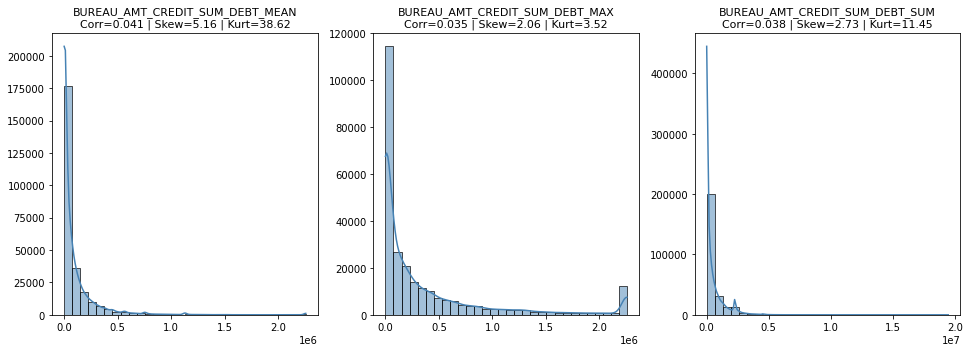

In [715]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 
            'BUREAU_AMT_CREDIT_SUM_DEBT_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

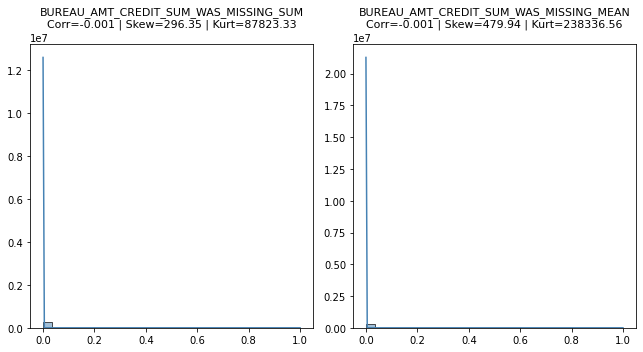

In [716]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

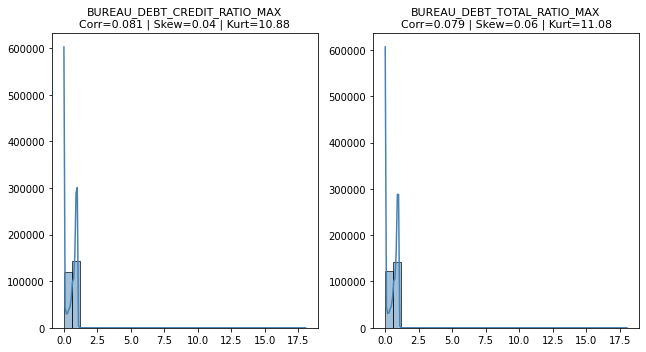

In [717]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_TOTAL_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

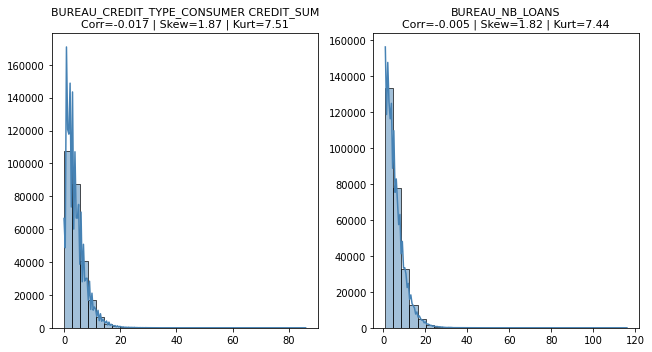

In [718]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

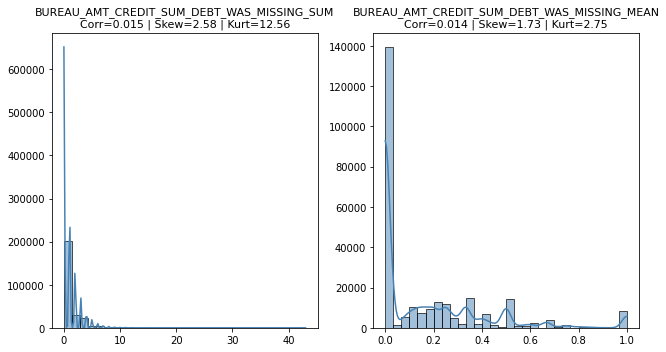

In [719]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

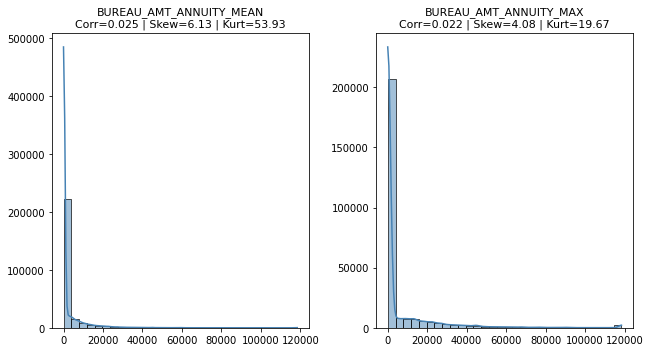

In [720]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_ANNUITY_MEAN', 'BUREAU_AMT_ANNUITY_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

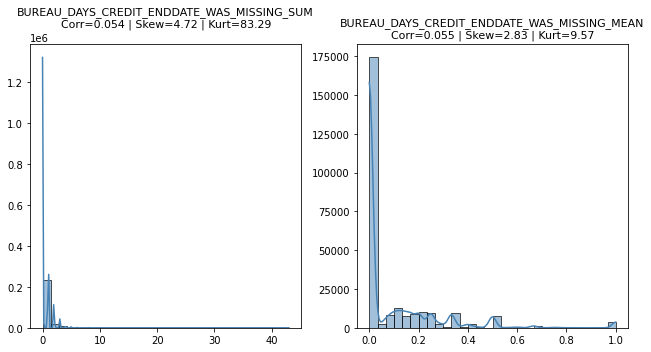

In [721]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

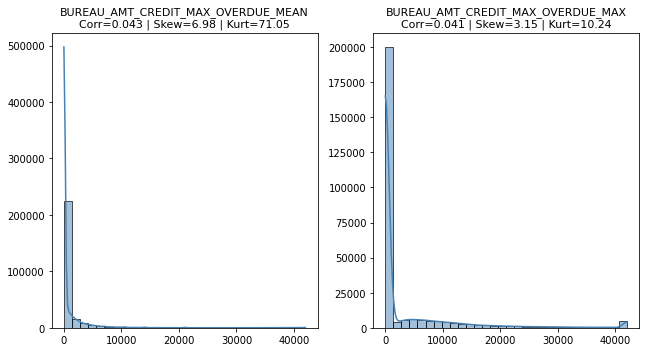

In [722]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

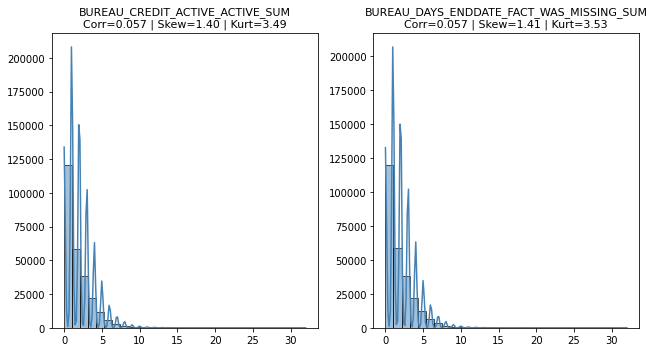

In [723]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_ACTIVE_SUM', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

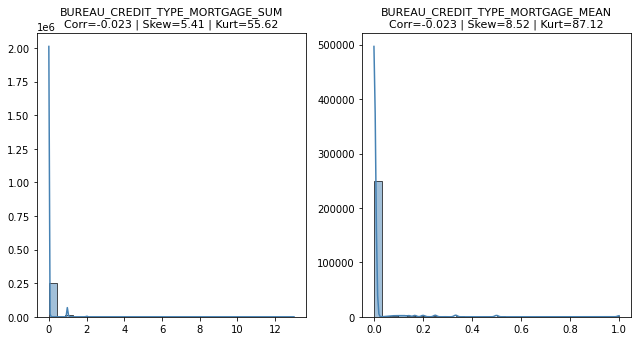

In [724]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MORTGAGE_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

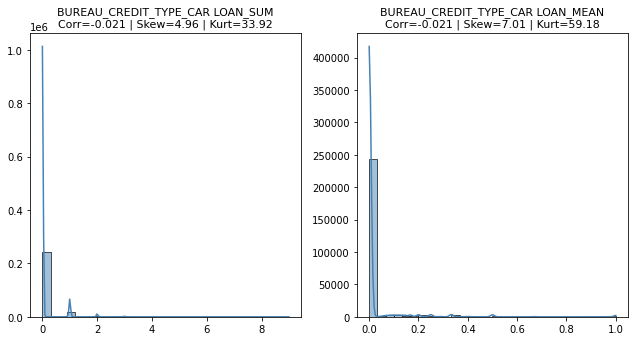

In [725]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CAR LOAN_SUM', 'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

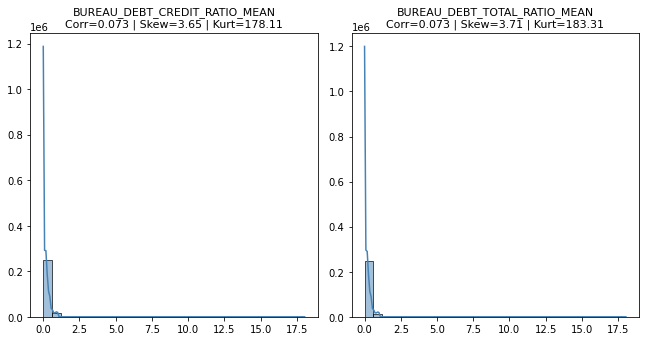

In [726]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

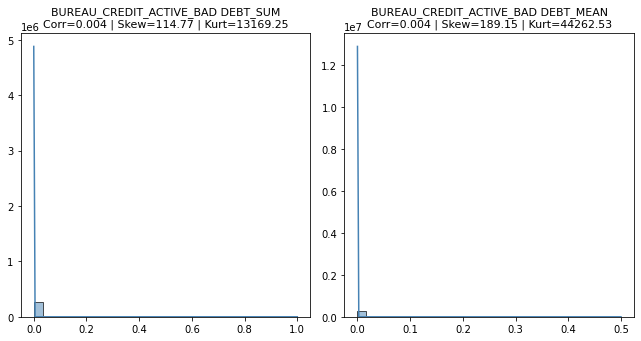

In [727]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

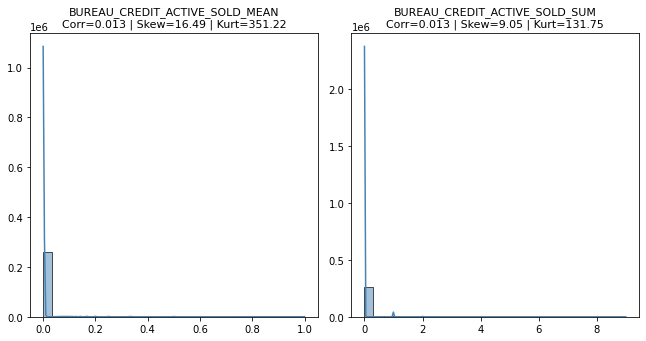

In [728]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_SOLD_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

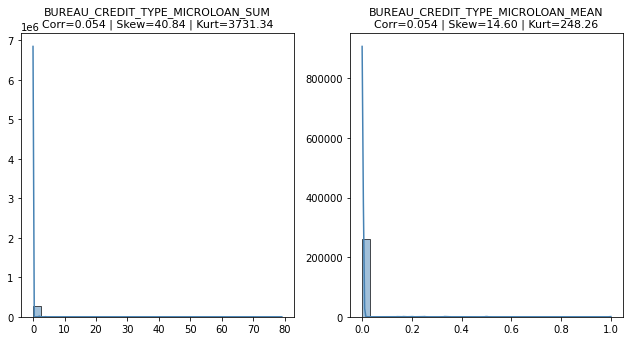

In [729]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

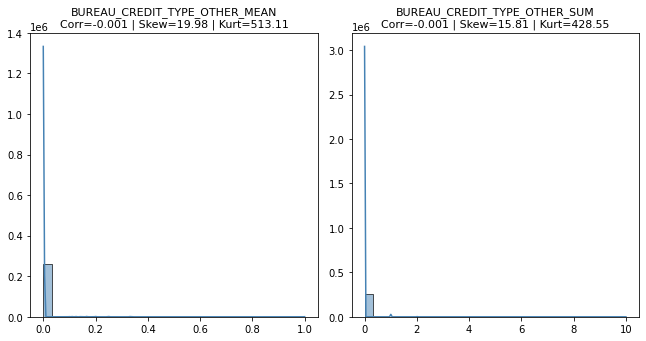

In [730]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_CREDIT_TYPE_OTHER_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

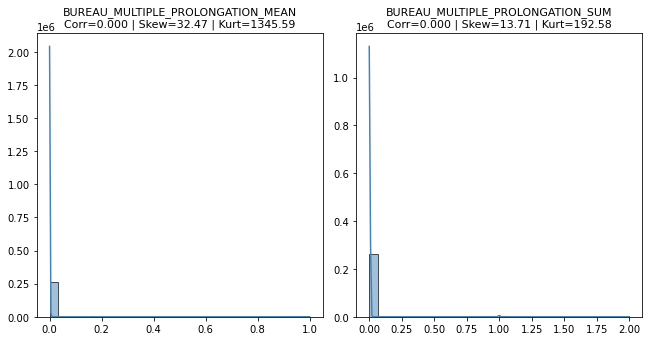

In [731]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_MULTIPLE_PROLONGATION_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

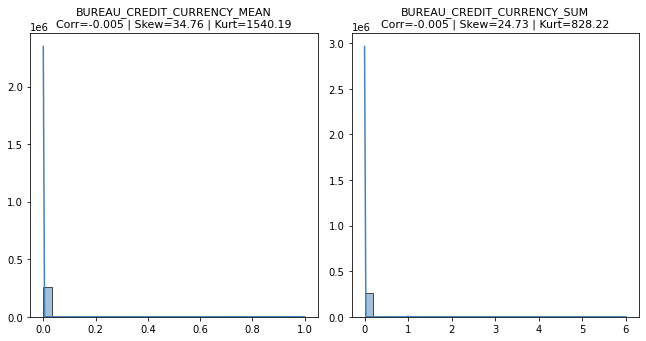

In [732]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_CREDIT_CURRENCY_MEAN', 'BUREAU_CREDIT_CURRENCY_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

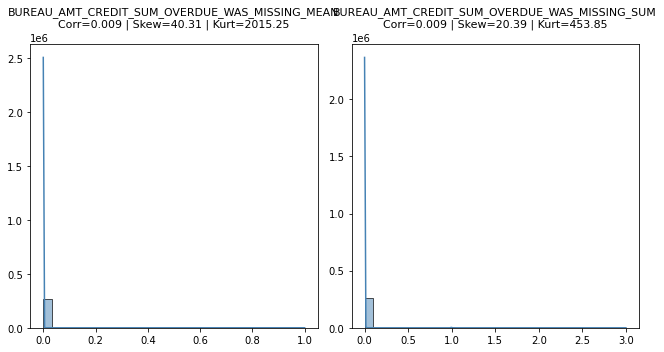

In [733]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

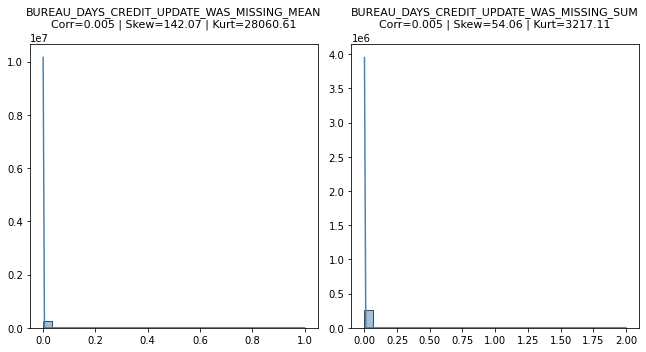

In [734]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

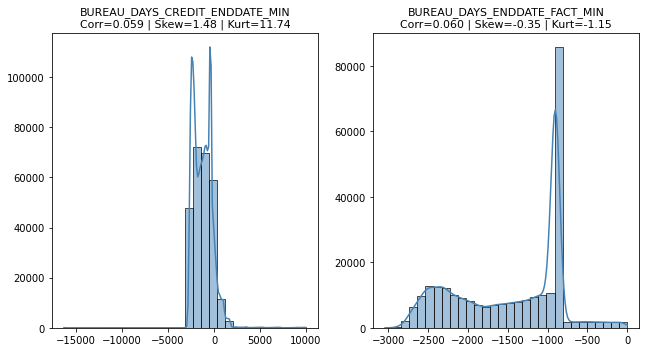

In [735]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MIN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [740]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',
    
    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN',
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX', 

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_ACTIVE_SOLD_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN',

    'BUREAU_MULTIPLE_PROLONGATION_SUM', 'BUREAU_CREDIT_CURRENCY_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN'
    ]

df_train_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [741]:
remaining_cols = list(set(df_bureau_train_median_mode_agg.columns).intersection(df_train_median_mode.columns))

In [742]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [743]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 527.94 MB
 Mémoire après : 464.30 MB
 Gain : 12.1%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0.125000,1,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,1.000000,4,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,1.000000,2,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,1.000000,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0.250000,1,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0.000000,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_train_median_missing

In [744]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_bureau_train_median_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,1.000000
1,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN / BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN,BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,1.000000
2,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,1.000000
3,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN / BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,1.000000
4,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX / BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,1.000000
5,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.999999
6,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,0.999999
7,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,0.999998
8,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.999998
9,BUREAU_CREDIT_CURRENCY_MEAN / BUREAU_CREDIT_CURRENCY_SUM,BUREAU_CREDIT_CURRENCY_MEAN,BUREAU_CREDIT_CURRENCY_SUM,0.999998


In [745]:
df_corr = get_correlation_pairs(df_train_median_missing[df_bureau_train_median_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [746]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [747]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_DEBT_CREDIT_RATIO_MAX,0.068641,0.080648,0.068641,0.080648,0.003683,0.138017
BUREAU_DEBT_TOTAL_RATIO_MAX,0.068309,0.079254,0.068309,0.079254,0.004176,0.147818
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN,0.077793,0.078569,0.077793,0.078569,0.006568,0.202182
BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN,0.077357,0.078135,0.077357,0.078135,0.006049,0.190806
BUREAU_PCT_ACTIVE,0.077357,0.078135,0.077357,0.078135,0.006346,0.197128
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.078547,0.073488,0.078547,0.073488,0.002288,0.109467
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.077991,0.073169,0.077991,0.073169,0.002266,0.108646
BUREAU_DAYS_ENDDATE_FACT_MIN,0.056083,0.059655,0.056083,0.059655,0.006318,0.180623
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.049499,0.058652,0.049499,0.058652,0.003564,0.119033
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM,0.067371,0.057264,0.067371,0.057264,0.008757,0.236030


In [748]:
pd.reset_option('display.max_rows')

In [749]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX, BUREAU_OVERDUE_TO_DEBT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM, BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN, BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN, BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN]",7,0.025803,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX
1,"[BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_SUM, BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_AMT_CREDIT_SUM_MEAN, BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN]",5,0.031626,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN
2,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM, BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_MEAN]",5,0.006716,BUREAU_HAS_PROLONGATION_SUM
3,"[BUREAU_LIMIT_CREDIT_RATIO_MEAN, BUREAU_LIMIT_CREDIT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_LIMIT_SUM, BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",5,0.009011,BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN
4,"[BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN, BUREAU_PCT_ACTIVE, BUREAU_CREDIT_ACTIVE_CLOSED_MEAN, BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN]",4,0.079371,BUREAU_CREDIT_ACTIVE_CLOSED_MEAN
5,"[BUREAU_CREDIT_DAY_OVERDUE_MEAN, BUREAU_CREDIT_DAY_OVERDUE_MAX, BUREAU_NB_OVERDUE]",3,0.042019,BUREAU_NB_OVERDUE
6,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX, BUREAU_AMT_CREDIT_SUM_DEBT_MEAN]",3,0.022035,BUREAU_AMT_CREDIT_SUM_DEBT_SUM
7,"[BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM, BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN]",2,0.000977,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM
8,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.068641,BUREAU_DEBT_CREDIT_RATIO_MAX
9,"[BUREAU_NB_LOANS, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",2,0.010707,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM


In [750]:
pd.reset_option('display.max_colwidth')

- Même variables que précédemment.

In [751]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',
    
    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN',
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX', 

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_ACTIVE_SOLD_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN',

    'BUREAU_MULTIPLE_PROLONGATION_SUM', 'BUREAU_CREDIT_CURRENCY_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN'
    ]

df_train_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [752]:
remaining_cols = list(set(df_bureau_train_median_missing_agg.columns).intersection(df_train_median_missing.columns))

In [753]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [754]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 512.60 MB
 Mémoire après : 448.96 MB
 Gain : 12.4%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0.125000,1,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,1.000000,4,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,1.000000,2,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,1.000000,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0.250000,1,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0.000000,0,0,0,0,0,0,0,0


#### Corrélation des variables - df_train_iterative_mode

In [755]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_bureau_train_iterative_mode_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,1.000000
1,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN / BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN,BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,1.000000
2,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN / BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,1.000000
3,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,0.999999
4,BUREAU_CREDIT_CURRENCY_MEAN / BUREAU_CREDIT_CURRENCY_SUM,BUREAU_CREDIT_CURRENCY_MEAN,BUREAU_CREDIT_CURRENCY_SUM,0.999998
5,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,0.999997
6,BUREAU_MULTIPLE_PROLONGATION_MEAN / BUREAU_MULTIPLE_PROLONGATION_SUM,BUREAU_MULTIPLE_PROLONGATION_MEAN,BUREAU_MULTIPLE_PROLONGATION_SUM,0.999995
7,BUREAU_CREDIT_DAY_OVERDUE_MAX / BUREAU_CREDIT_DAY_OVERDUE_MEAN,BUREAU_CREDIT_DAY_OVERDUE_MEAN,BUREAU_CREDIT_DAY_OVERDUE_MAX,0.999995
8,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.999992
9,BUREAU_CNT_CREDIT_PROLONG_MAX / BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_SUM,BUREAU_CNT_CREDIT_PROLONG_MAX,0.999989


In [756]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_bureau_train_iterative_mode_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [757]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [758]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.005984,0.093579,0.005984,0.093579,0.002342,0.087736
BUREAU_DEBT_CREDIT_RATIO_MEAN,-0.002834,0.091897,0.002834,0.091897,0.000000,0.037892
BUREAU_DEBT_CREDIT_RATIO_MAX,-0.004772,0.087202,0.004772,0.087202,0.000000,0.036790
BUREAU_DEBT_TOTAL_RATIO_MAX,0.012002,0.085142,0.012002,0.085142,0.001388,0.067245
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN,0.077793,0.078569,0.077793,0.078569,0.006916,0.203994
BUREAU_PCT_ACTIVE,0.077357,0.078135,0.077357,0.078135,0.006483,0.194801
BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN,0.077357,0.078135,0.077357,0.078135,0.006304,0.191132
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM,0.067371,0.057264,0.067371,0.057264,0.009778,0.249854
BUREAU_CREDIT_ACTIVE_ACTIVE_SUM,0.067131,0.057111,0.067131,0.057111,0.008628,0.226176
BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_MEAN,0.051585,0.055045,0.051585,0.055045,0.001111,0.065382


In [759]:
pd.reset_option('display.max_rows')

In [760]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_CREDIT_DAY_OVERDUE_MAX, BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX, BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN, BUREAU_CREDIT_DAY_OVERDUE_MEAN, BUREAU_OVERDUE_TO_DEBT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM, BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN, BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_NB_OVERDUE, BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN]",10,0.042019,BUREAU_NB_OVERDUE
1,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM, BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_MEAN]",5,0.006716,BUREAU_HAS_PROLONGATION_SUM
2,"[BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN, BUREAU_PCT_ACTIVE, BUREAU_CREDIT_ACTIVE_CLOSED_MEAN, BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN]",4,0.079371,BUREAU_CREDIT_ACTIVE_CLOSED_MEAN
3,"[BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_AMT_CREDIT_SUM_SUM, BUREAU_AMT_CREDIT_SUM_MEAN]",3,0.025595,BUREAU_AMT_CREDIT_SUM_MEAN
4,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX, BUREAU_AMT_CREDIT_SUM_DEBT_MEAN]",3,0.030534,BUREAU_AMT_CREDIT_SUM_DEBT_SUM
5,"[BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM, BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN]",2,0.000977,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM
6,"[BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN, BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_SUM]",2,0.016280,BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_SUM
7,"[BUREAU_LIMIT_CREDIT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",2,0.012085,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX
8,"[BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX, BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN]",2,0.012044,BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN
9,"[BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_MEAN, BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM]",2,0.053534,BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM


In [761]:
pd.reset_option('display.max_colwidth')

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



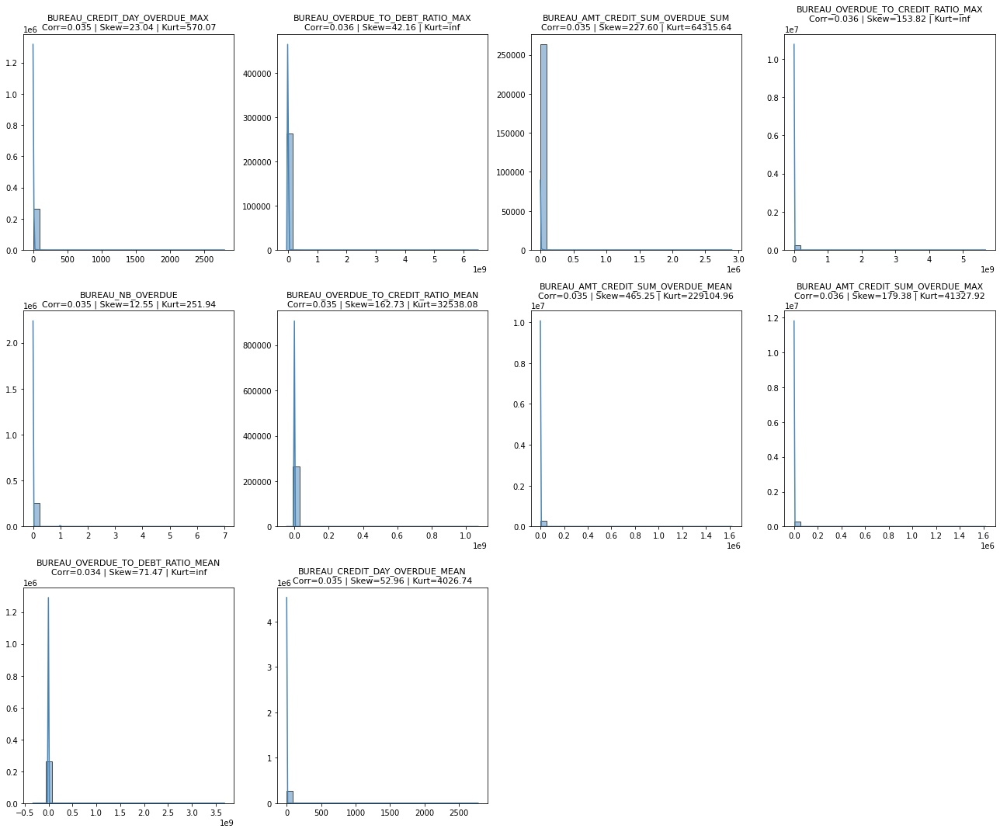

In [762]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_DAY_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 
            'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX', 
            'BUREAU_NB_OVERDUE', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN',
            'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

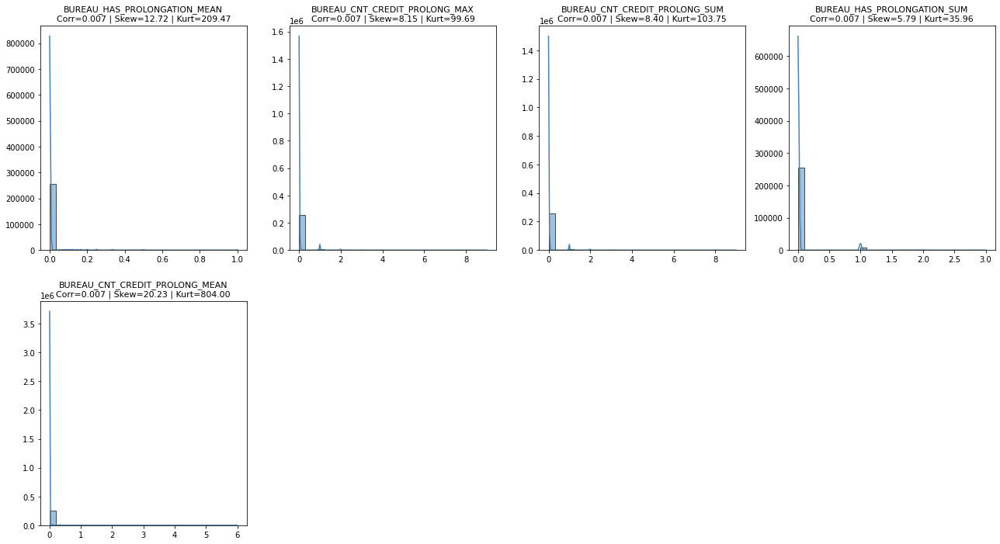

In [763]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 
            'BUREAU_CNT_CREDIT_PROLONG_SUM', 'BUREAU_HAS_PROLONGATION_SUM', 
            'BUREAU_CNT_CREDIT_PROLONG_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

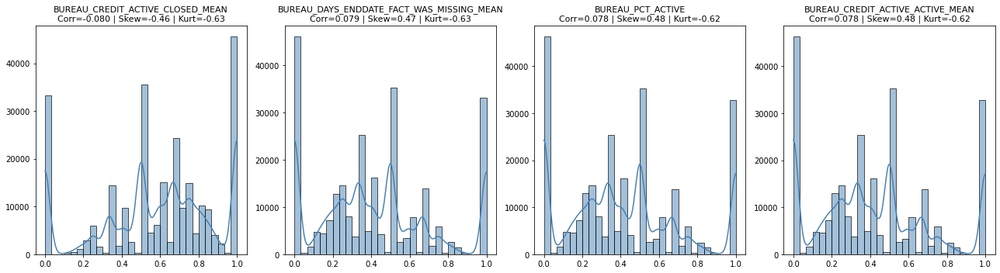

In [764]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_CLOSED_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 
            'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

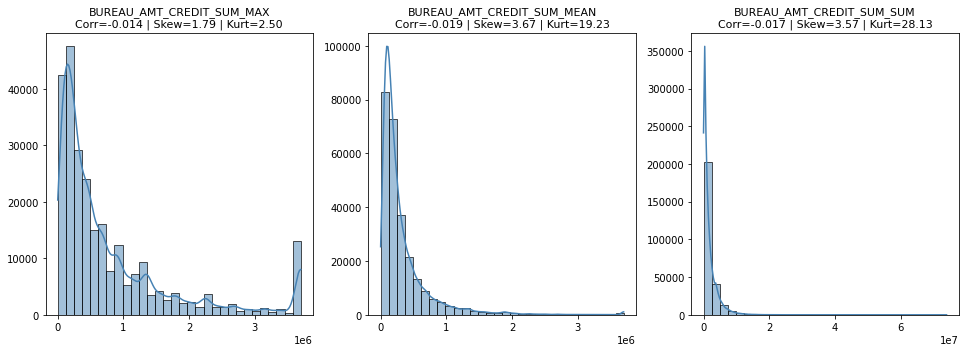

In [765]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN', 
            'BUREAU_AMT_CREDIT_SUM_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

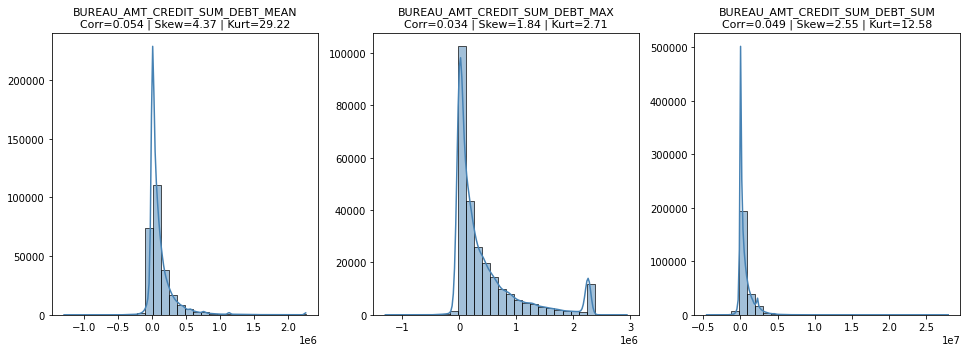

In [766]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 
            'BUREAU_AMT_CREDIT_SUM_DEBT_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

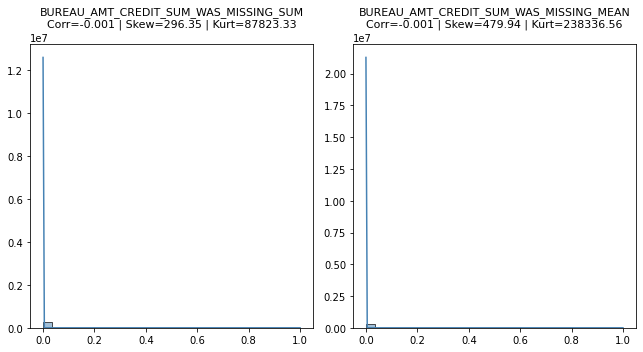

In [767]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

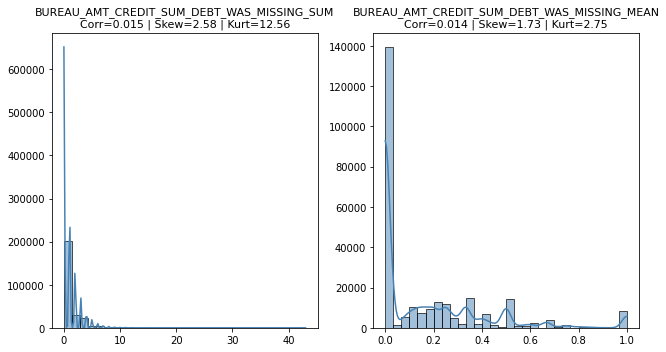

In [768]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



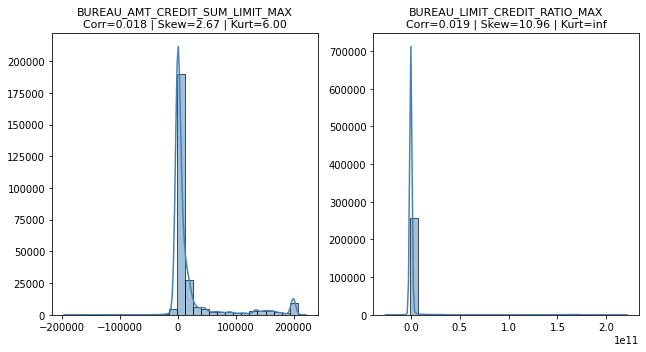

In [769]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



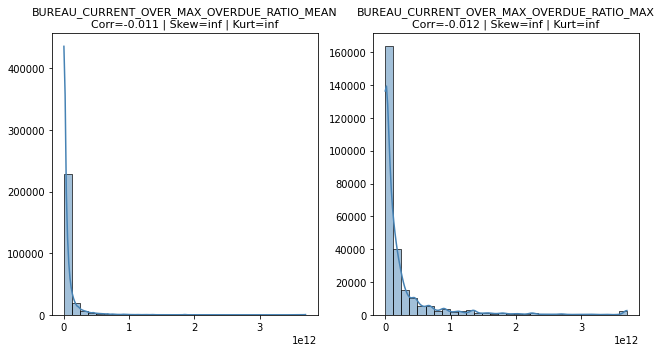

In [771]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

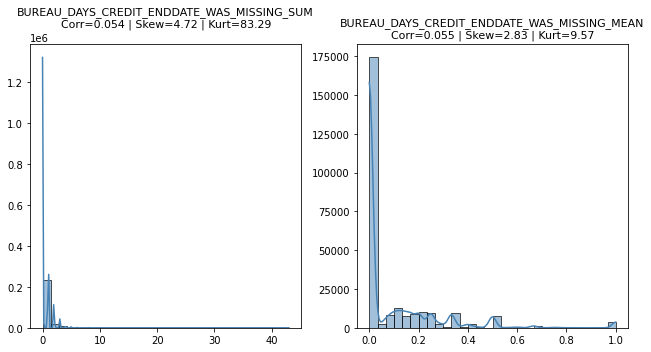

In [772]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce



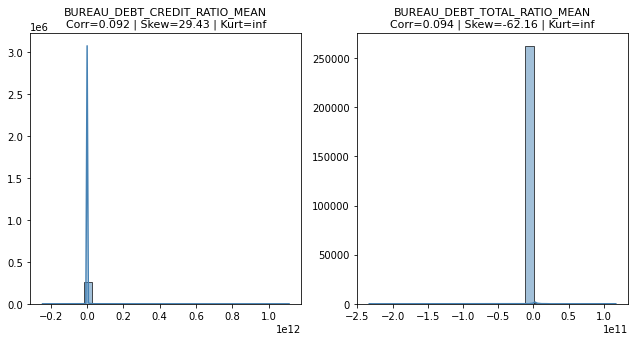

In [773]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

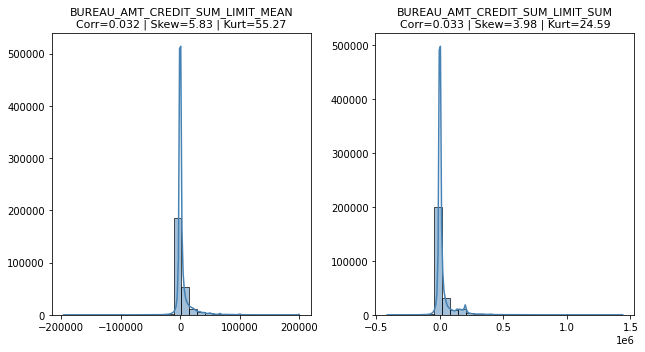

In [774]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



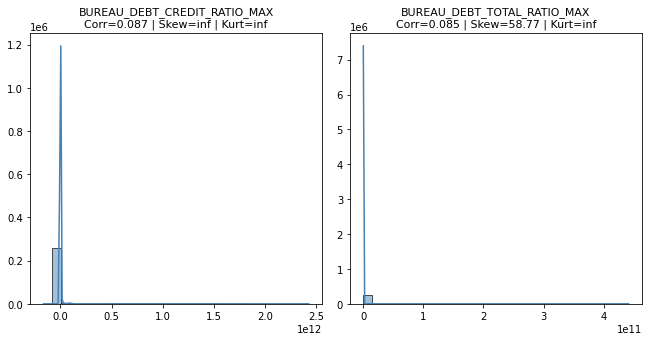

In [775]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_TOTAL_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

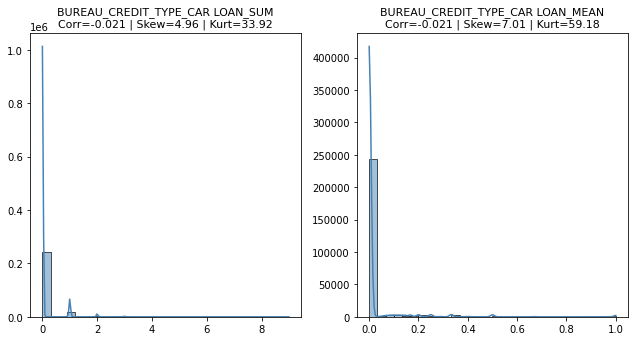

In [776]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CAR LOAN_SUM', 'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

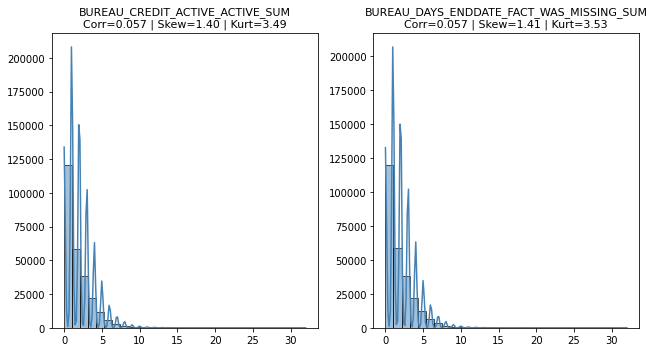

In [777]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_ACTIVE_SUM', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

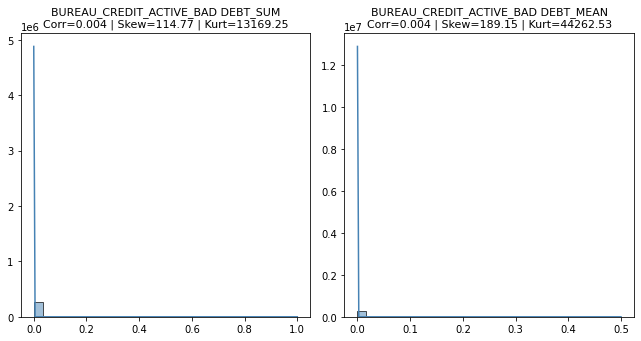

In [778]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

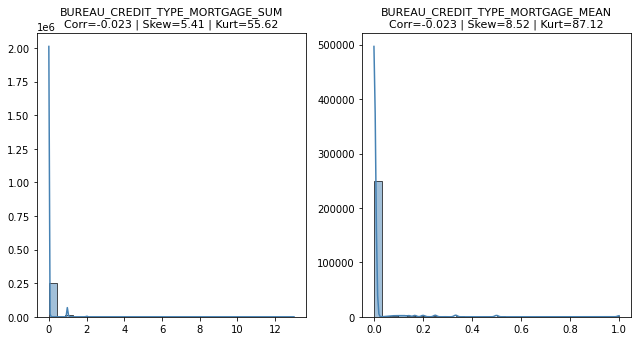

In [779]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MORTGAGE_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

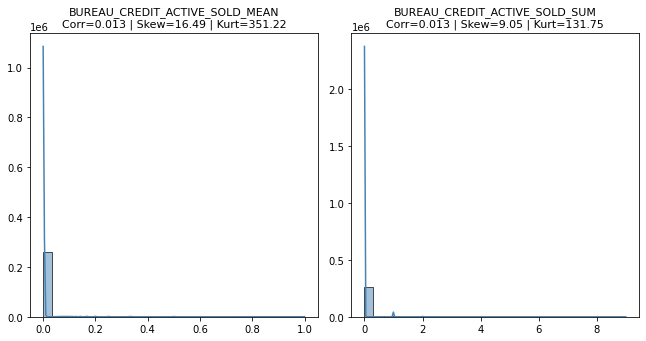

In [780]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_SOLD_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

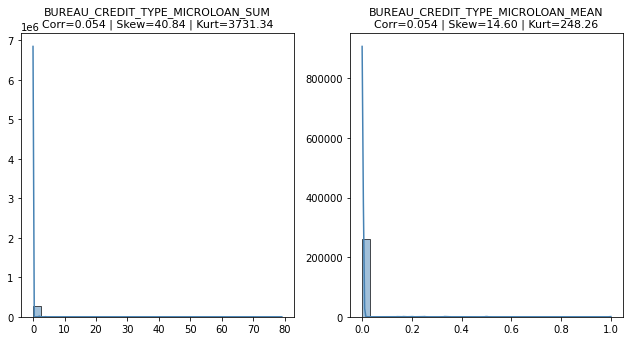

In [781]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_MEAN']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

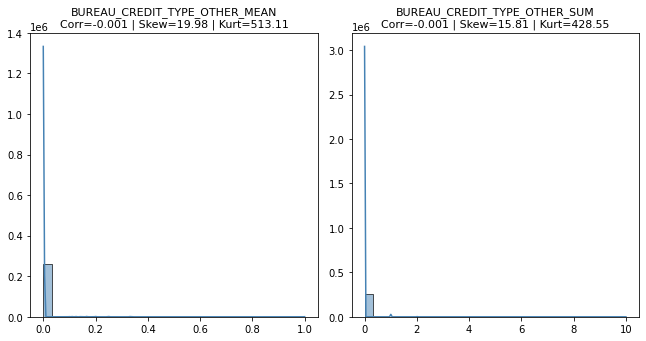

In [782]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_CREDIT_TYPE_OTHER_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

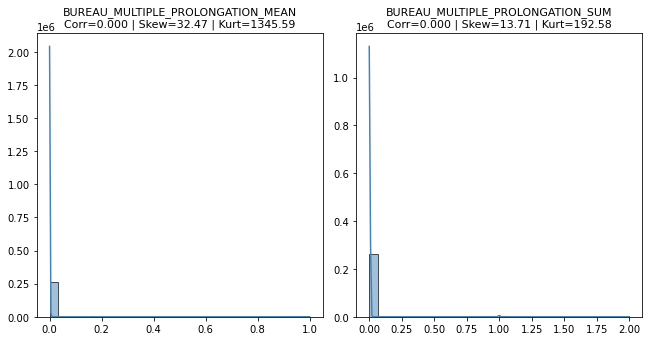

In [783]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_MULTIPLE_PROLONGATION_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

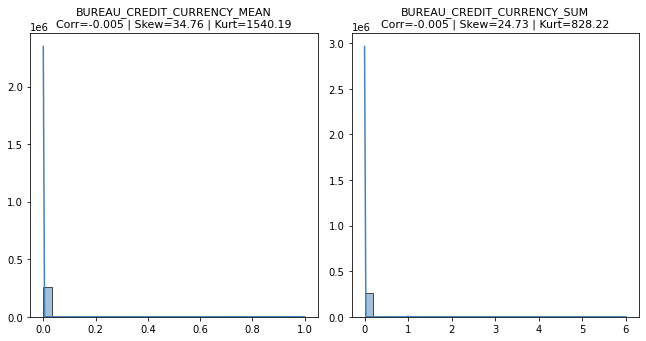

In [784]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_CURRENCY_MEAN', 'BUREAU_CREDIT_CURRENCY_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

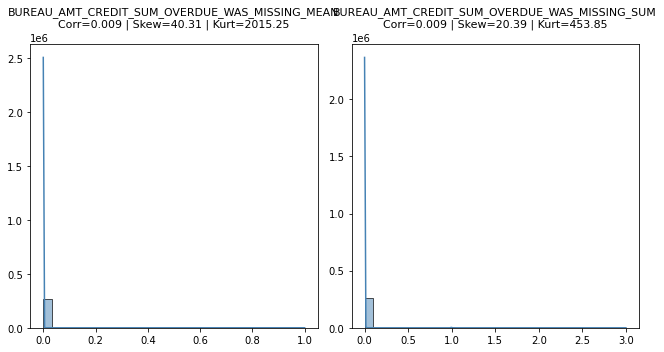

In [785]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

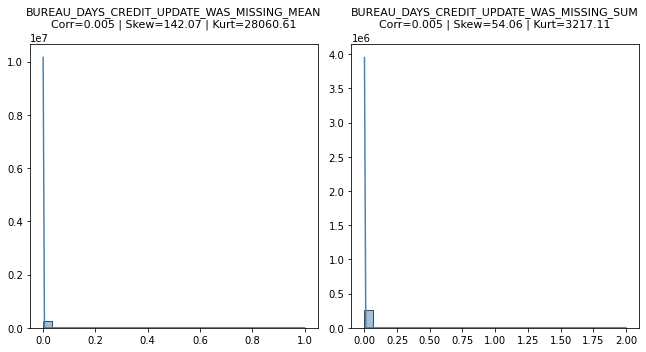

In [786]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

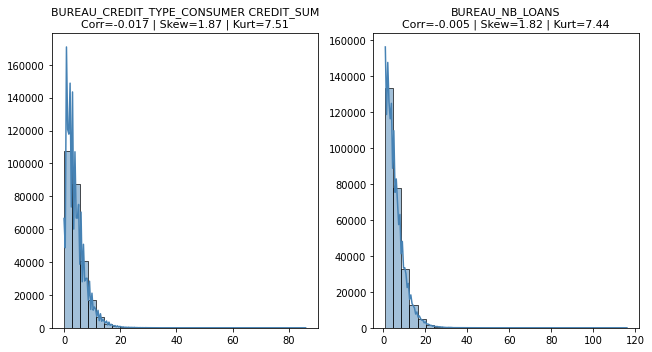

In [787]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_iterative_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [ ]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_CREDIT_DAY_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN',
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN',

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX',
    'BUREAU_CNT_CREDIT_PROLONG_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MAX',

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_MEAN', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM',

    'BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_MEAN', 'BUREAU_CREDIT_CURRENCY_MEAN',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_NB_LOANS',
]

df_train_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [789]:
remaining_cols = list(set(df_bureau_train_iterative_mode_agg.columns).intersection(df_train_iterative_mode.columns))

In [790]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [791]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 513.86 MB
 Mémoire après : 458.15 MB
 Gain : 10.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE,BUREAU_LIMIT_CREDIT_RATIO_MAX_CLIP
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.125000,1,0,0,0,0,0,0,0,1.945002
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,1.000000,4,0,0,0,0,0,0,0,0.246445
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,1.000000,2,0,0,0,0,0,0,0,0.000000
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,1.000000,1,0,0,0,0,0,0,0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.250000,1,0,0,0,0,0,0,0,0.000000
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0,0,0,0,0,0,0,0,0.042994


#### Corrélation des variables - df_train_nan_missing

In [792]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_bureau_train_nan_missing_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM,1.000000
1,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN / BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN,BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM,1.000000
2,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,1.000000
3,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN / BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,1.000000
4,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX / BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,0.999999
5,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.999999
6,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM,0.999999
7,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN / BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM,0.999998
8,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.999998
9,BUREAU_CREDIT_CURRENCY_MEAN / BUREAU_CREDIT_CURRENCY_SUM,BUREAU_CREDIT_CURRENCY_MEAN,BUREAU_CREDIT_CURRENCY_SUM,0.999998


In [793]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_bureau_train_nan_missing_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [794]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [795]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ['TARGET']], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_DEBT_CREDIT_RATIO_MAX,0.073587,0.086205,0.073587,0.086205,0.003888,0.146586
BUREAU_DEBT_CREDIT_RATIO_MEAN,0.091609,0.084184,0.091609,0.084184,0.002690,0.127508
BUREAU_DEBT_TOTAL_RATIO_MAX,0.074597,0.082767,0.074597,0.082767,0.003443,0.136148
BUREAU_DEBT_TOTAL_RATIO_MEAN,0.088175,0.081266,0.088175,0.081266,0.002643,0.123964
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN,0.077793,0.078569,0.077793,0.078569,0.006568,0.202182
BUREAU_PCT_ACTIVE,0.077357,0.078135,0.077357,0.078135,0.006346,0.197128
BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN,0.077357,0.078135,0.077357,0.078135,0.006049,0.190806
BUREAU_DAYS_CREDIT_ENDDATE_MIN,0.053715,0.060949,0.053715,0.060949,0.003119,0.112179
BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM,0.067371,0.057264,0.067371,0.057264,0.008757,0.236030
BUREAU_CREDIT_ACTIVE_ACTIVE_SUM,0.067131,0.057111,0.067131,0.057111,0.009407,0.249697


In [796]:
pd.reset_option('display.max_rows')

In [797]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM, BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN, BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX, BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN]",5,0.025808,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX
1,"[BUREAU_HAS_PROLONGATION_MEAN, BUREAU_CNT_CREDIT_PROLONG_SUM, BUREAU_HAS_PROLONGATION_SUM, BUREAU_CNT_CREDIT_PROLONG_MAX, BUREAU_CNT_CREDIT_PROLONG_MEAN]",5,0.006716,BUREAU_HAS_PROLONGATION_SUM
2,"[BUREAU_LIMIT_CREDIT_RATIO_MEAN, BUREAU_LIMIT_CREDIT_RATIO_MAX, BUREAU_AMT_CREDIT_SUM_LIMIT_SUM, BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN, BUREAU_AMT_CREDIT_SUM_LIMIT_MAX]",5,0.009838,BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN
3,"[BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN, BUREAU_PCT_ACTIVE, BUREAU_CREDIT_ACTIVE_CLOSED_MEAN, BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN]",4,0.079371,BUREAU_CREDIT_ACTIVE_CLOSED_MEAN
4,"[BUREAU_AMT_CREDIT_SUM_MAX, BUREAU_AMT_CREDIT_SUM_SUM, BUREAU_AMT_CREDIT_SUM_MEAN]",3,0.025590,BUREAU_AMT_CREDIT_SUM_MEAN
5,"[BUREAU_CREDIT_DAY_OVERDUE_MEAN, BUREAU_CREDIT_DAY_OVERDUE_MAX, BUREAU_NB_OVERDUE]",3,0.042019,BUREAU_NB_OVERDUE
6,"[BUREAU_AMT_CREDIT_SUM_DEBT_SUM, BUREAU_AMT_CREDIT_SUM_DEBT_MAX, BUREAU_AMT_CREDIT_SUM_DEBT_MEAN]",3,0.022035,BUREAU_AMT_CREDIT_SUM_DEBT_SUM
7,"[BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM, BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN]",2,0.000977,BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM
8,"[BUREAU_DEBT_CREDIT_RATIO_MAX, BUREAU_DEBT_TOTAL_RATIO_MAX]",2,0.074597,BUREAU_DEBT_TOTAL_RATIO_MAX
9,"[BUREAU_NB_LOANS, BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM]",2,0.010707,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM


In [798]:
pd.reset_option('display.max_colwidth')

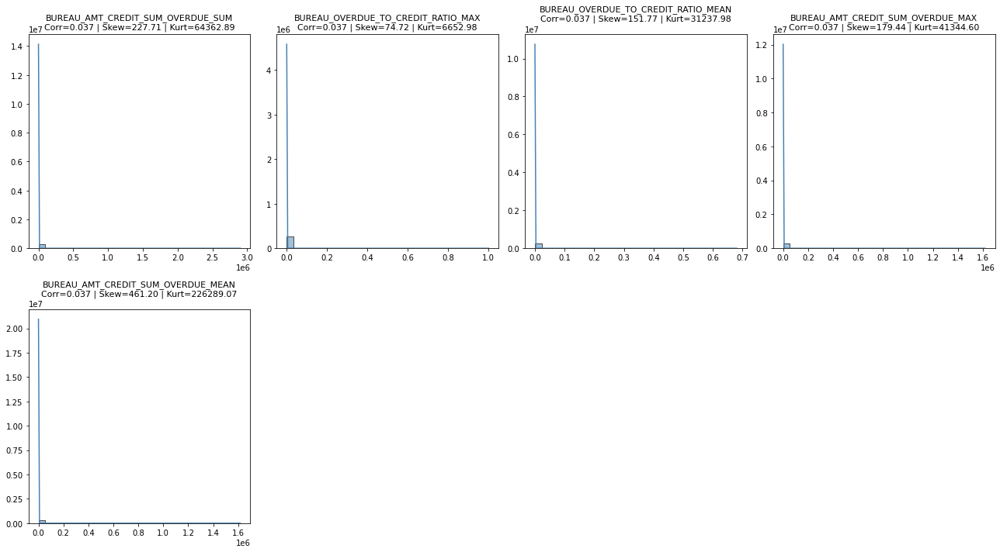

In [799]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX', 
            'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 
            'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

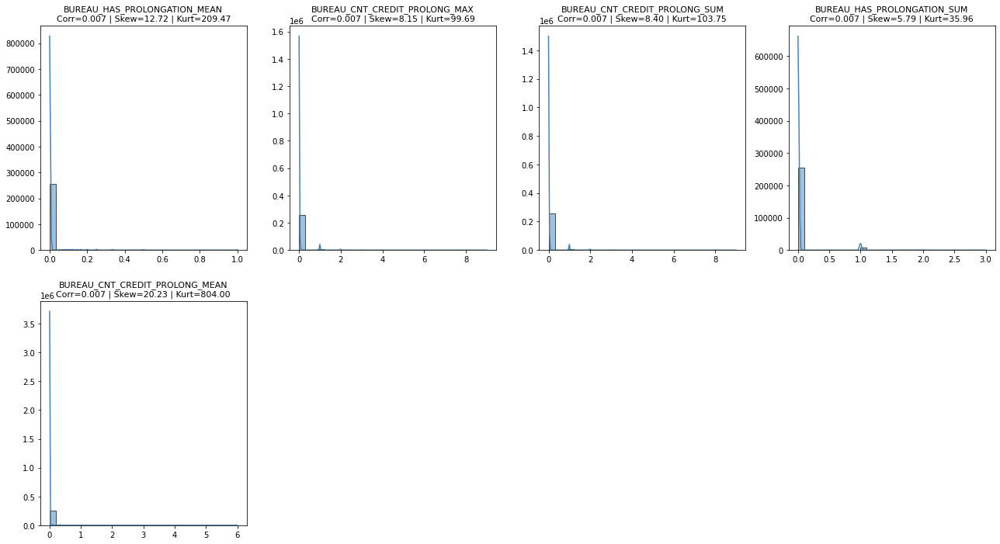

In [800]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 
            'BUREAU_CNT_CREDIT_PROLONG_SUM', 'BUREAU_HAS_PROLONGATION_SUM', 
            'BUREAU_CNT_CREDIT_PROLONG_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



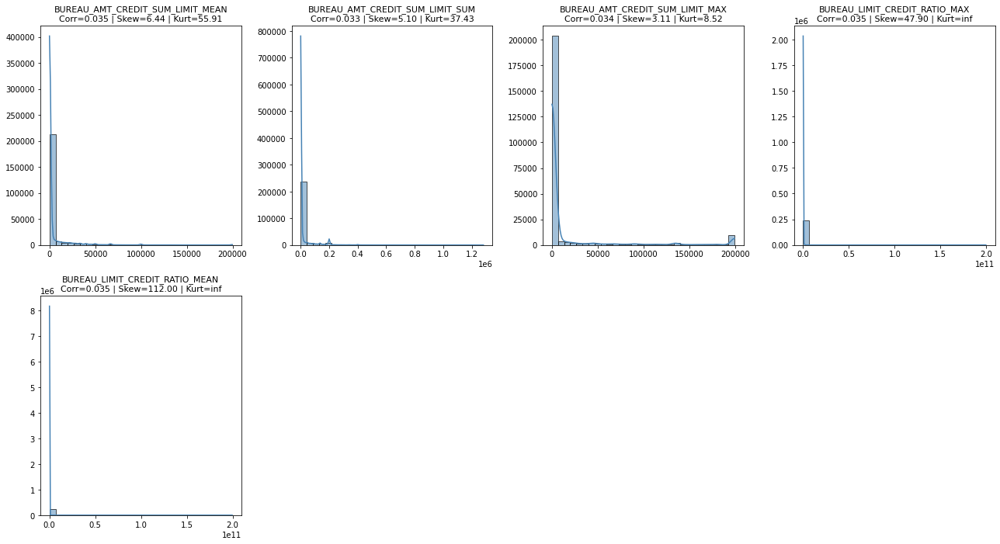

In [801]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 
            'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
            'BUREAU_LIMIT_CREDIT_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

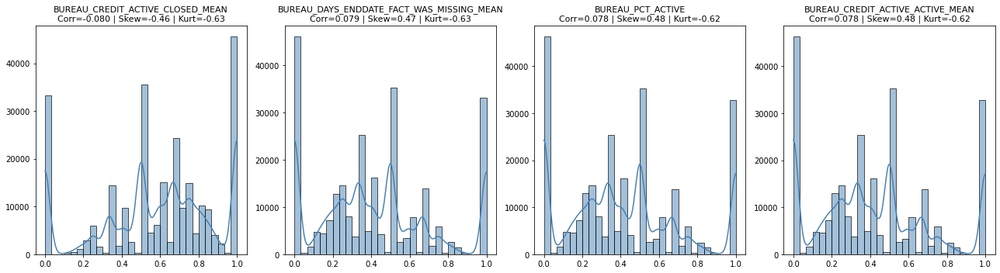

In [802]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_CLOSED_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 
            'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

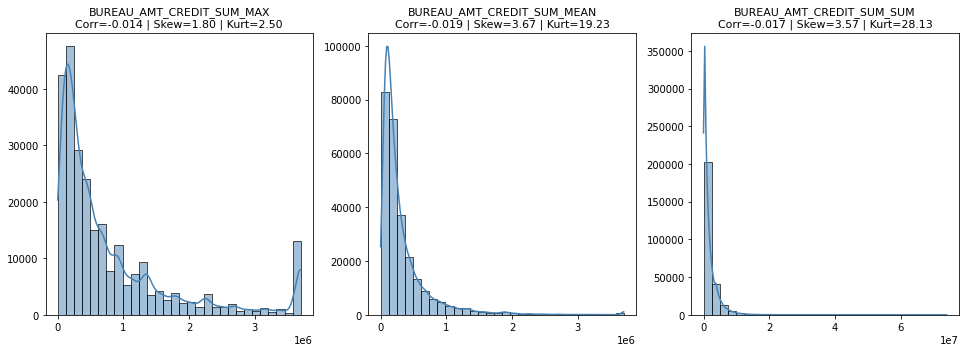

In [803]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN', 'BUREAU_AMT_CREDIT_SUM_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

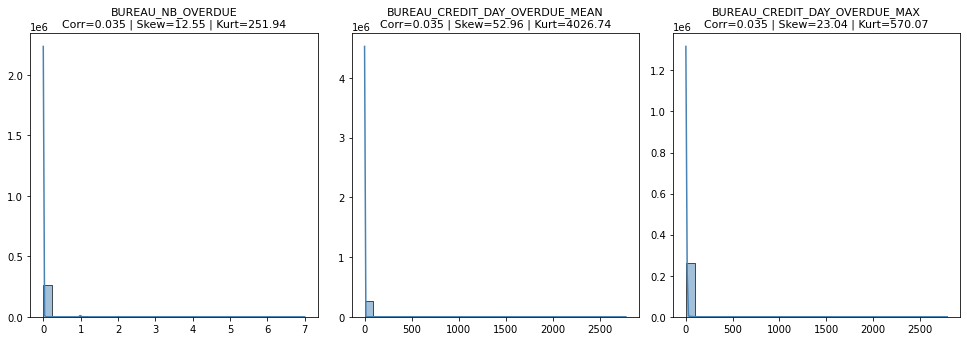

In [804]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_NB_OVERDUE', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

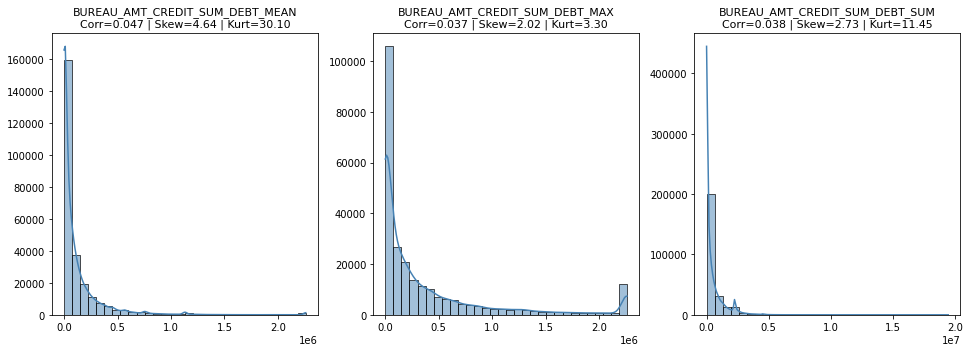

In [805]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

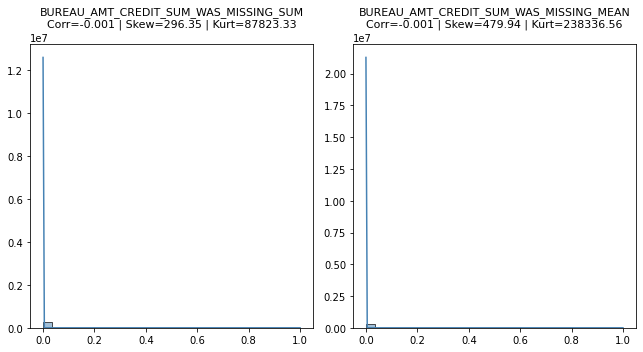

In [806]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

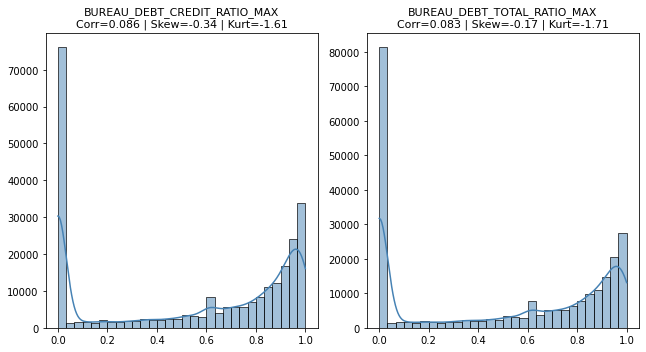

In [807]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_TOTAL_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

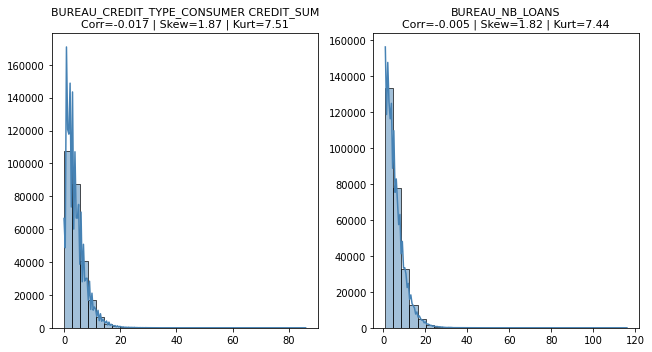

In [808]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM', 'BUREAU_NB_LOANS']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

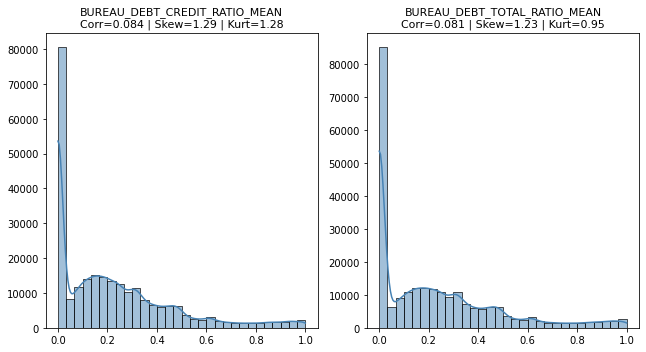

In [809]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

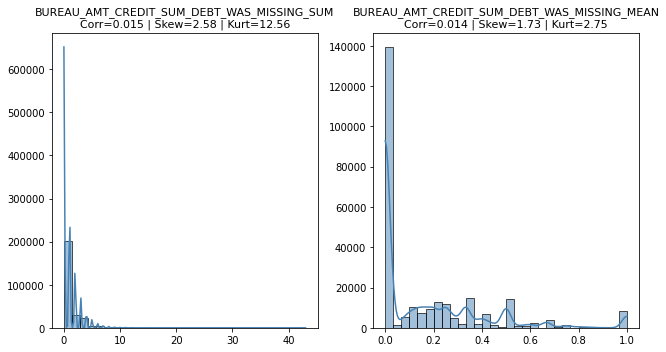

In [810]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

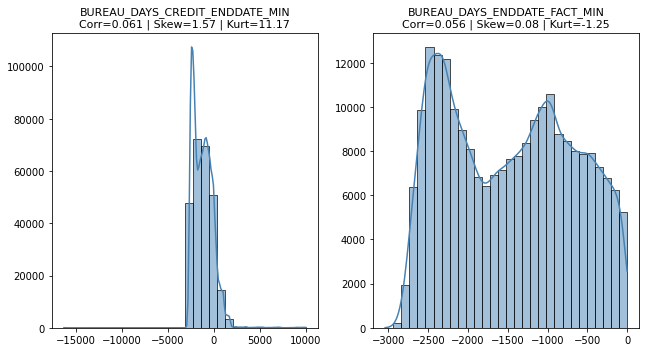

In [811]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MIN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square

c:\Users\Caomghin\anaconda3\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning:

overflow encountered in reduce

c:\Users\Caomghin\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1076: RuntimeWarning:

overflow encountered in square



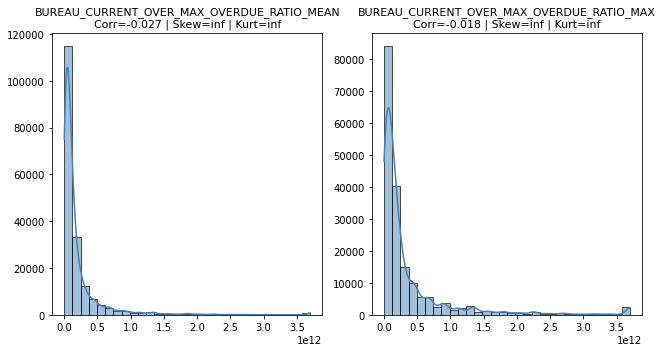

In [812]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

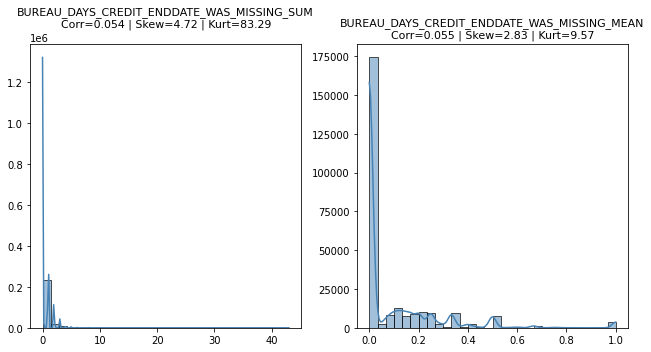

In [813]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

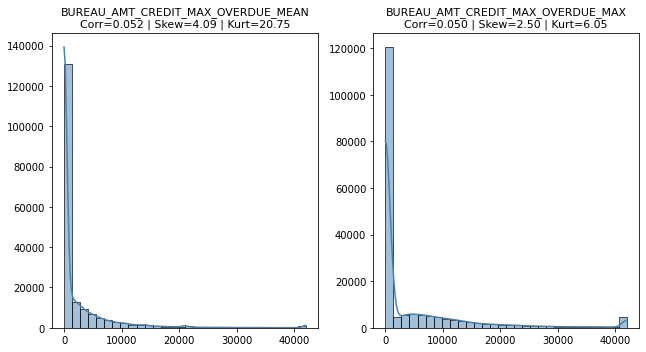

In [814]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

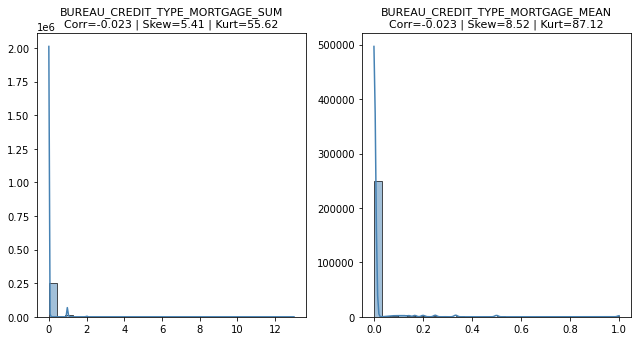

In [815]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MORTGAGE_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

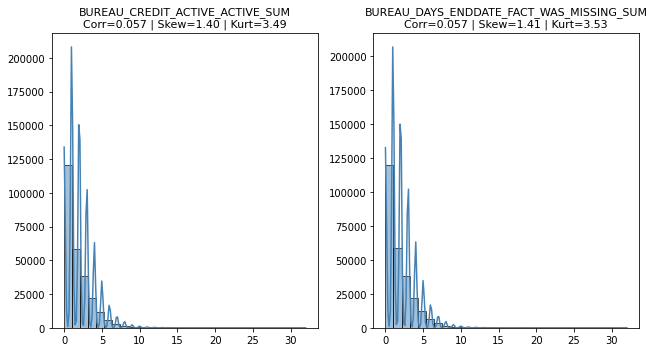

In [816]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_ACTIVE_SUM', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

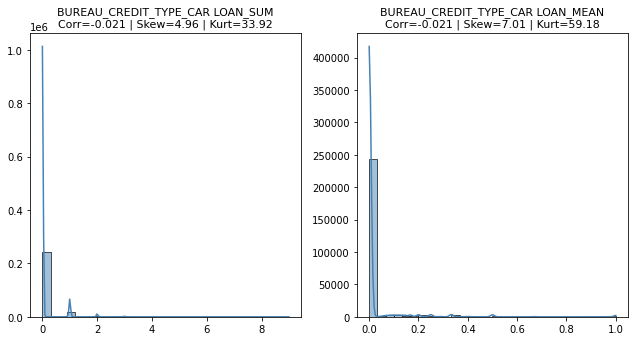

In [817]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_CAR LOAN_SUM', 'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

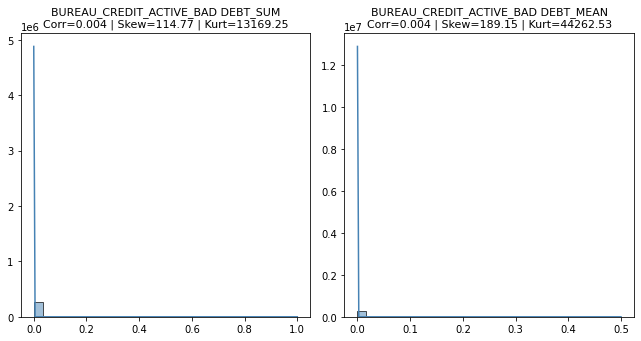

In [818]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_BAD DEBT_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

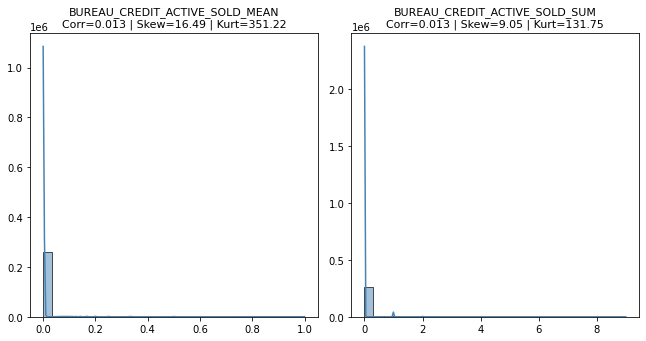

In [819]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_ACTIVE_SOLD_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

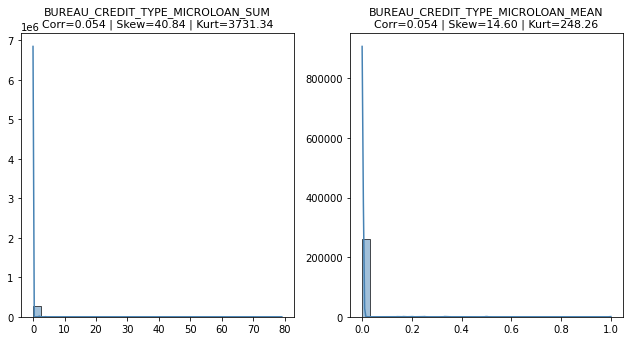

In [820]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

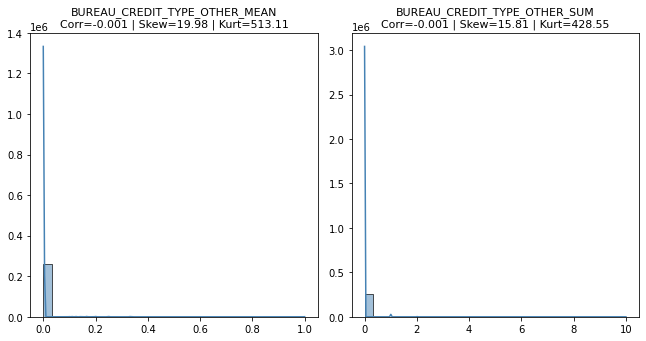

In [821]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_CREDIT_TYPE_OTHER_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

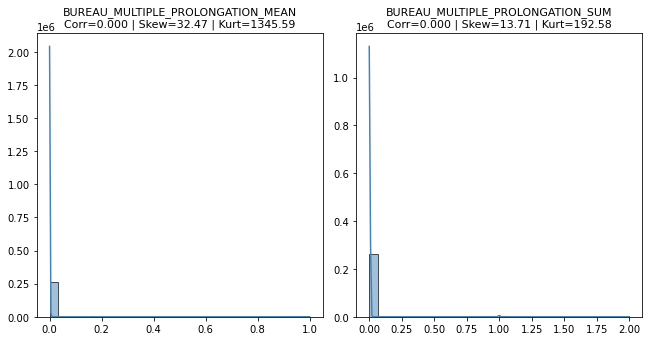

In [822]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_MULTIPLE_PROLONGATION_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

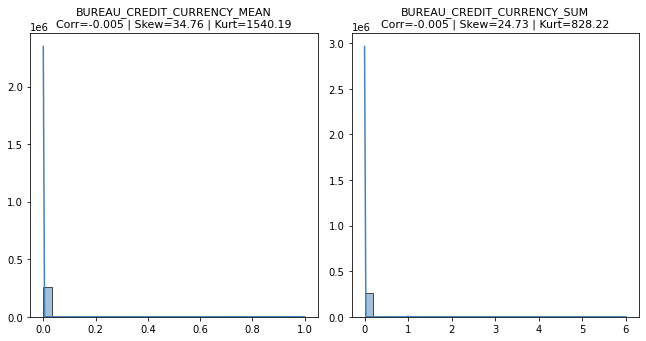

In [823]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_CREDIT_CURRENCY_MEAN', 'BUREAU_CREDIT_CURRENCY_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

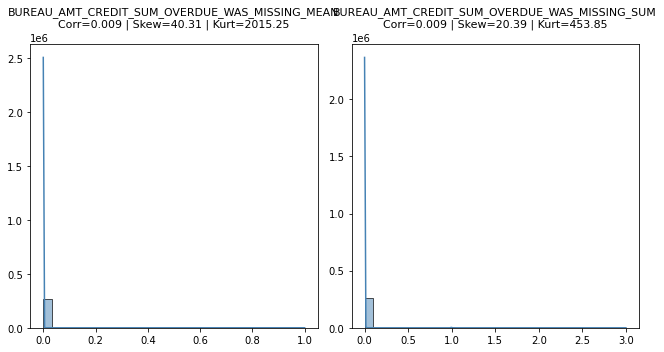

In [824]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

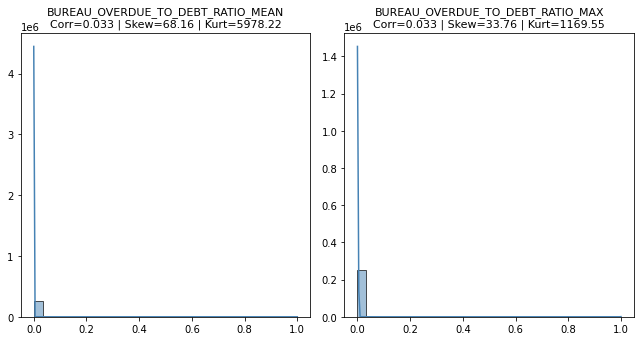

In [825]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

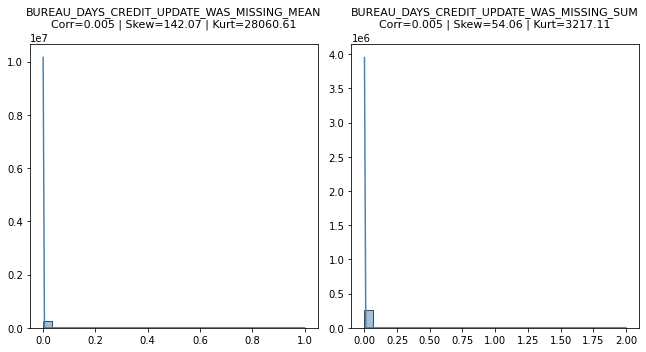

In [826]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

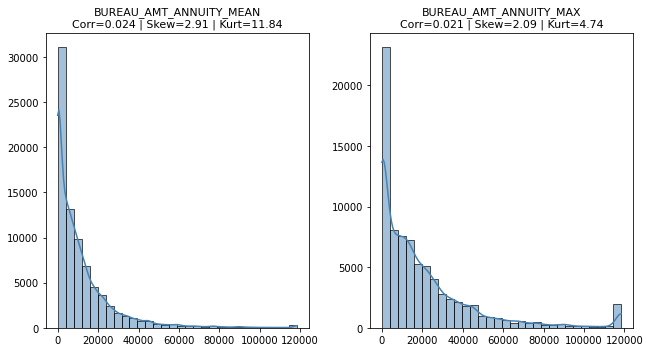

In [827]:
# Liste des transformations par groupe de corrélation

transfos = ['BUREAU_AMT_ANNUITY_MEAN', 'BUREAU_AMT_ANNUITY_MAX']

plot_transformations_distributions(
    df=df_train_nan_missing,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [833]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN',

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 
    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX',

    'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MAX', 

    'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_MEAN',

    'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_MEAN',

    'BUREAU_CREDIT_CURRENCY_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MAX',
]

df_train_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [891]:
remaining_cols = list(set(df_bureau_train_nan_missing_agg.columns).intersection(df_train_nan_missing.columns))

In [892]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [836]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 521.40 MB
 Mémoire après : 471.54 MB
 Gain : 9.6%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0,0.125000,1,0,0,0,0,0,0,0
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,0,1.000000,4,0,0,0,0,0,0,0
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,0,1.000000,2,0,0,0,0,0,0,0
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,0,1.000000,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0,0.250000,1,0,0,0,0,0,0,0
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0,0.000000,0,0,0,0,0,0,0,0


- Ensuite on réitère les même modifications des dataframes train sur les dataframes test.

#### Corrélation des variables - df_test_median_mode_linear

In [ ]:
df_test_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_test_median_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',
    'BUREAU_CNT_CREDIT_PROLONG_MAX_LOG', 'BUREAU_CNT_CREDIT_PROLONG_SUM_LOG',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX',
    
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX',
    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN',

    'BUREAU_LIMIT_CREDIT_RATIO_MEAN'

]

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [838]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.982876
1,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
2,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.903016
3,EXT_SOURCE_1_3 / EXT_SOURCE_MEAN,EXT_SOURCE_MEAN,EXT_SOURCE_1_3,0.815928
4,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153


In [840]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 48.26 MB
 Mémoire après : 42.12 MB
 Gain : 12.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_CREDIT_TYPE_CONSUMER CREDIT_SUM,BUREAU_CREDIT_TYPE_CREDIT CARD_MEAN,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,7,0.000000,0,0.0,0,0.0,0,0.0,0,0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,2,0.333333,1,0.0,0,0.0,0,0.0,0,0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,2,0.000000,0,0.0,0,0.0,0,0.0,0,0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,7,0.416667,5,0.0,0,0.0,0,0.0,0,0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,3,0.200000,1,0.2,1,0.0,0,0.0,0,0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0,0.000000,0,0.0,0,0.0,0,0.0,0,0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,3,0.200000,1,0.0,0,0.2,1,0.0,0,0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,13,0.235294,4,0.0,0,0.0,0,0.0,0,0


In [844]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [845]:
# Création des variables précédentes que l'on a garder.

df_test_median_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_test_median_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_test_median_missing_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_test_median_missing_linear['BUREAU_HAS_PROLONGATION_SUM'])

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_HAS_PROLONGATION_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',
    'BUREAU_CNT_CREDIT_PROLONG_MAX_LOG', 'BUREAU_CNT_CREDIT_PROLONG_SUM_LOG',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX',
    
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MAX',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX',
    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM_LOG',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN',

    'BUREAU_LIMIT_CREDIT_RATIO_MEAN'

]

df_test_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [847]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.982876
1,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
2,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.903016
3,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153
4,ANNUITY_INCOME_RATIO_LOG / GOODS_INCOME_RATIO_LOG,ANNUITY_INCOME_RATIO_LOG,GOODS_INCOME_RATIO_LOG,0.800444


In [848]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 49.36 MB
 Mémoire après : 43.04 MB
 Gain : 12.8%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG,BUREAU_HAS_PROLONGATION_SUM_LOG
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,1,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,5,0.0,0,0.0,0,0.0,0,0,11.526747,0.0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,1,0.2,1,0.0,0,0.0,0,0,0.000000,0.0
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,1,0.0,0,0.2,1,0.0,0,0,10.282052,0.0
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,4,0.0,0,0.0,0,0.0,0,0,0.000000,0.0


In [865]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [850]:
# Création des variables précédentes que l'on a garder.

df_test_iterative_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_test_iterative_mode_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_test_iterative_mode_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_test_iterative_mode_linear['BUREAU_HAS_PROLONGATION_SUM'])

c:\Users\Caomghin\anaconda3\lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning:

invalid value encountered in log1p



In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS',

    'BUREAU_DAYS_CREDIT_ENDDATE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX',

    'BUREAU_DEBT_CREDIT_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM',

    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN']

df_test_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [852]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.999732
1,BUREAU_HAS_PROLONGATION_SUM / BUREAU_HAS_PROLONGATION_SUM_LOG,BUREAU_HAS_PROLONGATION_SUM,BUREAU_HAS_PROLONGATION_SUM_LOG,0.998386
2,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
3,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN / BUREAU_DAYS_ENDDATE_FACT_MAX,BUREAU_DAYS_ENDDATE_FACT_MAX,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,0.855636
4,BUREAU_DEBT_TOTAL_RATIO_MAX / BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_TOTAL_RATIO_MEAN,BUREAU_DEBT_TOTAL_RATIO_MAX,0.849535
5,BUREAU_AMT_CREDIT_SUM_DEBT_MEAN / BUREAU_AMT_CREDIT_SUM_MEAN,BUREAU_AMT_CREDIT_SUM_MEAN,BUREAU_AMT_CREDIT_SUM_DEBT_MEAN,0.810143
6,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153
7,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX / BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,0.805953
8,ANNUITY_INCOME_RATIO_LOG / GOODS_INCOME_RATIO_LOG,ANNUITY_INCOME_RATIO_LOG,GOODS_INCOME_RATIO_LOG,0.800782


In [853]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 49.75 MB
 Mémoire après : 43.61 MB
 Gain : 12.3%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG,BUREAU_HAS_PROLONGATION_SUM_LOG
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,0,0.0,0,0.0,0,0.0,0,0,8.321737,0.0
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,1,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,0,0.0,0,0.0,0,0.0,0,0,7.982689,0.0
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,5,0.0,0,0.0,0,0.0,0,0,11.526747,0.0
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,1,0.2,1,0.0,0,0.0,0,0,0.000000,0.0
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,1,0.0,0,0.2,1,0.0,0,0,10.282052,0.0
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,4,0.0,0,0.0,0,0.0,0,0,8.472386,0.0


In [866]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [858]:
# Création des variables précédentes que l'on a garder.

df_test_nan_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG'] = np.log1p(df_test_nan_missing_linear['BUREAU_AMT_CREDIT_SUM_LIMIT_MAX'])
df_test_nan_missing_linear['BUREAU_HAS_PROLONGATION_SUM_LOG'] = np.log1p(df_test_nan_missing_linear['BUREAU_HAS_PROLONGATION_SUM'])

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_DAYS_CREDIT_ENDDATE_MIN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 
    'BUREAU_DAYS_ENDDATE_FACT_MEAN', 'BUREAU_DAYS_CREDIT_MIN', 'BUREAU_DAYS_CREDIT_UPDATE_MIN',

    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_HAS_PROLONGATION_SUM',

    'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM',

    'BUREAU_CREDIT_ACTIVE_CLOSED_SUM', 'BUREAU_NB_LOANS',

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MEAN', 'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',
    'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_CREDIT_TYPE_CONSUMER CREDIT_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_CNT_CREDIT_PROLONG_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM',

    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_DEBT_CREDIT_RATIO_MAX',

    'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_DAYS_SINCE_LAST_UPDATE_MIN', 'BUREAU_CREDIT_DURATION_MEAN']

df_test_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [860]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear, method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX / BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN,BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX,0.982882
1,FLAG_CAR_REALTY_DOC_INTER / HAS_CAR_OR_REALTY,HAS_CAR_OR_REALTY,FLAG_CAR_REALTY_DOC_INTER,0.961488
2,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.903137
3,ADULTS_COUNT / NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Married,ADULTS_COUNT,0.809153


In [861]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 50.01 MB
 Mémoire après : 45.08 MB
 Gain : 9.9%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_CREDIT_TYPE_CREDIT CARD_SUM,BUREAU_CREDIT_TYPE_MICROLOAN_MEAN,BUREAU_CREDIT_TYPE_MICROLOAN_SUM,BUREAU_CREDIT_TYPE_MORTGAGE_MEAN,BUREAU_CREDIT_TYPE_MORTGAGE_SUM,BUREAU_CREDIT_TYPE_OTHER_MEAN,BUREAU_CREDIT_TYPE_OTHER_SUM,BUREAU_NB_OVERDUE,BUREAU_AMT_CREDIT_SUM_LIMIT_MAX_LOG,BUREAU_HAS_PROLONGATION_SUM_LOG
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,0,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,1,0.0,0,0.0,0,0.0,0,0,0.000000,0.0
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0,0.0,0,0.0,0,0.0,0,0,NaN,0.0
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,5,0.0,0,0.0,0,0.0,0,0,11.526747,0.0
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,<NA>,NaN,<NA>,NaN,<NA>,NaN,<NA>,<NA>,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,1,0.2,1,0.0,0,0.0,0,0,0.000000,0.0
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,<NA>,NaN,<NA>,NaN,<NA>,NaN,<NA>,<NA>,NaN,NaN
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,1,0.0,0,0.2,1,0.0,0,0,10.282052,0.0
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,4,0.0,0,0.0,0,0.0,0,0,0.000000,0.0


In [867]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',
    
    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN',
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX', 

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_ACTIVE_SOLD_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN',

    'BUREAU_MULTIPLE_PROLONGATION_SUM', 'BUREAU_CREDIT_CURRENCY_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN'
    ]

df_test_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [869]:
remaining_cols = list(set(df_bureau_test_median_mode_agg.columns).intersection(df_test_median_mode.columns))

In [870]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [871]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 82.38 MB
 Mémoire après : 72.29 MB
 Gain : 12.2%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0.000000,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0.000000,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0.500000,2,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0.416667,5,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0.000000,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0.200000,1,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0.411765,7,0,0,0,0,0,0,0


In [873]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',
    
    'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_MEAN',
    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX', 

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_LIMIT_CREDIT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_MEAN', 'BUREAU_AMT_CREDIT_SUM_DEBT_MAX',

    'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MEAN',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_ACTIVE_SOLD_SUM', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN',

    'BUREAU_MULTIPLE_PROLONGATION_SUM', 'BUREAU_CREDIT_CURRENCY_SUM', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_ENDDATE_MIN'
    ]

df_test_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [875]:
remaining_cols = list(set(df_bureau_test_median_missing_agg.columns).intersection(df_test_median_missing.columns))

In [876]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [878]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 79.95 MB
 Mémoire après : 69.86 MB
 Gain : 12.6%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0.000000,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0.000000,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0.500000,2,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0.416667,5,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0.000000,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0.200000,1,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0.411765,7,0,0,0,0,0,0,0


In [879]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [ ]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_CREDIT_DAY_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MAX', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX', 
    'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN',
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN',

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 
    'BUREAU_CNT_CREDIT_PROLONG_SUM', 'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_SUM',

    'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN',

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MAX',

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_DEBT_TOTAL_RATIO_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_MEAN', 'BUREAU_DEBT_TOTAL_RATIO_MAX',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN',

    'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_MEAN', 'BUREAU_CREDIT_TYPE_MICROLOAN_SUM',

    'BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_MEAN', 'BUREAU_CREDIT_CURRENCY_MEAN',

    'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_NB_LOANS',
]

df_test_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [881]:
remaining_cols = list(set(df_bureau_test_iterative_mode_agg.columns).intersection(df_test_iterative_mode.columns))

In [882]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_DAYS_CREDIT_ENDDATE_MIN / BUREAU_DAYS_ENDDATE_FACT_MIN,BUREAU_DAYS_CREDIT_ENDDATE_MIN,BUREAU_DAYS_ENDDATE_FACT_MIN,0.920058
1,BUREAU_DAYS_CREDIT_MIN / BUREAU_DAYS_ENDDATE_FACT_MIN,BUREAU_DAYS_CREDIT_MIN,BUREAU_DAYS_ENDDATE_FACT_MIN,0.902812


In [883]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 80.52 MB
 Mémoire après : 71.32 MB
 Gain : 11.4%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0.000000,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0.000000,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0.500000,2,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0.416667,5,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0.000000,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0.200000,1,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0.411765,7,0,0,0,0,0,0,0


In [887]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [888]:
# Suppression d'une des variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_SUM', 'BUREAU_OVERDUE_TO_CREDIT_RATIO_MEAN', 
    'BUREAU_AMT_CREDIT_SUM_OVERDUE_MAX', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_MEAN',

    'BUREAU_HAS_PROLONGATION_MEAN', 'BUREAU_CNT_CREDIT_PROLONG_MAX', 'BUREAU_CNT_CREDIT_PROLONG_SUM', 
    'BUREAU_CNT_CREDIT_PROLONG_MEAN',

    'BUREAU_AMT_CREDIT_SUM_LIMIT_SUM', 'BUREAU_AMT_CREDIT_SUM_LIMIT_MAX', 
    'BUREAU_LIMIT_CREDIT_RATIO_MAX', 'BUREAU_LIMIT_CREDIT_RATIO_MEAN',

    'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_MEAN', 'BUREAU_PCT_ACTIVE', 'BUREAU_CREDIT_ACTIVE_ACTIVE_MEAN',

    'BUREAU_AMT_CREDIT_SUM_MAX', 'BUREAU_AMT_CREDIT_SUM_SUM', 'BUREAU_CREDIT_DAY_OVERDUE_MEAN', 'BUREAU_CREDIT_DAY_OVERDUE_MAX',

    'BUREAU_AMT_CREDIT_SUM_DEBT_MAX', 'BUREAU_AMT_CREDIT_SUM_DEBT_SUM', 'BUREAU_AMT_CREDIT_SUM_WAS_MISSING_MEAN',

    'BUREAU_DEBT_TOTAL_RATIO_MAX', 'BUREAU_NB_LOANS', 'BUREAU_DEBT_TOTAL_RATIO_MEAN', 

    'BUREAU_AMT_CREDIT_SUM_DEBT_WAS_MISSING_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_MIN', 

    'BUREAU_CURRENT_OVER_MAX_OVERDUE_RATIO_MAX',

    'BUREAU_DAYS_CREDIT_ENDDATE_WAS_MISSING_SUM', 'BUREAU_AMT_CREDIT_MAX_OVERDUE_MAX', 

    'BUREAU_CREDIT_TYPE_MORTGAGE_MEAN', 'BUREAU_DAYS_ENDDATE_FACT_WAS_MISSING_SUM',

    'BUREAU_CREDIT_TYPE_CAR LOAN_MEAN', 'BUREAU_CREDIT_ACTIVE_BAD DEBT_MEAN', 'BUREAU_CREDIT_ACTIVE_SOLD_MEAN',

    'BUREAU_CREDIT_TYPE_MICROLOAN_SUM', 'BUREAU_CREDIT_TYPE_OTHER_MEAN', 'BUREAU_MULTIPLE_PROLONGATION_MEAN',

    'BUREAU_CREDIT_CURRENCY_MEAN', 'BUREAU_AMT_CREDIT_SUM_OVERDUE_WAS_MISSING_MEAN', 'BUREAU_OVERDUE_TO_DEBT_RATIO_MEAN',

    'BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_MEAN', 'BUREAU_AMT_ANNUITY_MAX',
]

df_test_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [889]:
remaining_cols = list(set(df_bureau_test_nan_missing_agg.columns).intersection(df_test_nan_missing.columns))

In [890]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX / BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,BUREAU_OVERDUE_TO_DEBT_RATIO_MAX,BUREAU_OVERDUE_TO_CREDIT_RATIO_MAX,0.911265


In [893]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 81.57 MB
 Mémoire après : 72.74 MB
 Gain : 10.8%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_DAYS_CREDIT_UPDATE_WAS_MISSING_SUM,BUREAU_AMT_ANNUITY_WAS_MISSING_MEAN,BUREAU_AMT_ANNUITY_WAS_MISSING_SUM,BUREAU_CREDIT_ACTIVE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_ACTIVE_WAS_MISSING_SUM_y,BUREAU_CREDIT_CURRENCY_WAS_MISSING_MEAN,BUREAU_CREDIT_CURRENCY_WAS_MISSING_SUM,BUREAU_CREDIT_TYPE_WAS_MISSING_MEAN_y,BUREAU_CREDIT_TYPE_WAS_MISSING_SUM_y,BUREAU_NB_OVERDUE
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0,0.000000,0,0,0,0,0,0,0,0
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0,0.000000,0,0,0,0,0,0,0,0
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0,0.500000,2,0,0,0,0,0,0,0
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0,0.416667,5,0,0,0,0,0,0,0
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0,0.000000,0,0,0,0,0,0,0,0
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,<NA>,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0,0.200000,1,0,0,0,0,0,0,0
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0,0.411765,7,0,0,0,0,0,0,0


In [894]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


### Préparation des données - bureau_balance.csv

In [895]:
# Sauvegarde du dataframe d'origine.

df_init_bureau_balance = df_bureau_balance.copy()

In [896]:
#df_bureau_balance = df_init_bureau_balance.copy()

In [897]:
# Forme du dataframe.

print_dataframe_shape(df_bureau_balance)

Le DataFrame contient 27,299,925 lignes et 3 colonnes.


In [898]:
# Echantillon du dataframe.

df_bureau_balance.head(5)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [899]:
df_bureau_balance.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Non-Null Count     Dtype 
---  ------          --------------     ----- 
 0   SK_ID_BUREAU    27299925 non-null  int64 
 1   MONTHS_BALANCE  27299925 non-null  int64 
 2   STATUS          27299925 non-null  object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB


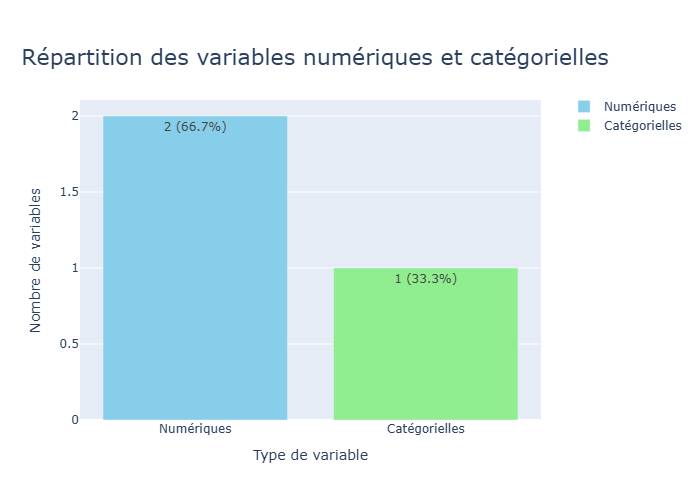

In [900]:
# Visualisation de la répartition des variables numériques et catégorielles.

num_cat_appli_train = plot_num_cat_distribution(df= df_bureau_balance,
                          chart_type='bar',
                          title="Répartition des variables numériques et catégorielles",
                          annotation_format= 'both',
                          title_size=22,
                          title_x= 0.45,
                          title_y= 0.90,
                          legend_x= 1.05,
                          legend_y= 0.95,
                          width=800,
                          height=800
)

num_cat_appli_train.show()

##### - Valeurs aberrantes de df_bureau_balance

In [901]:
# Liste des variables catégorielles du dataframe.

df_bureau_balance.select_dtypes(include=['object']).nunique()

STATUS    8
dtype: int64

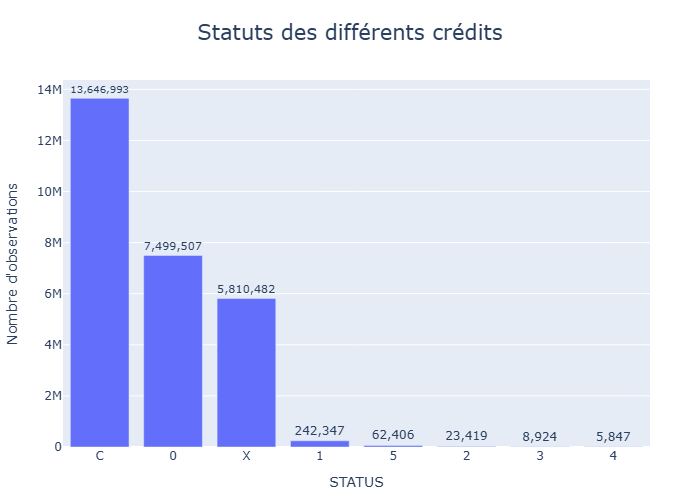

In [902]:
# Visualisation de la répartition pour la variable "STATUS"

plot_histogram_categorical(
    df=df_bureau_balance,
    x="STATUS",
    title="Statuts des différents crédits",
    title_font_size=21
)

- Pour la seule variable catégorielle on a pas constaté de valeurs aberrantes, on peut donc passer aux variables quantitatives:

In [903]:
# Liste des variables quantitatives du dataframe.

pprint.pprint(df_bureau_balance.select_dtypes(exclude=['object']).columns.tolist())

['SK_ID_BUREAU', 'MONTHS_BALANCE']


In [904]:
df_bureau_balance['MONTHS_BALANCE'].describe().round(0)

count    27299925.0
mean          -31.0
std            24.0
min           -96.0
25%           -46.0
50%           -25.0
75%           -11.0
max             0.0
Name: MONTHS_BALANCE, dtype: float64

- Pour les périodes en mois des différents crédit dans la base de données, on a bien que des valeurs négatives puisque l'on regarde dans le passé (avec 0 la période la plus récente) et cela va jusque -96 qui représente 8 années d'annuités au maximum donc **pas de valeurs aberrantes** particulières.

On peut ensuite passé aux valeurs manquantes :

In [905]:
# Calcul du nombre et du pourcentage de valeurs manquantes pour chaque colonne.

calculate_missing_values(df_bureau_balance)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


- **Pas de valeurs manquantes** dans ce fichier, on va donc procéder au *merge* avec bureau. csv pour récuperer l'ID des clients pour chaque crédit puis on réalisera la séparation train/test et l'agrégation au niveau des clients comme pour bureau.

In [907]:
df_bureau_balance = df_bureau_balance.merge(df_init_bureau[['SK_ID_BUREAU', 'SK_ID_CURR']], on='SK_ID_BUREAU', how='left')
df_bureau_balance

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS,SK_ID_CURR
0,5715448,0,C,380361.0
1,5715448,-1,C,380361.0
2,5715448,-2,C,380361.0
3,5715448,-3,C,380361.0
4,5715448,-4,C,380361.0
...,...,...,...,...
27299920,5041336,-47,X,101874.0
27299921,5041336,-48,X,101874.0
27299922,5041336,-49,X,101874.0
27299923,5041336,-50,X,101874.0


In [908]:
# Séparation des données train et test.

df_bureau_balance_train = df_bureau_balance[df_bureau_balance['SK_ID_CURR'].isin(df_appli_train['SK_ID_CURR'])]
df_bureau_balance_test  = df_bureau_balance[df_bureau_balance['SK_ID_CURR'].isin(df_appli_test['SK_ID_CURR'])]

On peut maintenant à l'encodage de l'unique variable catégorielle en utilisant OHE puisque l'on a 8 modalités possibles

In [909]:
# Nouvelle séparation avant l'encoding OHE (pour la cohérence avec ce que je fais avec l'imputation habituellement).

df_bureau_balance_train_linear = df_bureau_balance_train
df_bureau_balance_test_linear = df_bureau_balance_test

In [910]:
# Visualisation des variables à encoder avec One Hot Encoder.

ohe_var = [col for col in df_bureau_balance.columns 
                      if df_bureau_balance[col].dtype == 'object' and df_bureau_balance[col].nunique() <= 10]

print("Variables catégorielles avec One Hot Encoder :", ohe_var)

Variables catégorielles avec One Hot Encoder : ['STATUS']


In [911]:
# Encodage des variables catégorielles avec One Hot Encoder.


# Liste des datasets à encoder
datasets_linear = [
    df_bureau_balance_train_linear,
    df_bureau_balance_test_linear
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe_linear = one_hot_encode(datasets_linear, columns=ohe_var, drop_first=True)

df_bureau_balance_train_linear = encoded_ohe_linear[0]
df_bureau_balance_test_linear = encoded_ohe_linear[1]


# Liste des datasets à encoder
datasets = [
    df_bureau_balance_train,
    df_bureau_balance_test
]

# Application du One-Hot Encoding sur tous les datasets
encoded_ohe = one_hot_encode(datasets, columns=ohe_var, drop_first=False)

df_bureau_balance_train = encoded_ohe[0]
df_bureau_balance_test = encoded_ohe[1]

In [912]:
df_bureau_balance_train_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14701612 entries, 0 to 27299924
Data columns (total 10 columns):
 #   Column          Dtype  
---  ------          -----  
 0   SK_ID_BUREAU    int64  
 1   MONTHS_BALANCE  int64  
 2   SK_ID_CURR      float64
 3   STATUS_1        float64
 4   STATUS_2        float64
 5   STATUS_3        float64
 6   STATUS_4        float64
 7   STATUS_5        float64
 8   STATUS_C        float64
 9   STATUS_X        float64
dtypes: float64(8), int64(2)
memory usage: 1.2 GB


In [913]:
df_bureau_balance_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14701612 entries, 0 to 27299924
Data columns (total 11 columns):
 #   Column          Dtype  
---  ------          -----  
 0   SK_ID_BUREAU    int64  
 1   MONTHS_BALANCE  int64  
 2   SK_ID_CURR      float64
 3   STATUS_0        float64
 4   STATUS_1        float64
 5   STATUS_2        float64
 6   STATUS_3        float64
 7   STATUS_4        float64
 8   STATUS_5        float64
 9   STATUS_C        float64
 10  STATUS_X        float64
dtypes: float64(9), int64(2)
memory usage: 1.3 GB


- L'encodage a bien été réalisé en prenant en compte le fait qu'ils seront utilisés soit pour des modèles linéaires soit pour des modèles non linéaires, on peut passer à la suite du feature enginnering.

In [914]:
# Fonction ajoutant quelques features intéressantes pour ce fichier

def add_bureau_balance_features(df):

    """
    Ajoute des features dérivées du dataset bureau_balance.csv de Home Credit Default Risk.
    df : DataFrame pandas
    """

    df = df.copy()

    # Colonnes OHE attendues
    status_cols = {
        "STATUS_0": 0,
        "STATUS_1": 1,
        "STATUS_2": 2,
        "STATUS_3": 3,
        "STATUS_4": 4,
        "STATUS_5": 5,
        "STATUS_C": 0,
        "STATUS_X": 0
    }

    # Garder uniquement les colonnes présentes dans df
    status_cols = {col: val for col, val in status_cols.items() if col in df.columns}

    # Reconstruction de STATUS_NUM
    if len(status_cols) > 0:
        df["STATUS_NUM"] = sum(df[col] * val for col, val in status_cols.items())
    else:
        raise ValueError("Aucune colonne STATUS_* trouvée dans df. Impossible de créer STATUS_NUM.")

    # Variables dérivées
    df["IS_LATE"] = (df["STATUS_NUM"] > 0).astype(int)
    df["IS_SERIOUS_LATE"] = (df["STATUS_NUM"] >= 3).astype(int)
    df["IS_MAX_LATE"] = (df["STATUS_NUM"] == 5).astype(int)

    return df

In [916]:
# Ajout des nouvelles variables à l'aide la fonction créée précédemment.

df_bureau_balance_train_linear_nf = add_bureau_balance_features(df_bureau_balance_train_linear)
df_bureau_balance_train_nf = add_bureau_balance_features(df_bureau_balance_train)
df_bureau_balance_test_linear_nf = add_bureau_balance_features(df_bureau_balance_test_linear)
df_bureau_balance_test_nf = add_bureau_balance_features(df_bureau_balance_test)

In [918]:
# Suppression de "SK_ID_CURR" pour réaliser une première agrégation par crédit.

df_bureau_balance_train_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_bureau_balance_train_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_bureau_balance_test_linear_nf.drop(columns=["SK_ID_CURR"], inplace=True)
df_bureau_balance_test_nf.drop(columns=["SK_ID_CURR"], inplace=True)

In [922]:
def aggregate_bureau_balance_by_credit(df):
    """
    Agrégation du fichier bureau_balance au niveau des crédits (SK_ID_BUREAU).
    df : DataFrame pandas
    """

    data = df.copy()

    # Colonnes à exclure
    exclude_cols = ["MONTHS_BALANCE"]

    # Séparation
    numeric_cols = [c for c in data.columns if c not in exclude_cols + ["SK_ID_BUREAU"]]
    
    ohe_cols = [c for c in numeric_cols if c.startswith("STATUS_")]
    derived_cols = [c for c in numeric_cols if c.startswith("IS_")]

    # Dictionnaire d'aggrégation
    agg_dict = {}

    if "STATUS_NUM" in data.columns:
        agg_dict["STATUS_NUM"] = ["mean", "max", "min", "std"]

    for col in derived_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    df_credit = data.groupby("SK_ID_BUREAU").agg(agg_dict)

    # Renommage
    df_credit.columns = [
        f"BUREAU_BAL_{col.upper()}_{stat.upper()}"
        for col, stat in df_credit.columns
    ]

    df_credit.reset_index(inplace=True)

    # Ajout du nombre total de mois pour ce crédit
    df_credit["BUREAU_BAL_NB_MONTHS"] = (
        df.groupby("SK_ID_BUREAU")["MONTHS_BALANCE"].count().values
    )

    return df_credit

In [920]:
# Agrégation au niveau des crédits dans un premier temps.

df_bureau_balance_train_linear_credit = aggregate_bureau_balance_by_credit(df_bureau_balance_train_linear_nf)
df_bureau_balance_train_credit = aggregate_bureau_balance_by_credit(df_bureau_balance_train_nf)
df_bureau_balance_test_linear_credit = aggregate_bureau_balance_by_credit(df_bureau_balance_test_linear_nf)
df_bureau_balance_test_credit = aggregate_bureau_balance_by_credit(df_bureau_balance_test_nf)

In [921]:
def aggregate_bureau_balance_df(df):
    """
    Agrège le dataframe bureau_balance déjà agrégé au niveau crédit, au niveau client (SK_ID_CURR).
    df : DataFrame pandas
    """

    data = df.copy()

    # Colonnes exclues
    exclude_cols = ["SK_ID_BUREAU"]

    # Colonnes numériques
    numeric_cols = [
        c for c in data.columns
        if c not in exclude_cols + ["SK_ID_CURR"]
        and pd.api.types.is_numeric_dtype(data[c])
    ]

    # Agrégations d’indicateurs (déjà agrégés par crédit)
    derived_cols = [c for c in numeric_cols if "IS_" in c]

    # OHE agrégés (BUREAU_BAL_STATUS_)
    ohe_cols = [c for c in numeric_cols if c.startswith("BUREAU_BAL_STATUS_")]

    # Nombre de mois par crédit
    nb_months_col = [c for c in numeric_cols if c.endswith("NB_MONTHS")]

    # Autres colonnes numériques (moyennes, max, etc.)
    other_numeric = [
        c for c in numeric_cols
        if c not in derived_cols + ohe_cols + nb_months_col
    ]

    # Dictionnaire d’agrégation
    agg_dict = {}

    # Colonnes dérivées : on re-agrège au niveau client
    for col in derived_cols:
        agg_dict[col] = ["mean", "sum", "max"]

    # Colonnes OHE déjà agrégées (ex : BUREAU_BAL_STATUS_0_MEAN)
    for col in ohe_cols:
        agg_dict[col] = ["mean", "sum"]

    # Nombre de mois : somme sur les crédits
    for col in nb_months_col:
        agg_dict[col] = ["sum", "mean"]

    # Autres colonnes : re-moyenne au niveau client
    for col in other_numeric:
        agg_dict[col] = ["mean", "max", "min"]

    # --- Agrégation principale ---
    bureau_balance_agg = data.groupby("SK_ID_CURR").agg(agg_dict)

    # Renommage propre
    bureau_balance_agg.columns = [
        f"{col.upper()}_{stat.upper()}"
        for col, stat in bureau_balance_agg.columns
    ]

    bureau_balance_agg.reset_index(inplace=True)

    # Nettoyage
    bureau_balance_agg.replace([np.inf, -np.inf], np.nan, inplace=True)

    print(f"Agrégation bureau_balance (niveau client) – shape : {bureau_balance_agg.shape}")
    return bureau_balance_agg

In [923]:
# Rajout de la variable ID client aux dataframes

df_bureau_balance_train_linear_credit = df_bureau_balance_train_linear_credit.merge(df_init_bureau[['SK_ID_BUREAU', 'SK_ID_CURR']], on='SK_ID_BUREAU', how='left')
df_bureau_balance_train_credit = df_bureau_balance_train_credit.merge(df_init_bureau[['SK_ID_BUREAU', 'SK_ID_CURR']], on='SK_ID_BUREAU', how='left')
df_bureau_balance_test_linear_credit = df_bureau_balance_test_linear_credit.merge(df_init_bureau[['SK_ID_BUREAU', 'SK_ID_CURR']], on='SK_ID_BUREAU', how='left')
df_bureau_balance_test_credit = df_bureau_balance_test_credit.merge(df_init_bureau[['SK_ID_BUREAU', 'SK_ID_CURR']], on='SK_ID_BUREAU', how='left')

In [924]:
# Agrégation au niveau des clients dans un deuxième temps.

df_bureau_balance_train_linear_agg = aggregate_bureau_balance_df(df_bureau_balance_train_linear_credit)
df_bureau_balance_train_agg = aggregate_bureau_balance_df(df_bureau_balance_train_credit)
df_bureau_balance_test_linear_agg = aggregate_bureau_balance_df(df_bureau_balance_test_linear_credit)
df_bureau_balance_test_agg = aggregate_bureau_balance_df(df_bureau_balance_test_credit)

Agrégation bureau_balance (niveau client) – shape : (92231, 62)
Agrégation bureau_balance (niveau client) – shape : (92231, 66)
Agrégation bureau_balance (niveau client) – shape : (42311, 62)
Agrégation bureau_balance (niveau client) – shape : (42311, 66)


In [930]:
calculate_missing_values(df_bureau_balance_train_linear_agg)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


In [963]:
# Merge final avec les dataframes principaux application train/test.

df_train_median_mode_linear = df_train_median_mode_linear.merge(
    df_bureau_balance_train_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_median_missing_linear = df_train_median_missing_linear.merge(
    df_bureau_balance_train_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_iterative_mode_linear = df_train_iterative_mode_linear.merge(
    df_bureau_balance_train_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_train_nan_missing_linear = df_train_nan_missing_linear.merge(
    df_bureau_balance_train_linear_agg, on="SK_ID_CURR", how="left"
)

df_train_median_mode = df_train_median_mode.merge(
    df_bureau_balance_train_agg, on="SK_ID_CURR", how="left"
)

df_train_median_missing = df_train_median_missing.merge(
    df_bureau_balance_train_agg, on="SK_ID_CURR", how="left"
)

df_train_iterative_mode = df_train_iterative_mode.merge(
    df_bureau_balance_train_agg, on="SK_ID_CURR", how="left"
)

df_train_nan_missing = df_train_nan_missing.merge(
    df_bureau_balance_train_agg, on="SK_ID_CURR", how="left"
)

# Merge des pairs bureau/application pour les datasets test

df_test_median_mode_linear = df_test_median_mode_linear.merge(
    df_bureau_balance_test_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_median_missing_linear = df_test_median_missing_linear.merge(
    df_bureau_balance_test_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_iterative_mode_linear = df_test_iterative_mode_linear.merge(
    df_bureau_balance_test_linear_agg, on="SK_ID_CURR", how="left"
).fillna(0)

df_test_nan_missing_linear = df_test_nan_missing_linear.merge(
    df_bureau_balance_test_linear_agg, on="SK_ID_CURR", how="left"
)

df_test_median_mode = df_test_median_mode.merge(
    df_bureau_balance_test_agg, on="SK_ID_CURR", how="left"
)

df_test_median_missing = df_test_median_missing.merge(
    df_bureau_balance_test_agg, on="SK_ID_CURR", how="left"
)

df_test_iterative_mode = df_test_iterative_mode.merge(
    df_bureau_balance_test_agg, on="SK_ID_CURR", how="left"
)

df_test_nan_missing = df_test_nan_missing.merge(
    df_bureau_balance_test_agg, on="SK_ID_CURR", how="left"
)

In [968]:
# Visualisation des changements apportés.

df_train_median_mode_linear.info(display)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307500 entries, 0 to 307499
Data columns (total 245 columns):
 #    Column                                   Dtype  
---   ------                                   -----  
 0    SK_ID_CURR                               int32  
 1    TARGET                                   int32  
 2    NAME_CONTRACT_TYPE                       Int64  
 3    CODE_GENDER                              Int64  
 4    FLAG_OWN_CAR                             Int64  
 5    FLAG_OWN_REALTY                          Int64  
 6    AMT_ANNUITY                              float32
 7    REGION_POPULATION_RELATIVE               float32
 8    OWN_CAR_AGE                              int32  
 9    FLAG_MOBIL                               int32  
 10   FLAG_WORK_PHONE                          int32  
 11   FLAG_CONT_MOBILE                         int32  
 12   FLAG_PHONE                               int32  
 13   FLAG_EMAIL                               int32  
 14   OC

In [967]:
calculate_missing_values(df_train_median_mode_linear)

,Nbr_valeurs_manquantes,Pct_valeurs_manquantes


#### Corrélation des variables - df_train_median_mode_linear

In [969]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_mode_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.992668
1,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.992420
2,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.992420
3,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.990745
4,BUREAU_BAL_IS_MAX_LATE_SUM_SUM / BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,0.990745
5,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_NUM_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_NUM_SUM_MEAN,0.989387
6,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.983149
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,0.983149
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,0.981919
9,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,0.981919


In [970]:
df_corr = get_correlation_pairs(df_train_median_mode_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [971]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [972]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.032813,0.025063,0.032813,0.025063,0.028938
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.032081,0.024737,0.032081,0.024737,0.028409
BUREAU_BAL_IS_LATE_MEAN_MAX,0.030307,0.024851,0.030307,0.024851,0.027579
BUREAU_BAL_STATUS_1_MEAN_SUM,0.028139,0.024999,0.028139,0.024999,0.026569
BUREAU_BAL_IS_LATE_MEAN_SUM,0.027397,0.024687,0.027397,0.024687,0.026042
BUREAU_BAL_IS_LATE_MAX_MEAN,0.026181,0.023870,0.026181,0.023870,0.025026
BUREAU_BAL_IS_LATE_MAX_MAX,0.023191,0.023191,0.023191,0.023191,0.023191
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.020230,0.024617,0.020230,0.024617,0.022424
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.017221,0.024577,0.017221,0.024577,0.020899
BUREAU_BAL_IS_LATE_SUM_MEAN,0.016947,0.023758,0.016947,0.023758,0.020352


In [973]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode_linear, y=df_train_median_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_SUM_MEAN, BUREAU_BAL_STATUS_1_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX]",31,0.032813,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_NB_MONTHS_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",3,0.021752,BUREAU_BAL_STATUS_C_SUM_SUM
2,"[BUREAU_BAL_NB_MONTHS_MEAN, BUREAU_BAL_STATUS_C_MEAN_MEAN, BUREAU_BAL_STATUS_C_SUM_MEAN]",3,0.026274,BUREAU_BAL_STATUS_C_SUM_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM]",2,0.008727,BUREAU_BAL_STATUS_4_MEAN_SUM
4,"[BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM]",2,0.011019,BUREAU_BAL_STATUS_X_SUM_SUM
5,"[BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_SUM_SUM]",2,0.008725,BUREAU_BAL_STATUS_3_MEAN_SUM
6,"[BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",2,0.011478,BUREAU_BAL_STATUS_2_MEAN_SUM
7,"[BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN]",2,0.012433,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
8,"[BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",2,0.009059,BUREAU_BAL_STATUS_4_SUM_MEAN
9,"[BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX]",2,0.009183,BUREAU_BAL_IS_MAX_LATE_MAX_MAX


In [974]:
pd.reset_option('display.max_colwidth')

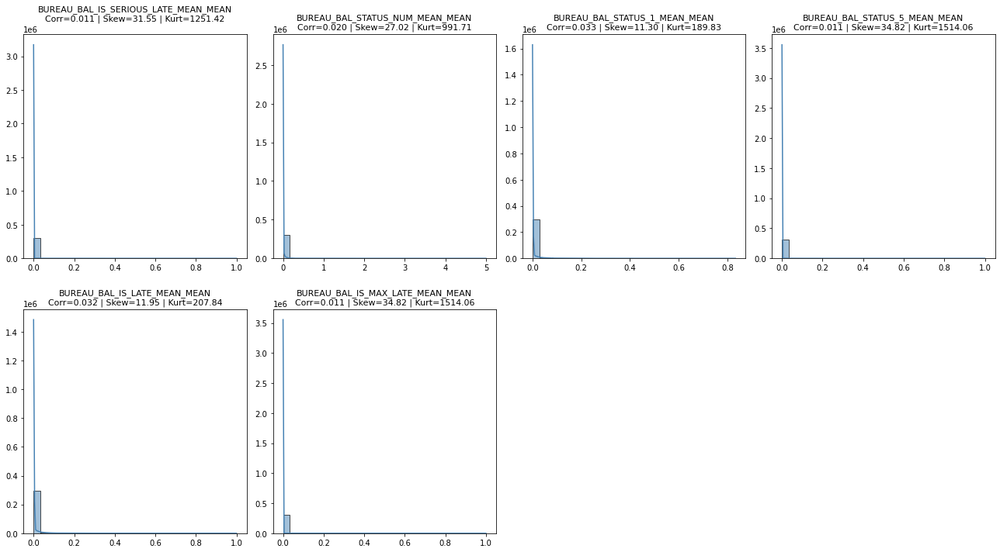

In [975]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_MEAN_MEAN', 
            'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

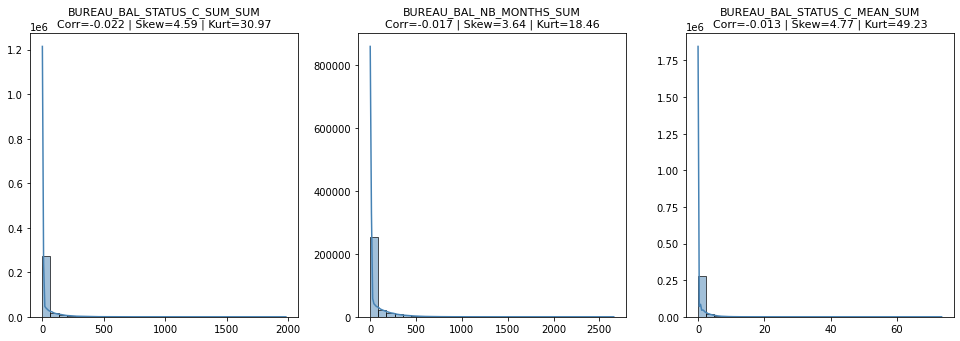

In [976]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_C_SUM_SUM', 'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

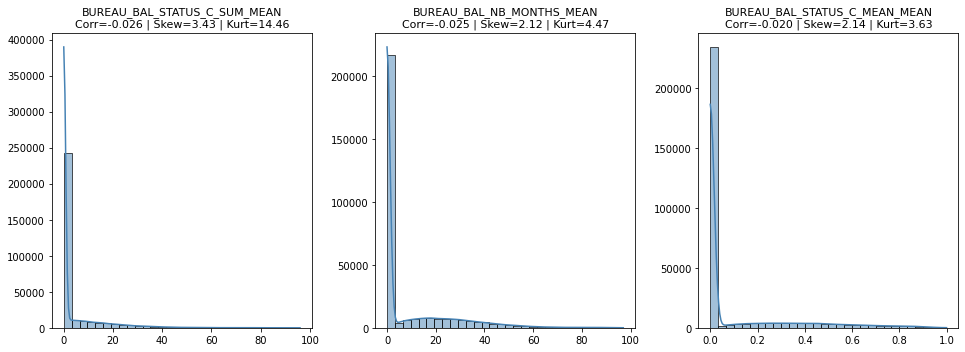

In [977]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_NB_MONTHS_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

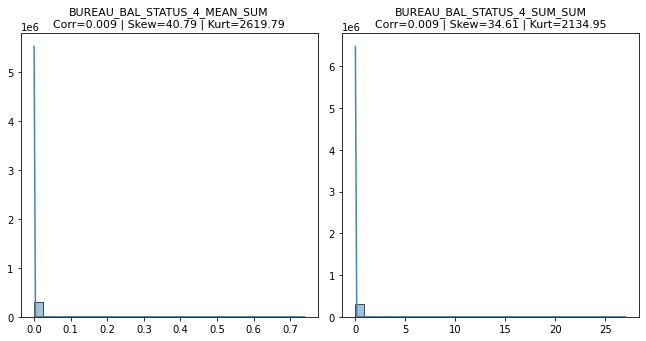

In [978]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

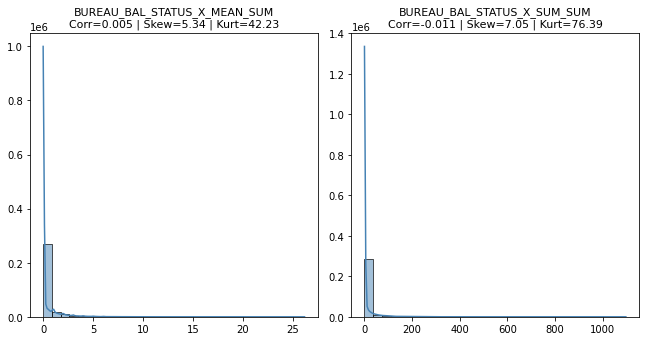

In [979]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

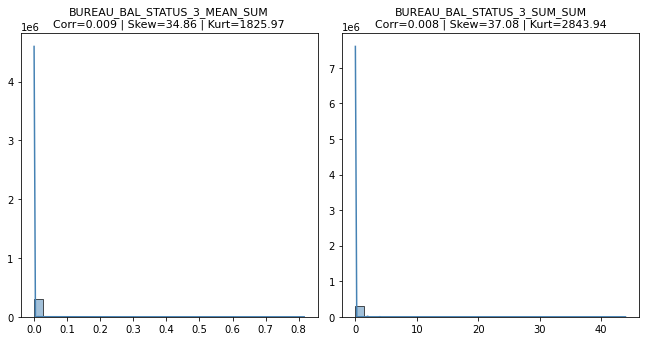

In [980]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_3_MEAN_SUM', 'BUREAU_BAL_STATUS_3_SUM_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

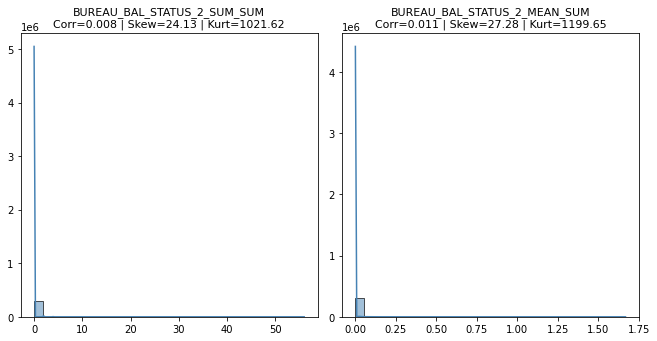

In [981]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

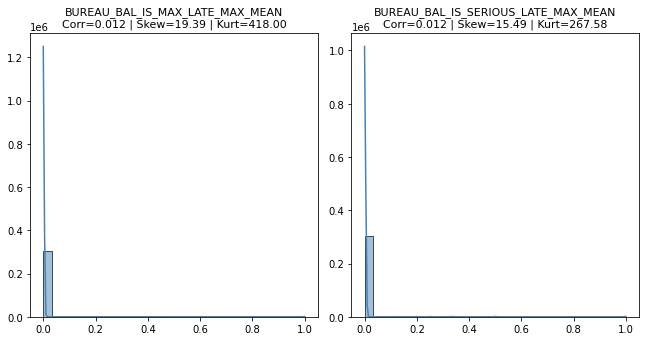

In [982]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

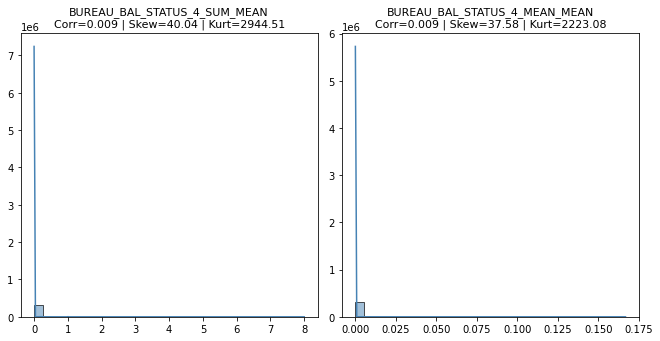

In [983]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

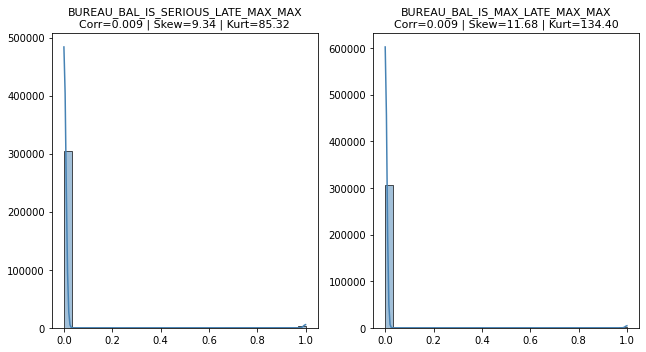

In [984]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_MAX_LATE_MAX_MAX']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

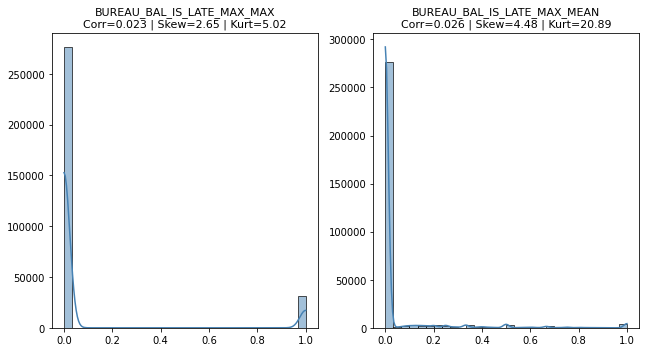

In [985]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode_linear,
    var_list=transfos,
    target='TARGET'
)

In [986]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_train_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [987]:
remaining_cols = list(set(df_bureau_balance_train_linear_agg.columns).intersection(df_train_median_mode_linear.columns))

In [988]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [989]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode_linear)

 Mémoire avant : 318.56 MB
 Mémoire après : 296.27 MB
 Gain : 7.0%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.0,0.0,0.0,0.0,0,23,0.161932,1.295455,1.875000,13.750000
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0.0,0.0,0.0,0.0,0,57,0.135417,0.541667,3.250000,29.250000
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.0,0.0,0.0,0.0,0,29,0.000000,0.000000,0.000000,37.000000


#### Corrélation des variables - df_train_median_missing_linear

In [990]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.992668
1,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.992420
2,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.992420
3,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.990745
4,BUREAU_BAL_IS_MAX_LATE_SUM_SUM / BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,0.990745
5,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_NUM_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_NUM_SUM_MEAN,0.989387
6,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.983149
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,0.983149
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,0.981919
9,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,0.981919


In [991]:
df_corr = get_correlation_pairs(df_train_median_missing_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [992]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [993]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_missing_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.032813,0.025063,0.032813,0.025063,0.028938
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.032081,0.024737,0.032081,0.024737,0.028409
BUREAU_BAL_IS_LATE_MEAN_MAX,0.030307,0.024851,0.030307,0.024851,0.027579
BUREAU_BAL_STATUS_1_MEAN_SUM,0.028139,0.024999,0.028139,0.024999,0.026569
BUREAU_BAL_IS_LATE_MEAN_SUM,0.027397,0.024687,0.027397,0.024687,0.026042
BUREAU_BAL_IS_LATE_MAX_MEAN,0.026181,0.023870,0.026181,0.023870,0.025026
BUREAU_BAL_IS_LATE_MAX_MAX,0.023191,0.023191,0.023191,0.023191,0.023191
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.020230,0.024617,0.020230,0.024617,0.022424
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.017221,0.024577,0.017221,0.024577,0.020899
BUREAU_BAL_IS_LATE_SUM_MEAN,0.016947,0.023758,0.016947,0.023758,0.020352


In [994]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing_linear, y=df_train_median_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_SUM_MEAN, BUREAU_BAL_STATUS_1_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX]",31,0.032813,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_NB_MONTHS_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",3,0.021752,BUREAU_BAL_STATUS_C_SUM_SUM
2,"[BUREAU_BAL_NB_MONTHS_MEAN, BUREAU_BAL_STATUS_C_MEAN_MEAN, BUREAU_BAL_STATUS_C_SUM_MEAN]",3,0.026274,BUREAU_BAL_STATUS_C_SUM_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM]",2,0.008727,BUREAU_BAL_STATUS_4_MEAN_SUM
4,"[BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM]",2,0.011019,BUREAU_BAL_STATUS_X_SUM_SUM
5,"[BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_SUM_SUM]",2,0.008725,BUREAU_BAL_STATUS_3_MEAN_SUM
6,"[BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",2,0.011478,BUREAU_BAL_STATUS_2_MEAN_SUM
7,"[BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN]",2,0.012433,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
8,"[BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",2,0.009059,BUREAU_BAL_STATUS_4_SUM_MEAN
9,"[BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX]",2,0.009183,BUREAU_BAL_IS_MAX_LATE_MAX_MAX


In [995]:
pd.reset_option('display.max_colwidth')

- On retrouve les mêmes corrélations que le dataframe précédent donc on applique un traitement identique.

In [996]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_train_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [997]:
remaining_cols = list(set(df_bureau_balance_train_linear_agg.columns).intersection(df_train_median_missing_linear.columns))

In [998]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [999]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing_linear)

 Mémoire avant : 324.33 MB
 Mémoire après : 300.87 MB
 Gain : 7.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,24700.5,0.018801,9,1,...,0.0,0.0,0.0,0.0,0,23,0.161932,1.295455,1.875000,13.750000
1,100003,0,0,0,0,0,35698.5,0.003541,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
3,100006,0,0,0,0,1,29686.5,0.008019,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
4,100007,0,0,1,0,1,21865.5,0.028663,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307496,456252,0,0,0,0,1,12001.5,0.025164,9,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307497,456253,0,0,0,0,1,29979.0,0.005002,9,1,...,0.0,0.0,0.0,0.0,0,57,0.135417,0.541667,3.250000,29.250000
307498,456254,1,0,0,0,1,20205.0,0.005313,9,1,...,0.0,0.0,0.0,0.0,0,29,0.000000,0.000000,0.000000,37.000000


#### Corrélation des variables - df_train_iterative_mode_linear

In [1000]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.992668
1,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.992420
2,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.992420
3,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.990745
4,BUREAU_BAL_IS_MAX_LATE_SUM_SUM / BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,0.990745
5,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_NUM_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_NUM_SUM_MEAN,0.989387
6,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.983149
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,0.983149
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,0.981919
9,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,0.981919


In [1001]:
df_corr = get_correlation_pairs(df_train_iterative_mode_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [1002]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1003]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_iterative_mode_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.032813,0.025063,0.032813,0.025063,0.028938
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.032081,0.024737,0.032081,0.024737,0.028409
BUREAU_BAL_IS_LATE_MEAN_MAX,0.030307,0.024851,0.030307,0.024851,0.027579
BUREAU_BAL_STATUS_1_MEAN_SUM,0.028139,0.024999,0.028139,0.024999,0.026569
BUREAU_BAL_IS_LATE_MEAN_SUM,0.027397,0.024687,0.027397,0.024687,0.026042
BUREAU_BAL_IS_LATE_MAX_MEAN,0.026181,0.023870,0.026181,0.023870,0.025026
BUREAU_BAL_IS_LATE_MAX_MAX,0.023191,0.023191,0.023191,0.023191,0.023191
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.020230,0.024617,0.020230,0.024617,0.022424
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.017221,0.024577,0.017221,0.024577,0.020899
BUREAU_BAL_IS_LATE_SUM_MEAN,0.016947,0.023758,0.016947,0.023758,0.020352


In [1004]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode_linear, y=df_train_iterative_mode_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_SUM_MEAN, BUREAU_BAL_STATUS_1_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX]",31,0.032813,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_NB_MONTHS_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",3,0.021752,BUREAU_BAL_STATUS_C_SUM_SUM
2,"[BUREAU_BAL_NB_MONTHS_MEAN, BUREAU_BAL_STATUS_C_MEAN_MEAN, BUREAU_BAL_STATUS_C_SUM_MEAN]",3,0.026274,BUREAU_BAL_STATUS_C_SUM_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM]",2,0.008727,BUREAU_BAL_STATUS_4_MEAN_SUM
4,"[BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM]",2,0.011019,BUREAU_BAL_STATUS_X_SUM_SUM
5,"[BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_SUM_SUM]",2,0.008725,BUREAU_BAL_STATUS_3_MEAN_SUM
6,"[BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",2,0.011478,BUREAU_BAL_STATUS_2_MEAN_SUM
7,"[BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN]",2,0.012433,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
8,"[BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",2,0.009059,BUREAU_BAL_STATUS_4_SUM_MEAN
9,"[BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX]",2,0.009183,BUREAU_BAL_IS_MAX_LATE_MAX_MAX


In [1005]:
pd.reset_option('display.max_colwidth')

In [1006]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_train_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1007]:
remaining_cols = list(set(df_bureau_balance_train_linear_agg.columns).intersection(df_train_iterative_mode_linear.columns))

In [1008]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1009]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode_linear)

 Mémoire avant : 327.94 MB
 Mémoire après : 304.48 MB
 Gain : 7.2%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,24700.5,0.018801,19.190525,1,...,0.0,0.0,0.0,0.0,0,23,0.161932,1.295455,1.875000,13.750000
1,100003,0,0,0,0,0,35698.5,0.003541,16.384478,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
2,100004,0,1,1,1,1,6750.0,0.010032,26.000000,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
3,100006,0,0,0,0,1,29686.5,0.008019,12.254097,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
4,100007,0,0,1,0,1,21865.5,0.028663,14.331113,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,15.271110,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307496,456252,0,0,0,0,1,12001.5,0.025164,16.182379,1,...,0.0,0.0,0.0,0.0,0,0,0.000000,0.000000,0.000000,0.000000
307497,456253,0,0,0,0,1,29979.0,0.005002,9.702058,1,...,0.0,0.0,0.0,0.0,0,57,0.135417,0.541667,3.250000,29.250000
307498,456254,1,0,0,0,1,20205.0,0.005313,15.203474,1,...,0.0,0.0,0.0,0.0,0,29,0.000000,0.000000,0.000000,37.000000


#### Corrélation des variables - df_train_nan_missing_linear

In [1010]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.992683
1,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.992424
2,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.992424
3,BUREAU_BAL_IS_MAX_LATE_SUM_SUM / BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,0.990744
4,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.990744
5,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN / BUREAU_BAL_STATUS_NUM_SUM_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN,BUREAU_BAL_STATUS_NUM_SUM_MEAN,0.989950
6,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,0.983108
7,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.983108
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,0.981881
9,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,0.981881


In [1011]:
df_corr = get_correlation_pairs(df_train_nan_missing_linear[df_bureau_balance_train_linear_agg.columns.tolist()], method="pearson", style=False, threshold=0.8)

In [1012]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1013]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_nan_missing_linear.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='linear', plot=False)
target_corr.loc[var_corr].sort_values(by='pearson_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,score_global
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.061183,0.057176,0.061183,0.057176,0.059179
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.059677,0.056922,0.059677,0.056922,0.058299
BUREAU_BAL_IS_LATE_MEAN_MAX,0.057457,0.057706,0.057457,0.057706,0.057581
BUREAU_BAL_STATUS_1_MEAN_SUM,0.052384,0.056741,0.052384,0.056741,0.054562
BUREAU_BAL_IS_LATE_MEAN_SUM,0.050883,0.056577,0.050883,0.056577,0.053730
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.036774,0.056101,0.036774,0.056101,0.046438
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.031248,0.055823,0.031248,0.055823,0.043536
BUREAU_BAL_IS_LATE_SUM_MEAN,0.030831,0.050189,0.030831,0.050189,0.040510
BUREAU_BAL_STATUS_1_SUM_SUM,0.025571,0.049339,0.025571,0.049339,0.037455
BUREAU_BAL_IS_LATE_SUM_SUM,0.024829,0.048827,0.024829,0.048827,0.036828


In [1014]:
# Fonction permettant de visualiser les groupes de corrélations afin de faire un choix de variable.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing_linear, y=df_train_nan_missing_linear['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_STATUS_1_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX]",20,0.057457,BUREAU_BAL_IS_LATE_MEAN_MAX
1,"[BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_SUM_MEAN]",11,0.061183,BUREAU_BAL_STATUS_1_MEAN_MEAN
2,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_NB_MONTHS_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",3,0.048912,BUREAU_BAL_STATUS_C_SUM_SUM
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM]",2,0.015681,BUREAU_BAL_STATUS_4_MEAN_SUM
4,"[BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_SUM_SUM]",2,0.015657,BUREAU_BAL_STATUS_3_MEAN_SUM
5,"[BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",2,0.020657,BUREAU_BAL_STATUS_2_MEAN_SUM
6,"[BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM]",2,0.023399,BUREAU_BAL_STATUS_X_SUM_SUM
7,"[BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN]",2,0.022404,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
8,"[BUREAU_BAL_STATUS_C_MEAN_MEAN, BUREAU_BAL_STATUS_C_SUM_MEAN]",2,0.062954,BUREAU_BAL_STATUS_C_SUM_MEAN
9,"[BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",2,0.016278,BUREAU_BAL_STATUS_4_SUM_MEAN


In [1015]:
pd.reset_option('display.max_colwidth')

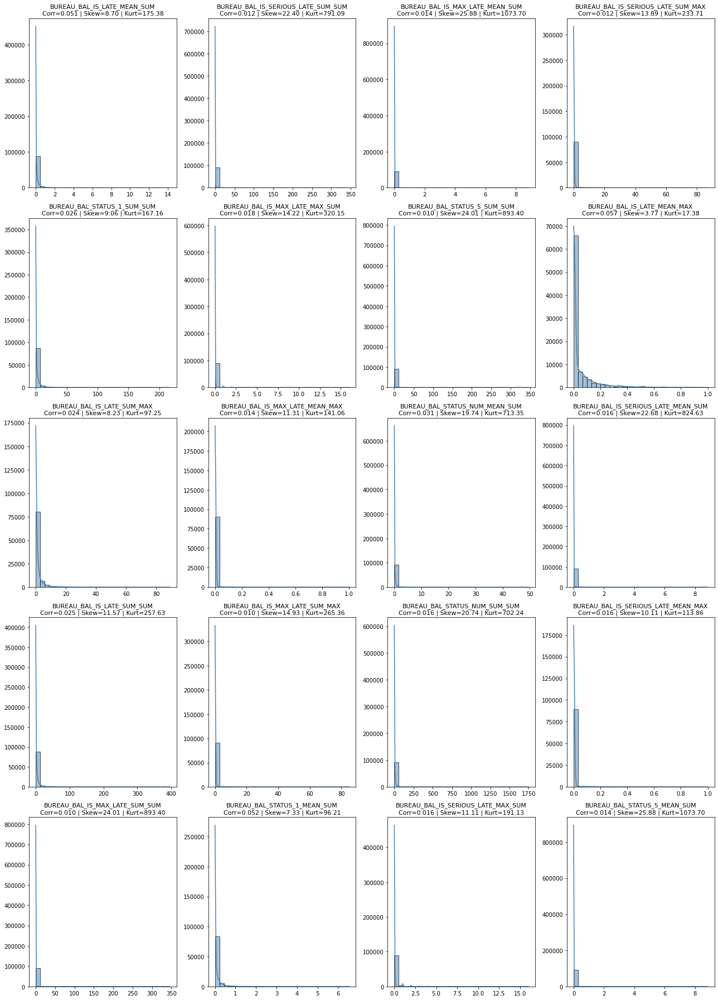

In [1016]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 
            'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 
            'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
            'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 
            'BUREAU_BAL_STATUS_NUM_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
            'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

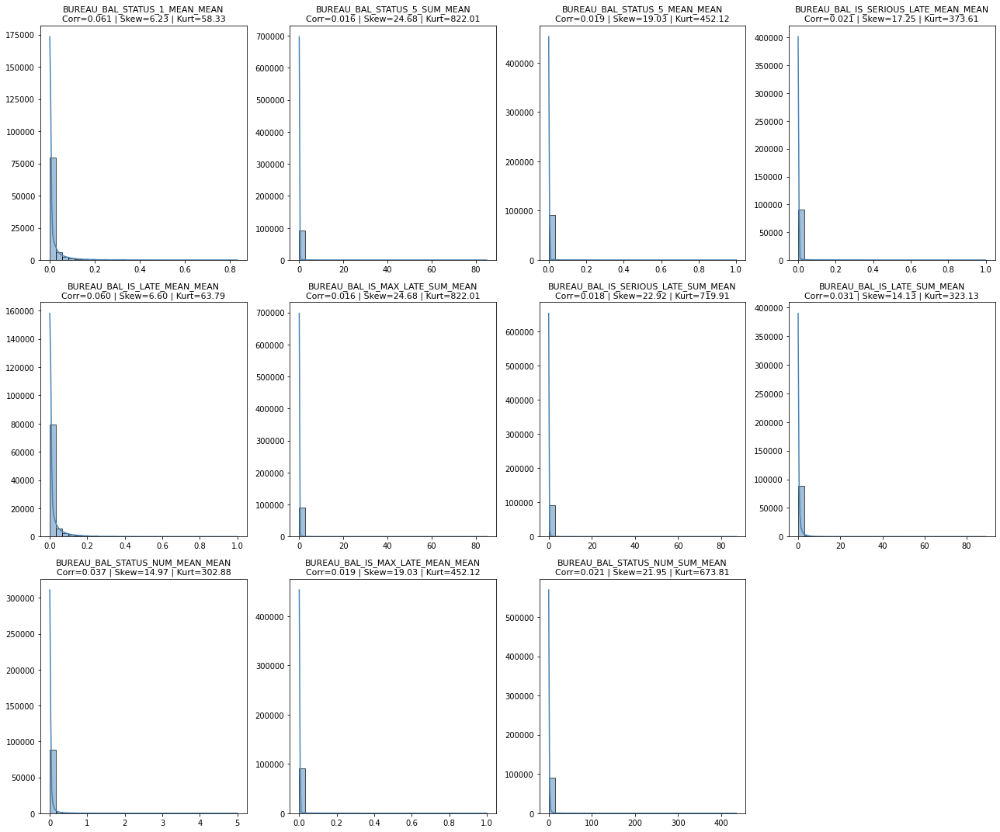

In [1017]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_1_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
            'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
            'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 
            'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

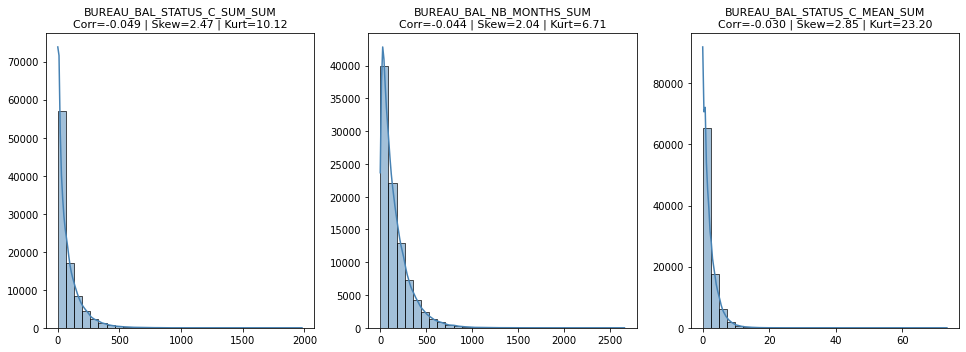

In [1018]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_C_SUM_SUM', 'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

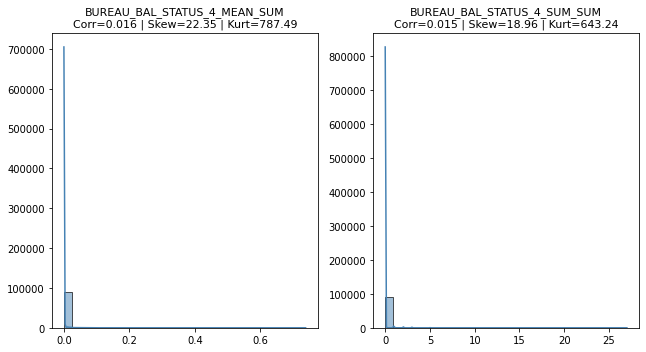

In [1019]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

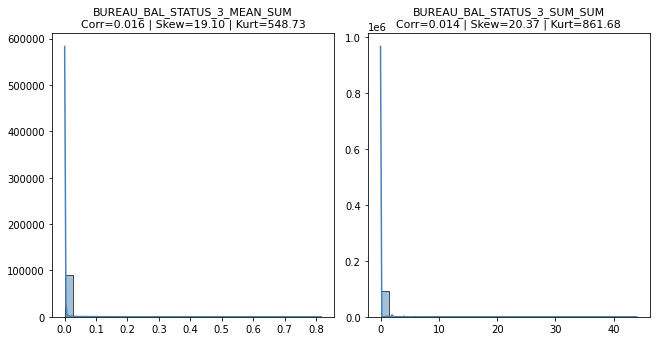

In [1020]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_3_MEAN_SUM', 'BUREAU_BAL_STATUS_3_SUM_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

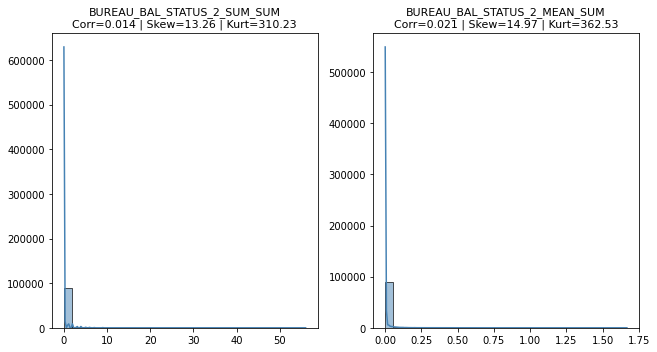

In [1021]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

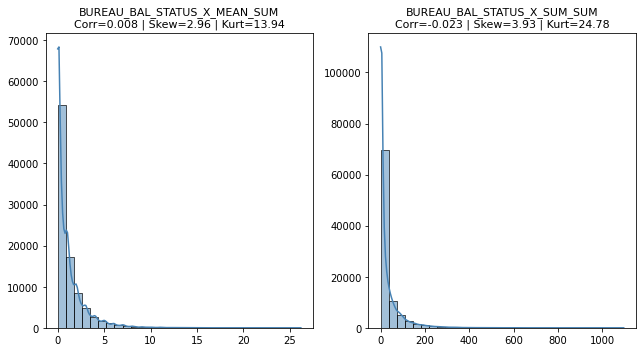

In [1022]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

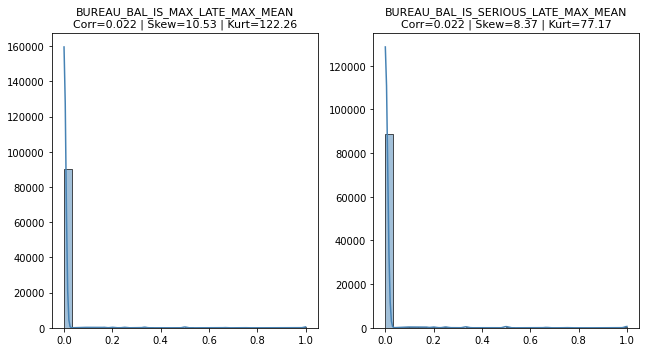

In [1023]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

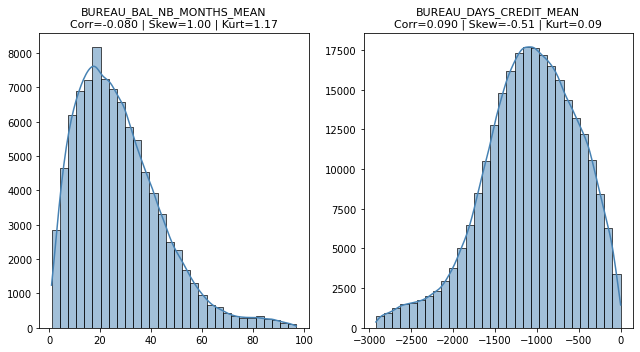

In [1024]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_NB_MONTHS_MEAN', 'BUREAU_DAYS_CREDIT_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

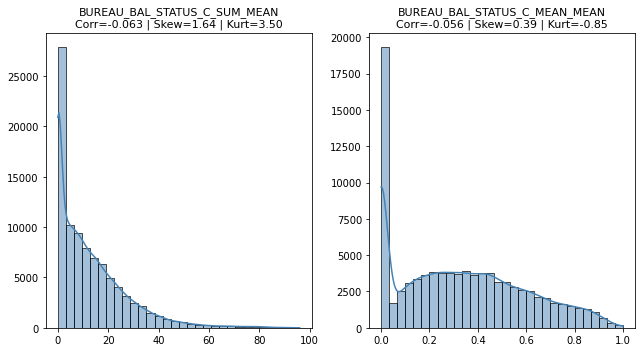

In [1025]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

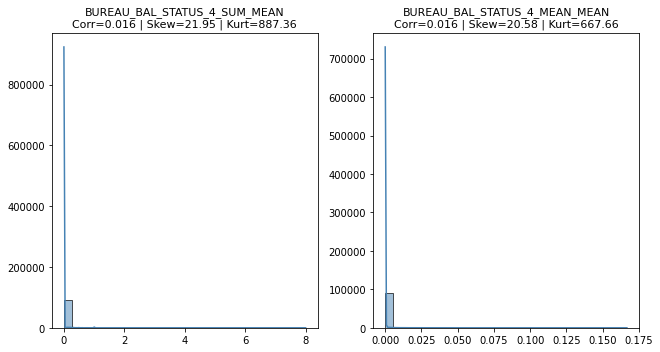

In [1026]:
# Liste des transformations corrélées pour ce groupe

transfos = ['BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_nan_missing_linear,
    var_list=transfos,
    target='TARGET'
)

In [1027]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 
    'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_NUM_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM',

    'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM', 

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_3_SUM_SUM',

    'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_SUM',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_NB_MONTHS_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN'

]

df_train_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1028]:
remaining_cols = list(set(df_bureau_balance_train_linear_agg.columns).intersection(df_train_nan_missing_linear.columns))

In [1029]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1030]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing_linear)

 Mémoire avant : 347.50 MB
 Mémoire après : 323.74 MB
 Gain : 6.8%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_SUM_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_STATUS_X_SUM_SUM
0,100002,1,0,1,0,1,24700.5,0.018801,<NA>,1,...,0.0,0.0,0.0,0.0,0,2.875000,23,0.161932,1.875000,15
1,100003,0,0,0,0,0,35698.5,0.003541,<NA>,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
2,100004,0,1,1,1,1,6750.0,0.010032,26,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
3,100006,0,0,0,0,1,29686.5,0.008019,<NA>,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
4,100007,0,0,1,0,1,21865.5,0.028663,<NA>,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,27558.0,0.032561,<NA>,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
307496,456252,0,0,0,0,1,12001.5,0.025164,<NA>,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
307497,456253,0,0,0,0,1,29979.0,0.005002,<NA>,1,...,0.0,0.0,0.0,0.0,0,14.250000,57,0.135417,3.250000,13
307498,456254,1,0,0,0,1,20205.0,0.005313,<NA>,1,...,0.0,0.0,0.0,0.0,0,29.000000,29,0.000000,0.000000,0


#### Corrélation des variables - df_train_median_mode

In [1031]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,0.999992
1,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,BUREAU_BAL_STATUS_5_MEAN_SUM,0.999992
2,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.999988
3,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,BUREAU_BAL_STATUS_5_SUM_SUM,0.999988
4,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.999985
5,BUREAU_BAL_STATUS_5_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
6,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.999985
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX,0.999982
9,BUREAU_BAL_STATUS_5_MEAN_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.999981


In [1032]:
df_corr = get_correlation_pairs(df_train_median_mode[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [1033]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1034]:
# Visualisation des corrélations les plus importantes avec la Target.

target_corr = compute_target_correlations(df_train_median_mode.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_BAL_IS_LATE_MEAN_MAX,0.057457,0.057706,0.057457,0.057706,0.000688,0.164695
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.061183,0.057176,0.061183,0.057176,0.000715,0.170626
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.059677,0.056922,0.059677,0.056922,0.000173,0.076443
BUREAU_BAL_STATUS_1_MEAN_SUM,0.052384,0.056741,0.052384,0.056741,0.000727,0.168969
BUREAU_BAL_IS_LATE_MEAN_SUM,0.050883,0.056577,0.050883,0.056577,0.000486,0.126769
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.036774,0.056101,0.036774,0.056101,0.000000,0.037150
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.031248,0.055823,0.031248,0.055823,0.000000,0.034829
BUREAU_BAL_STATUS_1_SUM_MEAN,0.033287,0.050988,0.033287,0.050988,0.000508,0.121318
BUREAU_BAL_IS_LATE_MAX_MEAN,0.050821,0.050967,0.050821,0.050967,0.001058,0.223049
BUREAU_BAL_IS_LATE_SUM_MEAN,0.030831,0.050189,0.030831,0.050189,0.000677,0.149008


In [1035]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_mode, y=df_train_median_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_IS_LATE_MAX_MEAN, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MAX_MAX, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_IS_LATE_MAX_SUM, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_SUM]",17,0.061183,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX, BUREAU_BAL_STATUS_5_SUM_MEAN]",13,0.021702,BUREAU_BAL_IS_MAX_LATE_MAX_MEAN
2,"[BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM]",9,0.022404,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM, BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",4,0.016278,BUREAU_BAL_STATUS_4_SUM_MEAN
4,"[BUREAU_BAL_STATUS_3_SUM_MEAN, BUREAU_BAL_STATUS_3_SUM_SUM, BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_MEAN_MEAN]",4,0.017464,BUREAU_BAL_STATUS_3_MEAN_MEAN
5,"[BUREAU_BAL_STATUS_2_SUM_MEAN, BUREAU_BAL_STATUS_2_MEAN_MEAN, BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",4,0.020657,BUREAU_BAL_STATUS_2_MEAN_SUM
6,"[BUREAU_BAL_STATUS_X_SUM_MEAN, BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM, BUREAU_BAL_STATUS_X_MEAN_MEAN]",4,0.033292,BUREAU_BAL_STATUS_X_SUM_MEAN
7,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",2,0.048912,BUREAU_BAL_STATUS_C_SUM_SUM


In [1036]:
pd.reset_option('display.max_colwidth')

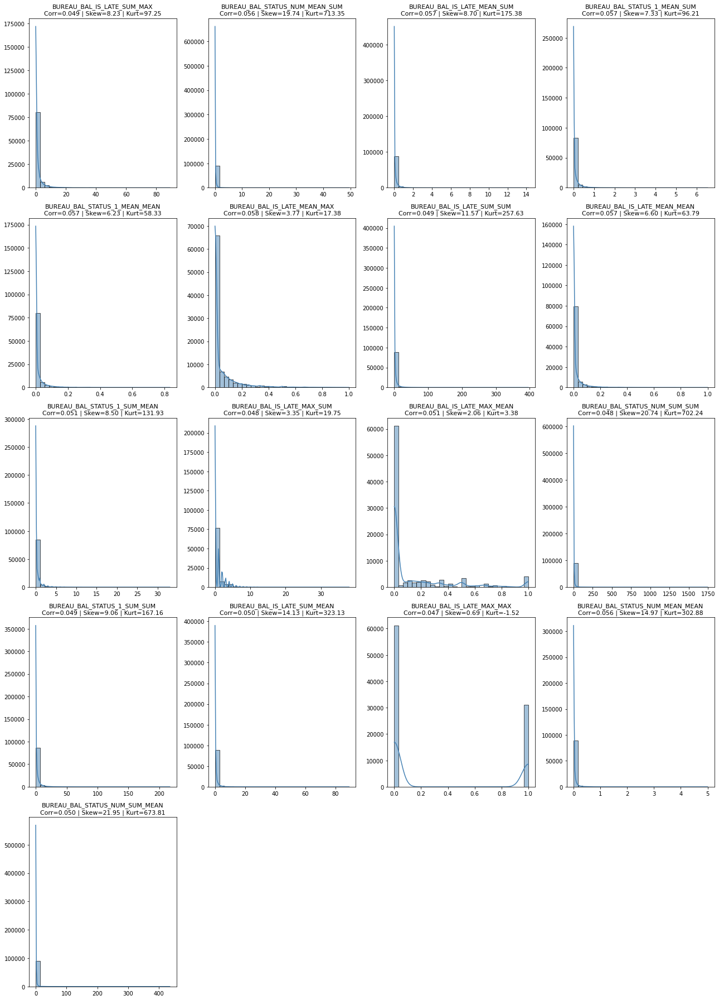

In [1037]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
            'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_STATUS_1_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
            'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
            'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
            'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
            'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

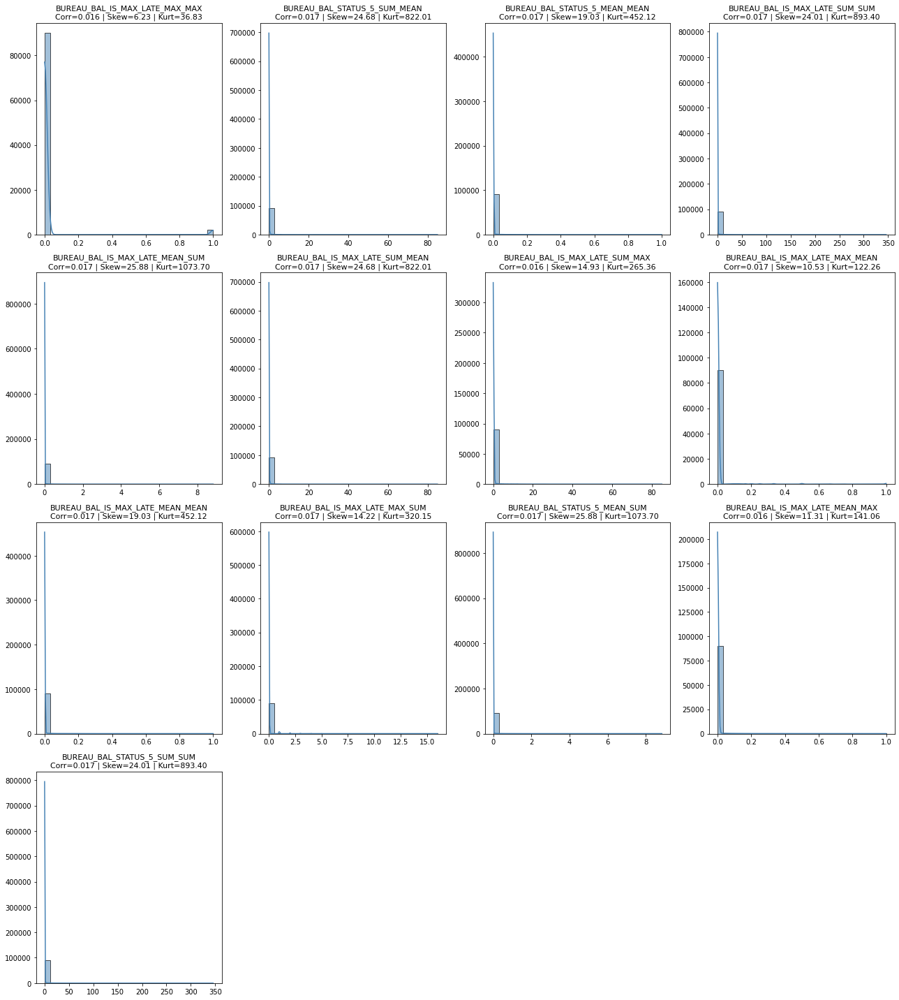

In [1038]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
            'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
            'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
            'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
            'BUREAU_BAL_STATUS_5_SUM_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

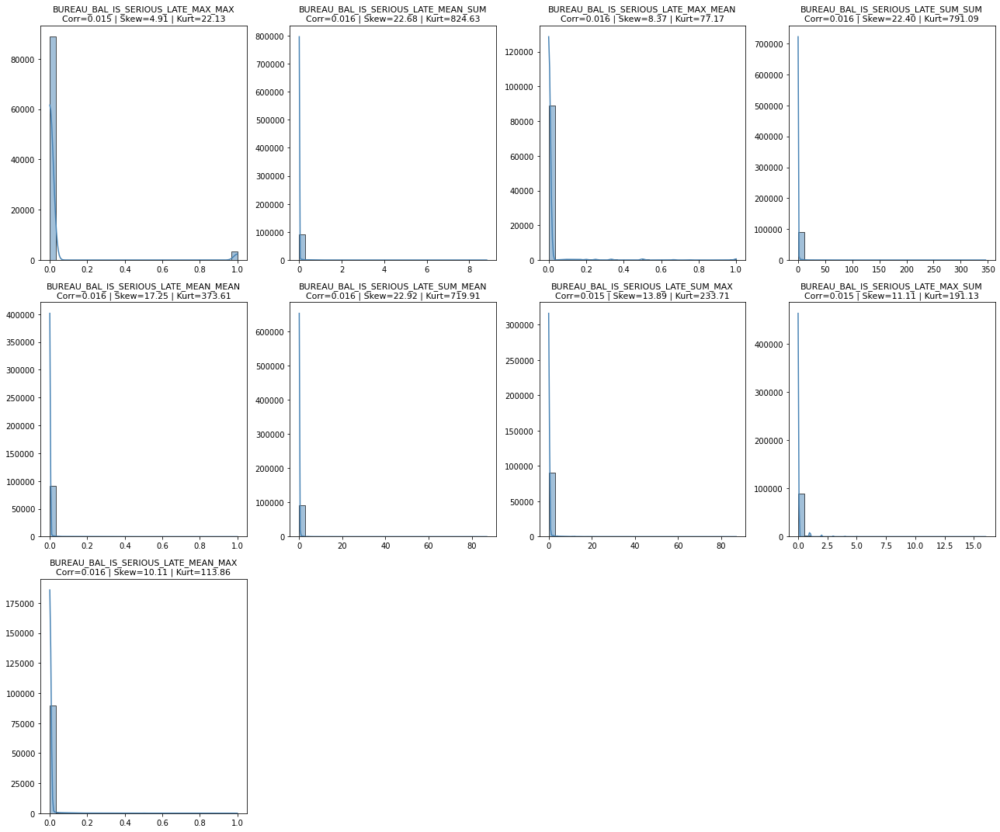

In [1039]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN', 
            'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
            'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

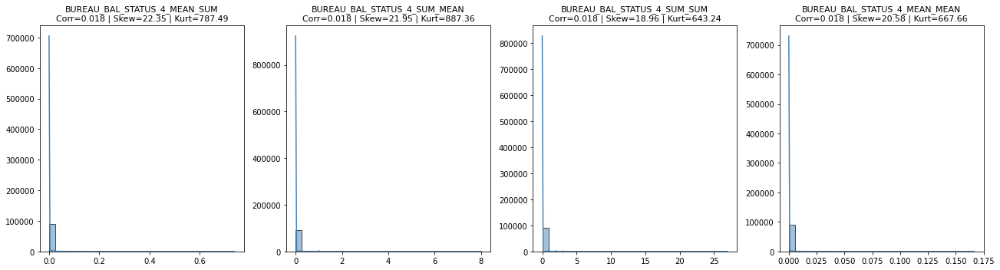

In [1040]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_SUM_SUM', 
            'BUREAU_BAL_STATUS_4_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

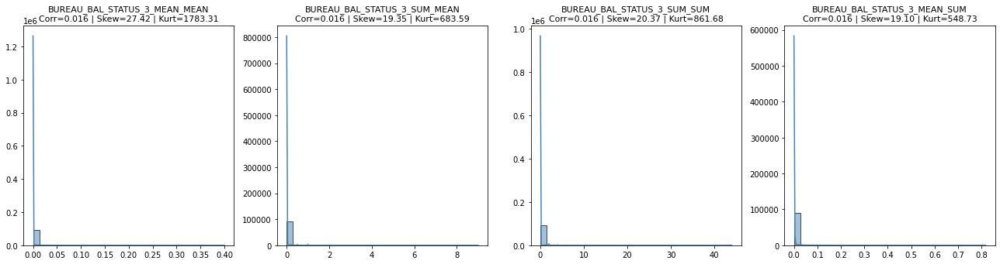

In [1041]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 
            'BUREAU_BAL_STATUS_3_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

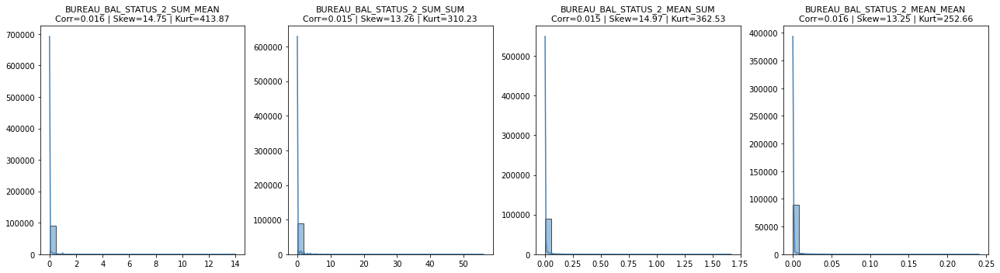

In [1042]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 
            'BUREAU_BAL_STATUS_2_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

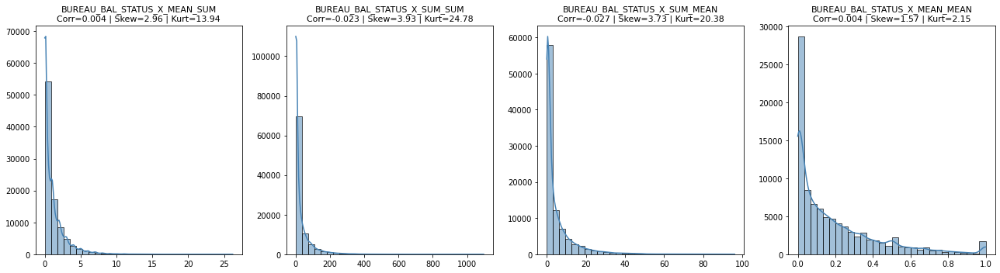

In [1043]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_SUM_MEAN', 
            'BUREAU_BAL_STATUS_X_MEAN_MEAN']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

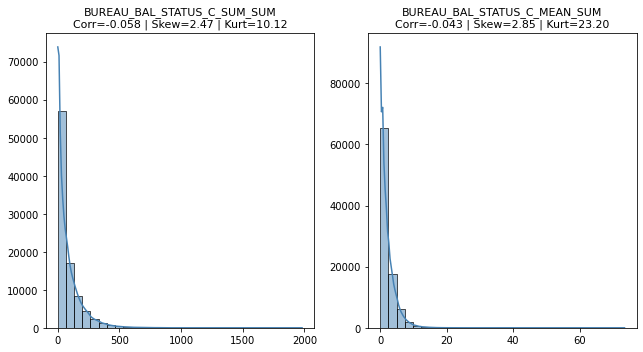

In [1044]:
# Liste des transformations existantes par groupe de corrélation

transfos = ['BUREAU_BAL_STATUS_C_SUM_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM']

plot_transformations_distributions(
    df=df_train_median_mode,
    var_list=transfos,
    target='TARGET',
    corr_method='spearman'
)

In [1045]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_train_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1046]:
remaining_cols = list(set(df_bureau_balance_train_agg.columns).intersection(df_train_median_mode.columns))

In [1047]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1048]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_mode)

 Mémoire avant : 501.84 MB
 Mémoire après : 484.25 MB
 Gain : 3.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.255682,0.0,0.0,0,0.175426,2.875000,23,1.875000,110,13.750000
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0.0,0.0,0,0.459677,14.250000,57,3.250000,117,29.250000
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0.0,0.0,0,0.783784,29.000000,29,0.000000,37,37.000000


#### Corrélation des variables - df_train_median_missing

In [1049]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_median_missing[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,0.999992
1,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,BUREAU_BAL_STATUS_5_MEAN_SUM,0.999992
2,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.999988
3,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,BUREAU_BAL_STATUS_5_SUM_SUM,0.999988
4,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.999985
5,BUREAU_BAL_STATUS_5_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
6,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.999985
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX,0.999982
9,BUREAU_BAL_STATUS_5_MEAN_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.999981


In [1050]:
df_corr = get_correlation_pairs(df_train_median_missing[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [1051]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1052]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_median_missing.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_BAL_IS_LATE_MEAN_MAX,0.057457,0.057706,0.057457,0.057706,0.000688,0.164695
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.061183,0.057176,0.061183,0.057176,0.000715,0.170626
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.059677,0.056922,0.059677,0.056922,0.000173,0.076443
BUREAU_BAL_STATUS_1_MEAN_SUM,0.052384,0.056741,0.052384,0.056741,0.000727,0.168969
BUREAU_BAL_IS_LATE_MEAN_SUM,0.050883,0.056577,0.050883,0.056577,0.000486,0.126769
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.036774,0.056101,0.036774,0.056101,0.000000,0.037150
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.031248,0.055823,0.031248,0.055823,0.000000,0.034829
BUREAU_BAL_STATUS_1_SUM_MEAN,0.033287,0.050988,0.033287,0.050988,0.000508,0.121318
BUREAU_BAL_IS_LATE_MAX_MEAN,0.050821,0.050967,0.050821,0.050967,0.001058,0.223049
BUREAU_BAL_IS_LATE_SUM_MEAN,0.030831,0.050189,0.030831,0.050189,0.000677,0.149008


In [1053]:
pd.reset_option('display.max_rows')

In [1054]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_median_missing, y=df_train_median_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_IS_LATE_MAX_MEAN, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MAX_MAX, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_IS_LATE_MAX_SUM, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_SUM]",17,0.061183,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX, BUREAU_BAL_STATUS_5_SUM_MEAN]",13,0.021702,BUREAU_BAL_IS_MAX_LATE_MAX_MEAN
2,"[BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM]",9,0.022404,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM, BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",4,0.016278,BUREAU_BAL_STATUS_4_SUM_MEAN
4,"[BUREAU_BAL_STATUS_3_SUM_MEAN, BUREAU_BAL_STATUS_3_SUM_SUM, BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_MEAN_MEAN]",4,0.017464,BUREAU_BAL_STATUS_3_MEAN_MEAN
5,"[BUREAU_BAL_STATUS_2_SUM_MEAN, BUREAU_BAL_STATUS_2_MEAN_MEAN, BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",4,0.020657,BUREAU_BAL_STATUS_2_MEAN_SUM
6,"[BUREAU_BAL_STATUS_X_SUM_MEAN, BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM, BUREAU_BAL_STATUS_X_MEAN_MEAN]",4,0.033292,BUREAU_BAL_STATUS_X_SUM_MEAN
7,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",2,0.048912,BUREAU_BAL_STATUS_C_SUM_SUM


In [1055]:
pd.reset_option('display.max_colwidth')

- On supprime les mêmes variables que df_train_median_mode.

In [1056]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_train_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1057]:
remaining_cols = list(set(df_bureau_balance_train_agg.columns).intersection(df_train_median_missing.columns))

In [1058]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1059]:
# Réduction de la taille du dataframe.

optimize_types(df_train_median_missing)

 Mémoire avant : 486.50 MB
 Mémoire après : 468.90 MB
 Gain : 3.6%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.255682,0.0,0.0,0,0.175426,2.875000,23,1.875000,110,13.750000
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0.0,0.0,0,0.459677,14.250000,57,3.250000,117,29.250000
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0.0,0.0,0,0.783784,29.000000,29,0.000000,37,37.000000


#### Corrélation des variables - df_train_iterative_mode

In [1060]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_iterative_mode[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,0.999992
1,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,BUREAU_BAL_STATUS_5_MEAN_SUM,0.999992
2,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.999988
3,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,BUREAU_BAL_STATUS_5_SUM_SUM,0.999988
4,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.999985
5,BUREAU_BAL_STATUS_5_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
6,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.999985
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX,0.999982
9,BUREAU_BAL_STATUS_5_MEAN_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.999981


In [1061]:
df_corr = get_correlation_pairs(df_train_iterative_mode[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [1062]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1063]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_iterative_mode.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_BAL_IS_LATE_MEAN_MAX,0.057457,0.057706,0.057457,0.057706,0.000688,0.164695
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.061183,0.057176,0.061183,0.057176,0.000715,0.170626
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.059677,0.056922,0.059677,0.056922,0.000173,0.076443
BUREAU_BAL_STATUS_1_MEAN_SUM,0.052384,0.056741,0.052384,0.056741,0.000727,0.168969
BUREAU_BAL_IS_LATE_MEAN_SUM,0.050883,0.056577,0.050883,0.056577,0.000486,0.126769
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.036774,0.056101,0.036774,0.056101,0.000000,0.037150
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.031248,0.055823,0.031248,0.055823,0.000000,0.034829
BUREAU_BAL_STATUS_1_SUM_MEAN,0.033287,0.050988,0.033287,0.050988,0.000508,0.121318
BUREAU_BAL_IS_LATE_MAX_MEAN,0.050821,0.050967,0.050821,0.050967,0.001058,0.223049
BUREAU_BAL_IS_LATE_SUM_MEAN,0.030831,0.050189,0.030831,0.050189,0.000677,0.149008


In [1064]:
pd.reset_option('display.max_rows')

In [1065]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_iterative_mode, y=df_train_iterative_mode['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_IS_LATE_MAX_MEAN, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MAX_MAX, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_IS_LATE_MAX_SUM, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_SUM]",17,0.061183,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX, BUREAU_BAL_STATUS_5_SUM_MEAN]",13,0.021702,BUREAU_BAL_IS_MAX_LATE_MAX_MEAN
2,"[BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM]",9,0.022404,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM, BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",4,0.016278,BUREAU_BAL_STATUS_4_SUM_MEAN
4,"[BUREAU_BAL_STATUS_3_SUM_MEAN, BUREAU_BAL_STATUS_3_SUM_SUM, BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_MEAN_MEAN]",4,0.017464,BUREAU_BAL_STATUS_3_MEAN_MEAN
5,"[BUREAU_BAL_STATUS_2_SUM_MEAN, BUREAU_BAL_STATUS_2_MEAN_MEAN, BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",4,0.020657,BUREAU_BAL_STATUS_2_MEAN_SUM
6,"[BUREAU_BAL_STATUS_X_SUM_MEAN, BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM, BUREAU_BAL_STATUS_X_MEAN_MEAN]",4,0.033292,BUREAU_BAL_STATUS_X_SUM_MEAN
7,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",2,0.048912,BUREAU_BAL_STATUS_C_SUM_SUM


In [1066]:
pd.reset_option('display.max_colwidth')

In [1067]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_train_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1068]:
remaining_cols = list(set(df_bureau_balance_train_agg.columns).intersection(df_train_iterative_mode.columns))

In [1069]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1070]:
# Réduction de la taille du dataframe.

optimize_types(df_train_iterative_mode)

 Mémoire avant : 494.51 MB
 Mémoire après : 476.91 MB
 Gain : 3.6%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.255682,0.0,0.0,0,0.175426,2.875000,23,1.875000,110,13.750000
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0.0,0.0,0,0.459677,14.250000,57,3.250000,117,29.250000
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0.0,0.0,0,0.783784,29.000000,29,0.000000,37,37.000000


#### Corrélation des variables - df_train_nan_missing

In [1071]:
# Visualisation des corrélations entre les variables.

get_correlation_pairs(df_train_nan_missing[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,0.999992
1,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX / BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_IS_MAX_LATE_MEAN_MAX,BUREAU_BAL_STATUS_5_MEAN_SUM,0.999992
2,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,0.999988
3,BUREAU_BAL_IS_MAX_LATE_SUM_MAX / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_IS_MAX_LATE_SUM_MAX,BUREAU_BAL_STATUS_5_SUM_SUM,0.999988
4,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN / BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,0.999985
5,BUREAU_BAL_STATUS_5_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_STATUS_5_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
6,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_STATUS_5_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_STATUS_5_SUM_MEAN,0.999985
7,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN / BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN,BUREAU_BAL_IS_MAX_LATE_SUM_MEAN,0.999985
8,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX / BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX,0.999982
9,BUREAU_BAL_STATUS_5_MEAN_SUM / BUREAU_BAL_STATUS_5_SUM_SUM,BUREAU_BAL_STATUS_5_MEAN_SUM,BUREAU_BAL_STATUS_5_SUM_SUM,0.999981


In [1072]:
df_corr = get_correlation_pairs(df_train_nan_missing[df_bureau_balance_train_agg.columns.tolist()], method="spearman", style=False, threshold=0.9)

In [1073]:
var_corr = df_corr['Variable 1'].unique().tolist() + df_corr['Variable 2'].unique().tolist()
var_corr = list(set(var_corr))

In [1074]:
# Visualisation des corrélations les plus importantes avec la Target.
pd.set_option('display.max_rows', None)

target_corr = compute_target_correlations(df_train_nan_missing.loc[:, var_corr + ["TARGET"]], 'TARGET', mode='nonlinear', plot=False)
target_corr.loc[var_corr].sort_values(by='spearman_corr', ascending=False)

,pearson_corr,spearman_corr,abs_pearson,abs_spearman,mutual_info,score_global
BUREAU_BAL_IS_LATE_MEAN_MAX,0.057457,0.057706,0.057457,0.057706,0.000688,0.164695
BUREAU_BAL_STATUS_1_MEAN_MEAN,0.061183,0.057176,0.061183,0.057176,0.000715,0.170626
BUREAU_BAL_IS_LATE_MEAN_MEAN,0.059677,0.056922,0.059677,0.056922,0.000173,0.076443
BUREAU_BAL_STATUS_1_MEAN_SUM,0.052384,0.056741,0.052384,0.056741,0.000727,0.168969
BUREAU_BAL_IS_LATE_MEAN_SUM,0.050883,0.056577,0.050883,0.056577,0.000486,0.126769
BUREAU_BAL_STATUS_NUM_MEAN_MEAN,0.036774,0.056101,0.036774,0.056101,0.000000,0.037150
BUREAU_BAL_STATUS_NUM_MEAN_SUM,0.031248,0.055823,0.031248,0.055823,0.000000,0.034829
BUREAU_BAL_STATUS_1_SUM_MEAN,0.033287,0.050988,0.033287,0.050988,0.000508,0.121318
BUREAU_BAL_IS_LATE_MAX_MEAN,0.050821,0.050967,0.050821,0.050967,0.001058,0.223049
BUREAU_BAL_IS_LATE_SUM_MEAN,0.030831,0.050189,0.030831,0.050189,0.000677,0.149008


In [1075]:
pd.reset_option('display.max_rows')

In [1076]:
# Visualisation des groupes de variables corrélées entre elles.

pd.set_option('display.max_colwidth', None)
summarize_correlated_groups(df_corr, X=df_train_nan_missing, y=df_train_nan_missing['TARGET'])

,Variables du groupe,Taille du groupe,Corrélation max avec y,Variable la plus corrélée
0,"[BUREAU_BAL_IS_LATE_MAX_MEAN, BUREAU_BAL_STATUS_NUM_MEAN_MEAN, BUREAU_BAL_STATUS_NUM_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_MEAN, BUREAU_BAL_IS_LATE_SUM_MAX, BUREAU_BAL_IS_LATE_MEAN_MAX, BUREAU_BAL_IS_LATE_SUM_SUM, BUREAU_BAL_IS_LATE_MAX_MAX, BUREAU_BAL_IS_LATE_SUM_MEAN, BUREAU_BAL_STATUS_1_MEAN_MEAN, BUREAU_BAL_IS_LATE_MAX_SUM, BUREAU_BAL_STATUS_1_MEAN_SUM, BUREAU_BAL_STATUS_NUM_SUM_SUM, BUREAU_BAL_STATUS_NUM_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_MEAN, BUREAU_BAL_IS_LATE_MEAN_SUM, BUREAU_BAL_STATUS_1_SUM_SUM]",17,0.061183,BUREAU_BAL_STATUS_1_MEAN_MEAN
1,"[BUREAU_BAL_IS_MAX_LATE_MAX_SUM, BUREAU_BAL_STATUS_5_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_MEAN_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MAX, BUREAU_BAL_IS_MAX_LATE_MAX_MEAN, BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN, BUREAU_BAL_STATUS_5_MEAN_SUM, BUREAU_BAL_STATUS_5_MEAN_MEAN, BUREAU_BAL_IS_MAX_LATE_MAX_MAX, BUREAU_BAL_IS_MAX_LATE_SUM_SUM, BUREAU_BAL_IS_MAX_LATE_SUM_MAX, BUREAU_BAL_STATUS_5_SUM_MEAN]",13,0.021702,BUREAU_BAL_IS_MAX_LATE_MAX_MEAN
2,"[BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX, BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM, BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN, BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM]",9,0.022404,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN
3,"[BUREAU_BAL_STATUS_4_MEAN_SUM, BUREAU_BAL_STATUS_4_SUM_SUM, BUREAU_BAL_STATUS_4_SUM_MEAN, BUREAU_BAL_STATUS_4_MEAN_MEAN]",4,0.016278,BUREAU_BAL_STATUS_4_SUM_MEAN
4,"[BUREAU_BAL_STATUS_3_SUM_MEAN, BUREAU_BAL_STATUS_3_SUM_SUM, BUREAU_BAL_STATUS_3_MEAN_SUM, BUREAU_BAL_STATUS_3_MEAN_MEAN]",4,0.017464,BUREAU_BAL_STATUS_3_MEAN_MEAN
5,"[BUREAU_BAL_STATUS_2_SUM_MEAN, BUREAU_BAL_STATUS_2_MEAN_MEAN, BUREAU_BAL_STATUS_2_MEAN_SUM, BUREAU_BAL_STATUS_2_SUM_SUM]",4,0.020657,BUREAU_BAL_STATUS_2_MEAN_SUM
6,"[BUREAU_BAL_STATUS_X_SUM_MEAN, BUREAU_BAL_STATUS_X_SUM_SUM, BUREAU_BAL_STATUS_X_MEAN_SUM, BUREAU_BAL_STATUS_X_MEAN_MEAN]",4,0.033292,BUREAU_BAL_STATUS_X_SUM_MEAN
7,"[BUREAU_BAL_STATUS_C_MEAN_SUM, BUREAU_BAL_STATUS_C_SUM_SUM]",2,0.048912,BUREAU_BAL_STATUS_C_SUM_SUM


In [1077]:
pd.reset_option('display.max_colwidth')

In [1078]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_train_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1079]:
remaining_cols = list(set(df_bureau_balance_train_agg.columns).intersection(df_train_nan_missing.columns))

In [1080]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_train_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation


In [1081]:
# Réduction de la taille du dataframe.

optimize_types(df_train_nan_missing)

 Mémoire avant : 509.08 MB
 Mémoire après : 491.48 MB
 Gain : 3.5%


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100002,1,0,1,0,1,0,202500.0,24700.5,351000.0,...,0.255682,0.0,0.0,0,0.175426,2.875000,23,1.875000,110,13.750000
1,100003,0,0,0,0,0,0,270000.0,35698.5,1129500.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
2,100004,0,1,1,1,1,0,67500.0,6750.0,135000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
3,100006,0,0,0,0,1,0,135000.0,29686.5,297000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
4,100007,0,0,1,0,1,0,121500.0,21865.5,513000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307495,456251,0,0,1,0,0,0,157500.0,27558.0,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307496,456252,0,0,0,0,1,0,72000.0,12001.5,225000.0,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
307497,456253,0,0,0,0,1,0,153000.0,29979.0,585000.0,...,0.000000,0.0,0.0,0,0.459677,14.250000,57,3.250000,117,29.250000
307498,456254,1,0,0,0,1,0,171000.0,20205.0,319500.0,...,0.000000,0.0,0.0,0,0.783784,29.000000,29,0.000000,37,37.000000


#### Corrélation des variables - df_test_median_mode_linear

In [1082]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_test_median_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1083]:
remaining_cols = list(set(df_bureau_balance_test_linear_agg.columns).intersection(df_test_median_mode_linear.columns))

In [1084]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_STATUS_2_MEAN_MEAN / BUREAU_BAL_STATUS_2_SUM_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_2_SUM_MEAN,0.904708
1,BUREAU_BAL_STATUS_3_MEAN_MEAN / BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_MEAN_MEAN,0.874477


In [1085]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode_linear)

 Mémoire avant : 49.38 MB
 Mémoire après : 45.84 MB
 Gain : 7.2%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,110,0.214590,1.502129,4.285714,24.571428
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,5,0.136752,0.410256,0.666667,7.000000
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.000000,0.000000,0.000000,0.000000,0,103,0.254545,1.018182,10.250000,57.500000
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,263,0.260434,3.125213,11.083333,46.666668
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.000000,0.000000,0.000000,0.000000,0,46,0.010000,0.050000,0.200000,24.200001
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.000000,0.000000,0.000000,0.000000,0,57,0.100000,0.500000,0.800000,18.400000
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.000661,0.011236,0.058824,0.000661,1,552,0.300690,5.111730,11.647058,58.176472


In [1086]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode_linear.columns)
cols_test = set(df_test_median_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing_linear

In [1087]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_test_median_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1088]:
remaining_cols = list(set(df_bureau_balance_test_linear_agg.columns).intersection(df_test_median_missing_linear.columns))

In [1089]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_STATUS_2_MEAN_MEAN / BUREAU_BAL_STATUS_2_SUM_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_2_SUM_MEAN,0.904708
1,BUREAU_BAL_STATUS_3_MEAN_MEAN / BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_MEAN_MEAN,0.874477


In [1090]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing_linear)

 Mémoire avant : 50.10 MB
 Mémoire après : 46.57 MB
 Gain : 7.1%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,20560.5,0.018850,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,110,0.214590,1.502129,4.285714,24.571428
1,100005,0,1,0,1,17370.0,0.035792,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,5,0.136752,0.410256,0.666667,7.000000
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.000000,0.000000,0.000000,0.000000,0,103,0.254545,1.018182,10.250000,57.500000
3,100028,0,0,0,1,49018.5,0.026392,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,263,0.260434,3.125213,11.083333,46.666668
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,9,1,1,...,0.000000,0.000000,0.000000,0.000000,0,46,0.010000,0.050000,0.200000,24.200001
48740,456222,0,0,0,0,31909.5,0.035792,9,1,0,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.000000,0.000000,0.000000,0.000000,0,57,0.100000,0.500000,0.800000,18.400000
48742,456224,0,1,0,0,25128.0,0.018850,9,1,1,...,0.000661,0.011236,0.058824,0.000661,1,552,0.300690,5.111730,11.647058,58.176472


In [1091]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing_linear.columns)
cols_test = set(df_test_median_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode_linear

In [1092]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 
    'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM',

    'BUREAU_BAL_STATUS_C_SUM_MEAN', 'BUREAU_BAL_STATUS_C_MEAN_MEAN',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM',

    'BUREAU_BAL_STATUS_3_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_4_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_IS_LATE_MAX_MEAN'
]

df_test_iterative_mode_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1093]:
remaining_cols = list(set(df_bureau_balance_test_linear_agg.columns).intersection(df_test_iterative_mode_linear.columns))

In [1095]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_STATUS_2_MEAN_MEAN / BUREAU_BAL_STATUS_2_SUM_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_2_SUM_MEAN,0.904708
1,BUREAU_BAL_STATUS_3_MEAN_MEAN / BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_MEAN_MEAN,0.874477


In [1096]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode_linear)

 Mémoire avant : 50.68 MB
 Mémoire après : 47.14 MB
 Gain : 7.0%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_MEAN_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_MEAN_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,20560.5,0.018850,11.898975,1,0,...,0.000000,0.000000,0.000000,0.000000,0,110,0.214590,1.502129,4.285714,24.571428
1,100005,0,1,0,1,17370.0,0.035792,14.375872,1,0,...,0.000000,0.000000,0.000000,0.000000,0,5,0.136752,0.410256,0.666667,7.000000
2,100013,0,1,1,1,69777.0,0.019101,5.000000,1,0,...,0.000000,0.000000,0.000000,0.000000,0,103,0.254545,1.018182,10.250000,57.500000
3,100028,0,0,0,1,49018.5,0.026392,7.500616,1,0,...,0.000000,0.000000,0.000000,0.000000,0,263,0.260434,3.125213,11.083333,46.666668
4,100038,0,1,1,0,32067.0,0.010032,16.000000,1,1,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,13.609962,1,1,...,0.000000,0.000000,0.000000,0.000000,0,46,0.010000,0.050000,0.200000,24.200001
48740,456222,0,0,0,0,31909.5,0.035792,13.727984,1,0,...,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
48741,456223,0,0,1,1,33205.5,0.026392,4.000000,1,0,...,0.000000,0.000000,0.000000,0.000000,0,57,0.100000,0.500000,0.800000,18.400000
48742,456224,0,1,0,0,25128.0,0.018850,10.440592,1,1,...,0.000661,0.011236,0.058824,0.000661,1,552,0.300690,5.111730,11.647058,58.176472


In [1097]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode_linear.columns)
cols_test = set(df_test_iterative_mode_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing_linear

In [1098]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 
    'BUREAU_BAL_STATUS_5_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 
    'BUREAU_BAL_STATUS_NUM_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX', 'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_STATUS_1_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM',

    'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_NB_MONTHS_SUM', 'BUREAU_BAL_STATUS_C_MEAN_SUM', 

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_3_SUM_SUM',

    'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_SUM',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MEAN', 'BUREAU_BAL_NB_MONTHS_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN'

]

df_test_nan_missing_linear.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1099]:
remaining_cols = list(set(df_bureau_balance_test_linear_agg.columns).intersection(df_test_nan_missing_linear.columns))

In [1100]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing_linear[remaining_cols], method="pearson", style=True, threshold=0.8)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_STATUS_2_MEAN_MEAN / BUREAU_BAL_STATUS_2_SUM_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_2_SUM_MEAN,0.904427
1,BUREAU_BAL_STATUS_3_MEAN_MEAN / BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_3_MEAN_MEAN,0.874309


In [1101]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing_linear)

 Mémoire avant : 53.27 MB
 Mémoire après : 49.50 MB
 Gain : 7.1%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_ANNUITY,REGION_POPULATION_RELATIVE,OWN_CAR_AGE,FLAG_MOBIL,FLAG_WORK_PHONE,...,BUREAU_BAL_STATUS_3_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_3_SUM_MEAN,BUREAU_BAL_STATUS_4_SUM_MEAN,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_MEAN_MEAN,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_STATUS_X_SUM_SUM
0,100001,0,0,0,1,20560.5,0.018850,<NA>,1,0,...,0.000000,0.000000,0.000000,0.000000,0,15.714286,110,0.214590,4.285714,30
1,100005,0,1,0,1,17370.0,0.035792,<NA>,1,0,...,0.000000,0.000000,0.000000,0.000000,0,1.666667,5,0.136752,0.666667,2
2,100013,0,1,1,1,69777.0,0.019101,5,1,0,...,0.000000,0.000000,0.000000,0.000000,0,25.750000,103,0.254545,10.250000,41
3,100028,0,0,0,1,49018.5,0.026392,<NA>,1,0,...,0.000000,0.000000,0.000000,0.000000,0,21.916666,263,0.260434,11.083333,133
4,100038,0,1,1,0,32067.0,0.010032,16,1,1,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,17473.5,0.002042,<NA>,1,1,...,0.000000,0.000000,0.000000,0.000000,0,9.200000,46,0.010000,0.200000,1
48740,456222,0,0,0,0,31909.5,0.035792,<NA>,1,0,...,NaN,NaN,NaN,NaN,<NA>,NaN,<NA>,NaN,NaN,<NA>
48741,456223,0,0,1,1,33205.5,0.026392,4,1,0,...,0.000000,0.000000,0.000000,0.000000,0,11.400000,57,0.100000,0.800000,4
48742,456224,0,1,0,0,25128.0,0.018850,<NA>,1,1,...,0.000661,0.011236,0.058824,0.058824,1,32.470589,552,0.300690,11.647058,198


In [1102]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing_linear.columns)
cols_test = set(df_test_nan_missing_linear.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_mode

In [1103]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_test_median_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1104]:
remaining_cols = list(set(df_bureau_balance_test_agg.columns).intersection(df_test_median_mode.columns))

In [1105]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN / BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,0.900830


In [1106]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_mode)

 Mémoire avant : 78.24 MB
 Mémoire après : 75.45 MB
 Gain : 3.6%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.007519,0.000000,0.000000,0,0.441240,15.714286,110,4.285714,172,24.571428
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.000000,0.000000,0.000000,0,0.128205,1.666667,5,0.666667,21,7.000000
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.027701,0.000000,0.000000,0,0.397036,25.750000,103,10.250000,230,57.500000
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.000000,0.000000,0.000000,0,0.362245,21.916666,263,11.083333,560,46.666668
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0.082939,0.000000,0.000000,0,0.393340,9.200000,46,0.200000,121,24.200001
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.006667,0.000000,0.000000,0,0.514412,11.400000,57,0.800000,92,18.400000
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.010921,0.000661,0.011236,1,0.442340,32.470589,552,11.647058,989,58.176472


In [1107]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_mode.columns)
cols_test = set(df_test_median_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_median_missing

In [1108]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_test_median_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1109]:
remaining_cols = list(set(df_bureau_balance_test_agg.columns).intersection(df_test_median_missing.columns))

In [1110]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_median_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN / BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,0.900830


In [1111]:
# Réduction de la taille du dataframe.

optimize_types(df_test_median_missing)

 Mémoire avant : 75.81 MB
 Mémoire après : 73.02 MB
 Gain : 3.7%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.007519,0.000000,0.000000,0,0.441240,15.714286,110,4.285714,172,24.571428
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.000000,0.000000,0.000000,0,0.128205,1.666667,5,0.666667,21,7.000000
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.027701,0.000000,0.000000,0,0.397036,25.750000,103,10.250000,230,57.500000
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.000000,0.000000,0.000000,0,0.362245,21.916666,263,11.083333,560,46.666668
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0.082939,0.000000,0.000000,0,0.393340,9.200000,46,0.200000,121,24.200001
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.006667,0.000000,0.000000,0,0.514412,11.400000,57,0.800000,92,18.400000
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.010921,0.000661,0.011236,1,0.442340,32.470589,552,11.647058,989,58.176472


In [1112]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_median_missing.columns)
cols_test = set(df_test_median_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_iterative_mode

In [1113]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_test_iterative_mode.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1114]:
remaining_cols = list(set(df_bureau_balance_test_agg.columns).intersection(df_test_iterative_mode.columns))

In [1115]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_iterative_mode[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN / BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,0.900830


In [1116]:
# Réduction de la taille du dataframe.

optimize_types(df_test_iterative_mode)

 Mémoire avant : 77.27 MB
 Mémoire après : 74.48 MB
 Gain : 3.6%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.007519,0.000000,0.000000,0,0.441240,15.714286,110,4.285714,172,24.571428
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.000000,0.000000,0.000000,0,0.128205,1.666667,5,0.666667,21,7.000000
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.027701,0.000000,0.000000,0,0.397036,25.750000,103,10.250000,230,57.500000
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.000000,0.000000,0.000000,0,0.362245,21.916666,263,11.083333,560,46.666668
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0.082939,0.000000,0.000000,0,0.393340,9.200000,46,0.200000,121,24.200001
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.006667,0.000000,0.000000,0,0.514412,11.400000,57,0.800000,92,18.400000
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.010921,0.000661,0.011236,1,0.442340,32.470589,552,11.647058,989,58.176472


In [1117]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_iterative_mode.columns)
cols_test = set(df_test_iterative_mode.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


#### Corrélation des variables - df_test_nan_missing

In [1118]:
# Suppression d'une des deux variables pour les très fortes corrélations restantes.

cols_to_drop = [
    'BUREAU_BAL_IS_LATE_SUM_MAX', 'BUREAU_BAL_STATUS_NUM_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_SUM', 
    'BUREAU_BAL_STATUS_1_MEAN_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MAX', 
    'BUREAU_BAL_IS_LATE_SUM_SUM', 'BUREAU_BAL_IS_LATE_MEAN_MEAN', 'BUREAU_BAL_STATUS_1_SUM_MEAN', 
    'BUREAU_BAL_IS_LATE_MAX_SUM', 'BUREAU_BAL_IS_LATE_MAX_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_SUM', 
    'BUREAU_BAL_STATUS_1_SUM_SUM', 'BUREAU_BAL_IS_LATE_SUM_MEAN', 'BUREAU_BAL_IS_LATE_MAX_MAX', 
    'BUREAU_BAL_STATUS_NUM_MEAN_MEAN', 'BUREAU_BAL_STATUS_NUM_SUM_MEAN',

    'BUREAU_BAL_IS_MAX_LATE_MAX_MAX', 'BUREAU_BAL_STATUS_5_SUM_MEAN', 'BUREAU_BAL_STATUS_5_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_SUM_MAX', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MEAN', 
    'BUREAU_BAL_IS_MAX_LATE_MAX_SUM', 'BUREAU_BAL_STATUS_5_MEAN_SUM', 'BUREAU_BAL_IS_MAX_LATE_MEAN_MAX', 
    'BUREAU_BAL_STATUS_5_SUM_SUM',

    'BUREAU_BAL_IS_SERIOUS_LATE_MAX_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_SUM', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MEAN', 'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MEAN', 
    'BUREAU_BAL_IS_SERIOUS_LATE_SUM_MAX', 'BUREAU_BAL_IS_SERIOUS_LATE_MAX_SUM', 'BUREAU_BAL_IS_SERIOUS_LATE_MEAN_MAX',

    'BUREAU_BAL_STATUS_4_MEAN_SUM', 'BUREAU_BAL_STATUS_4_SUM_MEAN', 'BUREAU_BAL_STATUS_4_MEAN_MEAN',

    'BUREAU_BAL_STATUS_3_MEAN_MEAN', 'BUREAU_BAL_STATUS_3_SUM_MEAN', 'BUREAU_BAL_STATUS_3_SUM_SUM', 

    'BUREAU_BAL_STATUS_2_SUM_MEAN', 'BUREAU_BAL_STATUS_2_SUM_SUM', 'BUREAU_BAL_STATUS_2_MEAN_SUM', 

    'BUREAU_BAL_STATUS_X_MEAN_SUM', 'BUREAU_BAL_STATUS_X_SUM_SUM', 'BUREAU_BAL_STATUS_X_MEAN_MEAN',

    'BUREAU_BAL_STATUS_C_MEAN_SUM', 'INCOME_PER_PERSON'
    ]

df_test_nan_missing.drop(columns=cols_to_drop, inplace=True, errors="ignore")

In [1119]:
remaining_cols = list(set(df_bureau_balance_test_agg.columns).intersection(df_test_nan_missing.columns))

In [1120]:
# Vérification des fortes corrélations potentiellement restantes.

get_correlation_pairs(df_test_nan_missing[remaining_cols], method="spearman", style=True, threshold=0.9)

,Variables corrélées,Variable 1,Variable 2,Corrélation
0,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN / BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_IS_SERIOUS_LATE_MAX_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,0.900830


In [1121]:
# Réduction de la taille du dataframe.

optimize_types(df_test_nan_missing)

 Mémoire avant : 78.69 MB
 Mémoire après : 75.90 MB
 Gain : 3.5%


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,BUREAU_BAL_STATUS_1_MEAN_MEAN,BUREAU_BAL_STATUS_2_MEAN_MEAN,BUREAU_BAL_STATUS_3_MEAN_SUM,BUREAU_BAL_STATUS_4_SUM_SUM,BUREAU_BAL_STATUS_C_MEAN_MEAN,BUREAU_BAL_STATUS_C_SUM_MEAN,BUREAU_BAL_STATUS_C_SUM_SUM,BUREAU_BAL_STATUS_X_SUM_MEAN,BUREAU_BAL_NB_MONTHS_SUM,BUREAU_BAL_NB_MONTHS_MEAN
0,100001,0,0,0,1,0,135000.0,20560.5,450000.0,0.018850,...,0.007519,0.000000,0.000000,0,0.441240,15.714286,110,4.285714,172,24.571428
1,100005,0,1,0,1,0,99000.0,17370.0,180000.0,0.035792,...,0.000000,0.000000,0.000000,0,0.128205,1.666667,5,0.666667,21,7.000000
2,100013,0,1,1,1,0,202500.0,69777.0,630000.0,0.019101,...,0.027701,0.000000,0.000000,0,0.397036,25.750000,103,10.250000,230,57.500000
3,100028,0,0,0,1,2,315000.0,49018.5,1575000.0,0.026392,...,0.000000,0.000000,0.000000,0,0.362245,21.916666,263,11.083333,560,46.666668
4,100038,0,1,1,0,1,180000.0,32067.0,625500.0,0.010032,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,456221,0,0,0,1,0,121500.0,17473.5,270000.0,0.002042,...,0.082939,0.000000,0.000000,0,0.393340,9.200000,46,0.200000,121,24.200001
48740,456222,0,0,0,0,2,157500.0,31909.5,495000.0,0.035792,...,NaN,NaN,NaN,<NA>,NaN,NaN,<NA>,NaN,<NA>,NaN
48741,456223,0,0,1,1,1,202500.0,33205.5,315000.0,0.026392,...,0.006667,0.000000,0.000000,0,0.514412,11.400000,57,0.800000,92,18.400000
48742,456224,0,1,0,0,0,225000.0,25128.0,450000.0,0.018850,...,0.010921,0.000661,0.011236,1,0.442340,32.470589,552,11.647058,989,58.176472


In [1122]:
# Différence de variables entre les deux dataframes train et test avec la même imputation.

cols_train = set(df_train_nan_missing.columns)
cols_test = set(df_test_nan_missing.columns)

# Colonnes présentes dans train mais pas dans test :
diff_train_test = cols_train - cols_test
print("Colonnes dans train mais pas dans test :", diff_train_test)

# Colonnes présentes dans test mais pas dans train :
diff_test_train = cols_test - cols_train
print("Colonnes dans test mais pas dans train :", diff_test_train)

Colonnes dans train mais pas dans test : {'TARGET', 'TARGET_was_missing'}
Colonnes dans test mais pas dans train : set()


- On remarque de nouveau quelques corrélations restantes dans les dataframes "test" ce qui est dû aux différences de distribution entre application train et test (puisque l'on a 300K lignes pour train contre 50K lignes pour test).

- Le fichier bureau balance a bien été intégré avec les dataframes principaux train et test, on peut donc passer au dataset suivant. Toutefois étant donné la longueur de ce notebook, on finira la préparation des données dans une deuxième partie.

In [ ]:
# Export des dataframes application train et test pour la partie 2.


OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

dfs = {
    "df_train_median_mode_linear": df_train_median_mode_linear,
    "df_train_median_missing_linear": df_train_median_missing_linear,
    "df_train_iterative_mode_linear": df_train_iterative_mode_linear,
    "df_train_nan_missing_linear": df_train_nan_missing_linear,
    "df_train_median_mode": df_train_median_mode,
    "df_train_median_missing": df_train_median_missing,
    "df_train_iterative_mode": df_train_iterative_mode,
    "df_train_nan_missing": df_train_nan_missing,
    "df_test_median_mode_linear": df_test_median_mode_linear,
    "df_test_median_missing_linear": df_test_median_missing_linear,
    "df_test_iterative_mode_linear": df_test_iterative_mode_linear,
    "df_test_nan_missing_linear": df_test_nan_missing_linear,
    "df_test_median_mode": df_test_median_mode,
    "df_test_median_missing": df_test_median_missing,
    "df_test_iterative_mode": df_test_iterative_mode,
    "df_test_nan_missing": df_test_nan_missing,
}

for name, df in dfs.items():
    file_path = OUTPUT_DIR / f"{name}.pkl"
    with open(file_path, "wb") as f:
        pickle.dump(df, f)